In [1]:
import os
import numpy as np
import requests
import math
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
%matplotlib inline
import sys
import timeit
import copy

import tensorflow as tf
from tensorflow.keras import layers, Model, backend
#from tensorflow.keras import applications
from tensorflow.keras.models import Sequential, load_model
from tensorflow.keras.layers import Dense, Input, Activation, Dropout

import pyQEDA as pq
import sys
sys.path.append("/Users/chenjie/pyQEDA/pyscripts")
import pyQEDA_function_cj as pf
import pyQEDA_potential as pqp
import normalization_function as nf
import load_Intensity_function as lif

-------------------------------------------------------------------------------------------------------------------

# I. Load Data

1. load the true Ug of experimental pattern

In [2]:
name =  "SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn"
File = "SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn"
Nx = 83
t = 0.3     # 0.5*1000 = 500Am
save_name = "SiTrO3_01"

Folder = "/Users/chenjie/pyQEDA/pyQEDA_simulations/"
file_dir = Folder + name + "/" + name + "_experimental_data/_UgMasterList.txt"

(26,)


Text(0.5, 1.0, 'Ug of experimental pattern')

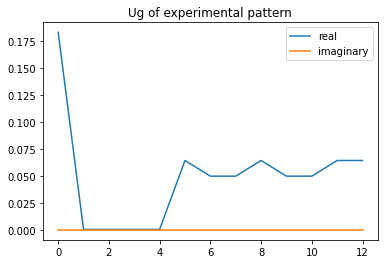

In [3]:
Ug = []
with open(file_dir, mode="r") as f:
    f.readline()
    for line in f:
        beam_id, Ug_re, Ug_im = line.strip().split(" ")[:3]
        Ug_re = float(Ug_re)
        Ug_im = float(Ug_im)
        Ug = np.append(Ug, [Ug_re, Ug_im])
        Ug = np.asarray(Ug)
        numUg = int(len(Ug)/2)
print(Ug.shape)

plt.plot(Ug[::2],label='real')
plt.plot(Ug[1::2],label='imaginary')
plt.legend()
plt.title('Ug of experimental pattern')

In [4]:
# join Ug and t:
Ug_t = np.append(Ug,t)
print(Ug_t.shape)

(27,)


In [5]:
Ug_t

array([ 1.83539e-01,  0.00000e+00,  4.61450e-04, -4.96320e-09,
        4.61450e-04,  4.96320e-09,  4.61450e-04, -4.96320e-09,
        4.61450e-04,  4.96320e-09,  6.44769e-02, -5.75450e-09,
        4.99062e-02,  0.00000e+00,  4.99062e-02, -4.46266e-09,
        6.44769e-02,  5.75450e-09,  4.99062e-02,  4.46266e-09,
        4.99062e-02,  0.00000e+00,  6.44769e-02, -5.75450e-09,
        6.44769e-02,  5.75450e-09,  3.00000e-01])

2. load the intensities of experimental pattern

the shape of the experimental pattern:  (1, 6889)
0.9999989287512341


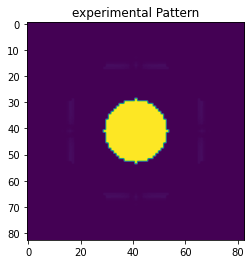

In [6]:
LoadIntensityAsInput = False  # LoadIntensityAsInput=True: load the Intensities in txt.files as Input
                             # LoadIntensityAsInput=False: use the integrated Intensities, which directly obtained from random diffraction, as Input

# load the integrated intensities of experimental pattern
I_exp = np.loadtxt("/Users/chenjie/pyQEDA/training_Data/diff_pattern_" + name + ".csv", dtype=float)

# load the intensities of random pattern & experimental pattern
if LoadIntensityAsInput == True:
    tilt_num, beam_num, exp_Intensity, random_Intensity = lif.LoadIntensity(file = File, N_training_data=200)    
    # use the experimental intensities
    I = exp_Intensity.reshape(1,-1)
    
# use the integrated intensitis of experimental pattern
else:
    I = I_exp.reshape(1,-1)
    
print('the shape of the experimental pattern: ',I.shape)
print(I.max())

    

def nlogf(x):
    return np.log(1+1000*x)
nlog = np.vectorize(nlogf)

        
nlogf_I_exp = nlogf(I_exp.reshape(1,Nx,Nx,1))
plt.imshow(nlogf_I_exp[0])
plt.title('experimental Pattern')
plt.savefig("/Users/chenjie/Desktop/master_thesis_data/"+save_name+"/experimental_pattern.jpg")

---------------------------------------------------------------------------------------------------------------

# II. Function used to produce Datasets

In [7]:
# divere_Ug_t function: used to diverse the origin Ug or t
def diverse_Ug_t(origin_Ug_t, scale_Ug=0.01, scale_t=0.001):
    '''
    origin_Ug_t: Input
    scale_Ug: the scale used to diverse the Structure factors
    scale_t: the scale used to diverse the Thickness   
    '''
    
    Ug_t_diverse = copy.deepcopy(origin_Ug_t)
    
    if scale_t:
        offset_t = (np.random.random()*2-1)*scale_t
        print('The offset applied on thickness: {}\n'.format(offset_t))
        Ug_t_diverse[-1] += offset_t
        
    if scale_Ug:
        offset_Ug = (np.random.random()*2-1)*scale_Ug
        print('The offset applied on Ug: {}\n'.format(offset_Ug))
        
        for j in range(len(Ug_t_diverse)-1):            
            # for real part of Ug    
            if j%2 == 0:
                # the offset if propotional to the magnitude of the Ug
                Ug_t_diverse[j] += offset_Ug*(Ug_t_diverse[j]**2 + Ug_t_diverse[j+1]**2)
            # for imag part of Ug
            else:
                Ug_t_diverse[j] += offset_Ug*(Ug_t_diverse[j-1]**2 + Ug_t_diverse[j]**2)
    
    return Ug_t_diverse    

In [8]:
# calculate_R function: used to calculate the value of R_factor
def calculate_R(I_exp, I_sim):
    return np.sum(np.abs(I_sim - I_exp)) / np.sum(I_exp)

In [9]:
# generate_diversed_data function: used to generate datasets
def generate_diversed_data(Ug_t, scale_Ug=0.01, scale_t=0.001, data_size=140, LoadIntensityAsInput = LoadIntensityAsInput):
    '''
    data_size: total datasize, including training sets and testing sets
    origin_Ug_t: Input
    scale_Ug: the scale used to diverse the Structure factors
    scale_t: the scale used to diverse the Thickness  
    LoadIntensityAsInput: load the Intensities in txt.files as features if true
    '''
    
    # labels: divered Ug_t
    y = []
    # features: diversed I
    X = []
    # R_factors
    R_factors = []

    i = 0
    while i < data_size:
        print('>>> producing the {}. dataset...\n'.format(i+1))
    
        Ug_t_diverse = diverse_Ug_t(Ug_t, scale_Ug=scale_Ug, scale_t=scale_t)
    
        # normalization
        Ug_diverse = np.array(range( np.int((Ug_t_diverse.size - 1)/2) ), dtype=complex)
        Ug_diverse.real = Ug_t_diverse[0:-1:2]
        Ug_diverse.imag = Ug_t_diverse[1:-1:2]
        Ug_diverse_normalized = nf.normalization(file=File, origin_Ug=Ug_diverse)
        Ug_diverse_normalized = np.asarray(Ug_diverse_normalized)

        # reshape
        Ug_diverse_normalized_2real = np.concatenate((np.array(Ug_diverse_normalized.real,ndmin=2).T, np.array(Ug_diverse_normalized.imag,ndmin=2).T),axis=1)  
        Ug_diverse_normalized_2real = np.asarray(Ug_diverse_normalized_2real)
        Ug_t_diverse_normalized_2real = np.append(Ug_diverse_normalized_2real.reshape(-1), Ug_t_diverse[-1])
    
        file = File+".qed"
        I_sim = pf.pyQEDA(filename=file, UseInputUgMasterList=True, InputUg=Ug_t_diverse_normalized_2real, InputUgdoFlip=False)
        
        if LoadIntensityAsInput == True:
            #load the intensities of simulation pattern from txt.files
            I_diverse = lif.LoadIntensity(file = File, test_simulation=True)
        else:
            I_diverse = I_sim
        I_diverse = I_diverse.reshape(-1)
           
        y = np.append(y, Ug_t_diverse)
        X = np.append(X, I_diverse)
    
        R = calculate_R(I, I_diverse)
        print('R-factor: {}\n'.format(R))
        R_factors = np.append(R_factors, R)
    
        i += 1

    y = (np.asarray(y)).reshape(data_size, 2*numUg+1)
    X = (np.asarray(X)).reshape(data_size,-1)
    R_factors = np.asarray(R_factors)
    
    # plot the R-factors 
    plt.figure(figsize=(12,8))
    plt.plot(R_factors[:])
    plt.title('R_factors (experimental pattern v.s. deviated pattern) at a scale of {}'.format(scale_Ug))
    plt.ylabel('R_factor')
    plt.xlabel('Dataset')
    plt.show()
    plt.close()
    
    return X, y, R_factors

The initial datasets will be generated from the Ug diversed at a scale of 0.01 and the thickness diversed at a scale of 0.001, which has been tested in CNN that won't change the pattern a lot.

_________________________________________________________________________________________________________________

# III. Bulid ANN

In [10]:
backend.clear_session()

num_of_targets = 2*numUg+1
hidden_num = int((2/3)*I.shape[1])

intensity_input = Input(shape=(I.shape[1],))
x = Dense(units=hidden_num, activation="tanh")(intensity_input)
x = Dense(units=int((1/2)*hidden_num), activation="tanh")(x)
x = Dense(units=num_of_targets, activation="tanh")(x)
x = Dense(units=num_of_targets, activation="tanh")(x)

model = Model(inputs=intensity_input, outputs=x)
model.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 6889)]            0         
_________________________________________________________________
dense (Dense)                (None, 4592)              31638880  
_________________________________________________________________
dense_1 (Dense)              (None, 2296)              10545528  
_________________________________________________________________
dense_2 (Dense)              (None, 27)                62019     
_________________________________________________________________
dense_3 (Dense)              (None, 27)                756       
Total params: 42,247,183
Trainable params: 42,247,183
Non-trainable params: 0
_________________________________________________________________


In [11]:
opt = tf.keras.optimizers.Adam(lr=0.001) 
model.compile(loss='mse', optimizer=opt, metrics='acc')

#save the model
model.save(name+"_ANN.h5")

_________________________________________________________________________________________________________________

# IV. Training to determine an acceptable range of scale_Ug


-----------------------------------------------------------------------------------------------------

>>> start to produce Dataset at a scale of 0.01

-----------------------------------------------------------------------------------------------------

>>> producing the 1. dataset...

The offset applied on thickness: 0.0005536792776085732

The offset applied on Ug: -0.0051588238102767475

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickn

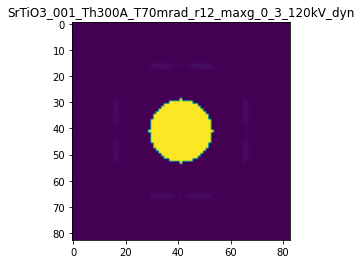

R-factor: 6.993660352732622e-07

>>> producing the 2. dataset...

The offset applied on thickness: -8.355798373968604e-05

The offset applied on Ug: 0.0007215967035428772

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.91644201626025
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

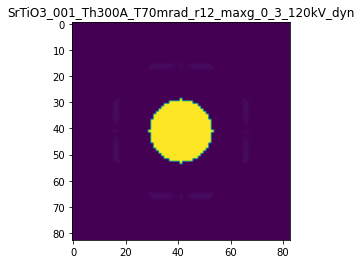

R-factor: 1.0537707140773222e-07

>>> producing the 3. dataset...

The offset applied on thickness: -0.00034435062941901153

The offset applied on Ug: 0.0006177195325183016

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.655649370581
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

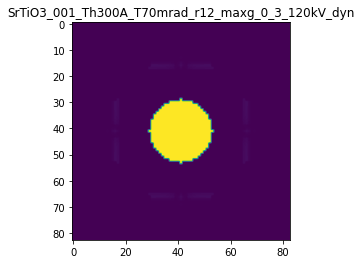

R-factor: 4.3354992146919754e-07

>>> producing the 4. dataset...

The offset applied on thickness: -0.0006503792758216904

The offset applied on Ug: 0.00944966742710128

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3496207241783
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

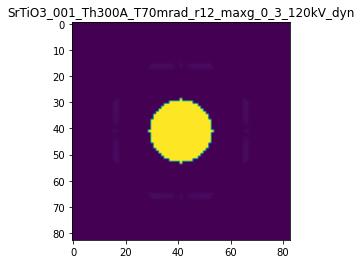

R-factor: 8.21788160004037e-07

>>> producing the 5. dataset...

The offset applied on thickness: 0.00034670780149538284

The offset applied on Ug: 0.0011317154832300735

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.34670780149537
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

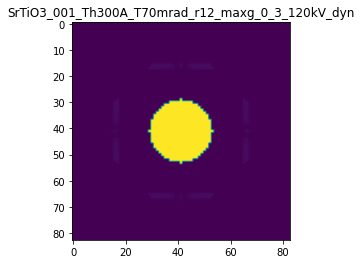

R-factor: 4.3791547289691787e-07

>>> producing the 6. dataset...

The offset applied on thickness: 0.000710502419679991

The offset applied on Ug: -0.005547328915226309

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.71050241968
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

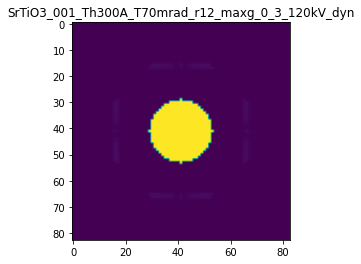

R-factor: 8.974360019805499e-07

>>> producing the 7. dataset...

The offset applied on thickness: -0.0005463843487538194

The offset applied on Ug: -0.007004723183716546

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4536156512462
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

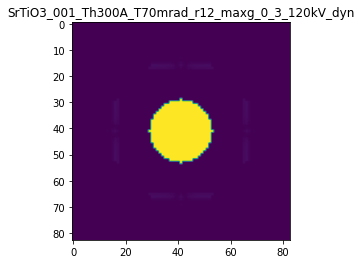

R-factor: 6.940223280434612e-07

>>> producing the 8. dataset...

The offset applied on thickness: 0.0007426157711489914

The offset applied on Ug: 0.003752125848277257

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.74261577114896
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

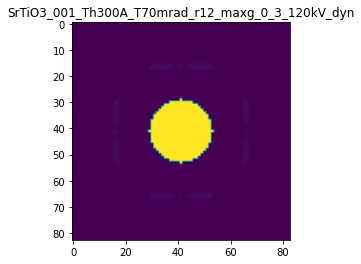

R-factor: 9.40032079039277e-07

>>> producing the 9. dataset...

The offset applied on thickness: -0.0009992204108136148

The offset applied on Ug: -0.0023197323342615795

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0007795891864
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

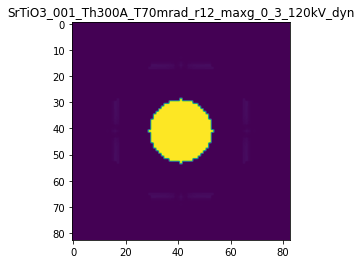

R-factor: 1.2577115255289577e-06

>>> producing the 10. dataset...

The offset applied on thickness: -0.0006270995323054227

The offset applied on Ug: 0.004848514694278645

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.37290046769454
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

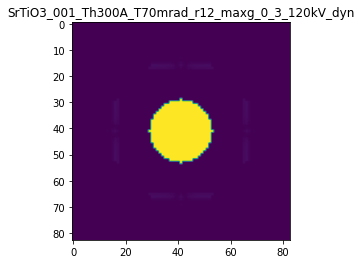

R-factor: 7.901181253089688e-07

>>> producing the 11. dataset...

The offset applied on thickness: -0.00039961443070104277

The offset applied on Ug: 0.00969555288597482

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.60038556929896
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

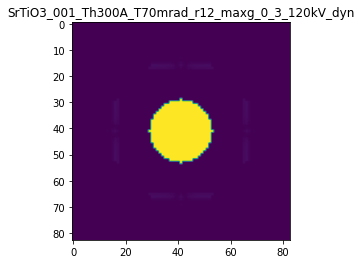

R-factor: 5.105750899245215e-07

>>> producing the 12. dataset...

The offset applied on thickness: 0.0001714022094870402

The offset applied on Ug: 0.0007747728308779478

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.17140220948704
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

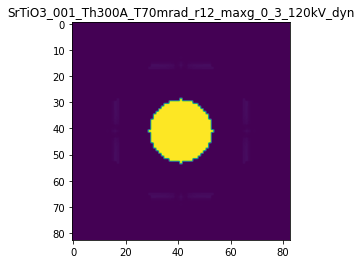

R-factor: 2.166424824531413e-07

>>> producing the 13. dataset...

The offset applied on thickness: -0.00021034928211060455

The offset applied on Ug: 0.004314061158957871

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7896507178894
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

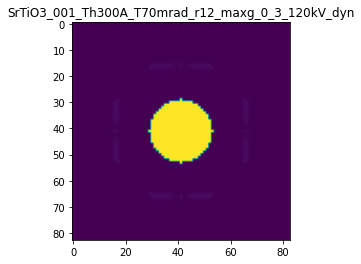

R-factor: 2.675451497967051e-07

>>> producing the 14. dataset...

The offset applied on thickness: -0.0008076872575784855

The offset applied on Ug: 0.003833626761329165

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1923127424215
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

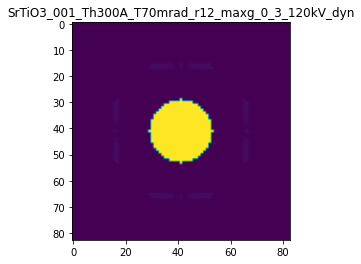

R-factor: 1.016699853154816e-06

>>> producing the 15. dataset...

The offset applied on thickness: -2.8767637934001833e-07

The offset applied on Ug: -0.0030728106297330895

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.99971232362066
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_f

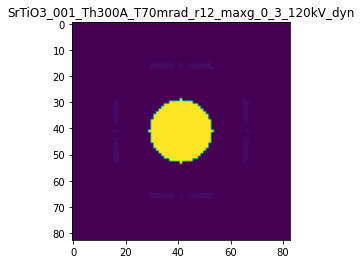

R-factor: 1.872723701611647e-08

>>> producing the 16. dataset...

The offset applied on thickness: -0.0009541357461950575

The offset applied on Ug: -0.00020549743819706423

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0458642538049
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

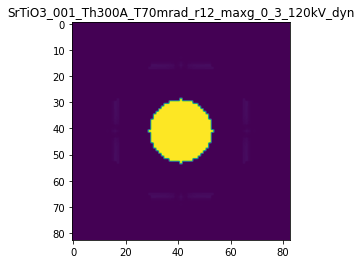

R-factor: 1.1995331289913892e-06

>>> producing the 17. dataset...

The offset applied on thickness: 0.00032436974150137487

The offset applied on Ug: -0.0056537640828092876

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.32436974150136
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_f

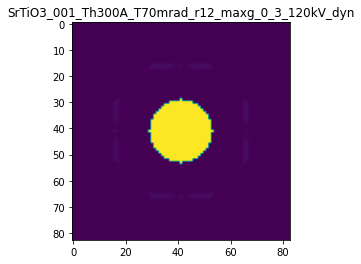

R-factor: 4.1167376631722473e-07

>>> producing the 18. dataset...

The offset applied on thickness: 0.0008001708534380657

The offset applied on Ug: -0.00598387473538409

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8001708534381
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

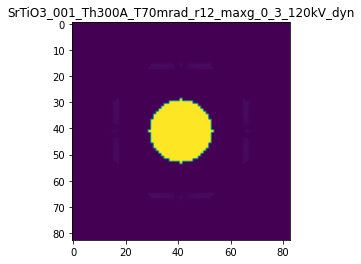

R-factor: 1.010795602568308e-06

>>> producing the 19. dataset...

The offset applied on thickness: -5.0676954598728895e-05

The offset applied on Ug: -0.0046517925806397065

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9493230454013
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

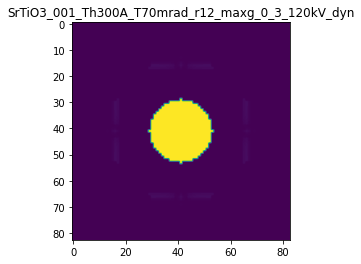

R-factor: 7.067543571852927e-08

>>> producing the 20. dataset...

The offset applied on thickness: 0.0008828299616476529

The offset applied on Ug: -0.004275749640745952

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.88282996164764
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

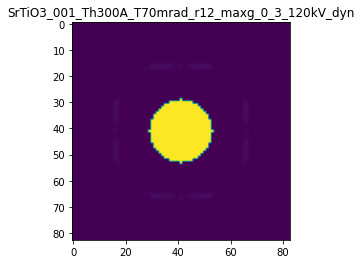

R-factor: 1.1147689382270975e-06

>>> producing the 21. dataset...

The offset applied on thickness: 0.00037706488674677365

The offset applied on Ug: 0.0047337564787686805

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3770648867468
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

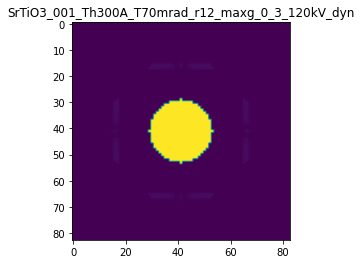

R-factor: 4.797927131649056e-07

>>> producing the 22. dataset...

The offset applied on thickness: -0.0006379653460218464

The offset applied on Ug: 0.008123404331733084

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3620346539781
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

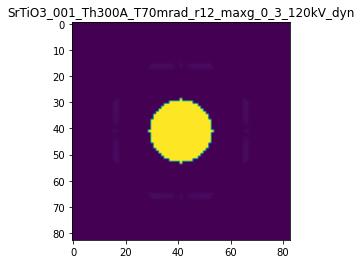

R-factor: 8.048348660642437e-07

>>> producing the 23. dataset...

The offset applied on thickness: -0.0009263971652774498

The offset applied on Ug: -0.008699039446752757

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0736028347226
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

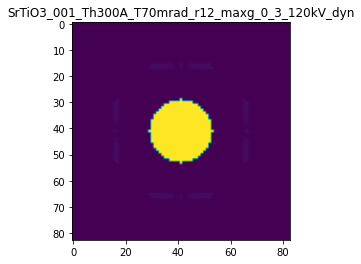

R-factor: 1.1725048740497307e-06

>>> producing the 24. dataset...

The offset applied on thickness: -0.0003563002520285954

The offset applied on Ug: 0.004495195532084317

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.64369974797137
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

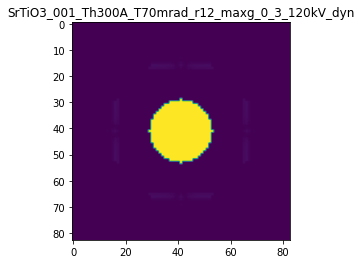

R-factor: 4.4966358035836406e-07

>>> producing the 25. dataset...

The offset applied on thickness: 0.00012811564665973218

The offset applied on Ug: -0.00728678674602252

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1281156466597
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

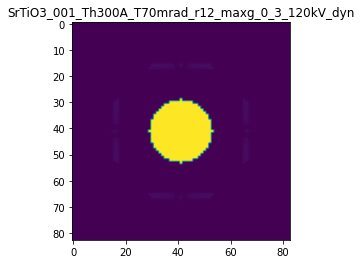

R-factor: 1.749409586397437e-07

>>> producing the 26. dataset...

The offset applied on thickness: 0.0009626188585889648

The offset applied on Ug: 0.0009850716641841316

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.96261885858894
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

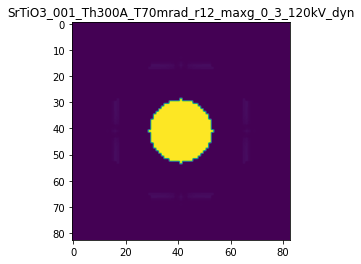

R-factor: 1.215230882491385e-06

>>> producing the 27. dataset...

The offset applied on thickness: -0.0002271155920837622

The offset applied on Ug: 0.009976802252630517

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7728844079162
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

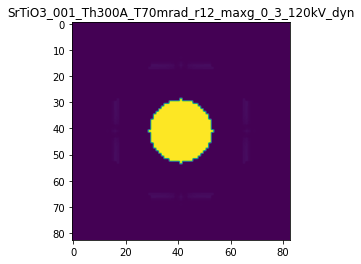

R-factor: 3.0059194551491406e-07

>>> producing the 28. dataset...

The offset applied on thickness: 0.0005372296881734191

The offset applied on Ug: -0.000812821056472679

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5372296881734
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

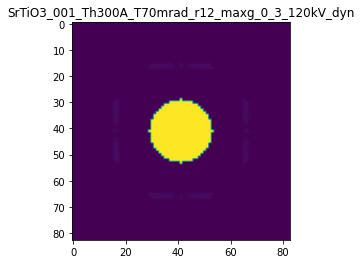

R-factor: 6.774760088021318e-07

>>> producing the 29. dataset...

The offset applied on thickness: 0.0001873077880253704

The offset applied on Ug: 0.00817801057803383

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1873077880254
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

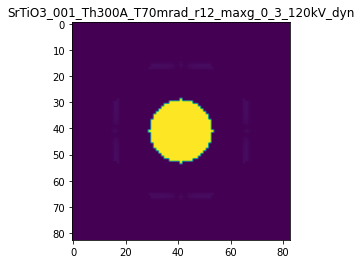

R-factor: 2.463571887846198e-07

>>> producing the 30. dataset...

The offset applied on thickness: 4.0542632734635654e-05

The offset applied on Ug: -0.0026699526275048746

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0405426327346
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

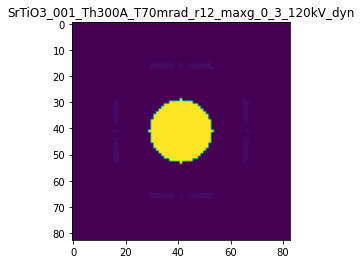

R-factor: 5.6795806574267565e-08

>>> producing the 31. dataset...

The offset applied on thickness: -0.000183931394217127

The offset applied on Ug: -0.0007935763629055015

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.81606860578285
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

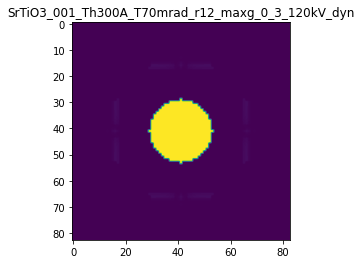

R-factor: 2.3221067199648843e-07

>>> producing the 32. dataset...

The offset applied on thickness: 0.0003290013427439147

The offset applied on Ug: -0.0008595096240779454

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.32900134274394
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

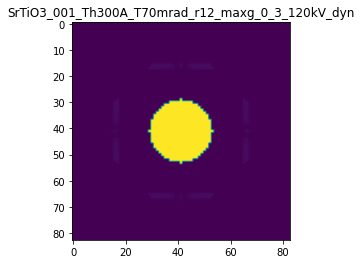

R-factor: 4.1483697485318427e-07

>>> producing the 33. dataset...

The offset applied on thickness: 0.0008487192067679506

The offset applied on Ug: 0.005738234682938445

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8487192067679
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

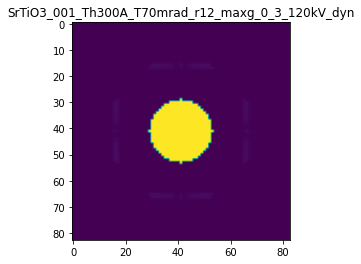

R-factor: 1.0760147166377057e-06

>>> producing the 34. dataset...

The offset applied on thickness: -0.0008379258842687667

The offset applied on Ug: 0.0012674414815110513

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.16207411573123
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

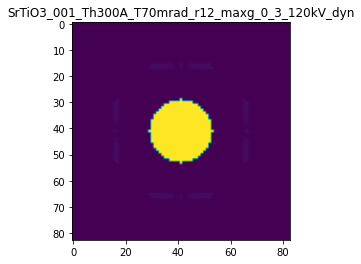

R-factor: 1.0540182858886006e-06

>>> producing the 35. dataset...

The offset applied on thickness: -0.000988242470555945

The offset applied on Ug: -0.002379789751542365

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.011757529444
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

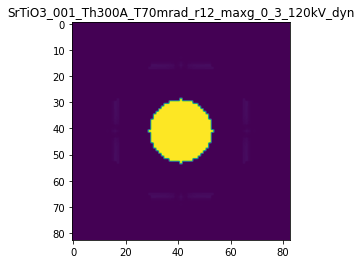

R-factor: 1.244002649827248e-06

>>> producing the 36. dataset...

The offset applied on thickness: -0.0008061869939151831

The offset applied on Ug: 0.003053653419013298

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.19381300608484
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

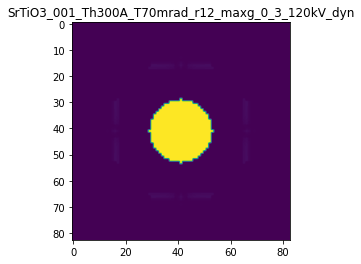

R-factor: 1.014616650758585e-06

>>> producing the 37. dataset...

The offset applied on thickness: -7.383085930882061e-05

The offset applied on Ug: 0.0009311987448552018

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9261691406912
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

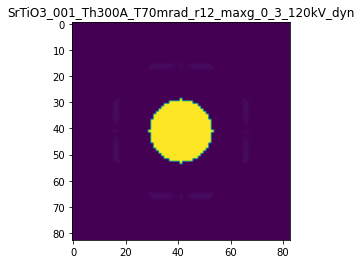

R-factor: 9.3202384138774e-08

>>> producing the 38. dataset...

The offset applied on thickness: -0.0009262781712239581

The offset applied on Ug: 0.007033209774727829

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.073721828776
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

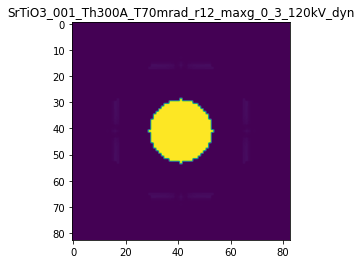

R-factor: 1.1664022696018477e-06

>>> producing the 39. dataset...

The offset applied on thickness: 5.949643854385123e-06

The offset applied on Ug: 0.0030220814248794036

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.00594964385436
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

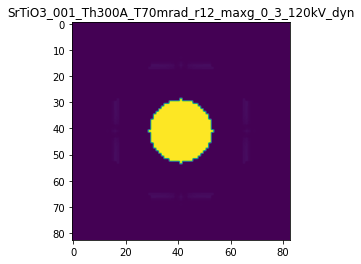

R-factor: 1.8715416892150458e-08

>>> producing the 40. dataset...

The offset applied on thickness: -0.00040718153724736287

The offset applied on Ug: 0.0072554365966495

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.59281846275263
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

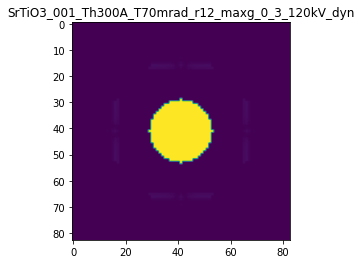

R-factor: 5.162282135068703e-07

>>> producing the 41. dataset...

The offset applied on thickness: -0.0008686772150753916

The offset applied on Ug: -0.007442826433001062

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1313227849246
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

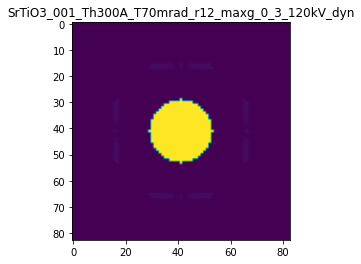

R-factor: 1.0988878556975457e-06

>>> producing the 42. dataset...

The offset applied on thickness: -0.0008148678858075949

The offset applied on Ug: -0.005516119653277405

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1851321141924
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

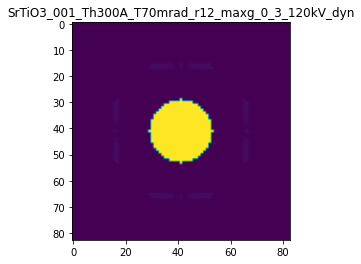

R-factor: 1.0295196442426272e-06

>>> producing the 43. dataset...

The offset applied on thickness: -4.154360556429926e-05

The offset applied on Ug: -0.008062051525755549

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9584563944357
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

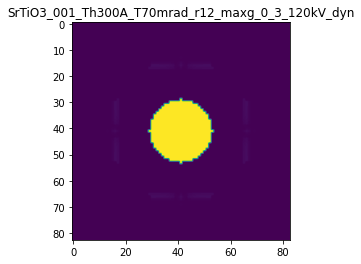

R-factor: 6.785468822248911e-08

>>> producing the 44. dataset...

The offset applied on thickness: -0.0003762633072040491

The offset applied on Ug: -0.0014947252406502054

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.62373669279594
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

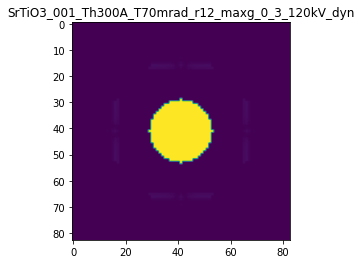

R-factor: 4.747604848139966e-07

>>> producing the 45. dataset...

The offset applied on thickness: 0.0009428085537212186

The offset applied on Ug: 0.009507674492633478

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9428085537212
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

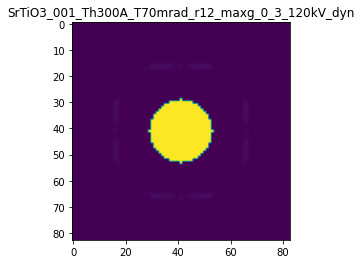

R-factor: 1.1986354529494582e-06

>>> producing the 46. dataset...

The offset applied on thickness: -0.0003676796344276085

The offset applied on Ug: -0.0055989314420076645

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.63232036557235
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_f

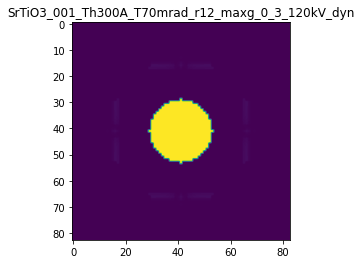

R-factor: 4.6841814436112265e-07

>>> producing the 47. dataset...

The offset applied on thickness: 0.0009736806349480783

The offset applied on Ug: -0.007465161973071835

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.97368063494804
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

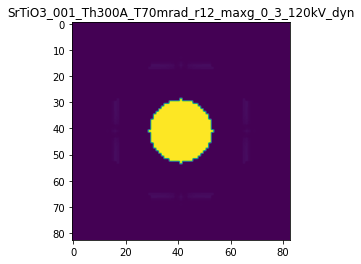

R-factor: 1.2304189558217195e-06

>>> producing the 48. dataset...

The offset applied on thickness: 0.000137829269958889

The offset applied on Ug: -0.008759756755719142

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.13782926995884
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

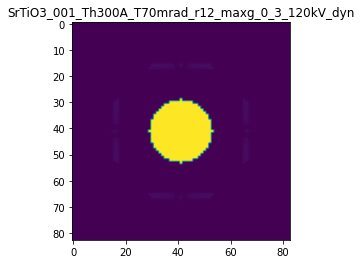

R-factor: 1.918128624558345e-07

>>> producing the 49. dataset...

The offset applied on thickness: -0.0003473160862638851

The offset applied on Ug: -0.000994873177398925

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6526839137361
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

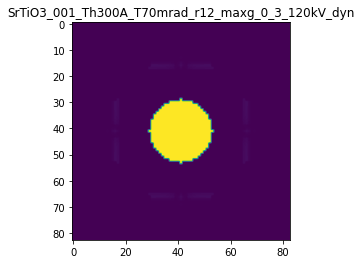

R-factor: 4.378881029218506e-07

>>> producing the 50. dataset...

The offset applied on thickness: 0.00013630429140169676

The offset applied on Ug: -0.00371829326697265

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1363042914017
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

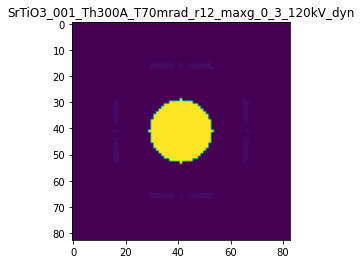

R-factor: 1.7503854694529555e-07

>>> producing the 51. dataset...

The offset applied on thickness: 0.0007733519452454361

The offset applied on Ug: -0.0017718217333261954

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7733519452454
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

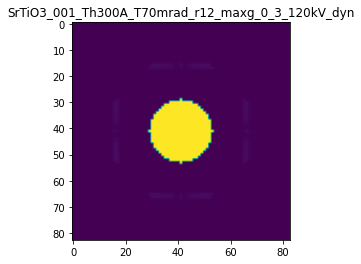

R-factor: 9.758109154105272e-07

>>> producing the 52. dataset...

The offset applied on thickness: 0.0002598578869418053

The offset applied on Ug: -0.0007680337971495077

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2598578869418
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

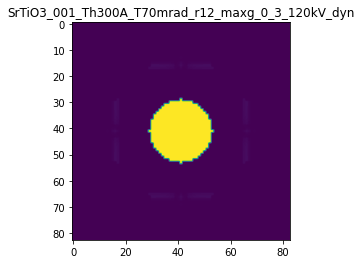

R-factor: 3.2764185162483374e-07

>>> producing the 53. dataset...

The offset applied on thickness: -0.0008758435790632958

The offset applied on Ug: 0.0010340941335018926

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1241564209367
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

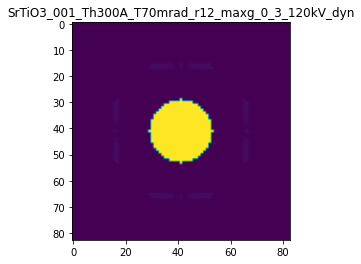

R-factor: 1.1015653188092038e-06

>>> producing the 54. dataset...

The offset applied on thickness: -0.0009697934833230275

The offset applied on Ug: 0.0006079509117911952

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.03020651667697
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

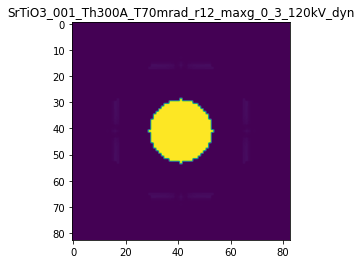

R-factor: 1.219388176146351e-06

>>> producing the 55. dataset...

The offset applied on thickness: 3.1511452140407624e-05

The offset applied on Ug: 0.0021871584400500856

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0315114521404
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

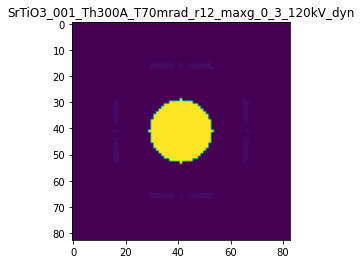

R-factor: 4.276489081806695e-08

>>> producing the 56. dataset...

The offset applied on thickness: -0.0005961925475915968

The offset applied on Ug: 0.0019944690615377424

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4038074524084
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

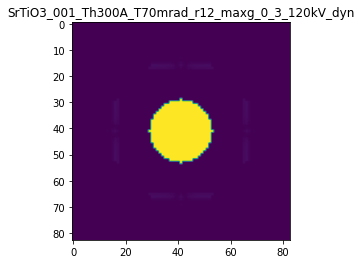

R-factor: 7.50546601001695e-07

>>> producing the 57. dataset...

The offset applied on thickness: -2.956559183126917e-05

The offset applied on Ug: -0.0015691898980962483

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9704344081687
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

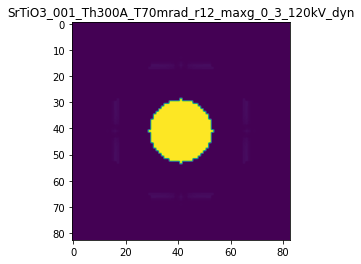

R-factor: 3.922957015956583e-08

>>> producing the 58. dataset...

The offset applied on thickness: -0.0009269533002301089

The offset applied on Ug: 0.004745038850440728

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.07304669976986
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

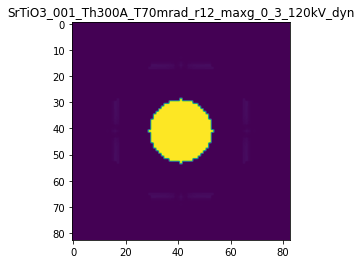

R-factor: 1.1666651450489901e-06

>>> producing the 59. dataset...

The offset applied on thickness: 0.00011200110558313781

The offset applied on Ug: -0.001525801596799481

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1120011055831
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

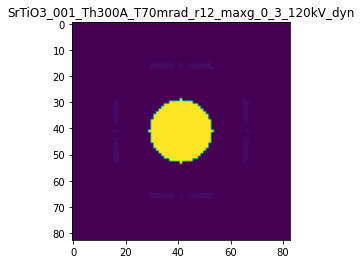

R-factor: 1.4162353429231838e-07

>>> producing the 60. dataset...

The offset applied on thickness: 0.0003540084574214664

The offset applied on Ug: -0.009049723557444347

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.35400845742146
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

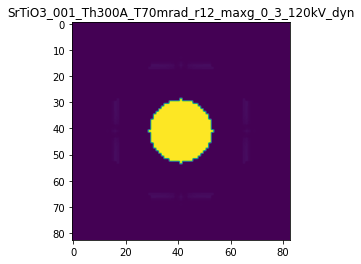

R-factor: 4.537533654568096e-07

>>> producing the 61. dataset...

The offset applied on thickness: 1.9160712681552505e-05

The offset applied on Ug: -0.0012252554001894755

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0191607126815
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

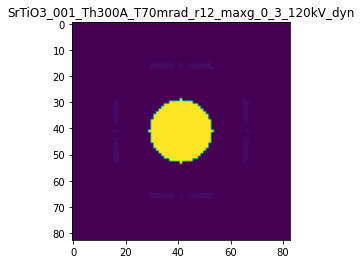

R-factor: 2.6705745481522215e-08

>>> producing the 62. dataset...

The offset applied on thickness: -0.0005720970069532423

The offset applied on Ug: -0.004865048598922399

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4279029930467
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

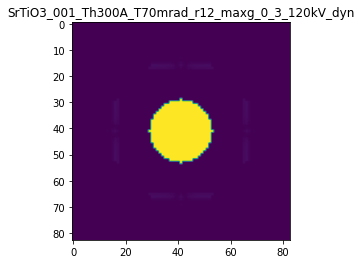

R-factor: 7.240905237689259e-07

>>> producing the 63. dataset...

The offset applied on thickness: 0.00035427980361437593

The offset applied on Ug: 0.003086073340892457

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.35427980361436
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

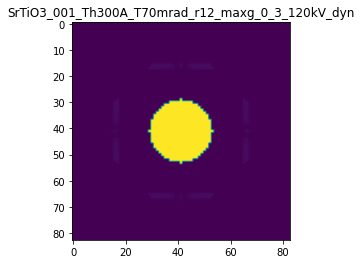

R-factor: 4.494048643487457e-07

>>> producing the 64. dataset...

The offset applied on thickness: 0.0003983125254885316

The offset applied on Ug: 0.004391207431542512

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.39831252548856
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

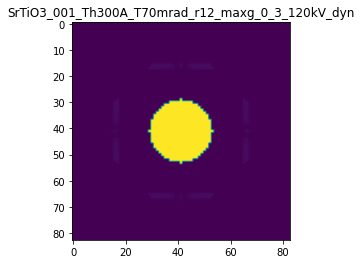

R-factor: 5.062186279585507e-07

>>> producing the 65. dataset...

The offset applied on thickness: 0.00019110121671095026

The offset applied on Ug: 0.0036723735061987184

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.19110121671093
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

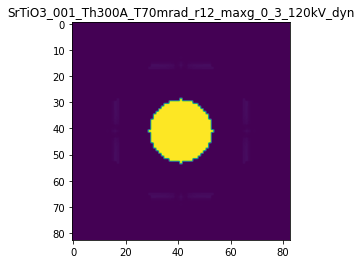

R-factor: 2.448430442856873e-07

>>> producing the 66. dataset...

The offset applied on thickness: -0.00047931536708357015

The offset applied on Ug: 0.0049296923620399235

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5206846329164
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

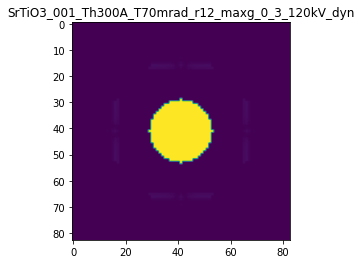

R-factor: 6.043894433660131e-07

>>> producing the 67. dataset...

The offset applied on thickness: -0.00033140587632181416

The offset applied on Ug: 0.009090825676288909

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6685941236782
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

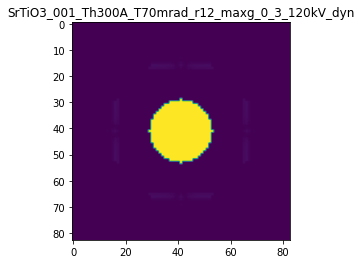

R-factor: 4.2520638036272844e-07

>>> producing the 68. dataset...

The offset applied on thickness: 0.000477793765097472

The offset applied on Ug: 0.005108743556758202

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4777937650975
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

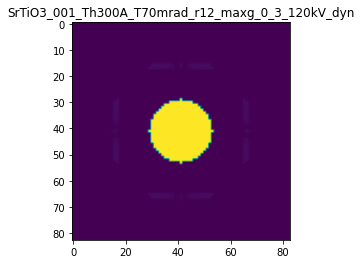

R-factor: 6.071670812355377e-07

>>> producing the 69. dataset...

The offset applied on thickness: 0.0007361744737580497

The offset applied on Ug: -0.006573957314804593

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.73617447375807
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

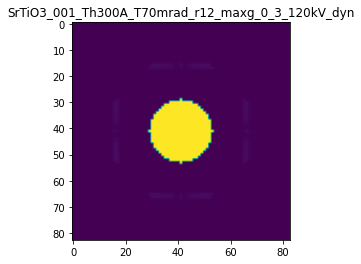

R-factor: 9.301237571717356e-07

>>> producing the 70. dataset...

The offset applied on thickness: -0.0003629464872012944

The offset applied on Ug: 0.009674972529602074

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6370535127987
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

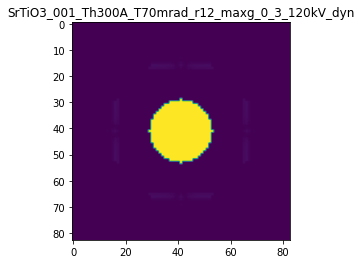

R-factor: 4.6518595387173813e-07

>>> producing the 71. dataset...

The offset applied on thickness: 0.000835178581576854

The offset applied on Ug: -0.003979297666178039

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8351785815768
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

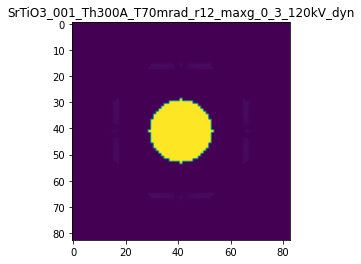

R-factor: 1.0544889866370072e-06

>>> producing the 72. dataset...

The offset applied on thickness: 0.0005153278828284271

The offset applied on Ug: -0.0011290866042857717

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.51532788282844
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

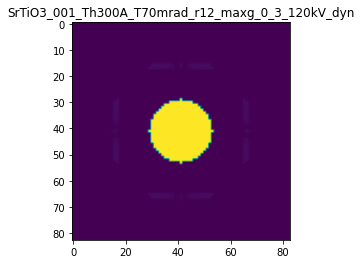

R-factor: 6.499212658327311e-07

>>> producing the 73. dataset...

The offset applied on thickness: -0.0001251199828627325

The offset applied on Ug: -0.008308953744684702

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.87488001713723
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

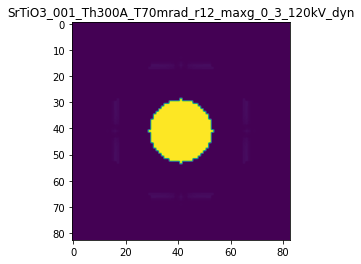

R-factor: 1.6894382571270414e-07

>>> producing the 74. dataset...

The offset applied on thickness: 0.0005498399415148674

The offset applied on Ug: -0.0012995672010905834

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.54983994151485
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

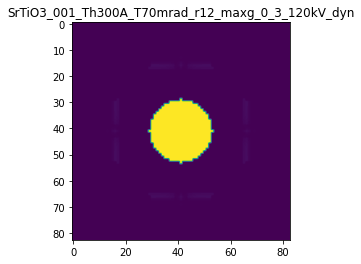

R-factor: 6.935140694036468e-07

>>> producing the 75. dataset...

The offset applied on thickness: 0.0007260545999606434

The offset applied on Ug: -0.005261076304387247

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.72605459996066
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

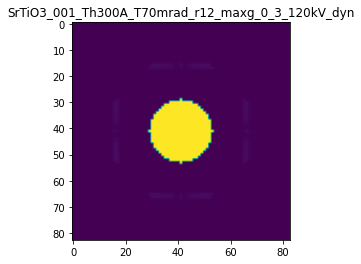

R-factor: 9.169994935700044e-07

>>> producing the 76. dataset...

The offset applied on thickness: -0.0006917331767849034

The offset applied on Ug: 0.008035958815717984

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3082668232151
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

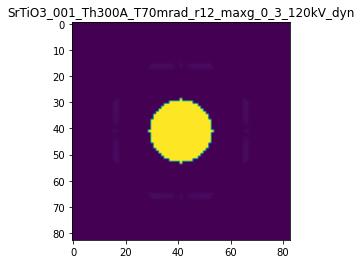

R-factor: 8.721454847512589e-07

>>> producing the 77. dataset...

The offset applied on thickness: 0.00016651443521552834

The offset applied on Ug: 0.0028947357115839934

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1665144352155
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

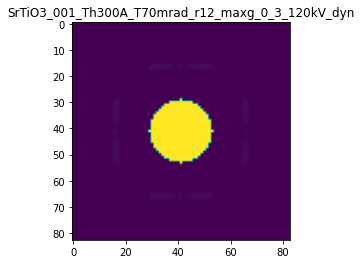

R-factor: 2.1291526504292615e-07

>>> producing the 78. dataset...

The offset applied on thickness: 0.0006765302547673919

The offset applied on Ug: -0.008834359114027655

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6765302547674
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

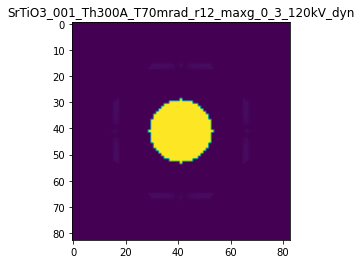

R-factor: 8.557678178685766e-07

>>> producing the 79. dataset...

The offset applied on thickness: -8.17568299278526e-06

The offset applied on Ug: 0.007279063435038875

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.99182431700723
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

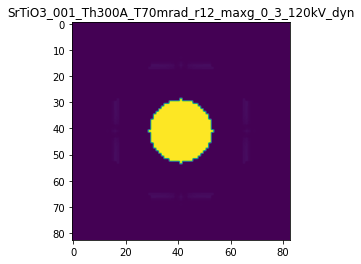

R-factor: 4.986758943753957e-08

>>> producing the 80. dataset...

The offset applied on thickness: -0.0008481781138274594

The offset applied on Ug: 0.00886645579961697

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1518218861725
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

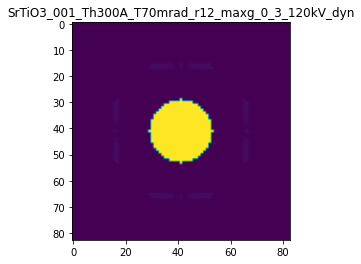

R-factor: 1.0688300425433176e-06

>>> producing the 81. dataset...

The offset applied on thickness: 0.0009436363066788329

The offset applied on Ug: 0.00022780828790088138

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9436363066788
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

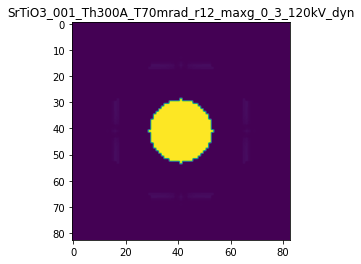

R-factor: 1.1906717656310303e-06

>>> producing the 82. dataset...

The offset applied on thickness: -0.00023706952577243646

The offset applied on Ug: 0.004768263605853036

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7629304742275
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

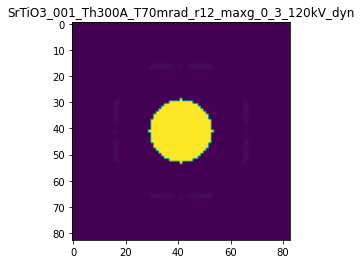

R-factor: 3.013653392995333e-07

>>> producing the 83. dataset...

The offset applied on thickness: -0.00036893605210508283

The offset applied on Ug: -0.004739124976403884

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6310639478949
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

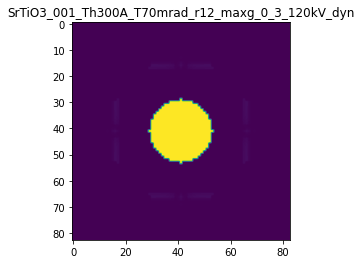

R-factor: 4.6880597344869625e-07

>>> producing the 84. dataset...

The offset applied on thickness: 0.0002460161804968468

The offset applied on Ug: -0.008889080016149667

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.24601618049684
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

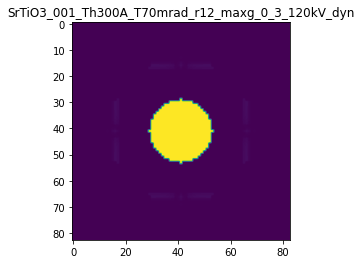

R-factor: 3.2030171260099523e-07

>>> producing the 85. dataset...

The offset applied on thickness: -0.0007246008829957249

The offset applied on Ug: 0.003840593174301148

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2753991170042
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

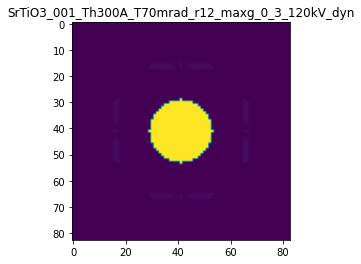

R-factor: 9.12352980456529e-07

>>> producing the 86. dataset...

The offset applied on thickness: -2.5924576208854245e-05

The offset applied on Ug: 0.008380522264133475

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.97407542379113
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

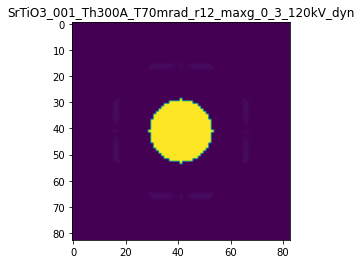

R-factor: 7.08116818428459e-08

>>> producing the 87. dataset...

The offset applied on thickness: 0.0005556349056610688

The offset applied on Ug: 0.004123282048438948

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.55563490566107
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

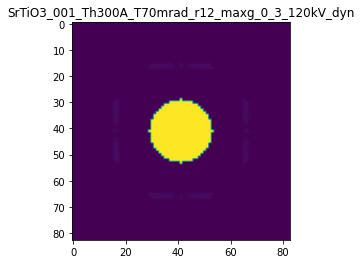

R-factor: 7.043857462483402e-07

>>> producing the 88. dataset...

The offset applied on thickness: -0.00015654796000779436

The offset applied on Ug: -0.007524150520849433

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8434520399922
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

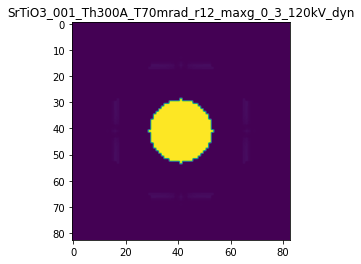

R-factor: 2.0668649094643595e-07

>>> producing the 89. dataset...

The offset applied on thickness: -0.0006521893273239734

The offset applied on Ug: 0.004036581270678019

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.347810672676
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

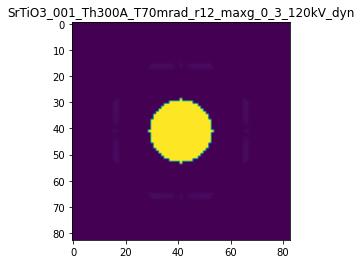

R-factor: 8.214344470648079e-07

>>> producing the 90. dataset...

The offset applied on thickness: 0.00012723534859719667

The offset applied on Ug: 0.005812225426499462

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1272353485972
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

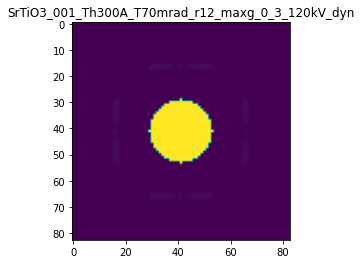

R-factor: 1.6770196528765907e-07

>>> producing the 91. dataset...

The offset applied on thickness: 0.0008105784927469213

The offset applied on Ug: 0.0028034300764455213

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8105784927469
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

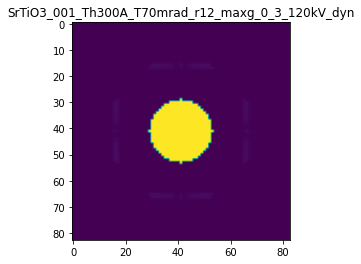

R-factor: 1.0249241171591804e-06

>>> producing the 92. dataset...

The offset applied on thickness: -4.1479621434208136e-05

The offset applied on Ug: -0.006477417634468023

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9585203785658
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

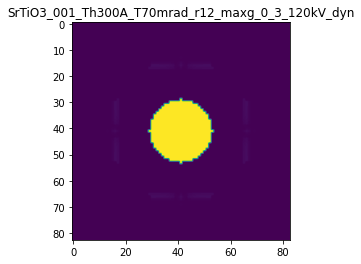

R-factor: 6.325429123599411e-08

>>> producing the 93. dataset...

The offset applied on thickness: -0.0004713902285220235

The offset applied on Ug: -0.0034440031952948868

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.52860977147793
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

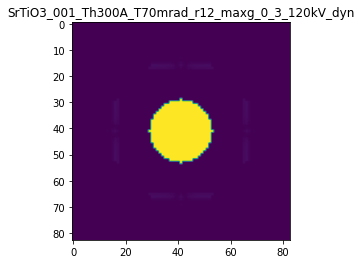

R-factor: 5.961968977775537e-07

>>> producing the 94. dataset...

The offset applied on thickness: -0.0009641007754734346

The offset applied on Ug: 0.008770658198787602

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.03589922452653
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

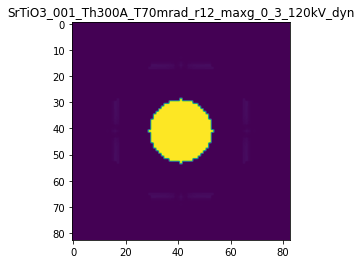

R-factor: 1.2143173611763062e-06

>>> producing the 95. dataset...

The offset applied on thickness: 0.0005615533046202534

The offset applied on Ug: 0.004051285413506798

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.56155330462025
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

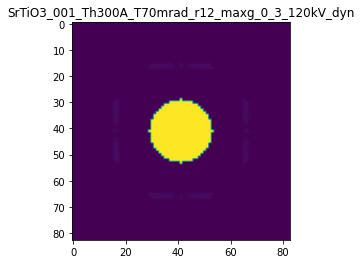

R-factor: 7.117815722538767e-07

>>> producing the 96. dataset...

The offset applied on thickness: -0.00029549542650819086

The offset applied on Ug: 0.00981599106542969

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7045045734918
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

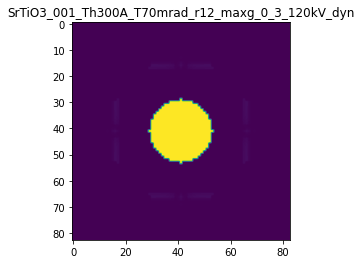

R-factor: 3.822200958022786e-07

>>> producing the 97. dataset...

The offset applied on thickness: 0.00026979402979648273

The offset applied on Ug: -0.003522032846421299

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.26979402979646
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

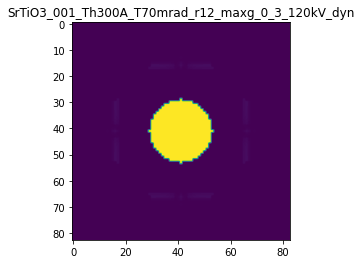

R-factor: 3.410336509186046e-07

>>> producing the 98. dataset...

The offset applied on thickness: 0.0006173372958664074

The offset applied on Ug: 0.005035243537289009

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6173372958664
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

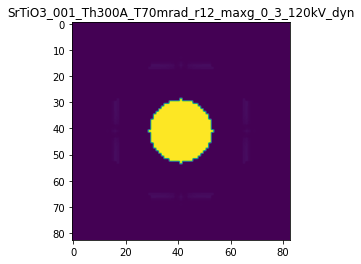

R-factor: 7.831524637913949e-07

>>> producing the 99. dataset...

The offset applied on thickness: -0.0009851851122598034

The offset applied on Ug: 0.0005430223147573754

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.01481488774016
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

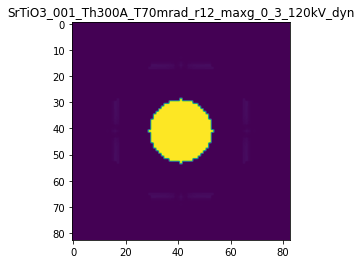

R-factor: 1.2386880970054085e-06

>>> producing the 100. dataset...

The offset applied on thickness: 0.00014752677105619582

The offset applied on Ug: -0.008454770645462358

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.14752677105616
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_f

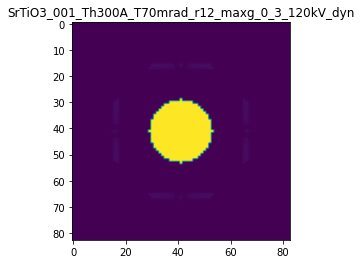

R-factor: 2.0169966695420577e-07

>>> producing the 101. dataset...

The offset applied on thickness: -0.0008817823078195952

The offset applied on Ug: 0.008134647256464608

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1182176921804
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

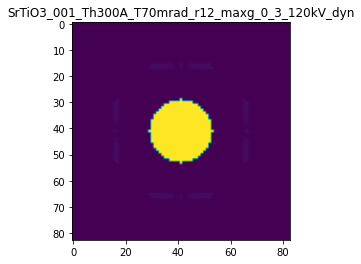

R-factor: 1.1108299914783264e-06

>>> producing the 102. dataset...

The offset applied on thickness: 0.00016145012768826162

The offset applied on Ug: -0.0013531560040751934

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1614501276882
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_f

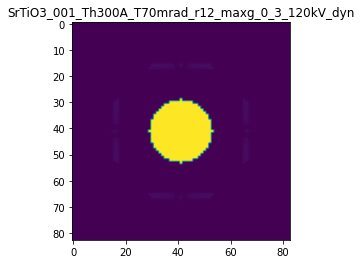

R-factor: 2.0376355581805259e-07

>>> producing the 103. dataset...

The offset applied on thickness: 0.0007258012495329798

The offset applied on Ug: -0.002037305931462874

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.725801249533
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

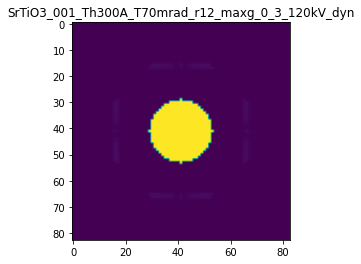

R-factor: 9.158306432206504e-07

>>> producing the 104. dataset...

The offset applied on thickness: -0.0007026187617950137

The offset applied on Ug: 0.0007688729218210711

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.297381238205
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

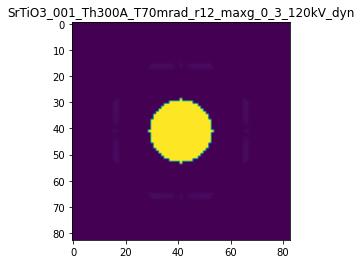

R-factor: 8.839588998105126e-07

>>> producing the 105. dataset...

The offset applied on thickness: -0.0006263998210800541

The offset applied on Ug: 0.00535070525327714

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.37360017891996
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

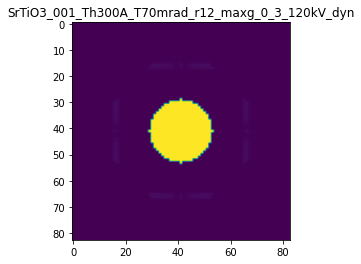

R-factor: 7.89368362683696e-07

>>> producing the 106. dataset...

The offset applied on thickness: -0.00010491294465370494

The offset applied on Ug: -0.004907441951952434

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.89508705534627
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

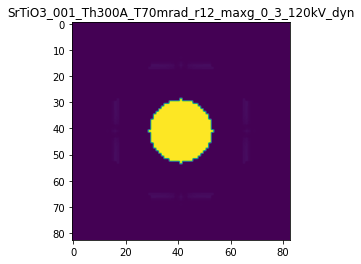

R-factor: 1.3832497368671126e-07

>>> producing the 107. dataset...

The offset applied on thickness: 0.00036720308047735387

The offset applied on Ug: -0.006289513452847577

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.36720308047734
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_f

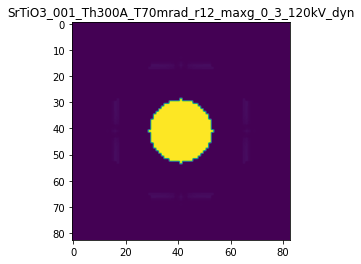

R-factor: 4.6594240039424055e-07

>>> producing the 108. dataset...

The offset applied on thickness: -0.0009934885183123159

The offset applied on Ug: -0.0028199170222338353

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.00651148168765
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_

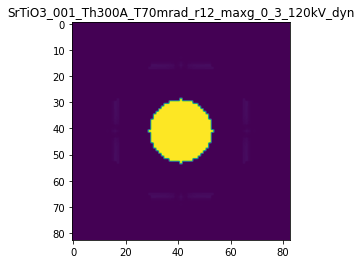

R-factor: 1.2510034219562877e-06

>>> producing the 109. dataset...

The offset applied on thickness: 0.0005803316586866412

The offset applied on Ug: -0.005677427910433855

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.58033165868665
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

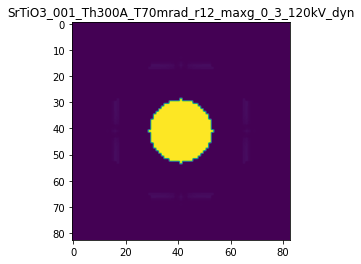

R-factor: 7.331386722458221e-07

>>> producing the 110. dataset...

The offset applied on thickness: 0.0005298462363222163

The offset applied on Ug: 0.0011192247915560282

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5298462363222
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

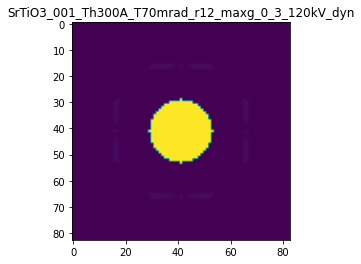

R-factor: 6.688613251484286e-07

>>> producing the 111. dataset...

The offset applied on thickness: -0.0009889363529574503

The offset applied on Ug: 0.002064862334769293

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.01106364704253
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

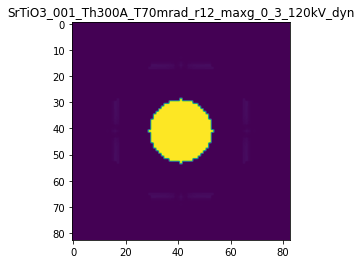

R-factor: 1.2437769549556576e-06

>>> producing the 112. dataset...

The offset applied on thickness: 0.0007279143695616146

The offset applied on Ug: -0.007558879924912074

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7279143695616
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

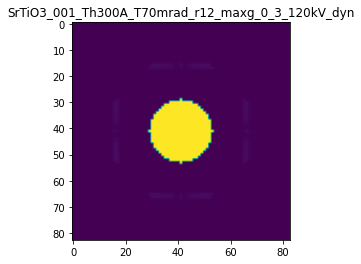

R-factor: 9.199507597322665e-07

>>> producing the 113. dataset...

The offset applied on thickness: -0.0006264104371457353

The offset applied on Ug: 0.0034580044535546394

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.37358956285425
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

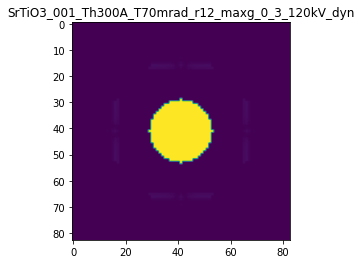

R-factor: 7.888942426519946e-07

>>> producing the 114. dataset...

The offset applied on thickness: -0.00011365584006122265

The offset applied on Ug: -0.004458963200561661

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.88634415993874
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_f

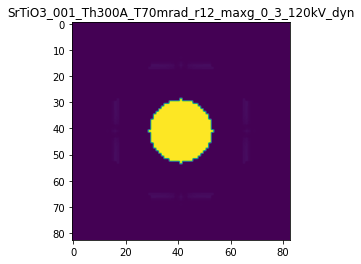

R-factor: 1.486357222585359e-07

>>> producing the 115. dataset...

The offset applied on thickness: -0.0007110724989336237

The offset applied on Ug: -0.00792035115342297

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2889275010664
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

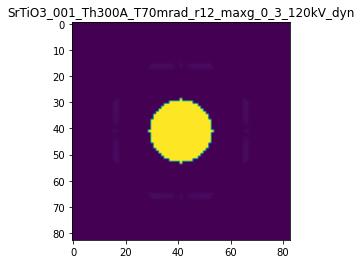

R-factor: 9.015607304232034e-07

>>> producing the 116. dataset...

The offset applied on thickness: 0.0008276098593652845

The offset applied on Ug: 0.0037593778325071825

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8276098593653
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

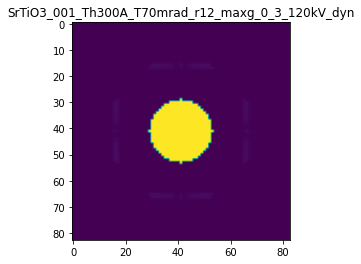

R-factor: 1.0473859270133651e-06

>>> producing the 117. dataset...

The offset applied on thickness: -0.0008559583447834802

The offset applied on Ug: 0.003904311704436472

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.14404165521654
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

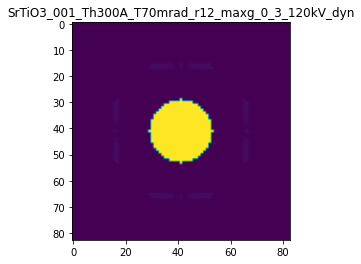

R-factor: 1.0773265391555742e-06

>>> producing the 118. dataset...

The offset applied on thickness: 0.0006055917459439992

The offset applied on Ug: -0.001520769771311279

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.60559174594397
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

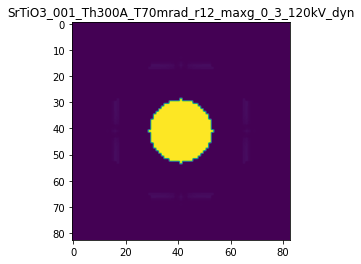

R-factor: 7.639326436792176e-07

>>> producing the 119. dataset...

The offset applied on thickness: -0.0002882922870928333

The offset applied on Ug: 0.00029162451397478194

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7117077129072
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

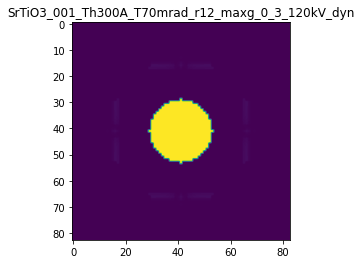

R-factor: 3.629436413022354e-07

>>> producing the 120. dataset...

The offset applied on thickness: -0.0004694818151775591

The offset applied on Ug: 0.008514471754313524

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5305181848224
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

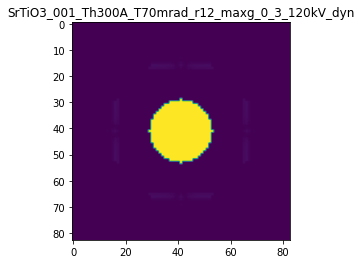

R-factor: 5.953276436053618e-07

>>> producing the 121. dataset...

The offset applied on thickness: 0.0005613847237219725

The offset applied on Ug: -0.0006650535483345843

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.56138472372197
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

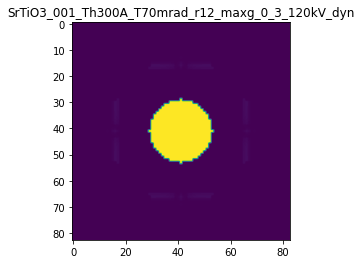

R-factor: 7.079196574034959e-07

>>> producing the 122. dataset...

The offset applied on thickness: -0.000800364350349211

The offset applied on Ug: -0.0069408008673933624

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1996356496508
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

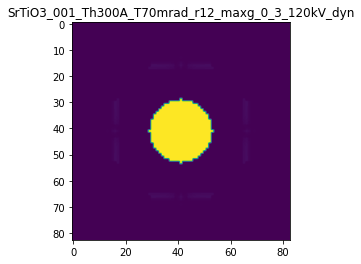

R-factor: 1.0126879968691877e-06

>>> producing the 123. dataset...

The offset applied on thickness: -0.0005677377454699464

The offset applied on Ug: 0.0021834611435099637

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4322622545301
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

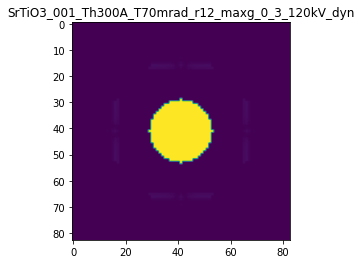

R-factor: 7.148327805235988e-07

>>> producing the 124. dataset...

The offset applied on thickness: 0.00093764204236292

The offset applied on Ug: -0.005145076564556996

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9376420423629
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

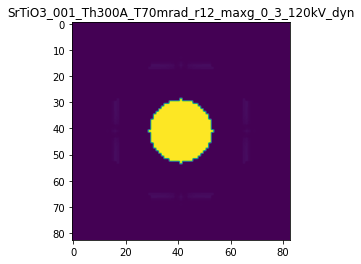

R-factor: 1.1842596867768937e-06

>>> producing the 125. dataset...

The offset applied on thickness: -0.00016350635767155053

The offset applied on Ug: 0.005059092897494275

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.83649364232843
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_f

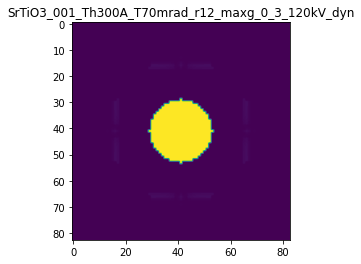

R-factor: 2.1078473959254822e-07

>>> producing the 126. dataset...

The offset applied on thickness: 0.0001717805843046123

The offset applied on Ug: 0.004125109721324789

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1717805843046
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

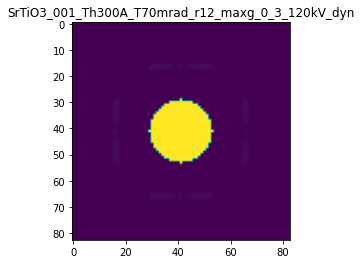

R-factor: 2.2121832386612896e-07

>>> producing the 127. dataset...

The offset applied on thickness: 0.00017367321483361376

The offset applied on Ug: -0.0008331376451771245

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1736732148336
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_f

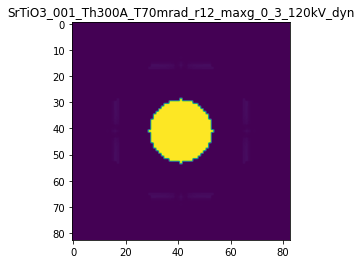

R-factor: 2.190312848206724e-07

>>> producing the 128. dataset...

The offset applied on thickness: -0.00025448449909692283

The offset applied on Ug: -0.0033135590396316393

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7455155009031
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_f

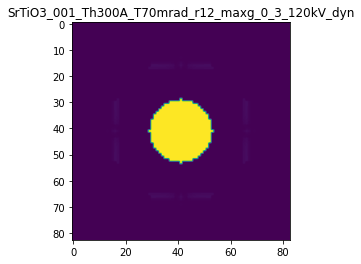

R-factor: 3.2350365994780005e-07

>>> producing the 129. dataset...

The offset applied on thickness: 0.0007781259178960756

The offset applied on Ug: -0.002356657308911592

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.77812591789603
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

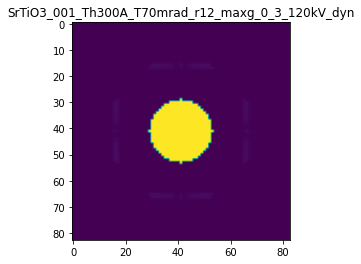

R-factor: 9.819949929843155e-07

>>> producing the 130. dataset...

The offset applied on thickness: 0.000474401903162073

The offset applied on Ug: -0.0035588675229354183

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.47440190316206
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

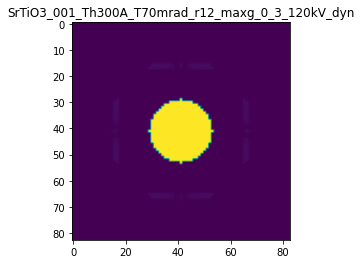

R-factor: 5.989148483243618e-07

>>> producing the 131. dataset...

The offset applied on thickness: -0.0008261228555134073

The offset applied on Ug: 0.00735700482342948

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.17387714448654
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

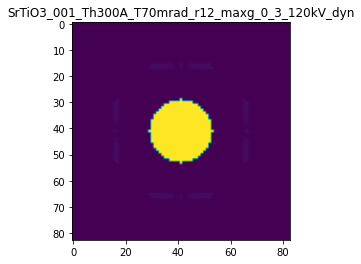

R-factor: 1.0407512366624494e-06

>>> producing the 132. dataset...

The offset applied on thickness: -0.0001837013879556233

The offset applied on Ug: -0.00011751445234304604

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.81629861204436
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal

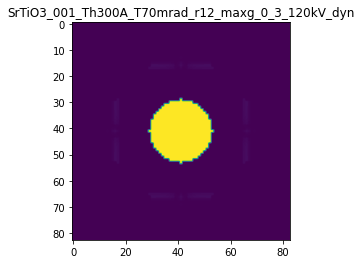

R-factor: 2.3128497430222899e-07

>>> producing the 133. dataset...

The offset applied on thickness: -0.0009521865630070439

The offset applied on Ug: 0.003732628111623084

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.04781343699295
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

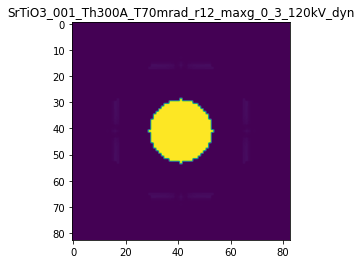

R-factor: 1.1980784258938273e-06

>>> producing the 134. dataset...

The offset applied on thickness: -0.0005303518460921073

The offset applied on Ug: -0.009996055315265961

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4696481539079
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

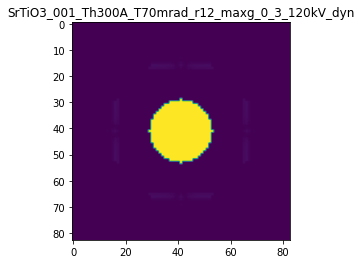

R-factor: 6.78087092051135e-07

>>> producing the 135. dataset...

The offset applied on thickness: -0.0009764413241344236

The offset applied on Ug: -0.007670075749405543

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.02355867586556
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

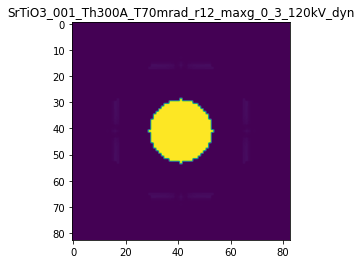

R-factor: 1.2342821743052263e-06

>>> producing the 136. dataset...

The offset applied on thickness: 0.00017477729082998318

The offset applied on Ug: -0.0039018166306857326

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.17477729083
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

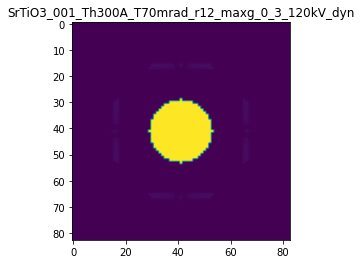

R-factor: 2.2302343384712652e-07

>>> producing the 137. dataset...

The offset applied on thickness: 0.0002648995124154967

The offset applied on Ug: 0.0018500245676799664

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.26489951241547
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

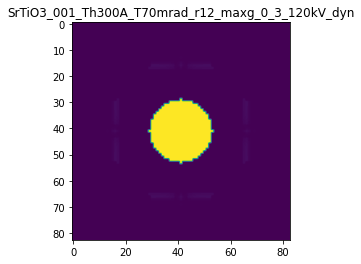

R-factor: 3.355160252022382e-07

>>> producing the 138. dataset...

The offset applied on thickness: -0.0003979048563070602

The offset applied on Ug: 0.0007747081397526312

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6020951436929
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

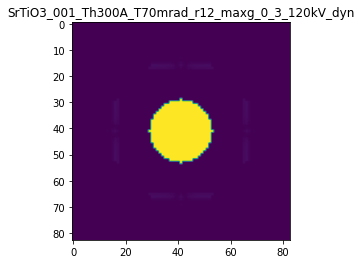

R-factor: 5.009493127581474e-07

>>> producing the 139. dataset...

The offset applied on thickness: 0.0007385054146386934

The offset applied on Ug: 0.007109680943215815

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7385054146387
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

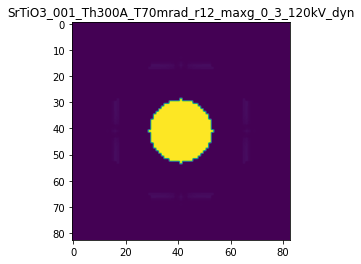

R-factor: 9.381691665412494e-07

>>> producing the 140. dataset...

The offset applied on thickness: 0.00028553243082337997

The offset applied on Ug: 0.0059612320374872255

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.28553243082337
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

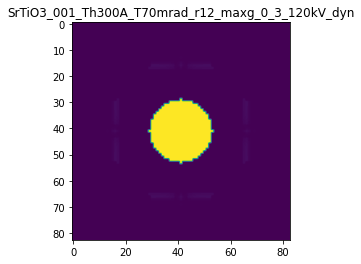

R-factor: 3.665359678039742e-07



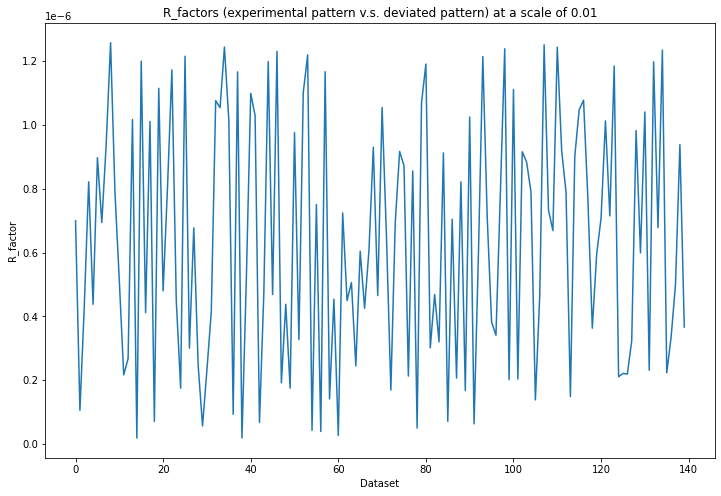

>>> start to train the ANN 

Epoch 1/30
5/5 [==============================] - 1s 205ms/step - loss: 0.3616 - acc: 0.8000 - val_loss: 0.3557 - val_acc: 1.0000
Epoch 2/30
5/5 [==============================] - 1s 107ms/step - loss: 0.3405 - acc: 1.0000 - val_loss: 0.3170 - val_acc: 1.0000
Epoch 3/30
5/5 [==============================] - 1s 108ms/step - loss: 0.2959 - acc: 1.0000 - val_loss: 0.2642 - val_acc: 1.0000
Epoch 4/30
5/5 [==============================] - 1s 108ms/step - loss: 0.2443 - acc: 1.0000 - val_loss: 0.2169 - val_acc: 1.0000
Epoch 5/30
5/5 [==============================] - 1s 107ms/step - loss: 0.1980 - acc: 1.0000 - val_loss: 0.1697 - val_acc: 1.0000
Epoch 6/30
5/5 [==============================] - 1s 108ms/step - loss: 0.1547 - acc: 1.0000 - val_loss: 0.1338 - val_acc: 1.0000
Epoch 7/30
5/5 [==============================] - 1s 108ms/step - loss: 0.1240 - acc: 1.0000 - val_loss: 0.1027 - val_acc: 1.0000
Epoch 8/30
5/5 [==============================] - 1s 107ms/st

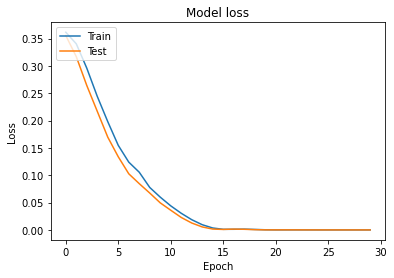

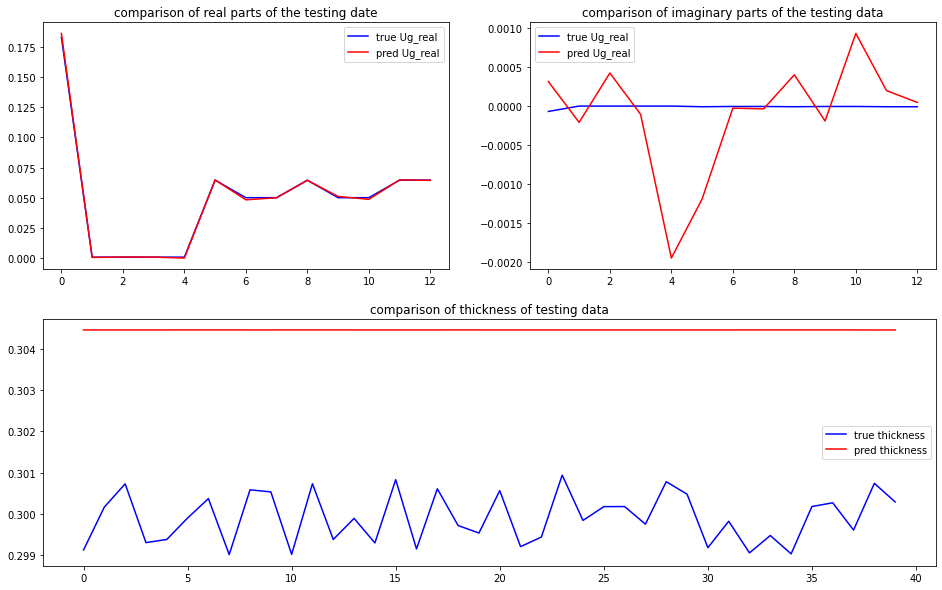

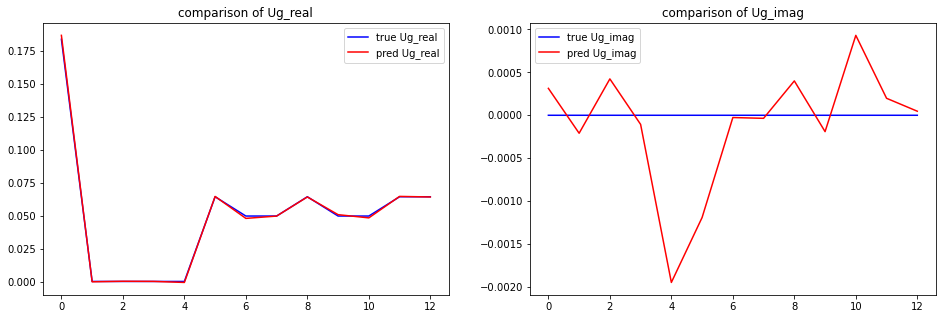

predicted thickness: 30.446678400039673 nm
mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=304.46678400039673
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 13 different beams

InputUg:
[1.86481342e-01+0.00000000e+00

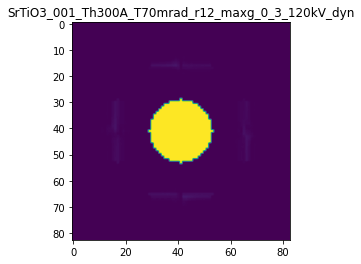

X_sim.max(): 0.9999946720571465
R-factor at a scale of 0.01 is 0.00014782328701528052.

-----------------------------------------------------------------------------------------------------

>>> start to produce Dataset at a scale of 0.02

-----------------------------------------------------------------------------------------------------

>>> producing the 1. dataset...

The offset applied on thickness: 0.00010217790329476584

The offset applied on Ug: 0.0019531278240288285

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.00

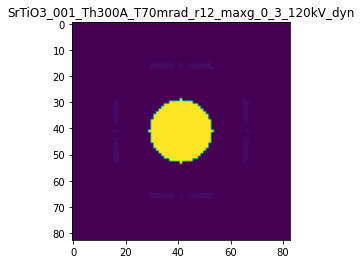

R-factor: 1.308896447854103e-07

>>> producing the 2. dataset...

The offset applied on thickness: 0.0009661803721112982

The offset applied on Ug: -0.01729419213211261

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9661803721113
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

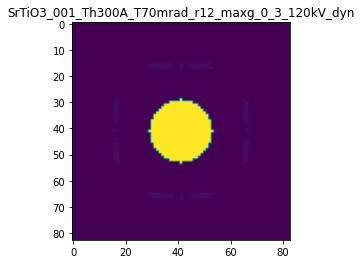

R-factor: 1.22811536211701e-06

>>> producing the 3. dataset...

The offset applied on thickness: 0.0004840415579451458

The offset applied on Ug: -0.012595998024162575

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4840415579451
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

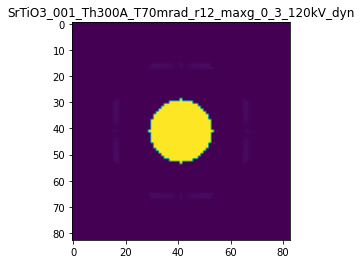

R-factor: 6.209323147768315e-07

>>> producing the 4. dataset...

The offset applied on thickness: 0.000657836751955924

The offset applied on Ug: 0.012347121950152987

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.65783675195587
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

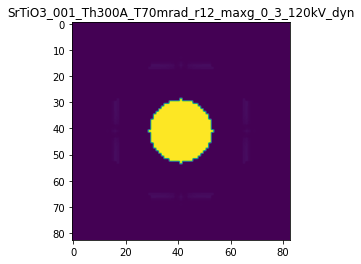

R-factor: 8.431180616565316e-07

>>> producing the 5. dataset...

The offset applied on thickness: 0.0005359730882963702

The offset applied on Ug: -0.010121827222972897

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5359730882964
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

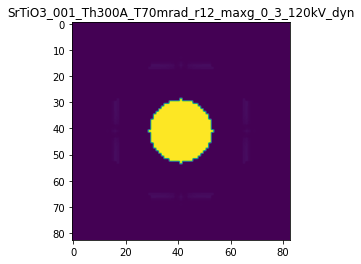

R-factor: 6.813666220206711e-07

>>> producing the 6. dataset...

The offset applied on thickness: 0.0002710816441035273

The offset applied on Ug: -0.003964426612167116

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.27108164410356
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

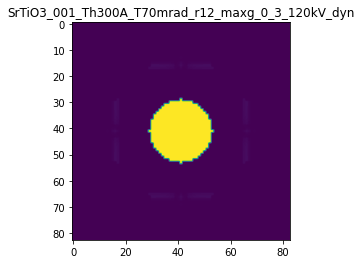

R-factor: 3.431469718911199e-07

>>> producing the 7. dataset...

The offset applied on thickness: 0.0006672752941260956

The offset applied on Ug: 0.011154238567461578

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.66727529412606
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

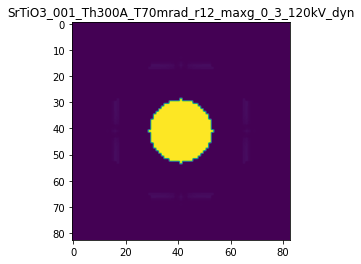

R-factor: 8.533468973286516e-07

>>> producing the 8. dataset...

The offset applied on thickness: -0.0005399430649733379

The offset applied on Ug: -0.005083597736504855

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4600569350266
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

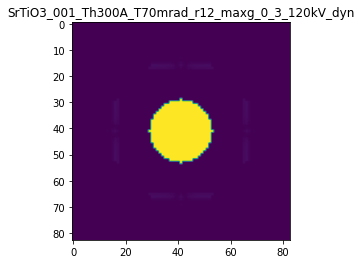

R-factor: 6.839077644734886e-07

>>> producing the 9. dataset...

The offset applied on thickness: -0.0009943296276020627

The offset applied on Ug: 0.0174713849911474

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.00567037239796
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

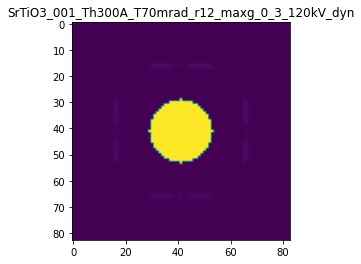

R-factor: 1.2591052850665805e-06

>>> producing the 10. dataset...

The offset applied on thickness: -0.00048585104145905665

The offset applied on Ug: 0.007255510495657136

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.51414895854094
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

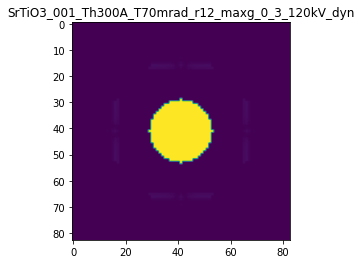

R-factor: 6.142950469308233e-07

>>> producing the 11. dataset...

The offset applied on thickness: 0.0004934141359369327

The offset applied on Ug: -0.014717104877338065

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4934141359369
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

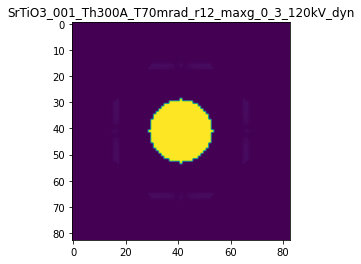

R-factor: 6.36070919836566e-07

>>> producing the 12. dataset...

The offset applied on thickness: 6.370192023085664e-05

The offset applied on Ug: 0.012899672759254367

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.06370192023087
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

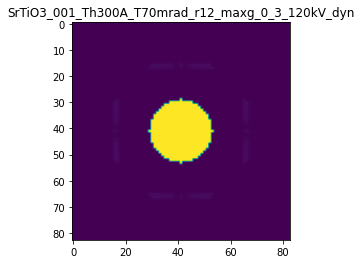

R-factor: 1.060459972302666e-07

>>> producing the 13. dataset...

The offset applied on thickness: -0.0008820740623981052

The offset applied on Ug: 0.001042216687733002

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1179259376019
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

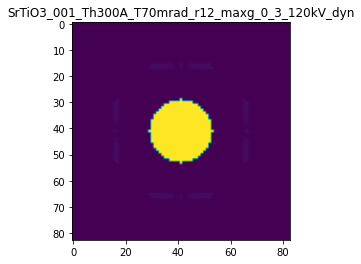

R-factor: 1.1093894182828028e-06

>>> producing the 14. dataset...

The offset applied on thickness: -0.0009838204914068862

The offset applied on Ug: 0.00206586461414044

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0161795085931
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

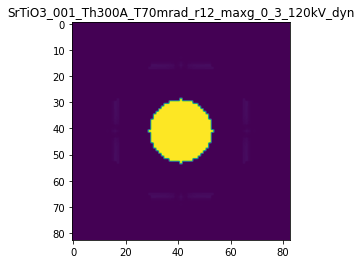

R-factor: 1.2373571921842046e-06

>>> producing the 15. dataset...

The offset applied on thickness: 0.0004179309434021559

The offset applied on Ug: 0.0026713991093860836

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.41793094340215
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

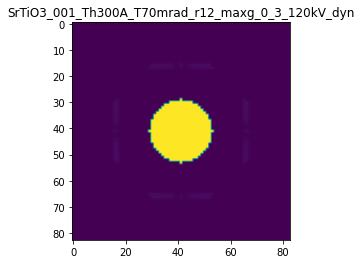

R-factor: 5.292472220142306e-07

>>> producing the 16. dataset...

The offset applied on thickness: 0.00012494789316394074

The offset applied on Ug: -0.000596058949590339

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1249478931639
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

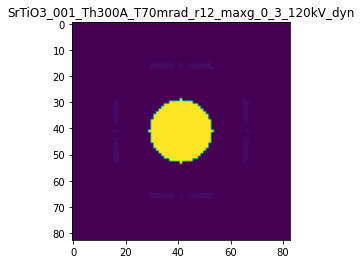

R-factor: 1.5757416101129363e-07

>>> producing the 17. dataset...

The offset applied on thickness: 0.0005896942381948453

The offset applied on Ug: -0.010903608740424358

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5896942381948
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

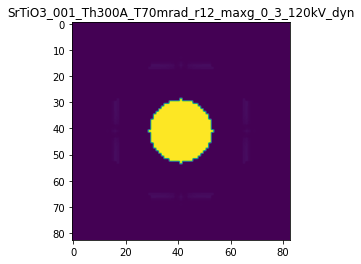

R-factor: 7.494656275453284e-07

>>> producing the 18. dataset...

The offset applied on thickness: -0.0008107383481594175

The offset applied on Ug: 0.010881827646027195

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1892616518406
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

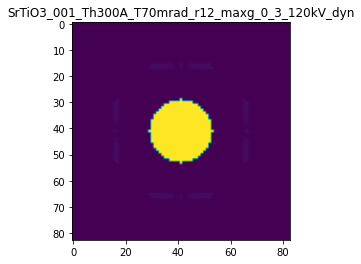

R-factor: 1.0231081703090554e-06

>>> producing the 19. dataset...

The offset applied on thickness: 0.0009040489170585374

The offset applied on Ug: -0.015575062651128097

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9040489170585
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

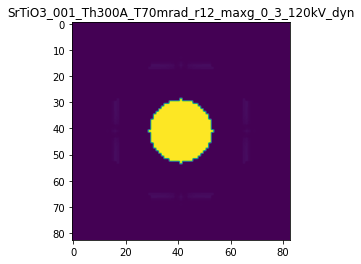

R-factor: 1.1483205216915786e-06

>>> producing the 20. dataset...

The offset applied on thickness: -0.00013417831827086711

The offset applied on Ug: -0.002761941452180663

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8658216817291
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

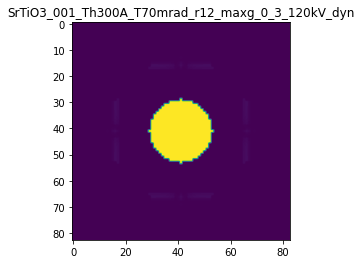

R-factor: 1.7199679783169946e-07

>>> producing the 21. dataset...

The offset applied on thickness: 0.0005508918281806141

The offset applied on Ug: -0.008119838026895327

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5508918281806
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

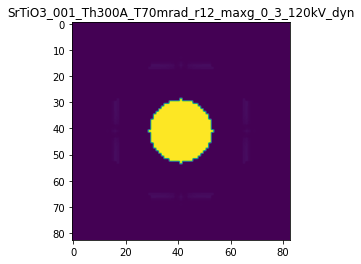

R-factor: 6.977441058673007e-07

>>> producing the 22. dataset...

The offset applied on thickness: -0.0008525084081527359

The offset applied on Ug: 0.005241198606411906

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1474915918472
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

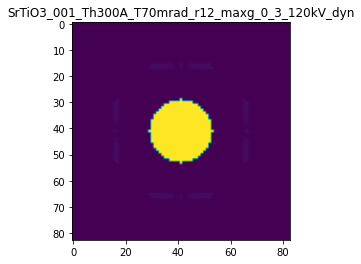

R-factor: 1.073336833988134e-06

>>> producing the 23. dataset...

The offset applied on thickness: -0.0008518883083416431

The offset applied on Ug: -0.007498123229789271

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.14811169165836
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

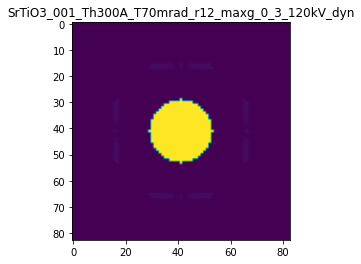

R-factor: 1.0778770485080388e-06

>>> producing the 24. dataset...

The offset applied on thickness: 0.0006821153006952398

The offset applied on Ug: -0.012014158578471856

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6821153006952
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

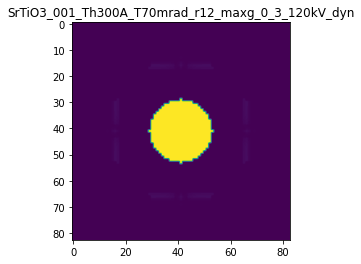

R-factor: 8.663836651319377e-07

>>> producing the 25. dataset...

The offset applied on thickness: 4.4471216112379696e-05

The offset applied on Ug: -0.014225711543344857

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0444712161124
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

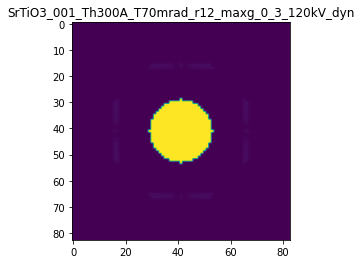

R-factor: 1.2065862694816237e-07

>>> producing the 26. dataset...

The offset applied on thickness: -0.0002834863630593485

The offset applied on Ug: -0.009284505891358515

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.71651363694065
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

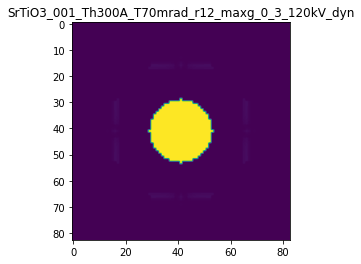

R-factor: 3.680719785167406e-07

>>> producing the 27. dataset...

The offset applied on thickness: -0.00040949500235033874

The offset applied on Ug: 0.008505937235385938

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.59050499764965
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

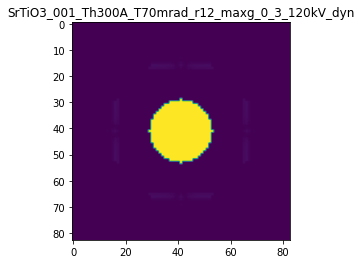

R-factor: 5.208466419554164e-07

>>> producing the 28. dataset...

The offset applied on thickness: 0.0006609936608941927

The offset applied on Ug: 0.0071496676935180895

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6609936608942
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

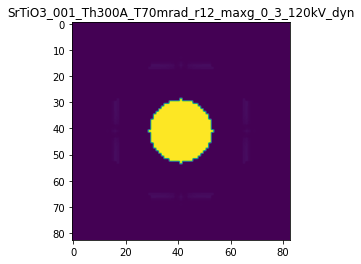

R-factor: 8.403531668051307e-07

>>> producing the 29. dataset...

The offset applied on thickness: 0.00042078588506512695

The offset applied on Ug: 0.015517993922108274

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4207858850651
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

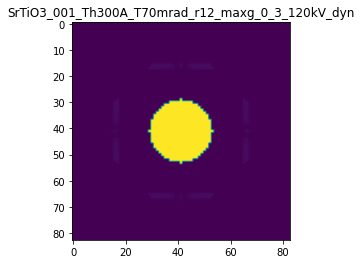

R-factor: 5.496234307480607e-07

>>> producing the 30. dataset...

The offset applied on thickness: 0.000658922587833423

The offset applied on Ug: 0.017235373703768767

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6589225878334
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

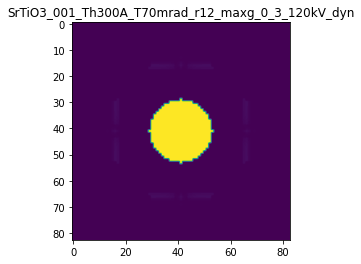

R-factor: 8.511948757530596e-07

>>> producing the 31. dataset...

The offset applied on thickness: -0.000603038312714773

The offset applied on Ug: -0.003437518581081496

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.39696168728517
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

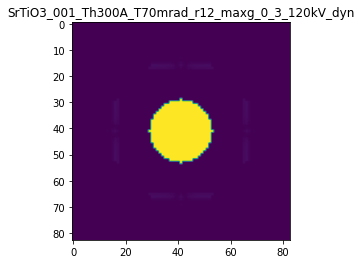

R-factor: 7.615838359570636e-07

>>> producing the 32. dataset...

The offset applied on thickness: 0.0009287671353725731

The offset applied on Ug: -0.015282703799719344

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9287671353726
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

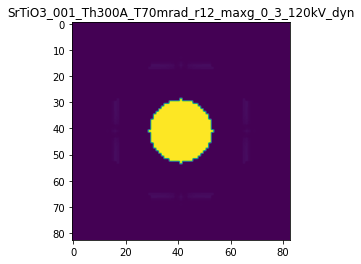

R-factor: 1.178954825808079e-06

>>> producing the 33. dataset...

The offset applied on thickness: 3.529989352119678e-05

The offset applied on Ug: 0.01688437220143007

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0352998935212
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

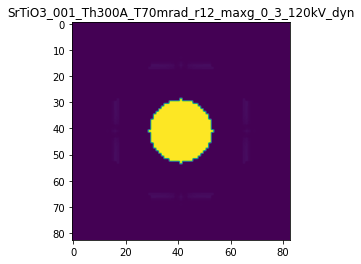

R-factor: 1.0551257849166508e-07

>>> producing the 34. dataset...

The offset applied on thickness: -0.0006648557988238701

The offset applied on Ug: 0.00611076242374347

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.33514420117615
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

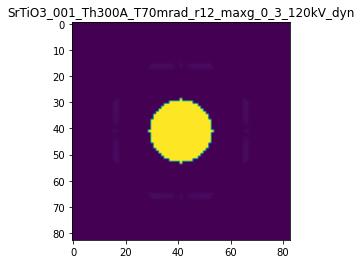

R-factor: 8.378827761307859e-07

>>> producing the 35. dataset...

The offset applied on thickness: -0.0003443737632456394

The offset applied on Ug: 0.011480520538923504

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.65562623675436
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

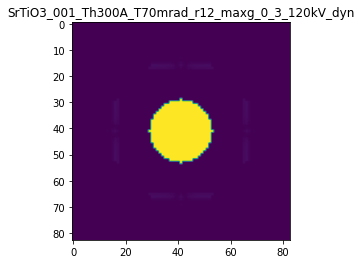

R-factor: 4.455014343873294e-07

>>> producing the 36. dataset...

The offset applied on thickness: 0.0005673110735855662

The offset applied on Ug: 0.002478848256407229

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.56731107358553
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

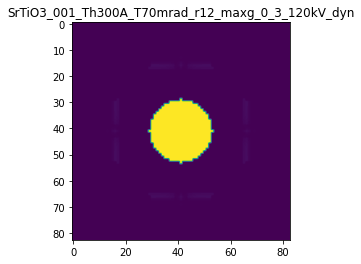

R-factor: 7.174826383567209e-07

>>> producing the 37. dataset...

The offset applied on thickness: -8.826991866664114e-05

The offset applied on Ug: 0.016953069077519017

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.91173008133336
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

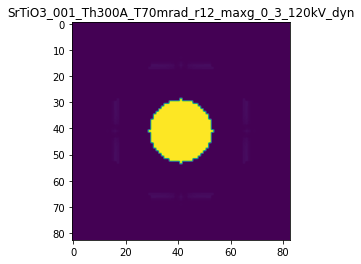

R-factor: 1.7645629407506357e-07

>>> producing the 38. dataset...

The offset applied on thickness: -0.0005362803764982442

The offset applied on Ug: 0.012370470009706085

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4637196235018
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

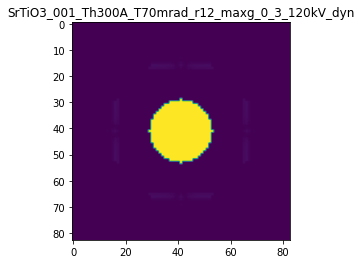

R-factor: 6.839670010899686e-07

>>> producing the 39. dataset...

The offset applied on thickness: -0.0007569833610041357

The offset applied on Ug: -0.008817721478931687

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2430166389958
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

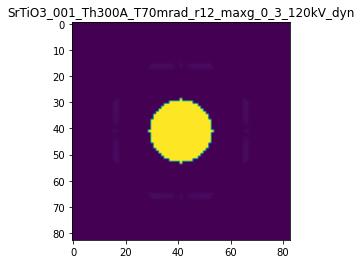

R-factor: 9.600603907177347e-07

>>> producing the 40. dataset...

The offset applied on thickness: -0.00049126965536527

The offset applied on Ug: 0.006561411447205852

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5087303446347
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

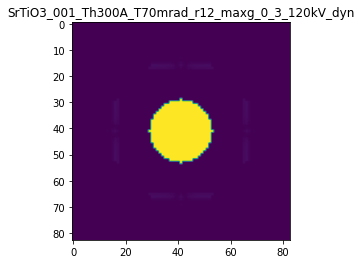

R-factor: 6.202697864571516e-07

>>> producing the 41. dataset...

The offset applied on thickness: 0.0005205952270896761

The offset applied on Ug: 0.009645717161914482

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5205952270897
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

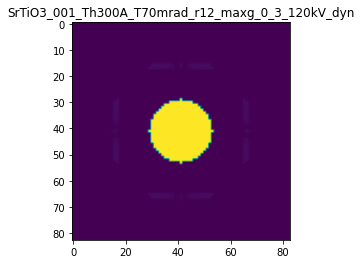

R-factor: 6.668813559822093e-07

>>> producing the 42. dataset...

The offset applied on thickness: -8.772034278168794e-05

The offset applied on Ug: 0.012568939117603652

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9122796572183
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

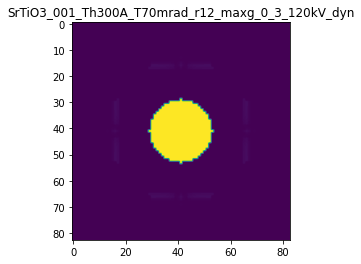

R-factor: 1.5285543922506037e-07

>>> producing the 43. dataset...

The offset applied on thickness: 0.000823500758780418

The offset applied on Ug: 0.011624003061123744

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.82350075878037
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

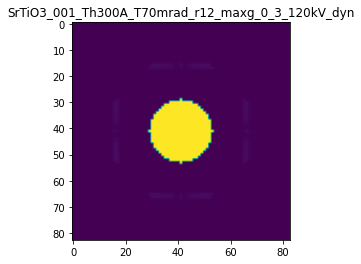

R-factor: 1.0504986944015807e-06

>>> producing the 44. dataset...

The offset applied on thickness: -0.0001932083134629028

The offset applied on Ug: -0.014192136834162072

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.80679168653705
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

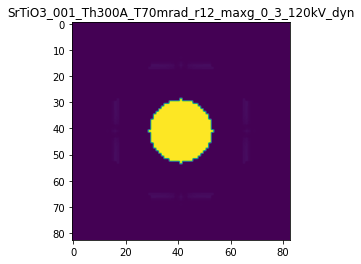

R-factor: 2.632585120215821e-07

>>> producing the 45. dataset...

The offset applied on thickness: 1.0990233463690435e-05

The offset applied on Ug: -0.014929262088641928

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.01099023346364
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

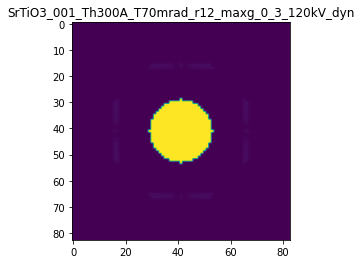

R-factor: 9.83533415257953e-08

>>> producing the 46. dataset...

The offset applied on thickness: 0.0007579507361513416

The offset applied on Ug: 0.008870770048879293

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7579507361513
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

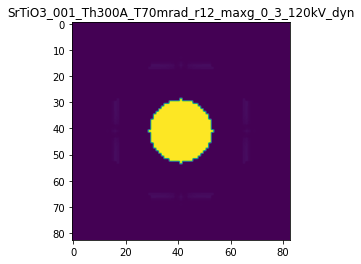

R-factor: 9.644683890713403e-07

>>> producing the 47. dataset...

The offset applied on thickness: -0.0003636237894819636

The offset applied on Ug: -0.019415526462460572

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.63637621051805
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

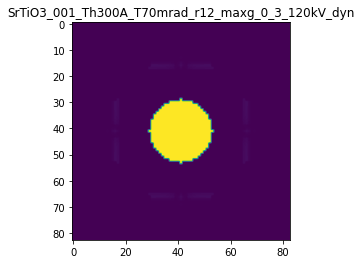

R-factor: 4.827159344321406e-07

>>> producing the 48. dataset...

The offset applied on thickness: -5.497695950053116e-05

The offset applied on Ug: -0.005150459618118579

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.94502304049945
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

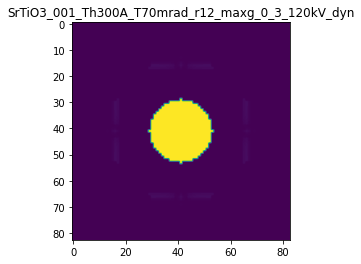

R-factor: 7.685777975068348e-08

>>> producing the 49. dataset...

The offset applied on thickness: -0.0007712747275064547

The offset applied on Ug: -0.0020345555989425223

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.22872527249353
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

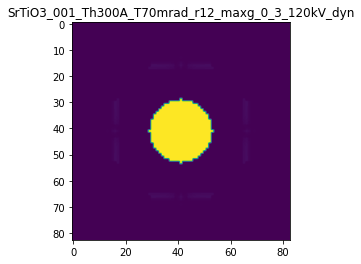

R-factor: 9.714678892848451e-07

>>> producing the 50. dataset...

The offset applied on thickness: 0.0006309744679859657

The offset applied on Ug: 0.0014746142051192202

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.630974467986
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

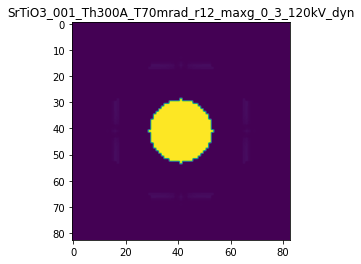

R-factor: 7.968273860160376e-07

>>> producing the 51. dataset...

The offset applied on thickness: 0.000761223872353969

The offset applied on Ug: 0.0034323541425018613

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7612238723539
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

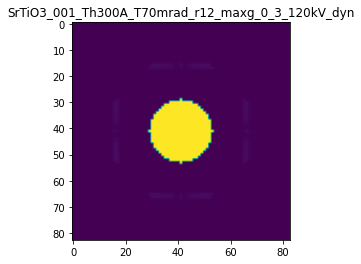

R-factor: 9.632135938675716e-07

>>> producing the 52. dataset...

The offset applied on thickness: -0.0007207003020487586

The offset applied on Ug: 0.006614005295439869

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2792996979513
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

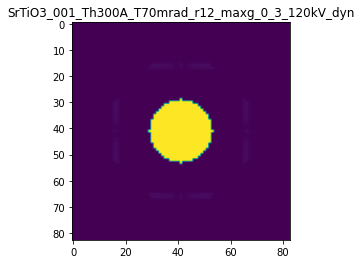

R-factor: 9.081661153456869e-07

>>> producing the 53. dataset...

The offset applied on thickness: -0.0007510373049565458

The offset applied on Ug: 0.01785743221087762

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2489626950434
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

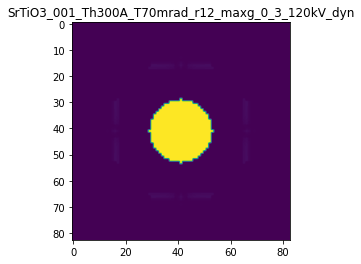

R-factor: 9.583540188238243e-07

>>> producing the 54. dataset...

The offset applied on thickness: 0.0001597114954746204

The offset applied on Ug: -0.012030950316603955

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1597114954746
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

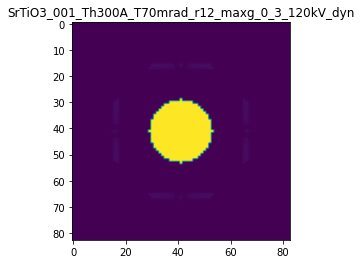

R-factor: 2.2977365590390353e-07

>>> producing the 55. dataset...

The offset applied on thickness: 0.00029764584804552755

The offset applied on Ug: 0.018952397899621803

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.29764584804553
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

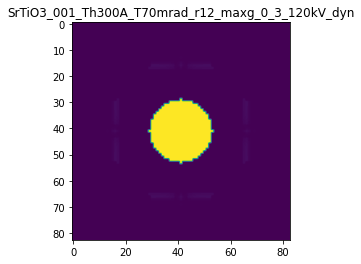

R-factor: 4.0085771753749607e-07

>>> producing the 56. dataset...

The offset applied on thickness: -0.00016142141644319685

The offset applied on Ug: -0.004378286929702444

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8385785835568
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

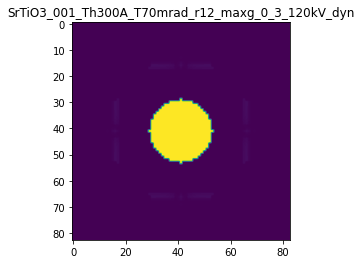

R-factor: 2.0836922307619333e-07

>>> producing the 57. dataset...

The offset applied on thickness: 0.00014477721040847324

The offset applied on Ug: 0.011512870397466029

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.14477721040845
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

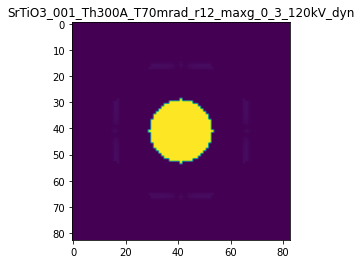

R-factor: 1.9896170379400433e-07

>>> producing the 58. dataset...

The offset applied on thickness: -0.00039685055552309033

The offset applied on Ug: -0.015147171992806343

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6031494444769
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

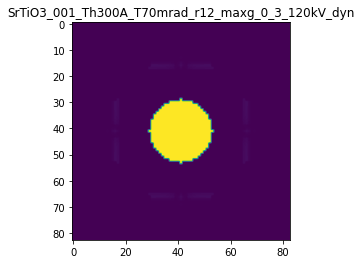

R-factor: 5.181670246691108e-07

>>> producing the 59. dataset...

The offset applied on thickness: 0.0007968140728179285

The offset applied on Ug: 0.004616897967280767

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.79681407281794
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

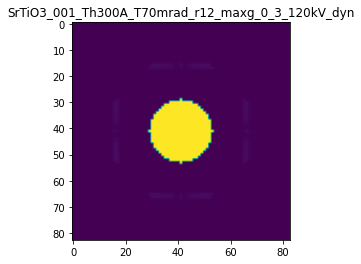

R-factor: 1.0093373312834285e-06

>>> producing the 60. dataset...

The offset applied on thickness: -5.5809589078198886e-05

The offset applied on Ug: -0.007253894860612382

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9441904109218
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

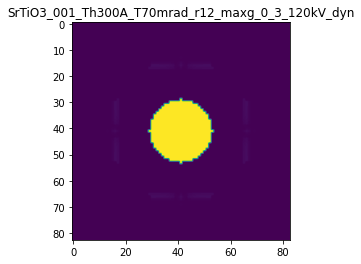

R-factor: 8.180929939497592e-08

>>> producing the 61. dataset...

The offset applied on thickness: -5.103507130374374e-05

The offset applied on Ug: 0.009693290559446765

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9489649286963
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

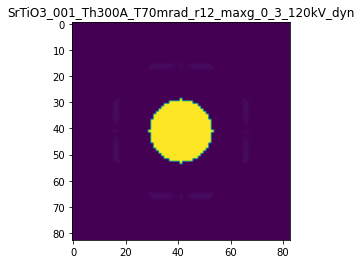

R-factor: 1.0143896982460623e-07

>>> producing the 62. dataset...

The offset applied on thickness: -0.000755041816519836

The offset applied on Ug: -0.011529225312606237

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.24495818348015
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

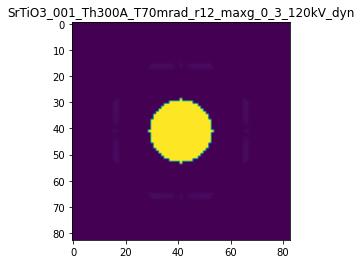

R-factor: 9.612048097285603e-07

>>> producing the 63. dataset...

The offset applied on thickness: -7.220623497976897e-05

The offset applied on Ug: -0.008299490422933164

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9277937650202
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

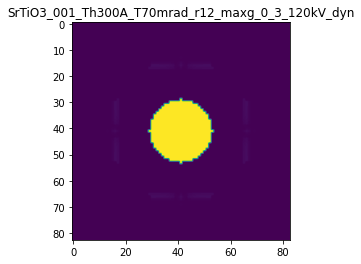

R-factor: 1.0380945623541645e-07

>>> producing the 64. dataset...

The offset applied on thickness: 0.000920421424796805

The offset applied on Ug: -0.011777886087461935

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9204214247968
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

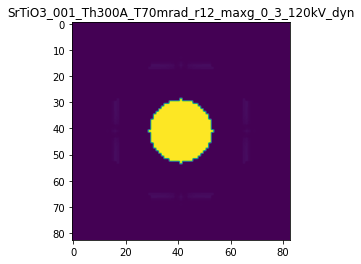

R-factor: 1.1645160781192448e-06

>>> producing the 65. dataset...

The offset applied on thickness: 0.0006440086844360161

The offset applied on Ug: -0.00398896587649928

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.644008684436
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

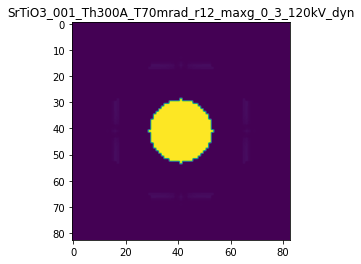

R-factor: 8.130740292174532e-07

>>> producing the 66. dataset...

The offset applied on thickness: 0.0004643211585440992

The offset applied on Ug: 0.017941692766994786

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4643211585441
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

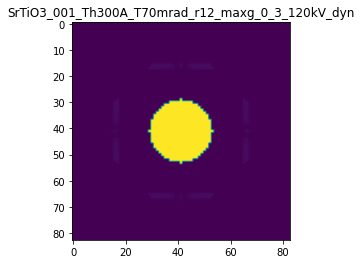

R-factor: 6.076875569211529e-07

>>> producing the 67. dataset...

The offset applied on thickness: -0.0009636705255044737

The offset applied on Ug: 0.01468704304763886

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.03632947449546
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

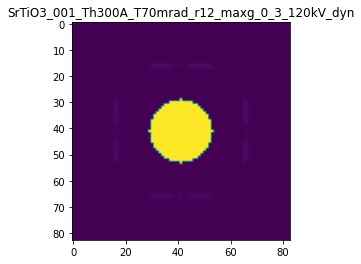

R-factor: 1.2177528367212183e-06

>>> producing the 68. dataset...

The offset applied on thickness: -0.00010291083279033919

The offset applied on Ug: 0.008676113195904046

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.89708916720963
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

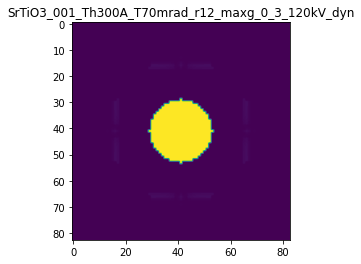

R-factor: 1.516714607202508e-07

>>> producing the 69. dataset...

The offset applied on thickness: 0.0006409603182832104

The offset applied on Ug: -0.017108130530345485

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6409603182832
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

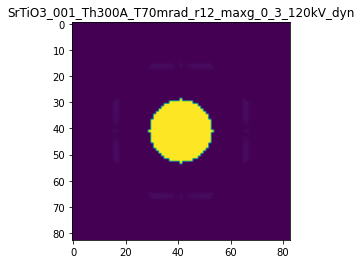

R-factor: 8.231675611897426e-07

>>> producing the 70. dataset...

The offset applied on thickness: -0.0005371250260807452

The offset applied on Ug: 0.009834088696472799

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.46287497391927
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

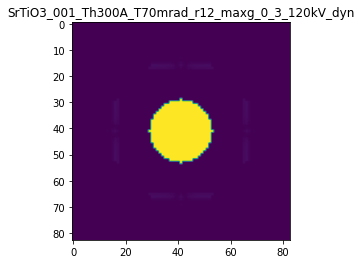

R-factor: 6.811363324276584e-07

>>> producing the 71. dataset...

The offset applied on thickness: 0.0003693982145369483

The offset applied on Ug: 0.00786261428312674

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.36939821453694
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

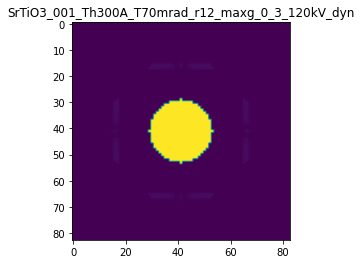

R-factor: 4.744693092308156e-07

>>> producing the 72. dataset...

The offset applied on thickness: 0.0007169594582346648

The offset applied on Ug: -0.003345042498440458

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.71695945823467
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

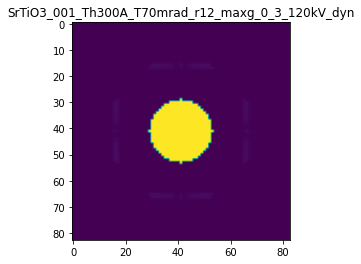

R-factor: 9.050104464991935e-07

>>> producing the 73. dataset...

The offset applied on thickness: -0.0007425658214202731

The offset applied on Ug: 0.018353749236216497

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2574341785797
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

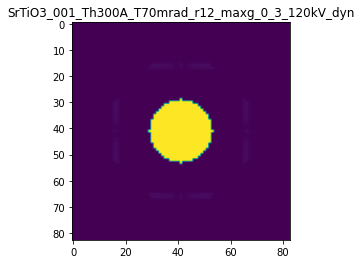

R-factor: 9.486970739691919e-07

>>> producing the 74. dataset...

The offset applied on thickness: -0.0006433365855011715

The offset applied on Ug: -0.0016241199835058228

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.35666341449877
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

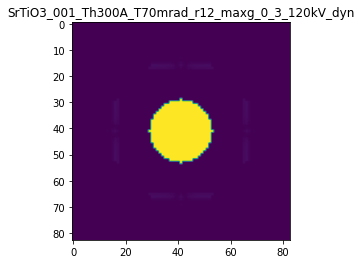

R-factor: 8.104536080931523e-07

>>> producing the 75. dataset...

The offset applied on thickness: -0.00014860790526027157

The offset applied on Ug: 0.007243251608586747

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8513920947397
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

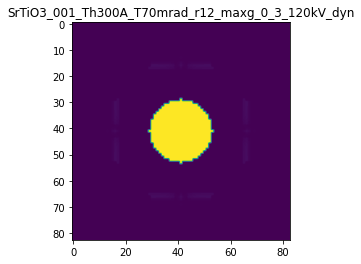

R-factor: 1.988299274311401e-07

>>> producing the 76. dataset...

The offset applied on thickness: -0.00015240988722980565

The offset applied on Ug: -0.019510485013473446

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8475901127702
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

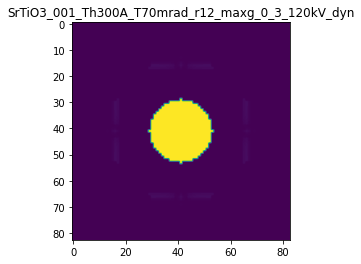

R-factor: 2.2291503026449822e-07

>>> producing the 77. dataset...

The offset applied on thickness: 0.0006906519580504648

The offset applied on Ug: 0.01285002989801412

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.69065195805047
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

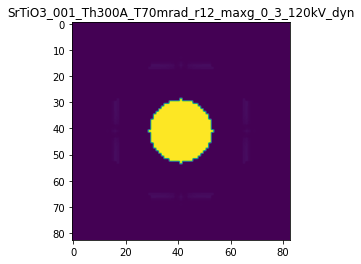

R-factor: 8.850737958659299e-07

>>> producing the 78. dataset...

The offset applied on thickness: 0.0002312187291444834

The offset applied on Ug: -0.006472657178101673

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2312187291445
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

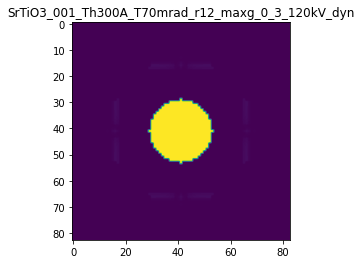

R-factor: 2.9723518522675446e-07

>>> producing the 79. dataset...

The offset applied on thickness: 0.0005825863577202082

The offset applied on Ug: 0.01288258375943776

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5825863577202
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

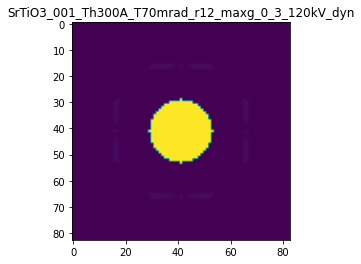

R-factor: 7.492465894261167e-07

>>> producing the 80. dataset...

The offset applied on thickness: -0.0006437807270299607

The offset applied on Ug: 0.010647442604972626

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.35621927297
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

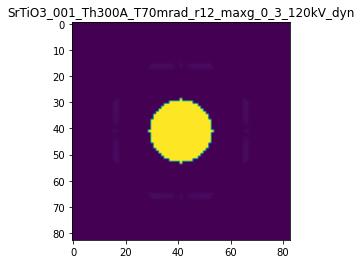

R-factor: 8.149251414785571e-07

>>> producing the 81. dataset...

The offset applied on thickness: 0.0008048970867533407

The offset applied on Ug: 0.0013916089958104783

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.80489708675333
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

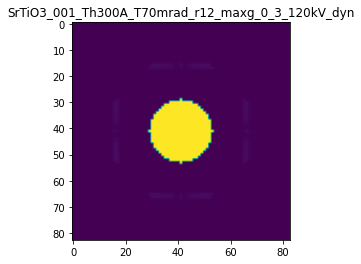

R-factor: 1.0163465159053302e-06

>>> producing the 82. dataset...

The offset applied on thickness: -0.00030600344767541345

The offset applied on Ug: -0.005233815017012771

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6939965523246
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

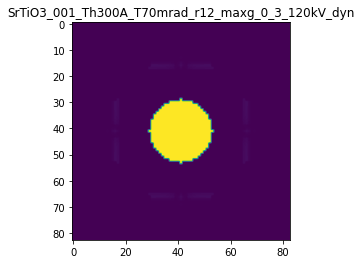

R-factor: 3.9068184769479003e-07

>>> producing the 83. dataset...

The offset applied on thickness: -6.949044373872849e-05

The offset applied on Ug: 0.0036367745834241785

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.93050955626126
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

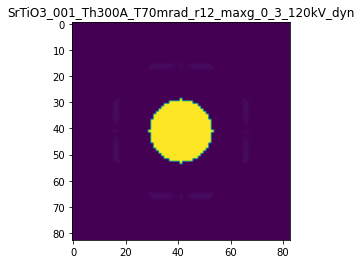

R-factor: 9.372658584169874e-08

>>> producing the 84. dataset...

The offset applied on thickness: 3.5346334573136408e-06

The offset applied on Ug: -0.018902219230559087

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0035346334573
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

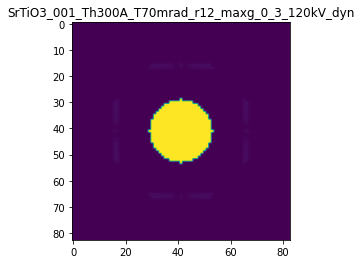

R-factor: 1.1801472606330355e-07

>>> producing the 85. dataset...

The offset applied on thickness: 4.0008109542857275e-05

The offset applied on Ug: -0.004820264516761834

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.04000810954284
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

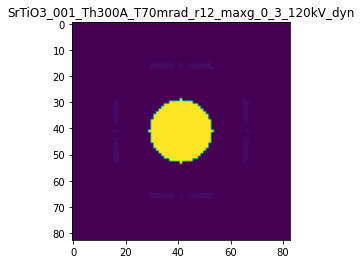

R-factor: 6.522769501161397e-08

>>> producing the 86. dataset...

The offset applied on thickness: -0.0002627927305798674

The offset applied on Ug: -0.01954774501451251

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7372072694201
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

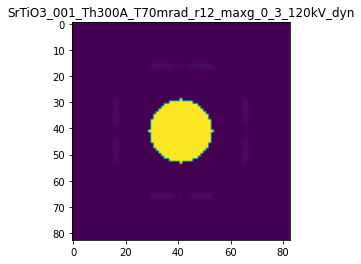

R-factor: 3.5847329709090167e-07

>>> producing the 87. dataset...

The offset applied on thickness: 0.0006535600788433818

The offset applied on Ug: -0.01045669358879322

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6535600788434
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

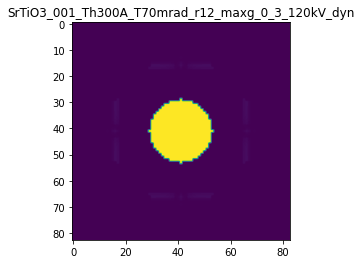

R-factor: 8.288685494170572e-07

>>> producing the 88. dataset...

The offset applied on thickness: -0.0006946188829896783

The offset applied on Ug: -0.007239414481654274

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3053811170103
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

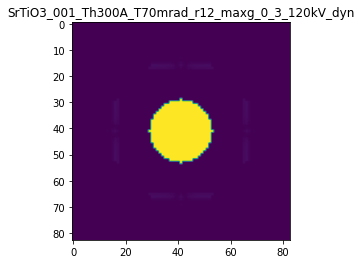

R-factor: 8.802396740803593e-07

>>> producing the 89. dataset...

The offset applied on thickness: -0.0008804451971518879

The offset applied on Ug: -0.009975285540949504

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1195548028481
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

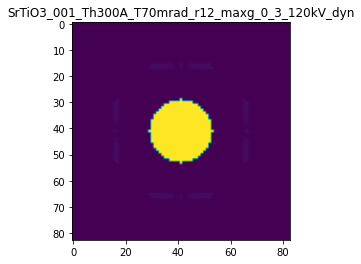

R-factor: 1.1160874789305158e-06

>>> producing the 90. dataset...

The offset applied on thickness: -0.0004182757964784027

The offset applied on Ug: 0.004647023524763773

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.58172420352156
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

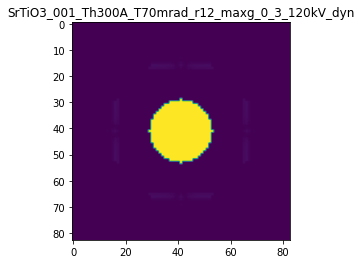

R-factor: 5.275663451236624e-07

>>> producing the 91. dataset...

The offset applied on thickness: 2.4180971768684722e-05

The offset applied on Ug: 0.002844939845799903

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0241809717687
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

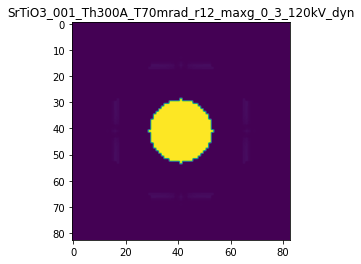

R-factor: 3.4930130317378194e-08

>>> producing the 92. dataset...

The offset applied on thickness: -0.00035844478364405543

The offset applied on Ug: -0.011777761227968395

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6415552163559
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

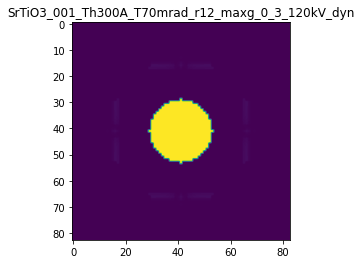

R-factor: 4.6538759992066286e-07

>>> producing the 93. dataset...

The offset applied on thickness: 0.000556316348376324

The offset applied on Ug: -0.004740153925803803

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5563163483763
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

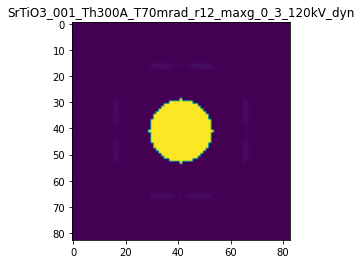

R-factor: 7.025845791210019e-07

>>> producing the 94. dataset...

The offset applied on thickness: 7.540634320035178e-05

The offset applied on Ug: 0.01742405010600115

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.07540634320037
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

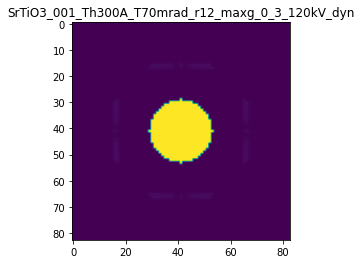

R-factor: 1.3438838638506806e-07

>>> producing the 95. dataset...

The offset applied on thickness: 0.0007840457129513006

The offset applied on Ug: 0.004030928845956199

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7840457129513
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

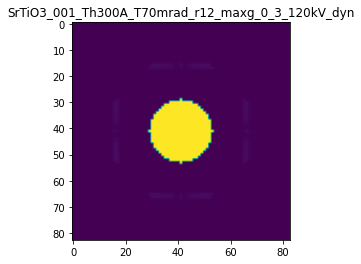

R-factor: 9.926295889351021e-07

>>> producing the 96. dataset...

The offset applied on thickness: -0.0004957230327957107

The offset applied on Ug: -0.012388437980289999

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.50427696720425
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

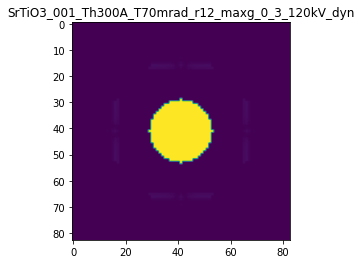

R-factor: 6.380624724846828e-07

>>> producing the 97. dataset...

The offset applied on thickness: 0.00041785370687767996

The offset applied on Ug: 0.005996214488905145

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4178537068777
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

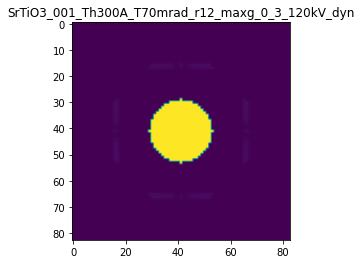

R-factor: 5.327668306920769e-07

>>> producing the 98. dataset...

The offset applied on thickness: -0.0009418972746184508

The offset applied on Ug: 0.004446450396918329

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0581027253815
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

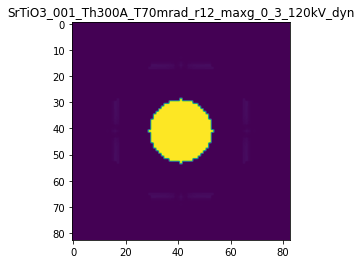

R-factor: 1.1853460732536868e-06

>>> producing the 99. dataset...

The offset applied on thickness: -0.0009639396767889066

The offset applied on Ug: -0.005528000756463203

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0360603232111
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

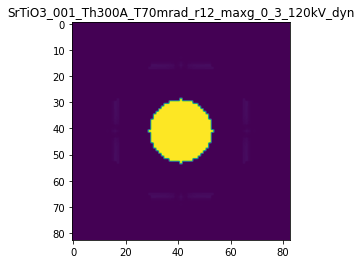

R-factor: 1.2165455392229478e-06

>>> producing the 100. dataset...

The offset applied on thickness: 0.0005503389693478462

The offset applied on Ug: -0.019273732542822348

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5503389693479
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

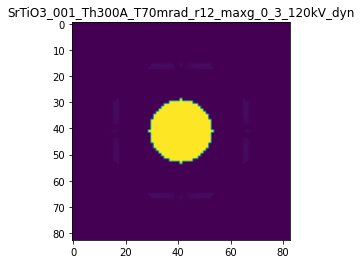

R-factor: 7.153692831795207e-07

>>> producing the 101. dataset...

The offset applied on thickness: 0.0006286629332204645

The offset applied on Ug: -0.016720208903789714

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6286629332204
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

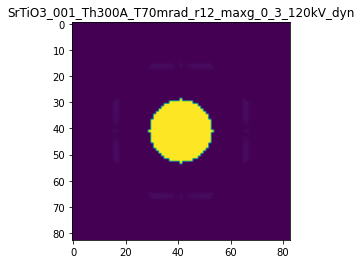

R-factor: 8.072577912257592e-07

>>> producing the 102. dataset...

The offset applied on thickness: -0.0007527805795779787

The offset applied on Ug: 0.0166309226621347

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.24721942042197
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

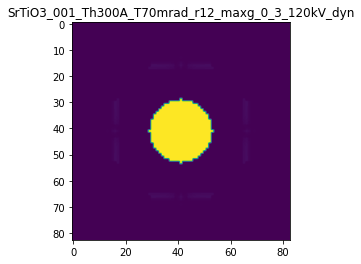

R-factor: 9.585082687416084e-07

>>> producing the 103. dataset...

The offset applied on thickness: -0.00038319693321917737

The offset applied on Ug: 0.017796215479170124

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6168030667808
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

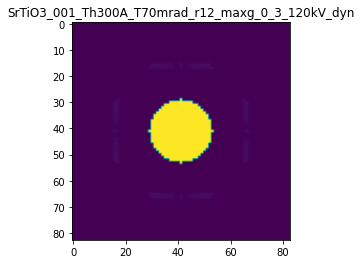

R-factor: 5.09870720170183e-07

>>> producing the 104. dataset...

The offset applied on thickness: 0.000269625023265416

The offset applied on Ug: 0.008341315498691588

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2696250232654
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

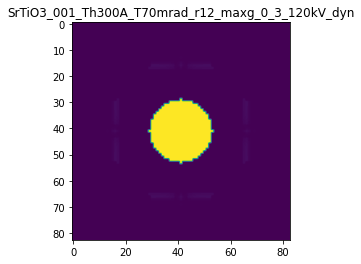

R-factor: 3.498377325598302e-07

>>> producing the 105. dataset...

The offset applied on thickness: -0.00030417637257515386

The offset applied on Ug: 0.0032525021307992976

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6958236274249
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

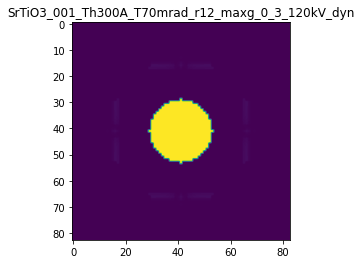

R-factor: 3.8369210190290146e-07

>>> producing the 106. dataset...

The offset applied on thickness: -5.5825507699333036e-05

The offset applied on Ug: -0.01083299520882802

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.94417449230065
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_f

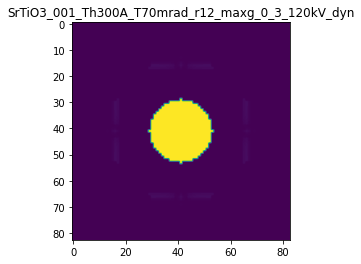

R-factor: 9.119040159994922e-08

>>> producing the 107. dataset...

The offset applied on thickness: 0.0005075786299046861

The offset applied on Ug: 0.016920765916910926

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5075786299047
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

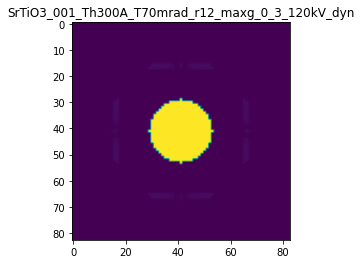

R-factor: 6.605621638031663e-07

>>> producing the 108. dataset...

The offset applied on thickness: -0.0005852752448678029

The offset applied on Ug: -0.015849885198129132

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4147247551322
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

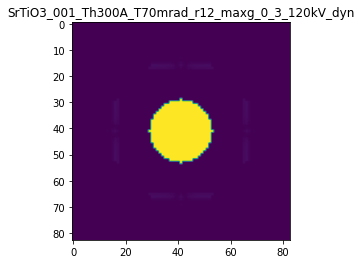

R-factor: 7.548821787392144e-07

>>> producing the 109. dataset...

The offset applied on thickness: -9.368852851622256e-06

The offset applied on Ug: 0.01160111561268591

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.99063114714835
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

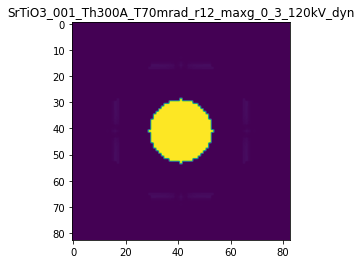

R-factor: 7.697661391733803e-08

>>> producing the 110. dataset...

The offset applied on thickness: -0.00014879065462099694

The offset applied on Ug: -0.018794690709645404

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.851209345379
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

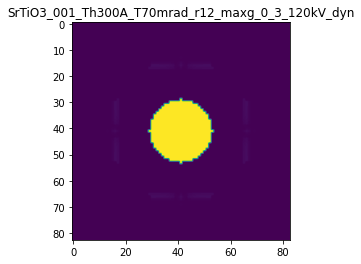

R-factor: 2.171424536249656e-07

>>> producing the 111. dataset...

The offset applied on thickness: -0.0009376521287083224

The offset applied on Ug: -0.0025683897747683783

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.06234787129165
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_f

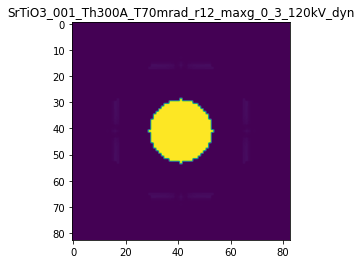

R-factor: 1.1807344121389976e-06

>>> producing the 112. dataset...

The offset applied on thickness: 0.0008510036788423838

The offset applied on Ug: -0.004918065424312368

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8510036788424
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

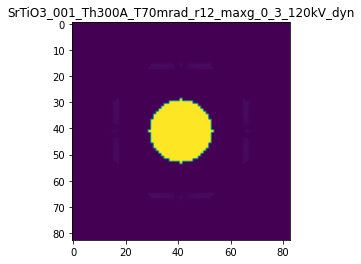

R-factor: 1.0747288161277306e-06

>>> producing the 113. dataset...

The offset applied on thickness: 0.00034942914748281487

The offset applied on Ug: -0.012236476254584008

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3494291474828
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

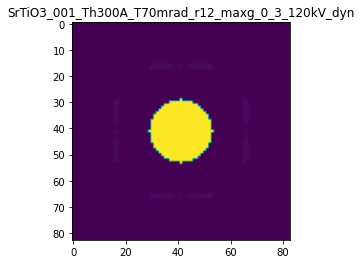

R-factor: 4.5404853861343106e-07

>>> producing the 114. dataset...

The offset applied on thickness: 0.0002939425950928685

The offset applied on Ug: -0.016976380125814323

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.29394259509286
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

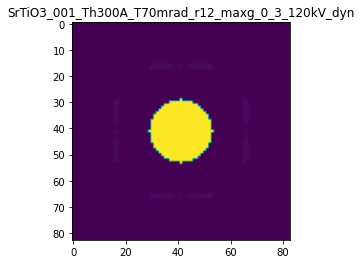

R-factor: 4.0247379308825885e-07

>>> producing the 115. dataset...

The offset applied on thickness: 0.0006770203996470934

The offset applied on Ug: 0.0076937331619362495

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.67702039964706
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

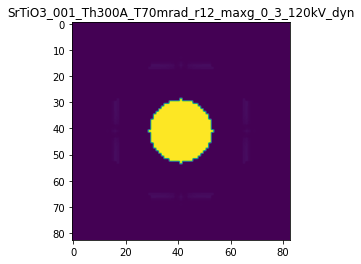

R-factor: 8.611236524973517e-07

>>> producing the 116. dataset...

The offset applied on thickness: 0.0004586938439063009

The offset applied on Ug: -0.013239826510549557

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4586938439063
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

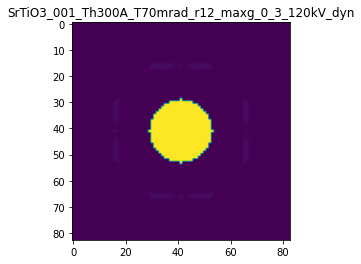

R-factor: 5.9054563060044e-07

>>> producing the 117. dataset...

The offset applied on thickness: -0.0001474560942829075

The offset applied on Ug: 0.01497540637368544

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8525439057171
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

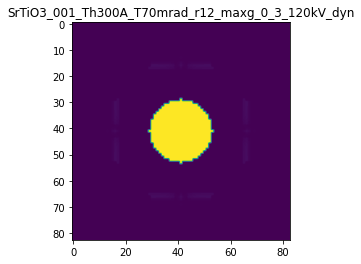

R-factor: 2.2764477641210771e-07

>>> producing the 118. dataset...

The offset applied on thickness: 0.0003187415089660479

The offset applied on Ug: -0.002418673497864008

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.318741508966
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

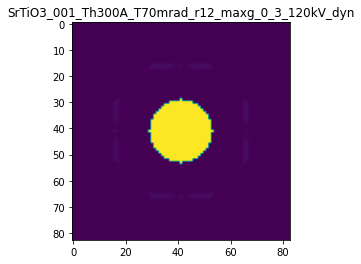

R-factor: 4.0229388444859415e-07

>>> producing the 119. dataset...

The offset applied on thickness: 0.00070421895699961

The offset applied on Ug: 0.0014347619519376976

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7042189569996
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

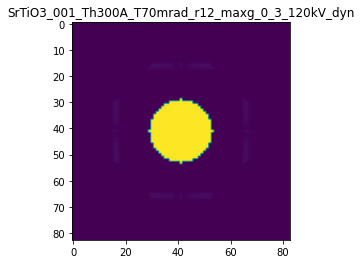

R-factor: 8.892501990398595e-07

>>> producing the 120. dataset...

The offset applied on thickness: 0.0005501079958926076

The offset applied on Ug: 0.012610717217978943

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5501079958926
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

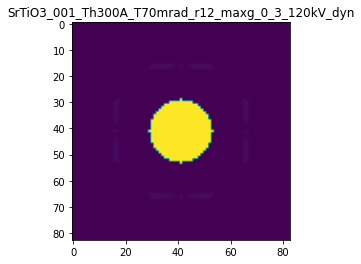

R-factor: 7.080486864226823e-07

>>> producing the 121. dataset...

The offset applied on thickness: -0.0009765183889044466

The offset applied on Ug: -0.013222793486096953

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0234816110955
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

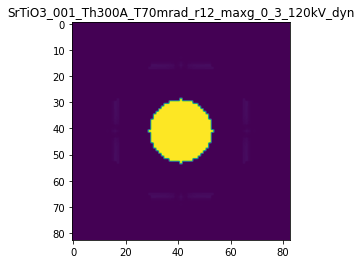

R-factor: 1.240280612564911e-06

>>> producing the 122. dataset...

The offset applied on thickness: 0.0008933469980485458

The offset applied on Ug: 0.006037441800367063

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8933469980485
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

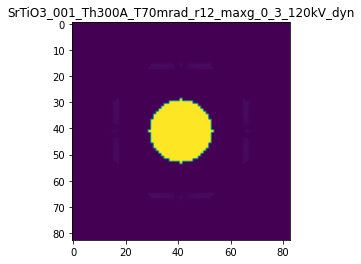

R-factor: 1.1326953296495128e-06

>>> producing the 123. dataset...

The offset applied on thickness: 0.0002230661846706783

The offset applied on Ug: 0.005375775037805144

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.22306618467064
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

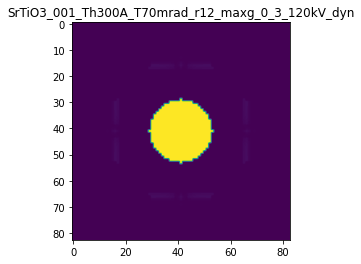

R-factor: 2.873093841245589e-07

>>> producing the 124. dataset...

The offset applied on thickness: 0.00024830732914400347

The offset applied on Ug: -0.017271758220276913

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.248307329144
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

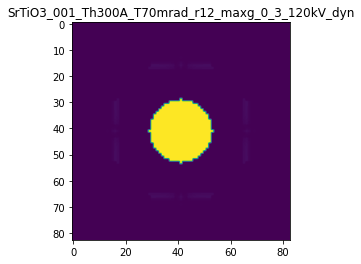

R-factor: 3.5154408443248743e-07

>>> producing the 125. dataset...

The offset applied on thickness: -0.0007078031677073267

The offset applied on Ug: 0.007990741501648673

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2921968322927
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

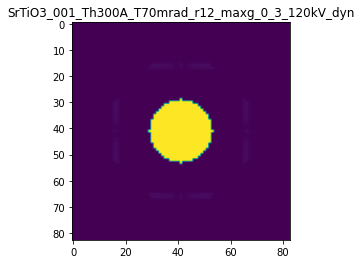

R-factor: 8.923206757520808e-07

>>> producing the 126. dataset...

The offset applied on thickness: -0.0005497719630253155

The offset applied on Ug: -0.008825846105991984

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4502280369747
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

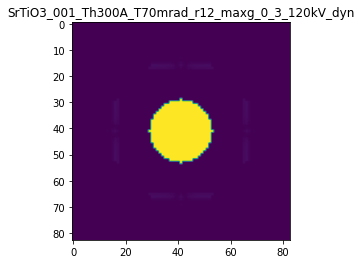

R-factor: 7.007696401204501e-07

>>> producing the 127. dataset...

The offset applied on thickness: 0.0005044562099624632

The offset applied on Ug: 0.0009725403736967308

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5044562099625
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

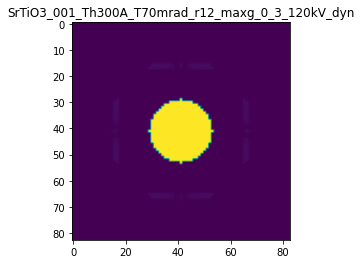

R-factor: 6.36687163432425e-07

>>> producing the 128. dataset...

The offset applied on thickness: -0.0009449476486867392

The offset applied on Ug: 0.002197296390522441

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.05505235131324
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

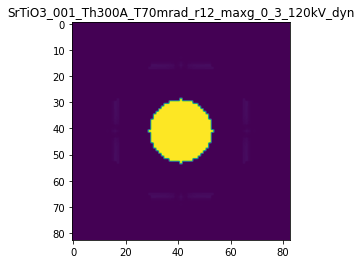

R-factor: 1.1886036233638081e-06

>>> producing the 129. dataset...

The offset applied on thickness: -0.0004729167077460992

The offset applied on Ug: -0.012207924948514961

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5270832922539
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

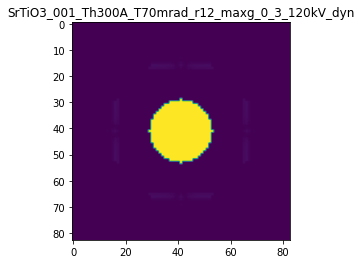

R-factor: 6.09273799666018e-07

>>> producing the 130. dataset...

The offset applied on thickness: 0.00017731575610989748

The offset applied on Ug: 0.017186604740068567

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1773157561099
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

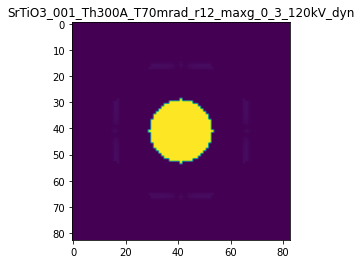

R-factor: 2.4909798840534395e-07

>>> producing the 131. dataset...

The offset applied on thickness: -0.0008016759951870396

The offset applied on Ug: -0.007243358522582146

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.19832400481295
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_f

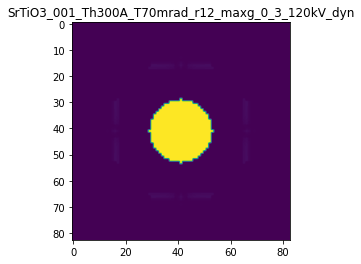

R-factor: 1.014624922570996e-06

>>> producing the 132. dataset...

The offset applied on thickness: -0.0008603803761580263

The offset applied on Ug: -0.011024468804094006

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.13961962384195
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

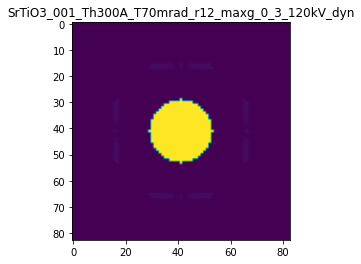

R-factor: 1.092170357594525e-06

>>> producing the 133. dataset...

The offset applied on thickness: -0.0003033077944723579

The offset applied on Ug: -0.013913037152653409

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.69669220552765
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

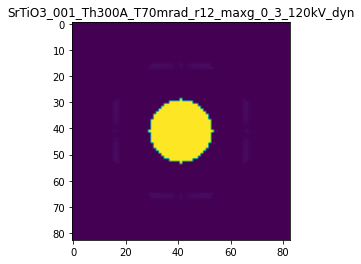

R-factor: 3.994210830471627e-07

>>> producing the 134. dataset...

The offset applied on thickness: 0.0006793610980373202

The offset applied on Ug: 0.0012732395569688304

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.67936109803736
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

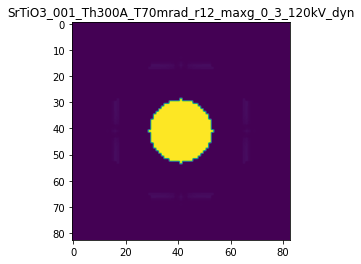

R-factor: 8.577066836378713e-07

>>> producing the 135. dataset...

The offset applied on thickness: -0.00010821704877482929

The offset applied on Ug: -0.005211123682285584

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.89178295122514
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_f

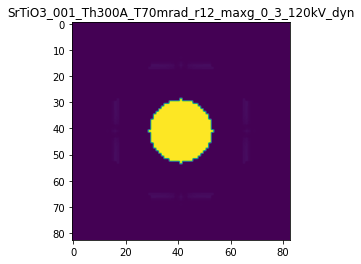

R-factor: 1.4289349553568357e-07

>>> producing the 136. dataset...

The offset applied on thickness: -0.00024031378730743924

The offset applied on Ug: -0.013729379615854019

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.75968621269254
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_

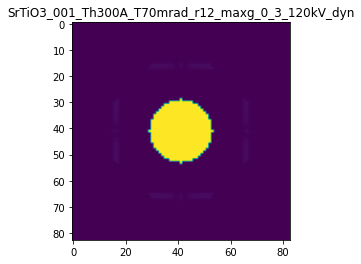

R-factor: 3.2053732142993614e-07

>>> producing the 137. dataset...

The offset applied on thickness: 0.0002583979642888499

The offset applied on Ug: -0.012271417541811953

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2583979642888
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

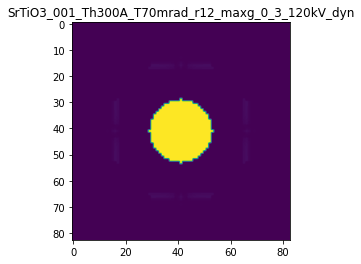

R-factor: 3.45102697203435e-07

>>> producing the 138. dataset...

The offset applied on thickness: -0.0003529056828197701

The offset applied on Ug: 0.008133277567679129

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.64709431718023
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

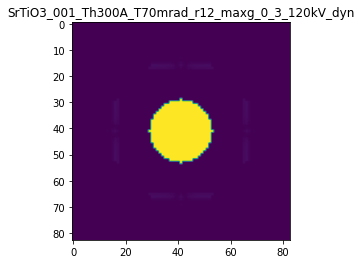

R-factor: 4.502288278424926e-07

>>> producing the 139. dataset...

The offset applied on thickness: 0.0007271329802065473

The offset applied on Ug: -0.0018689414939768501

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.72713298020653
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

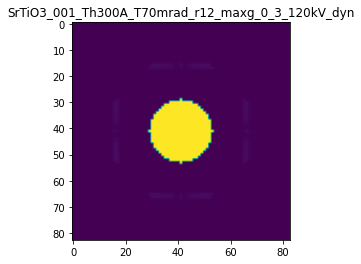

R-factor: 9.174678657415743e-07

>>> producing the 140. dataset...

The offset applied on thickness: 0.0008136767914675762

The offset applied on Ug: 0.013600630223033257

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.81367679146757
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

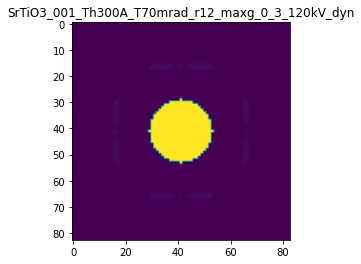

R-factor: 1.040852409354462e-06



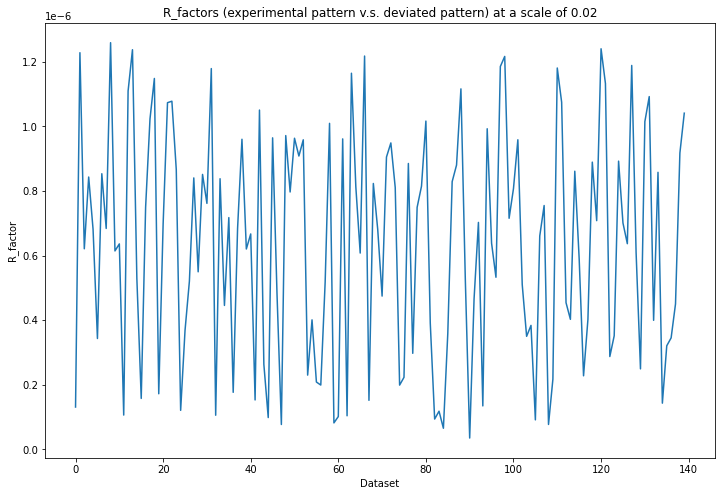

>>> start to train the ANN 

Epoch 1/30
5/5 [==============================] - 1s 129ms/step - loss: 0.3616 - acc: 0.8000 - val_loss: 0.3557 - val_acc: 1.0000
Epoch 2/30
5/5 [==============================] - 1s 109ms/step - loss: 0.3428 - acc: 1.0000 - val_loss: 0.3173 - val_acc: 1.0000
Epoch 3/30
5/5 [==============================] - 1s 109ms/step - loss: 0.2966 - acc: 1.0000 - val_loss: 0.2599 - val_acc: 1.0000
Epoch 4/30
5/5 [==============================] - 1s 108ms/step - loss: 0.2455 - acc: 1.0000 - val_loss: 0.2171 - val_acc: 1.0000
Epoch 5/30
5/5 [==============================] - 1s 109ms/step - loss: 0.1992 - acc: 1.0000 - val_loss: 0.1765 - val_acc: 1.0000
Epoch 6/30
5/5 [==============================] - 1s 108ms/step - loss: 0.1608 - acc: 1.0000 - val_loss: 0.1364 - val_acc: 1.0000
Epoch 7/30
5/5 [==============================] - 1s 108ms/step - loss: 0.1252 - acc: 1.0000 - val_loss: 0.1072 - val_acc: 1.0000
Epoch 8/30
5/5 [==============================] - 1s 107ms/st

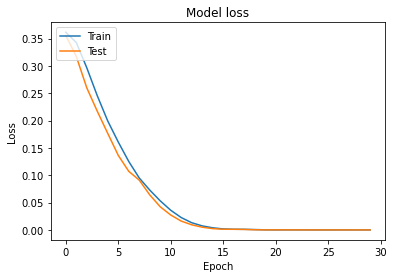

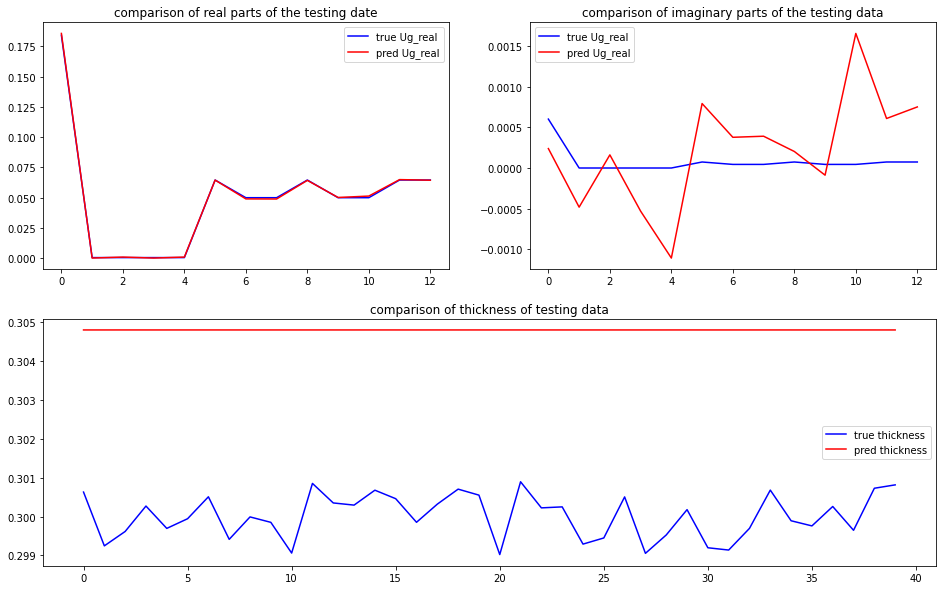

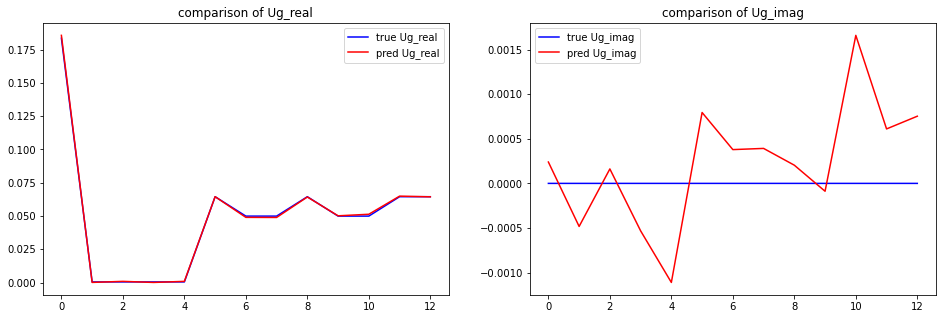

predicted thickness: 30.4793119430542 nm
mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=304.793119430542
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 13 different beams

InputUg:
[0.18567884+0.00000000e+00j 0.0004

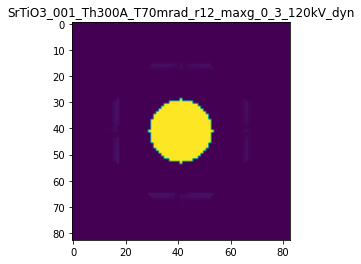

X_sim.max(): 0.9999984374139108
R-factor at a scale of 0.02 is 8.164168359288577e-05.

-----------------------------------------------------------------------------------------------------

>>> start to produce Dataset at a scale of 0.04

-----------------------------------------------------------------------------------------------------

>>> producing the 1. dataset...

The offset applied on thickness: 0.0009803147074704645

The offset applied on Ug: 0.03389130374629116

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
t

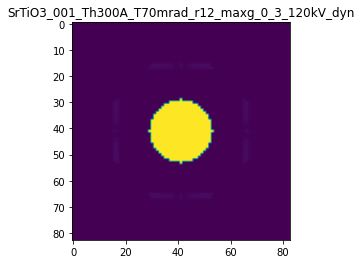

R-factor: 1.2785834492836928e-06

>>> producing the 2. dataset...

The offset applied on thickness: 0.0006985932598176073

The offset applied on Ug: 0.0254281053869905

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6985932598176
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

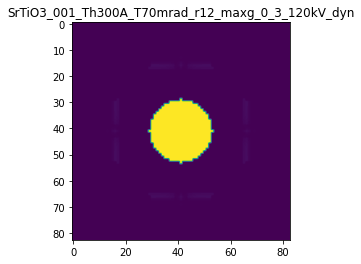

R-factor: 9.124758482264352e-07

>>> producing the 3. dataset...

The offset applied on thickness: 0.00027116559892096336

The offset applied on Ug: -0.022851500358215066

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.27116559892096
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

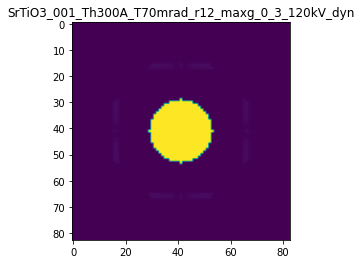

R-factor: 3.9991348627186214e-07

>>> producing the 4. dataset...

The offset applied on thickness: 0.0008389874859178164

The offset applied on Ug: -0.030678504023807163

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8389874859178
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

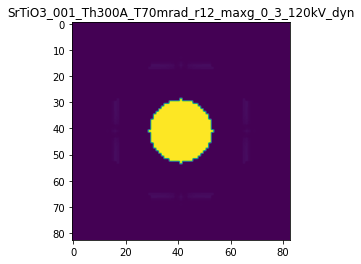

R-factor: 1.0945596145237231e-06

>>> producing the 5. dataset...

The offset applied on thickness: 0.0007285197806209209

The offset applied on Ug: -0.020844009386157287

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.72851978062096
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

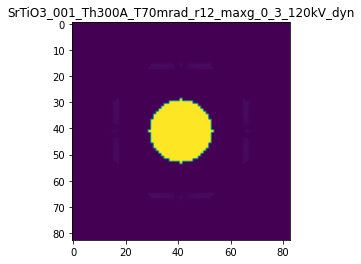

R-factor: 9.380788638706199e-07

>>> producing the 6. dataset...

The offset applied on thickness: 0.0001732672110249176

The offset applied on Ug: 0.023640819771289144

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1732672110249
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

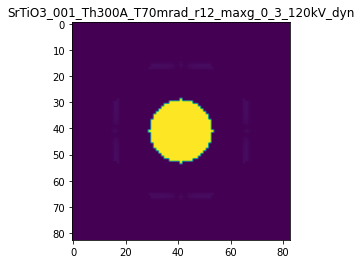

R-factor: 2.562331352828533e-07

>>> producing the 7. dataset...

The offset applied on thickness: 9.082833979767191e-05

The offset applied on Ug: 0.0017075613709134174

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.09082833979767
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

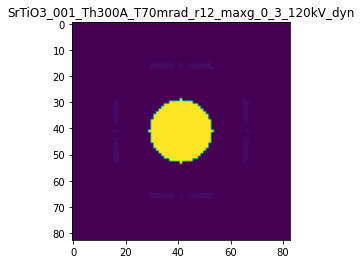

R-factor: 1.163123278348572e-07

>>> producing the 8. dataset...

The offset applied on thickness: -0.000802990777800545

The offset applied on Ug: -0.033517861837742295

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1970092221994
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

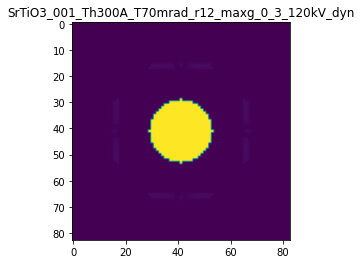

R-factor: 1.0516907937556436e-06

>>> producing the 9. dataset...

The offset applied on thickness: -0.0007510141631446649

The offset applied on Ug: 0.008908798048248219

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.24898583685535
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

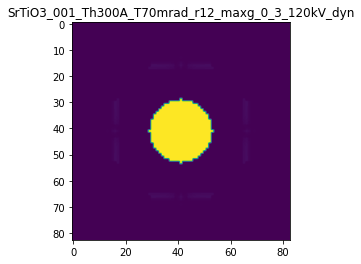

R-factor: 9.468323242916228e-07

>>> producing the 10. dataset...

The offset applied on thickness: 7.822494064918973e-05

The offset applied on Ug: -0.03266030252354685

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0782249406492
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

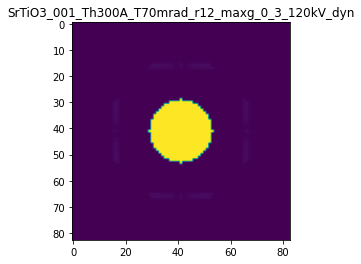

R-factor: 2.564165406037161e-07

>>> producing the 11. dataset...

The offset applied on thickness: -0.0006701916391545177

The offset applied on Ug: 0.029310126591741162

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3298083608455
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

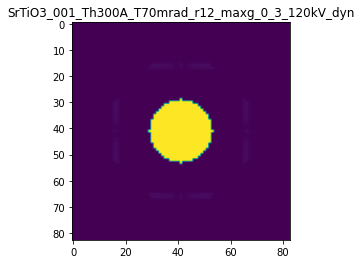

R-factor: 8.858597441440482e-07

>>> producing the 12. dataset...

The offset applied on thickness: -0.0004770523691591704

The offset applied on Ug: 0.030711835355334012

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5229476308408
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

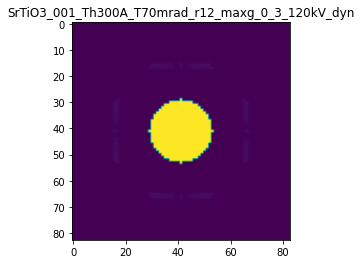

R-factor: 6.646970125830043e-07

>>> producing the 13. dataset...

The offset applied on thickness: 0.0006260302237258119

The offset applied on Ug: -0.029342485446521797

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6260302237258
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

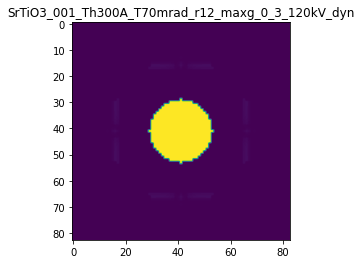

R-factor: 8.355071022782048e-07

>>> producing the 14. dataset...

The offset applied on thickness: -0.0002905583978189692

The offset applied on Ug: -0.004219625570047558

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.709441602181
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

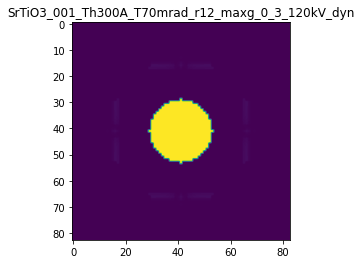

R-factor: 3.699388990344587e-07

>>> producing the 15. dataset...

The offset applied on thickness: 0.00024792066536445814

The offset applied on Ug: -0.003942677762883413

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2479206653644
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

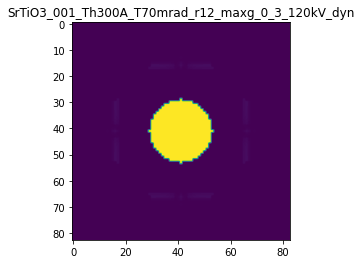

R-factor: 3.141789829906125e-07

>>> producing the 16. dataset...

The offset applied on thickness: -0.00026350166398399823

The offset applied on Ug: 0.0154209952688971

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.736498336016
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

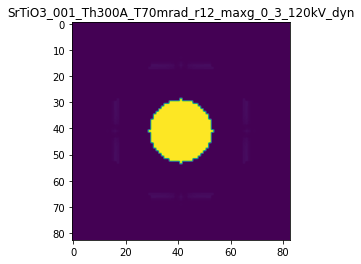

R-factor: 3.6119228287347466e-07

>>> producing the 17. dataset...

The offset applied on thickness: -0.0009750546768405171

The offset applied on Ug: 0.014831850744650899

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0249453231595
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

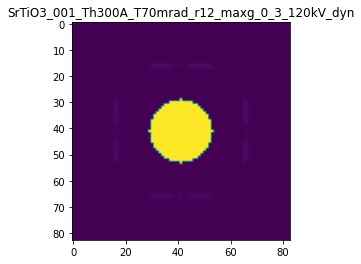

R-factor: 1.2320817689657334e-06

>>> producing the 18. dataset...

The offset applied on thickness: -0.0007428632460908211

The offset applied on Ug: -0.03653995465317184

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2571367539092
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

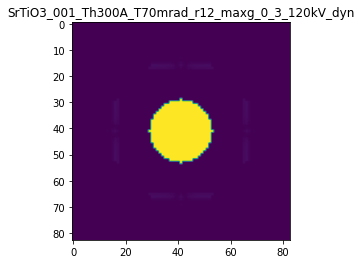

R-factor: 9.80985399230923e-07

>>> producing the 19. dataset...

The offset applied on thickness: 1.750380650190597e-05

The offset applied on Ug: -0.010281606177131603

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0175038065019
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

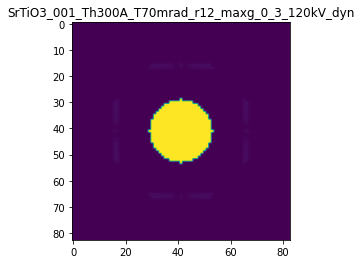

R-factor: 7.485974153384196e-08

>>> producing the 20. dataset...

The offset applied on thickness: 0.0005976993677698228

The offset applied on Ug: 0.038267925969541906

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5976993677698
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

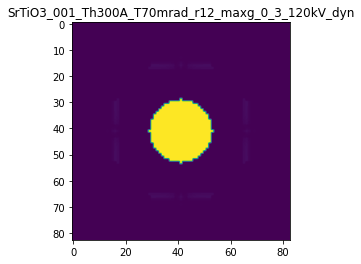

R-factor: 8.056821992164887e-07

>>> producing the 21. dataset...

The offset applied on thickness: -0.0008852564647543786

The offset applied on Ug: 0.010006872446269082

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.11474353524557
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

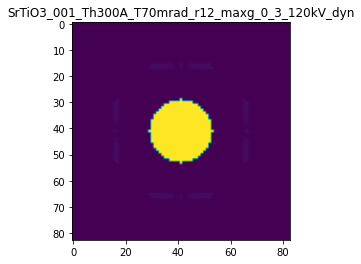

R-factor: 1.1156725127956862e-06

>>> producing the 22. dataset...

The offset applied on thickness: 0.000273980218636825

The offset applied on Ug: -0.012998036693893367

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.27398021863684
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

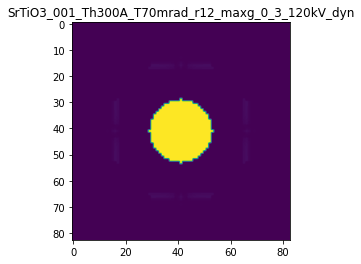

R-factor: 3.658838244561121e-07

>>> producing the 23. dataset...

The offset applied on thickness: -0.00037947923944054666

The offset applied on Ug: -0.00422353073044822

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.62052076055943
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

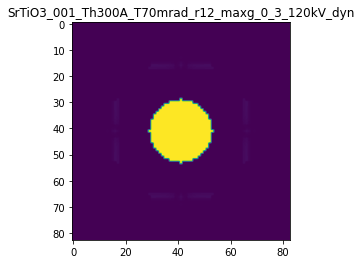

R-factor: 4.814588040331784e-07

>>> producing the 24. dataset...

The offset applied on thickness: 5.4681904670543346e-05

The offset applied on Ug: -0.024902017084455004

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.05468190467053
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

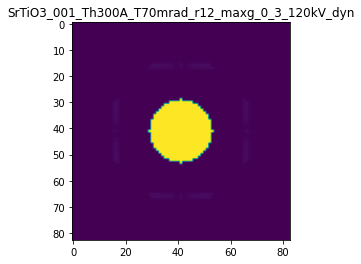

R-factor: 1.9133860798814098e-07

>>> producing the 25. dataset...

The offset applied on thickness: 0.0007491518189774334

The offset applied on Ug: -0.03843077865524861

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.74915181897745
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

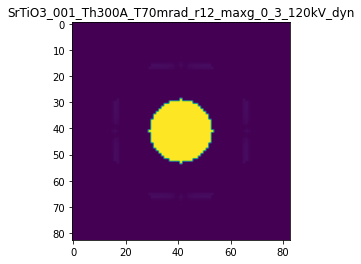

R-factor: 1.0099138450406595e-06

>>> producing the 26. dataset...

The offset applied on thickness: -0.0008155084713909688

The offset applied on Ug: 0.03665906441210913

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.18449152860904
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

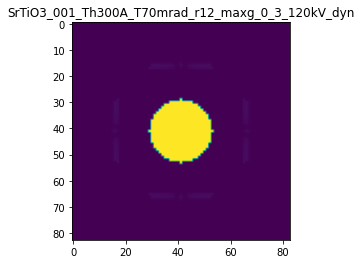

R-factor: 1.0805678266416508e-06

>>> producing the 27. dataset...

The offset applied on thickness: 0.00041054800848354134

The offset applied on Ug: 0.028930094610519496

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.41054800848354
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

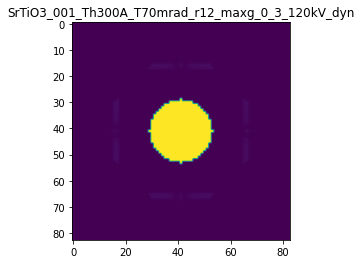

R-factor: 5.578619267312353e-07

>>> producing the 28. dataset...

The offset applied on thickness: -0.0008724285712845997

The offset applied on Ug: -0.019866402343595792

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1275714287154
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

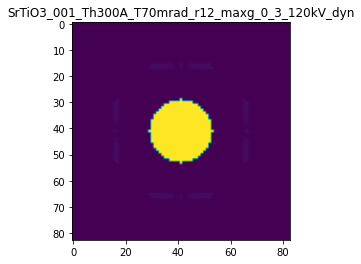

R-factor: 1.1193817923374724e-06

>>> producing the 29. dataset...

The offset applied on thickness: 0.0003220382340698702

The offset applied on Ug: -0.02625263793819321

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.32203823406985
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

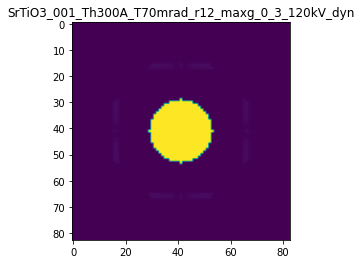

R-factor: 4.7139132856892237e-07

>>> producing the 30. dataset...

The offset applied on thickness: 0.0008853321534322265

The offset applied on Ug: 0.025864269422573784

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8853321534322
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

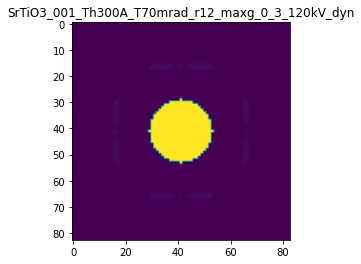

R-factor: 1.1478381762853964e-06

>>> producing the 31. dataset...

The offset applied on thickness: -2.16380029740213e-05

The offset applied on Ug: 0.03710210920142495

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.978361997026
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

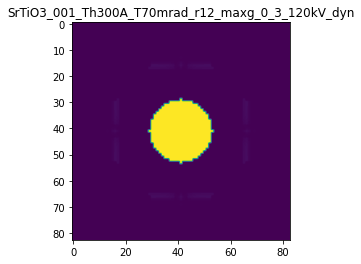

R-factor: 2.407951086423903e-07

>>> producing the 32. dataset...

The offset applied on thickness: 0.0005921264599349693

The offset applied on Ug: 0.0024205520137966017

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.59212645993495
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

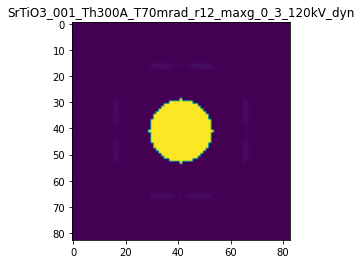

R-factor: 7.487374087709001e-07

>>> producing the 33. dataset...

The offset applied on thickness: -0.0005101308710420038

The offset applied on Ug: 0.018713679717950786

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.489869128958
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

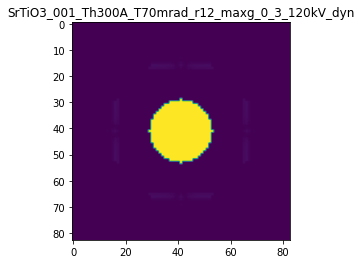

R-factor: 6.639466535142089e-07

>>> producing the 34. dataset...

The offset applied on thickness: -0.0006618179548422783

The offset applied on Ug: 0.03177562971873137

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.33818204515774
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

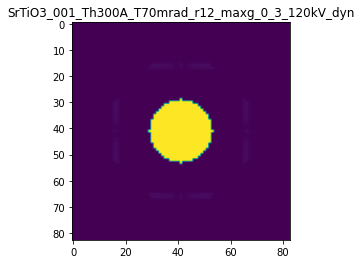

R-factor: 8.831994175763859e-07

>>> producing the 35. dataset...

The offset applied on thickness: -0.0001481823476201831

The offset applied on Ug: -0.013102413073945733

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8518176523798
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

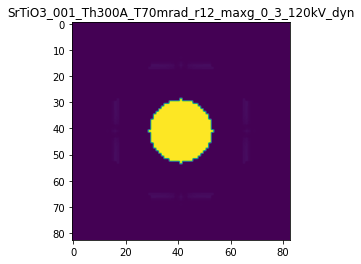

R-factor: 2.0581565213966078e-07

>>> producing the 36. dataset...

The offset applied on thickness: -0.00071164882626981

The offset applied on Ug: 0.003087940469541799

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2883511737302
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

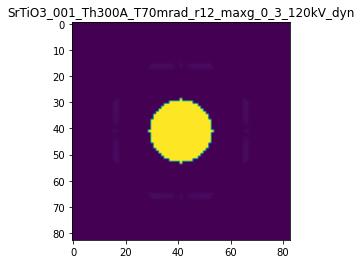

R-factor: 8.958904558919004e-07

>>> producing the 37. dataset...

The offset applied on thickness: 0.00022198292122000286

The offset applied on Ug: -0.011443353940261032

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.22198292122
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

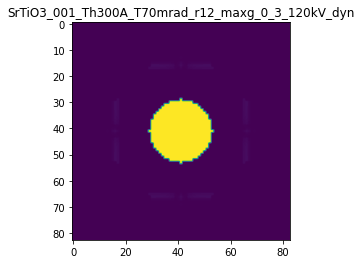

R-factor: 2.991260189044158e-07

>>> producing the 38. dataset...

The offset applied on thickness: 0.0007894984043433955

The offset applied on Ug: -0.03453326535955667

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.78949840434336
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

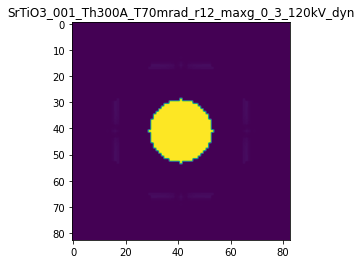

R-factor: 1.0466472376352885e-06

>>> producing the 39. dataset...

The offset applied on thickness: -9.449625621242519e-05

The offset applied on Ug: 0.002139840081260127

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.90550374378756
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

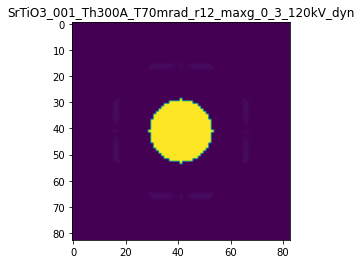

R-factor: 1.2053401227008498e-07

>>> producing the 40. dataset...

The offset applied on thickness: -0.0009605428273652503

The offset applied on Ug: -0.02326682777218645

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.03945717263474
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

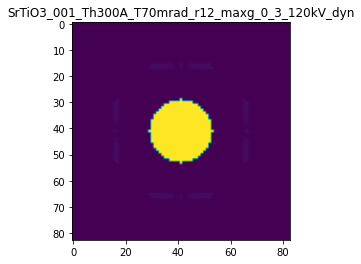

R-factor: 1.2341455489026068e-06

>>> producing the 41. dataset...

The offset applied on thickness: 0.0005144782806307651

The offset applied on Ug: 0.0068404111852209135

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5144782806308
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

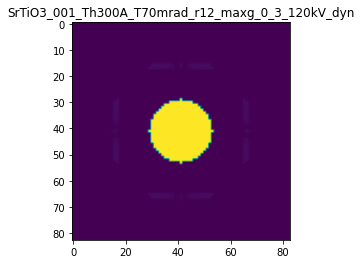

R-factor: 6.553348243862025e-07

>>> producing the 42. dataset...

The offset applied on thickness: -0.00019922201554478704

The offset applied on Ug: -0.0204723977499735

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8007779844552
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

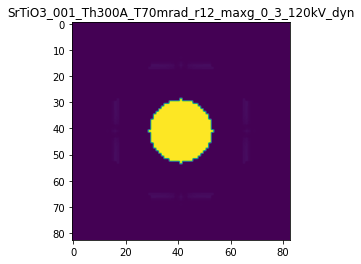

R-factor: 2.818992238462369e-07

>>> producing the 43. dataset...

The offset applied on thickness: -0.0006137663525034891

The offset applied on Ug: -0.03765343668654983

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3862336474965
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

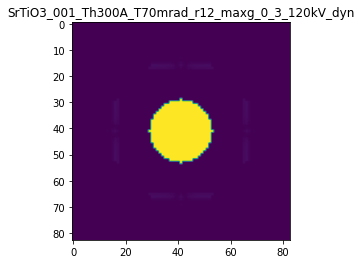

R-factor: 8.226906575543847e-07

>>> producing the 44. dataset...

The offset applied on thickness: -0.0009421021842314257

The offset applied on Ug: 0.02134276376459513

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.05789781576857
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

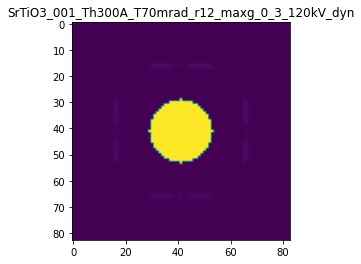

R-factor: 1.2000127172731042e-06

>>> producing the 45. dataset...

The offset applied on thickness: 0.0008936161215784837

The offset applied on Ug: 0.0016696056774100577

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8936161215785
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

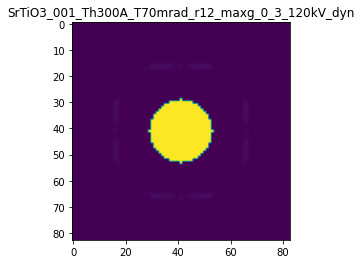

R-factor: 1.1287021545400573e-06

>>> producing the 46. dataset...

The offset applied on thickness: 0.0003883825950177562

The offset applied on Ug: 0.001308374570081119

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3883825950178
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

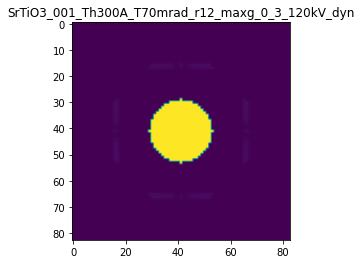

R-factor: 4.906328337409641e-07

>>> producing the 47. dataset...

The offset applied on thickness: -0.000589952120548419

The offset applied on Ug: -0.027773914151951552

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.41004787945155
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

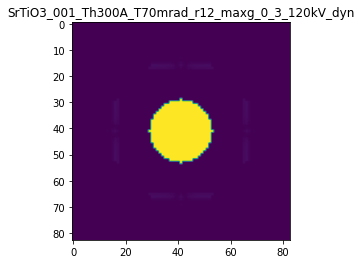

R-factor: 7.775041183893569e-07

>>> producing the 48. dataset...

The offset applied on thickness: -0.0007610642662976341

The offset applied on Ug: -0.023645783471120528

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.23893573370236
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

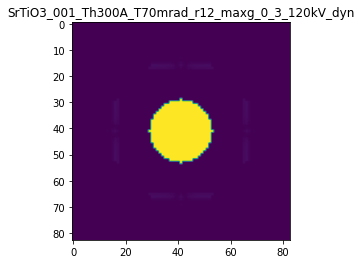

R-factor: 9.854585311157508e-07

>>> producing the 49. dataset...

The offset applied on thickness: 0.0008587493350527214

The offset applied on Ug: 0.025957785163115876

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.85874933505266
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

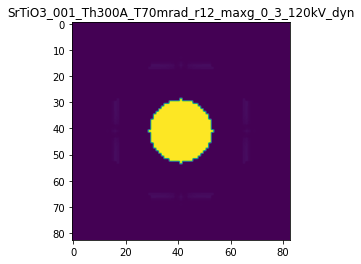

R-factor: 1.1145422222056547e-06

>>> producing the 50. dataset...

The offset applied on thickness: -0.0008411312608932767

The offset applied on Ug: -0.028391435061812118

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1588687391067
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

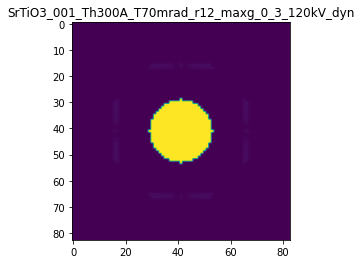

R-factor: 1.0920843370726955e-06

>>> producing the 51. dataset...

The offset applied on thickness: 0.0002653728968697133

The offset applied on Ug: -0.0334454276644555

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.26537289686974
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

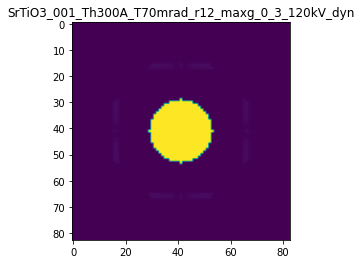

R-factor: 4.399623936837145e-07

>>> producing the 52. dataset...

The offset applied on thickness: -0.0005162514350698016

The offset applied on Ug: -0.0011942251222725275

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4837485649302
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

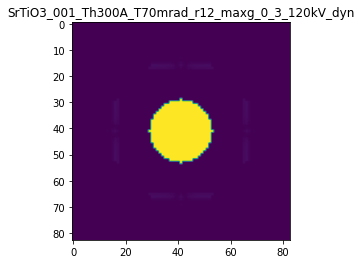

R-factor: 6.504077308326955e-07

>>> producing the 53. dataset...

The offset applied on thickness: -0.0004745835784353243

The offset applied on Ug: 0.019344645752029124

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.52541642156467
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

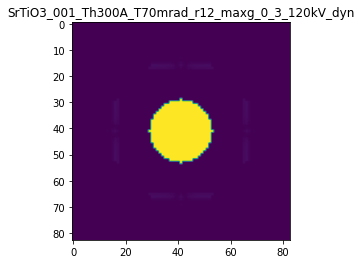

R-factor: 6.233747272778084e-07

>>> producing the 54. dataset...

The offset applied on thickness: 0.0007141386393485301

The offset applied on Ug: 0.024173127998133755

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.71413863934856
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

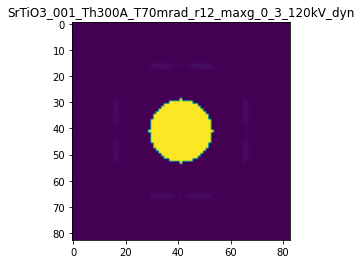

R-factor: 9.302471944820478e-07

>>> producing the 55. dataset...

The offset applied on thickness: 3.313909327445619e-05

The offset applied on Ug: 0.024673448573020586

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.03313909327443
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

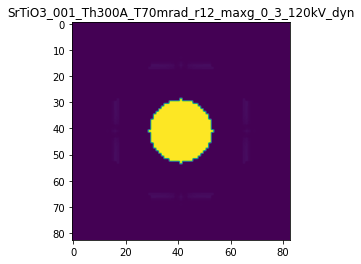

R-factor: 1.4692682288329527e-07

>>> producing the 56. dataset...

The offset applied on thickness: 0.0007620891956581215

The offset applied on Ug: -0.001952303834872815

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7620891956581
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

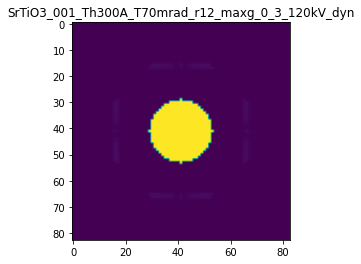

R-factor: 9.616343110805142e-07

>>> producing the 57. dataset...

The offset applied on thickness: -0.0004179557346084666

The offset applied on Ug: 0.0031510013411176277

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5820442653915
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

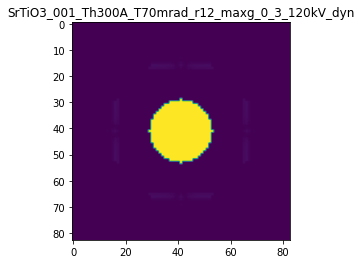

R-factor: 5.26775911390536e-07

>>> producing the 58. dataset...

The offset applied on thickness: -0.0001486314109133189

The offset applied on Ug: 0.03928805231834452

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8513685890867
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

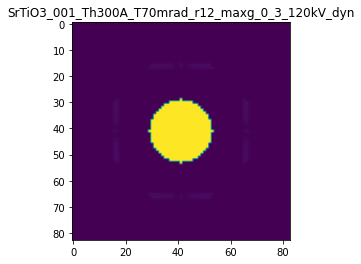

R-factor: 3.563258126733156e-07

>>> producing the 59. dataset...

The offset applied on thickness: 0.0005340922005639268

The offset applied on Ug: -0.037760689839944586

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5340922005639
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

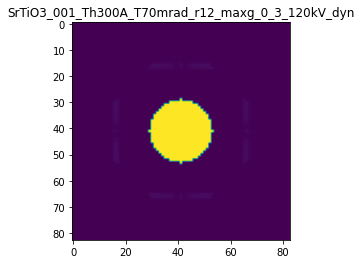

R-factor: 7.588966393269861e-07

>>> producing the 60. dataset...

The offset applied on thickness: 7.26136041990697e-05

The offset applied on Ug: -0.009205788778708293

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0726136041991
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

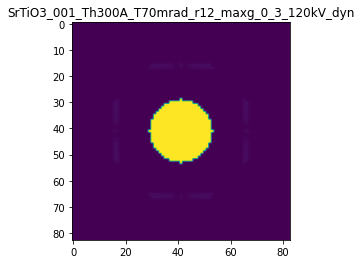

R-factor: 1.2062181980398537e-07

>>> producing the 61. dataset...

The offset applied on thickness: -0.0005591528758980648

The offset applied on Ug: -0.030103095380874193

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4408471241019
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

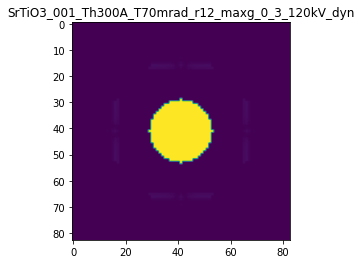

R-factor: 7.423866120499811e-07

>>> producing the 62. dataset...

The offset applied on thickness: 0.0007265493423130256

The offset applied on Ug: 0.026966259718928933

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.72654934231304
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

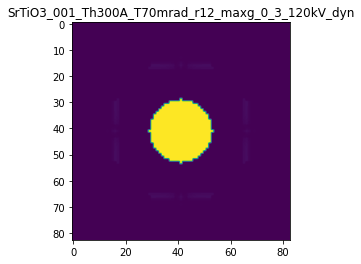

R-factor: 9.497702036216534e-07

>>> producing the 63. dataset...

The offset applied on thickness: -0.0005370679694880785

The offset applied on Ug: 0.015539123323080927

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.46293203051187
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

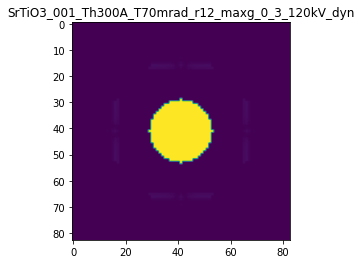

R-factor: 6.901531151846805e-07

>>> producing the 64. dataset...

The offset applied on thickness: -0.00013528554662755576

The offset applied on Ug: 0.029995417486719998

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8647144533724
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

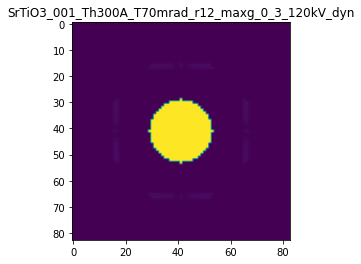

R-factor: 2.92085562123986e-07

>>> producing the 65. dataset...

The offset applied on thickness: 0.0006186186393424286

The offset applied on Ug: -0.030180270563353526

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6186186393424
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

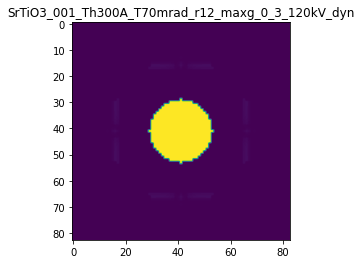

R-factor: 8.291249857416441e-07

>>> producing the 66. dataset...

The offset applied on thickness: -0.0005428759895050745

The offset applied on Ug: 0.02770297970266922

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4571240104949
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

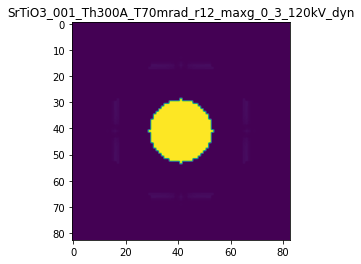

R-factor: 7.29563621791502e-07

>>> producing the 67. dataset...

The offset applied on thickness: -0.0005117028669009065

The offset applied on Ug: 0.03581372036678215

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4882971330991
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

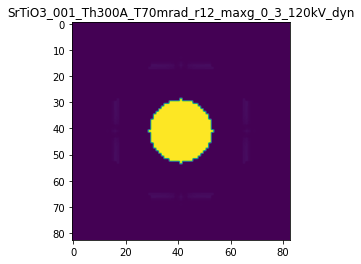

R-factor: 7.243896060698999e-07

>>> producing the 68. dataset...

The offset applied on thickness: 0.0002765906860725049

The offset applied on Ug: -0.022401295651274192

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2765906860725
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

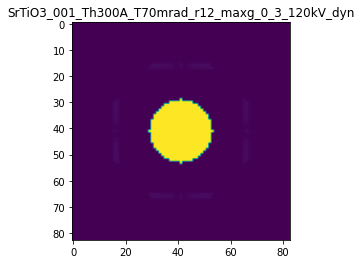

R-factor: 4.042486190532734e-07

>>> producing the 69. dataset...

The offset applied on thickness: -0.0005840455679372841

The offset applied on Ug: -0.0007854778429518117

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4159544320627
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

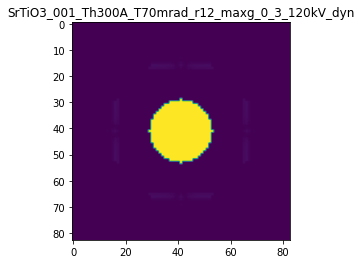

R-factor: 7.351831377926295e-07

>>> producing the 70. dataset...

The offset applied on thickness: -7.167632064126606e-05

The offset applied on Ug: 0.02620343560800472

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.92832367935875
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

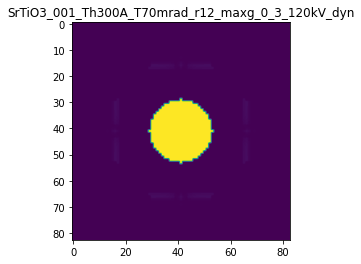

R-factor: 2.132479615414707e-07

>>> producing the 71. dataset...

The offset applied on thickness: 0.000837395084761089

The offset applied on Ug: 0.021071241511469996

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8373950847611
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

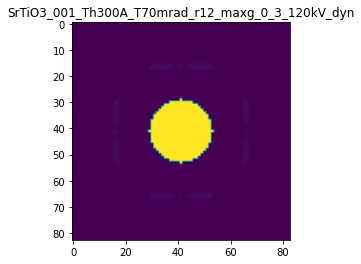

R-factor: 1.080945479502856e-06

>>> producing the 72. dataset...

The offset applied on thickness: 0.0005323399510966766

The offset applied on Ug: -0.02623470374152781

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5323399510967
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

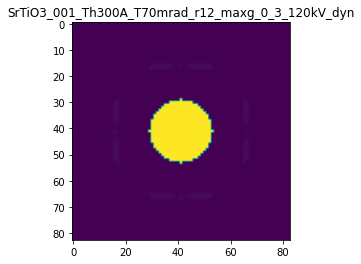

R-factor: 7.141551277275559e-07

>>> producing the 73. dataset...

The offset applied on thickness: 0.0008381679713095232

The offset applied on Ug: -0.010429482612807997

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.83816797130953
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

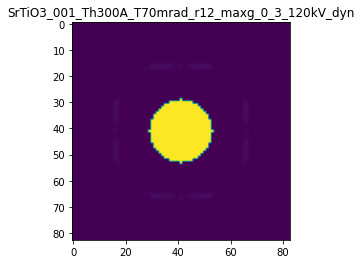

R-factor: 1.0599639102635392e-06

>>> producing the 74. dataset...

The offset applied on thickness: -0.0003074490507092018

The offset applied on Ug: -0.03547484113254261

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6925509492908
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

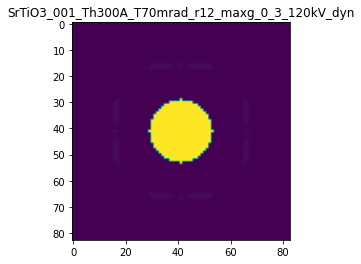

R-factor: 4.423758927902627e-07

>>> producing the 75. dataset...

The offset applied on thickness: 0.0007492289744280596

The offset applied on Ug: 0.002859742196172439

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7492289744281
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

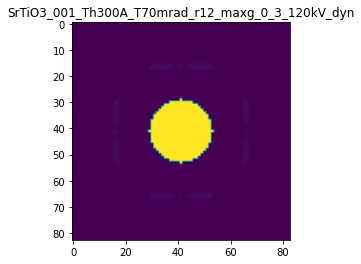

R-factor: 9.474979392028979e-07

>>> producing the 76. dataset...

The offset applied on thickness: 5.836052738557451e-05

The offset applied on Ug: -0.010140350604984746

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.05836052738556
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

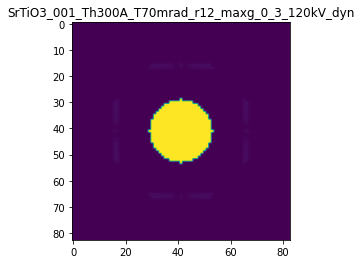

R-factor: 1.1099444006220106e-07

>>> producing the 77. dataset...

The offset applied on thickness: -0.0004728383485705914

The offset applied on Ug: -0.009055124504674153

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5271616514294
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

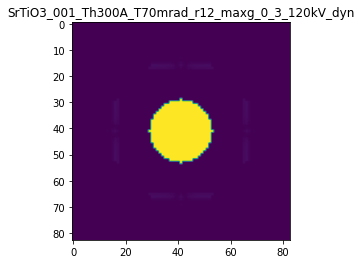

R-factor: 6.048205925776085e-07

>>> producing the 78. dataset...

The offset applied on thickness: -0.000854970060404555

The offset applied on Ug: 0.03781911051280534

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1450299395954
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

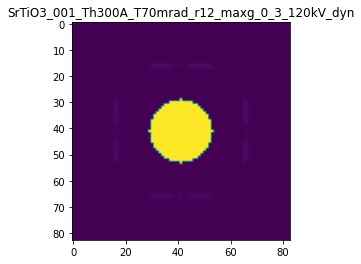

R-factor: 1.1309535581847486e-06

>>> producing the 79. dataset...

The offset applied on thickness: -0.00010024866239275055

The offset applied on Ug: 0.034601194691228736

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8997513376072
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

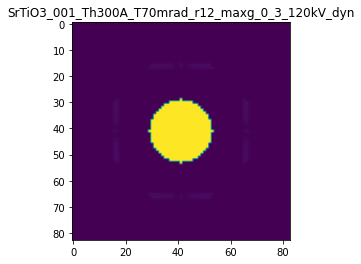

R-factor: 2.864086349925043e-07

>>> producing the 80. dataset...

The offset applied on thickness: -0.00017459997313012666

The offset applied on Ug: -0.03457925769499755

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8254000268699
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

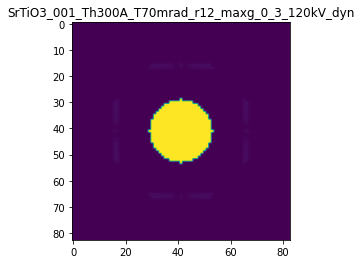

R-factor: 2.8771517510503463e-07

>>> producing the 81. dataset...

The offset applied on thickness: 5.7795428601553626e-05

The offset applied on Ug: 0.013378741802966729

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.05779542860154
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

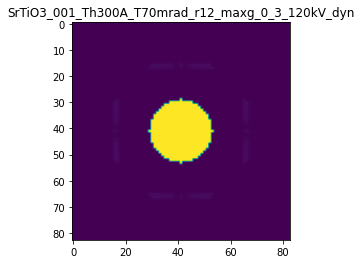

R-factor: 1.0311128983716712e-07

>>> producing the 82. dataset...

The offset applied on thickness: -0.0005795691433459522

The offset applied on Ug: 0.013227404121411742

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.42043085665404
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

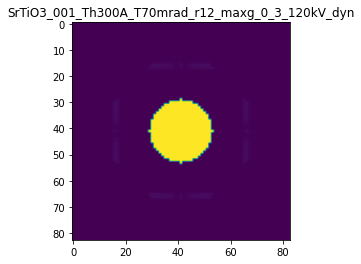

R-factor: 7.388858851408265e-07

>>> producing the 83. dataset...

The offset applied on thickness: -0.0004885958777047448

The offset applied on Ug: -0.024898790389556096

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5114041222953
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

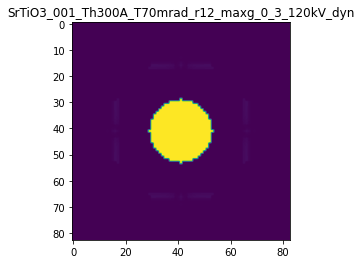

R-factor: 6.467699378140212e-07

>>> producing the 84. dataset...

The offset applied on thickness: 0.00012598826592057977

The offset applied on Ug: 0.027668624450363364

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.12598826592057
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

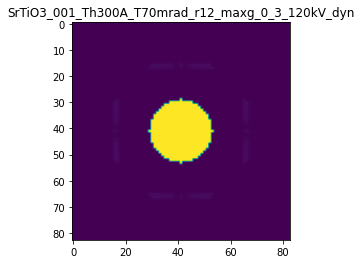

R-factor: 2.1827948589296186e-07

>>> producing the 85. dataset...

The offset applied on thickness: -7.343584555415949e-06

The offset applied on Ug: 0.01230107748464545

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.99265641544457
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

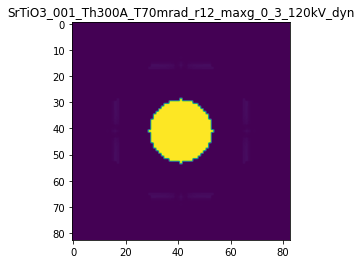

R-factor: 7.991609873315363e-08

>>> producing the 86. dataset...

The offset applied on thickness: 0.00025413682069279564

The offset applied on Ug: 0.0011363780344531005

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2541368206928
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

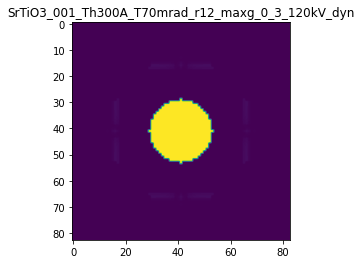

R-factor: 3.2124321893850415e-07

>>> producing the 87. dataset...

The offset applied on thickness: -0.00023984553016897814

The offset applied on Ug: -0.021540964089046426

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.76015446983104
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_f

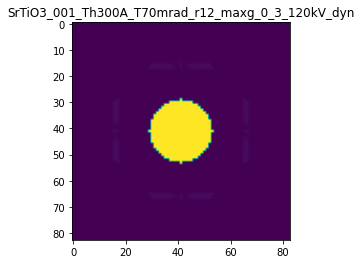

R-factor: 3.3369992717397133e-07

>>> producing the 88. dataset...

The offset applied on thickness: 0.00028005424699454505

The offset applied on Ug: -0.002104570135616335

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.28005424699455
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

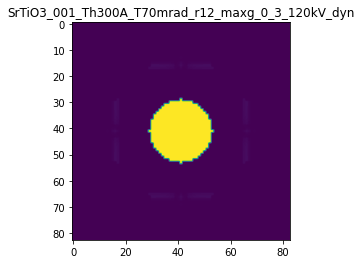

R-factor: 3.53439904525879e-07

>>> producing the 89. dataset...

The offset applied on thickness: -0.0005443329969905137

The offset applied on Ug: -0.021070052993995045

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.45566700300947
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

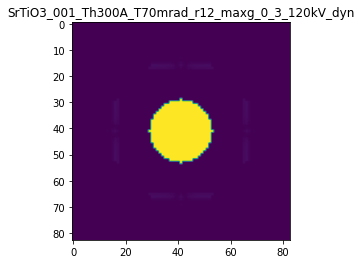

R-factor: 7.109424470302556e-07

>>> producing the 90. dataset...

The offset applied on thickness: -0.0008020491228374304

The offset applied on Ug: -0.0025580880928538006

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.19795087716255
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

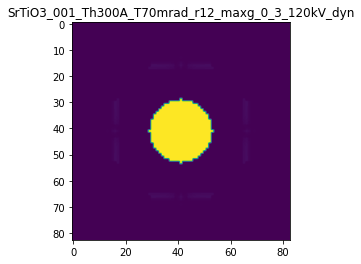

R-factor: 1.0105931851660086e-06

>>> producing the 91. dataset...

The offset applied on thickness: -0.0006512209282009555

The offset applied on Ug: -0.000870729774973329

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.348779071799
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

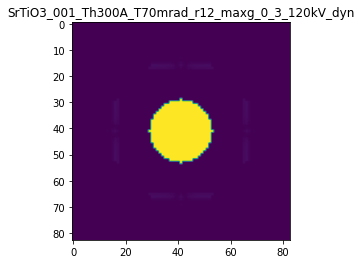

R-factor: 8.196318747928525e-07

>>> producing the 92. dataset...

The offset applied on thickness: 0.0008760984002826216

The offset applied on Ug: -0.015618822479300692

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8760984002826
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

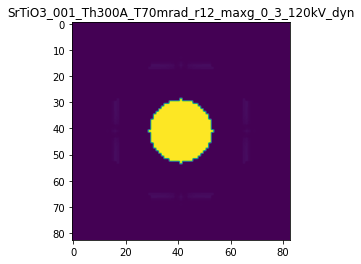

R-factor: 1.113357981395114e-06

>>> producing the 93. dataset...

The offset applied on thickness: 0.0005865399653449679

The offset applied on Ug: -0.0014685212854820052

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.58653996534497
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

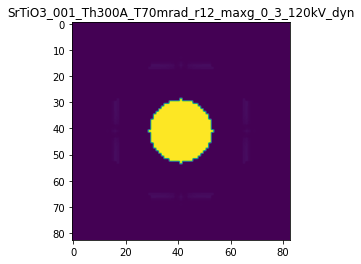

R-factor: 7.398732979323479e-07

>>> producing the 94. dataset...

The offset applied on thickness: -0.00022987054054653488

The offset applied on Ug: 0.035733672219845636

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.77012945945347
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

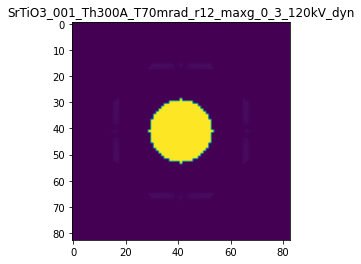

R-factor: 4.148504996214623e-07

>>> producing the 95. dataset...

The offset applied on thickness: -0.0006412115538518349

The offset applied on Ug: 0.0015646553288571408

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.35878844614814
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

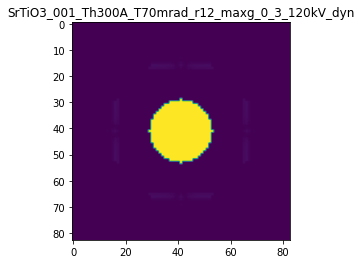

R-factor: 8.070095580600793e-07

>>> producing the 96. dataset...

The offset applied on thickness: 0.0003488203474235645

The offset applied on Ug: 0.03186124558466911

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.34882034742355
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

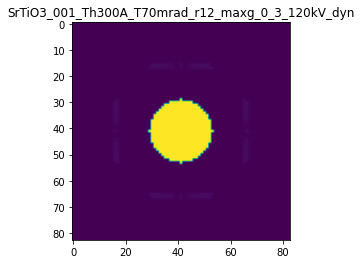

R-factor: 4.866678306138643e-07

>>> producing the 97. dataset...

The offset applied on thickness: 0.0004902498281252603

The offset applied on Ug: -0.002792826579957959

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.49024982812523
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

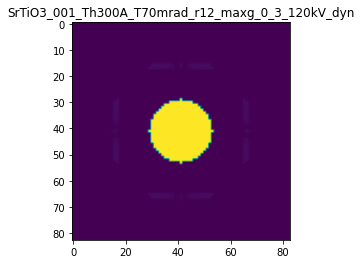

R-factor: 6.187090925118889e-07

>>> producing the 98. dataset...

The offset applied on thickness: 0.0009008465752005171

The offset applied on Ug: 0.02417066497907708

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9008465752005
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

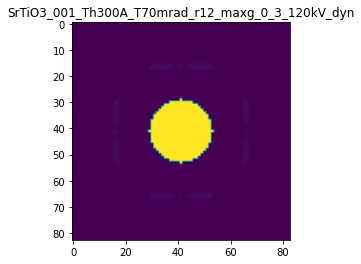

R-factor: 1.165039059118688e-06

>>> producing the 99. dataset...

The offset applied on thickness: 0.00037315240924607986

The offset applied on Ug: 0.005588277925372234

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3731524092461
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

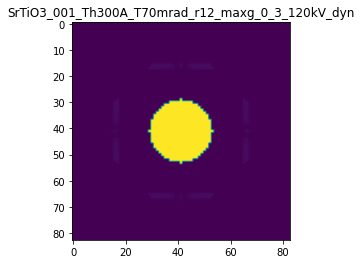

R-factor: 4.760550334160159e-07

>>> producing the 100. dataset...

The offset applied on thickness: -0.0003444521268116767

The offset applied on Ug: -0.02383328798684474

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6555478731883
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

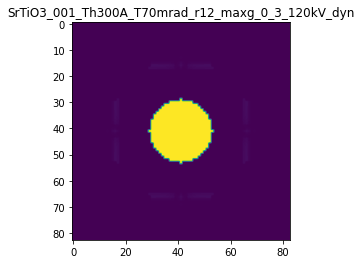

R-factor: 4.666674852071239e-07

>>> producing the 101. dataset...

The offset applied on thickness: -0.000933964677945151

The offset applied on Ug: 0.022612552466445654

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.06603532205486
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

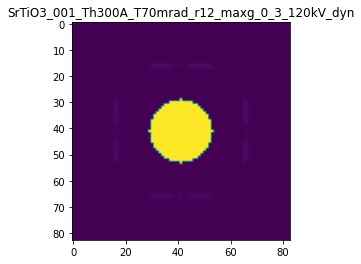

R-factor: 1.192039404280573e-06

>>> producing the 102. dataset...

The offset applied on thickness: -0.0009484675494896375

The offset applied on Ug: 0.003503796275782598

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.05153245051036
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

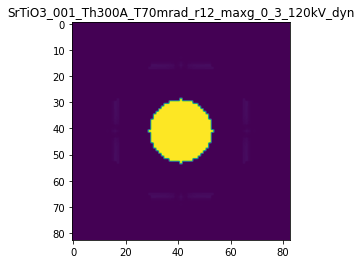

R-factor: 1.19335251474636e-06

>>> producing the 103. dataset...

The offset applied on thickness: 0.0008742329105256008

The offset applied on Ug: -0.009804759540224141

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.87423291052556
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

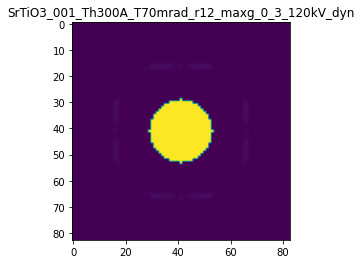

R-factor: 1.1053626952947797e-06

>>> producing the 104. dataset...

The offset applied on thickness: 0.0002289741141856989

The offset applied on Ug: 0.027965421685077152

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2289741141857
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

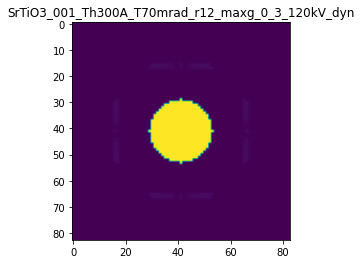

R-factor: 3.3238587419710244e-07

>>> producing the 105. dataset...

The offset applied on thickness: -0.00038087494225124053

The offset applied on Ug: -0.03721917757567374

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.61912505774876
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_f

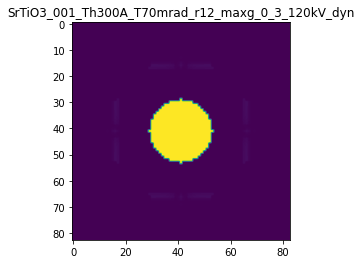

R-factor: 5.352961025275241e-07

>>> producing the 106. dataset...

The offset applied on thickness: -0.0007625505935374824

The offset applied on Ug: -0.023802877809294163

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.23744940646253
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

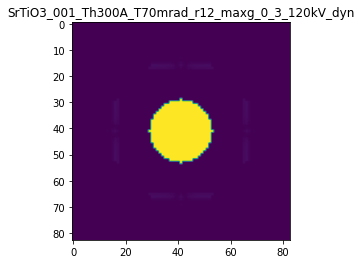

R-factor: 9.87533752114011e-07

>>> producing the 107. dataset...

The offset applied on thickness: 0.0003492197649964171

The offset applied on Ug: 0.006346203905087915

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3492197649964
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

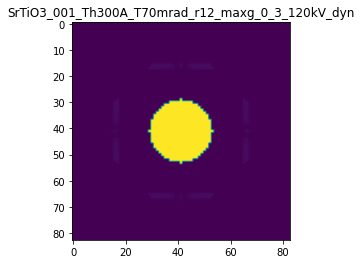

R-factor: 4.470399701718062e-07

>>> producing the 108. dataset...

The offset applied on thickness: 0.0002498653479463993

The offset applied on Ug: -0.035826487397524906

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2498653479464
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

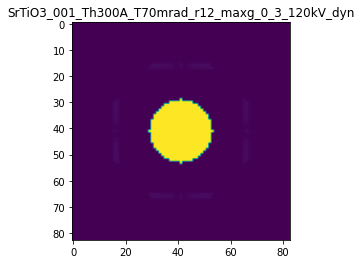

R-factor: 4.358490628435866e-07

>>> producing the 109. dataset...

The offset applied on thickness: 0.00022065496218304893

The offset applied on Ug: -0.029386797887978613

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.220654962183
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

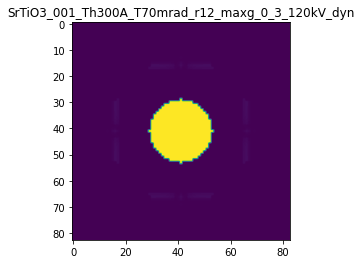

R-factor: 3.73606376406006e-07

>>> producing the 110. dataset...

The offset applied on thickness: 0.0004652643530111484

The offset applied on Ug: 0.025792235922894955

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.46526435301115
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

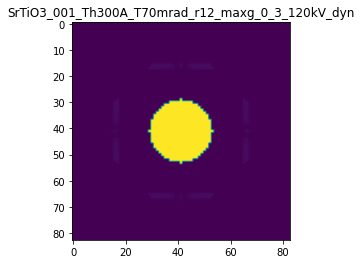

R-factor: 6.200808645830785e-07

>>> producing the 111. dataset...

The offset applied on thickness: -0.0005425474157105886

The offset applied on Ug: -0.028104433975317804

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4574525842894
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

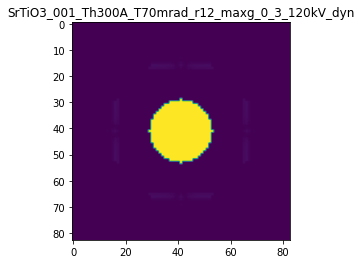

R-factor: 7.187714085649642e-07

>>> producing the 112. dataset...

The offset applied on thickness: -0.0003970777456709127

The offset applied on Ug: -0.03503166445527946

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.60292225432903
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

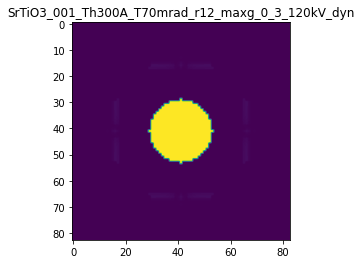

R-factor: 5.512561386824214e-07

>>> producing the 113. dataset...

The offset applied on thickness: -0.0001576868943829639

The offset applied on Ug: -0.03892787881074604

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.84231310561705
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

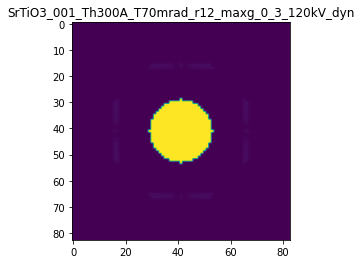

R-factor: 2.919957825557736e-07

>>> producing the 114. dataset...

The offset applied on thickness: 0.0005765728661757475

The offset applied on Ug: 0.01975558740291861

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.57657286617575
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

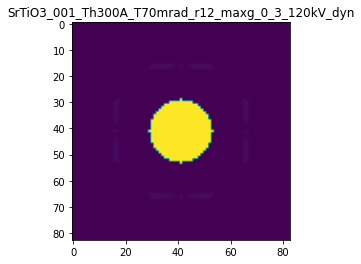

R-factor: 7.51199148586087e-07

>>> producing the 115. dataset...

The offset applied on thickness: -0.0008917657419463004

The offset applied on Ug: 0.03890943932545459

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.10823425805364
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

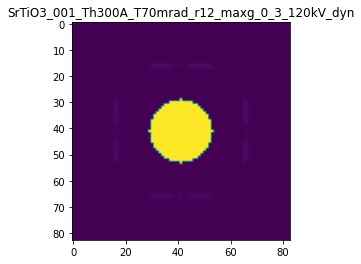

R-factor: 1.177954454052309e-06

>>> producing the 116. dataset...

The offset applied on thickness: -0.000477651057213067

The offset applied on Ug: -0.01831737346416629

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5223489427869
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

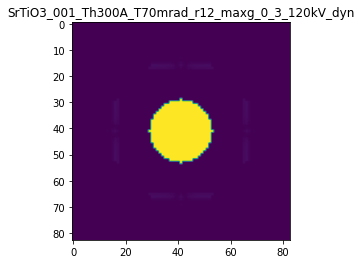

R-factor: 6.236900878993801e-07

>>> producing the 117. dataset...

The offset applied on thickness: -0.0007909932377913422

The offset applied on Ug: -0.017321286685060874

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2090067622086
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

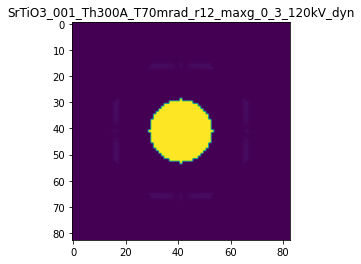

R-factor: 1.0141108981278468e-06

>>> producing the 118. dataset...

The offset applied on thickness: 0.0007645374842132448

The offset applied on Ug: 0.0022576614617913207

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.76453748421324
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

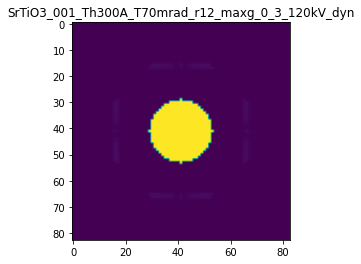

R-factor: 9.66232733685954e-07

>>> producing the 119. dataset...

The offset applied on thickness: 0.00025722222168725106

The offset applied on Ug: 0.015886984848473455

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2572222216872
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

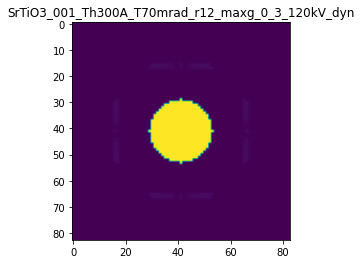

R-factor: 3.4554081883605494e-07

>>> producing the 120. dataset...

The offset applied on thickness: -0.0005310725931189241

The offset applied on Ug: -0.016764532654916824

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4689274068811
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

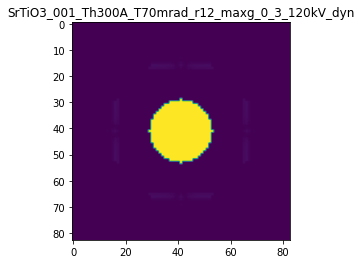

R-factor: 6.88343760515363e-07

>>> producing the 121. dataset...

The offset applied on thickness: 0.0005630734826088053

The offset applied on Ug: -0.03039393729757598

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5630734826088
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

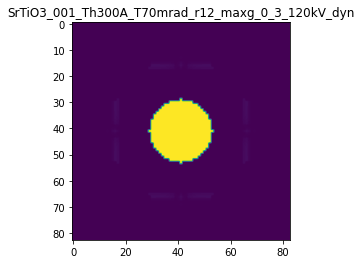

R-factor: 7.635060913311162e-07

>>> producing the 122. dataset...

The offset applied on thickness: -0.00032723725323216833

The offset applied on Ug: 0.03589532356288859

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6727627467678
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

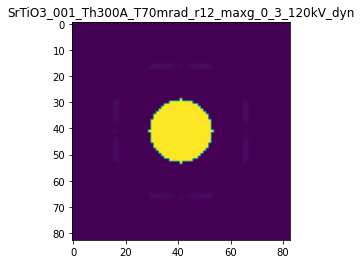

R-factor: 5.163425169715374e-07

>>> producing the 123. dataset...

The offset applied on thickness: 0.00047316795925490406

The offset applied on Ug: 0.0018901873047755834

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4731679592549
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

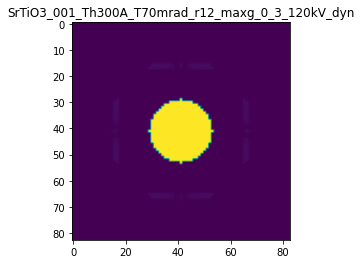

R-factor: 5.981325576736693e-07

>>> producing the 124. dataset...

The offset applied on thickness: -0.0007569694687968864

The offset applied on Ug: -0.019295420965257177

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2430305312031
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

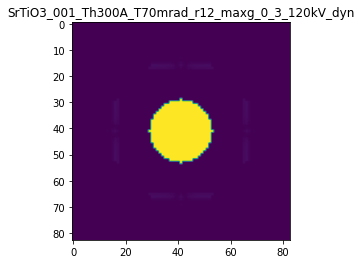

R-factor: 9.743194675722075e-07

>>> producing the 125. dataset...

The offset applied on thickness: 1.2634034973801222e-05

The offset applied on Ug: -0.025643314927245003

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0126340349738
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

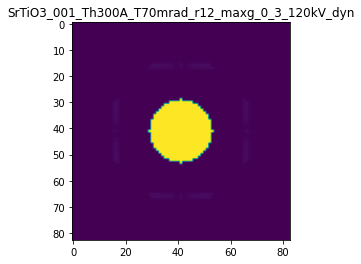

R-factor: 1.648365914638994e-07

>>> producing the 126. dataset...

The offset applied on thickness: -0.00039221223414888894

The offset applied on Ug: -0.03901664070611376

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6077877658511
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

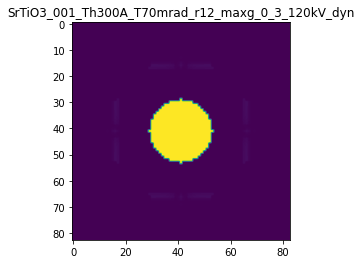

R-factor: 5.52529774414205e-07

>>> producing the 127. dataset...

The offset applied on thickness: -0.0003619004582806651

The offset applied on Ug: 0.026901384981386264

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6380995417193
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

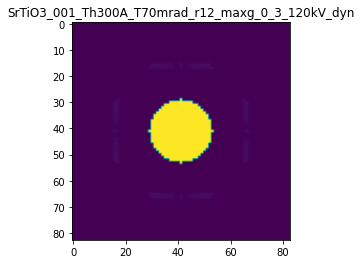

R-factor: 5.187181813796097e-07

>>> producing the 128. dataset...

The offset applied on thickness: 9.842604810634882e-05

The offset applied on Ug: 0.03872124435020105

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0984260481063
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

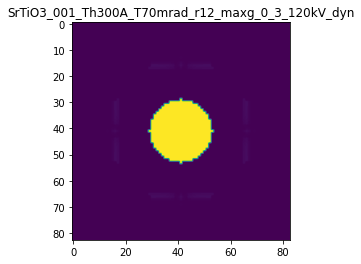

R-factor: 2.51963357382472e-07

>>> producing the 129. dataset...

The offset applied on thickness: 0.0009950969787515113

The offset applied on Ug: 0.007147944361203864

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.99509697875146
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

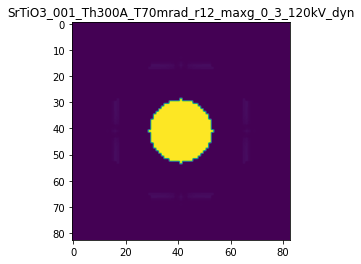

R-factor: 1.2623870214094549e-06

>>> producing the 130. dataset...

The offset applied on thickness: 0.0005910088645343523

The offset applied on Ug: -0.019729405279372232

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.59100886453433
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

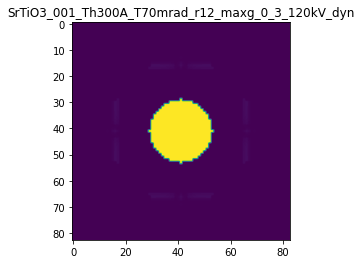

R-factor: 7.660342940399695e-07

>>> producing the 131. dataset...

The offset applied on thickness: -0.0006495838054211518

The offset applied on Ug: 0.035135448211070223

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3504161945789
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

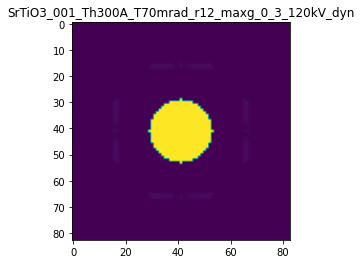

R-factor: 8.790833641509375e-07

>>> producing the 132. dataset...

The offset applied on thickness: 0.00020566610180178404

The offset applied on Ug: 0.004540659952373822

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2056661018018
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

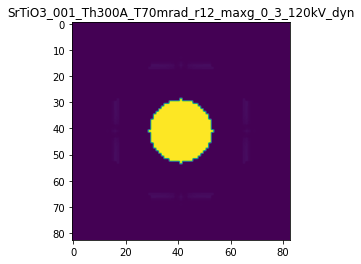

R-factor: 2.6431920288909215e-07

>>> producing the 133. dataset...

The offset applied on thickness: -0.00020424207232564928

The offset applied on Ug: 0.004744854124381934

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.79575792767434
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_f

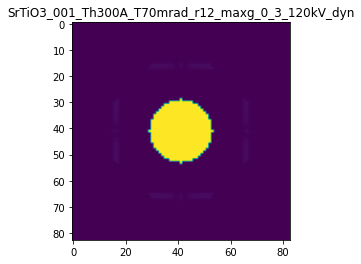

R-factor: 2.606916589031071e-07

>>> producing the 134. dataset...

The offset applied on thickness: -0.0007681029112613023

The offset applied on Ug: 0.03332680841358939

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2318970887387
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

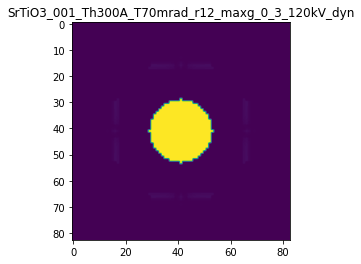

R-factor: 1.0142940221836157e-06

>>> producing the 135. dataset...

The offset applied on thickness: -0.00015190801873745795

The offset applied on Ug: -0.012961274779841938

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.84809198126254
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_

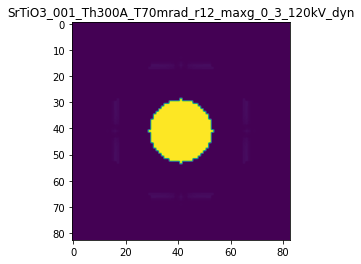

R-factor: 2.1016027700530308e-07

>>> producing the 136. dataset...

The offset applied on thickness: -0.0007588951600953173

The offset applied on Ug: 0.02583532978919518

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.24110483990466
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

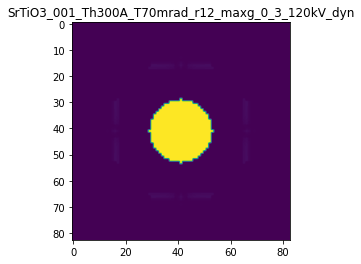

R-factor: 9.822385018252425e-07

>>> producing the 137. dataset...

The offset applied on thickness: -0.00041065798953480905

The offset applied on Ug: 0.02130166412631411

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.58934201046515
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

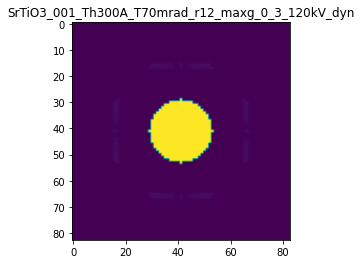

R-factor: 5.530509055561162e-07

>>> producing the 138. dataset...

The offset applied on thickness: 0.00012586145299076245

The offset applied on Ug: -0.014526071443155954

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.12586145299076
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

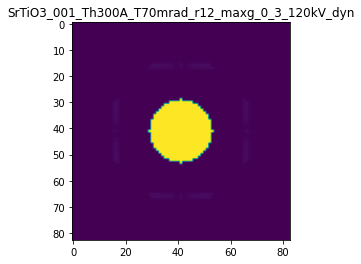

R-factor: 2.0217111289147804e-07

>>> producing the 139. dataset...

The offset applied on thickness: 0.0006105609250192752

The offset applied on Ug: -0.017492177966635474

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.61056092501923
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

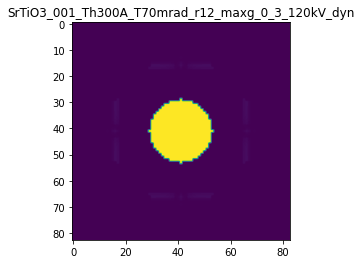

R-factor: 7.860608540746433e-07

>>> producing the 140. dataset...

The offset applied on thickness: -0.0009712421566265275

The offset applied on Ug: 0.005003758460165156

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.02875784337346
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

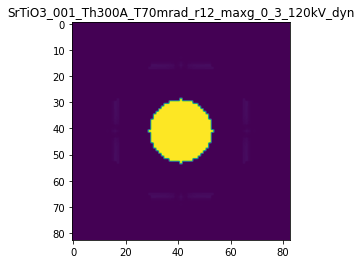

R-factor: 1.2223173471475047e-06



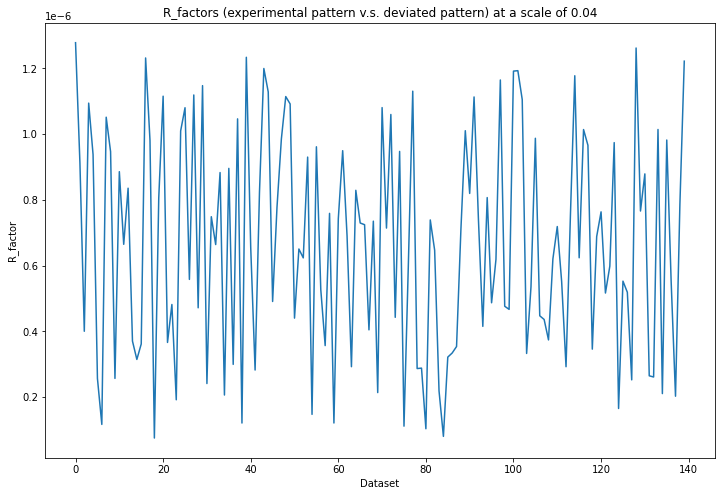

>>> start to train the ANN 

Epoch 1/30
5/5 [==============================] - 1s 127ms/step - loss: 0.3617 - acc: 0.8000 - val_loss: 0.3557 - val_acc: 1.0000
Epoch 2/30
5/5 [==============================] - 1s 107ms/step - loss: 0.3397 - acc: 1.0000 - val_loss: 0.3168 - val_acc: 1.0000
Epoch 3/30
5/5 [==============================] - 1s 109ms/step - loss: 0.2964 - acc: 1.0000 - val_loss: 0.2543 - val_acc: 1.0000
Epoch 4/30
5/5 [==============================] - 1s 108ms/step - loss: 0.2471 - acc: 1.0000 - val_loss: 0.2215 - val_acc: 1.0000
Epoch 5/30
5/5 [==============================] - 1s 108ms/step - loss: 0.2048 - acc: 1.0000 - val_loss: 0.1807 - val_acc: 1.0000
Epoch 6/30
5/5 [==============================] - 1s 108ms/step - loss: 0.1659 - acc: 1.0000 - val_loss: 0.1449 - val_acc: 1.0000
Epoch 7/30
5/5 [==============================] - 1s 109ms/step - loss: 0.1319 - acc: 1.0000 - val_loss: 0.1265 - val_acc: 1.0000
Epoch 8/30
5/5 [==============================] - 1s 107ms/st

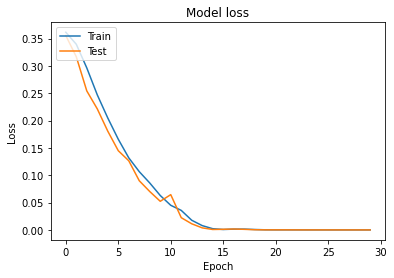

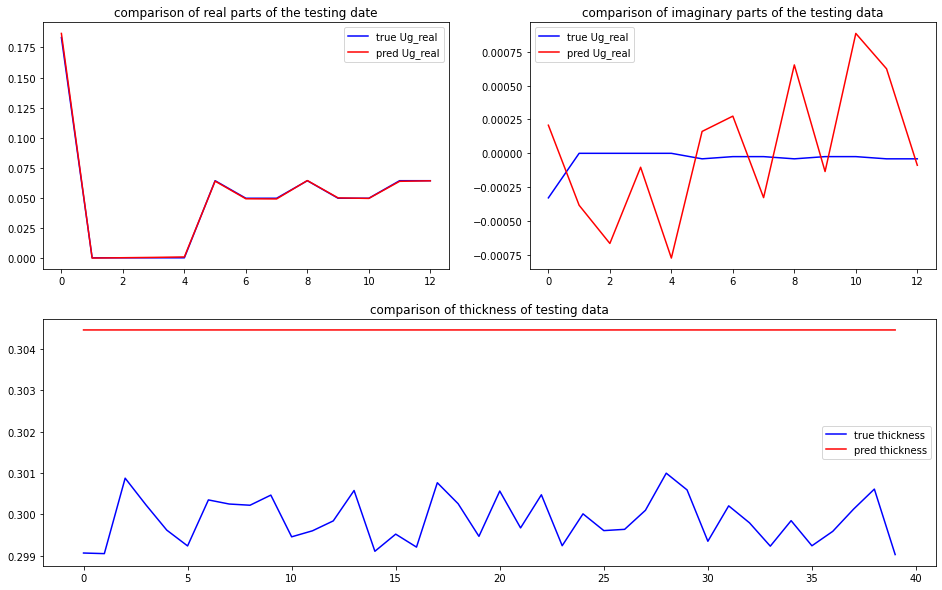

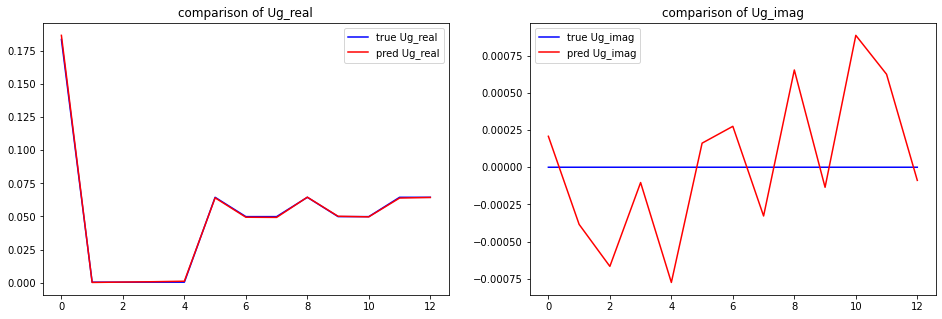

predicted thickness: 30.445575714111328 nm
mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=304.4557571411133
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 13 different beams

InputUg:
[0.18661956+0.00000000e+00j 0.0

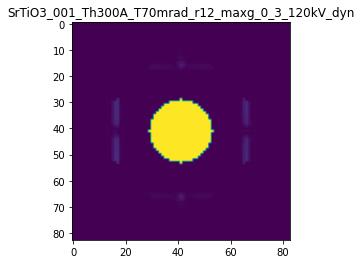

X_sim.max(): 0.9999960282706828
R-factor at a scale of 0.04 is 0.00045696097812471394.

-----------------------------------------------------------------------------------------------------

>>> start to produce Dataset at a scale of 0.08

-----------------------------------------------------------------------------------------------------

>>> producing the 1. dataset...

The offset applied on thickness: 0.0002800524036309211

The offset applied on Ug: 0.027922267323213016

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001

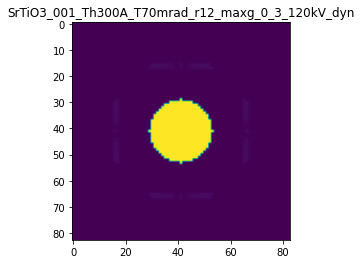

R-factor: 3.94812058593728e-07

>>> producing the 2. dataset...

The offset applied on thickness: 0.0001484687879956277

The offset applied on Ug: 0.03794960963093795

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1484687879956
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

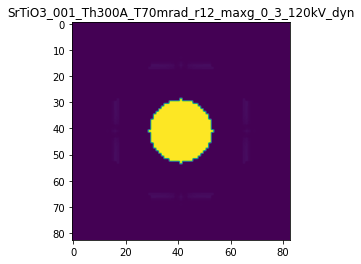

R-factor: 2.8081960432822044e-07

>>> producing the 3. dataset...

The offset applied on thickness: 0.0006553112563963562

The offset applied on Ug: 0.0720234300927215

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6553112563963
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

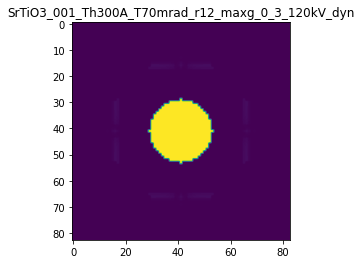

R-factor: 9.362436159757492e-07

>>> producing the 4. dataset...

The offset applied on thickness: -9.565152764659857e-05

The offset applied on Ug: 0.017378313592667498

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9043484723534
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

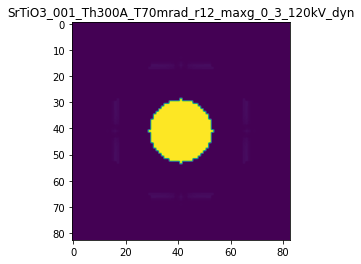

R-factor: 1.8588616245487028e-07

>>> producing the 5. dataset...

The offset applied on thickness: -0.0005013059061555467

The offset applied on Ug: -0.026376932158015193

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.49869409384445
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

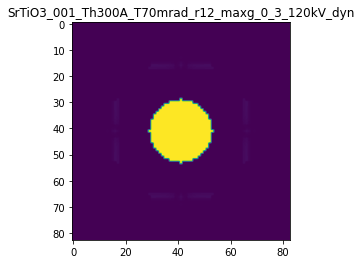

R-factor: 6.647714531795972e-07

>>> producing the 6. dataset...

The offset applied on thickness: -0.00036958387009789287

The offset applied on Ug: 0.04690642828951093

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6304161299021
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

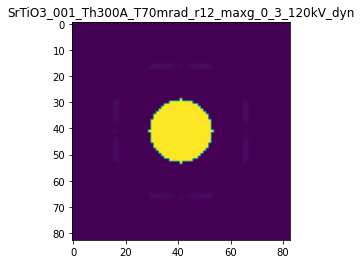

R-factor: 6.135858923037319e-07

>>> producing the 7. dataset...

The offset applied on thickness: 0.00016305136778459105

The offset applied on Ug: 0.07730771129615463

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1630513677846
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

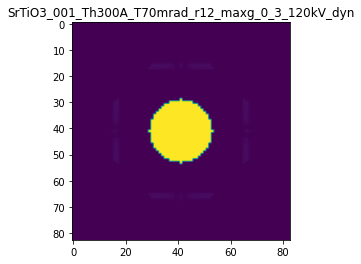

R-factor: 4.835513919315061e-07

>>> producing the 8. dataset...

The offset applied on thickness: -0.0008197983043338513

The offset applied on Ug: 0.05084678337356408

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.18020169566614
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

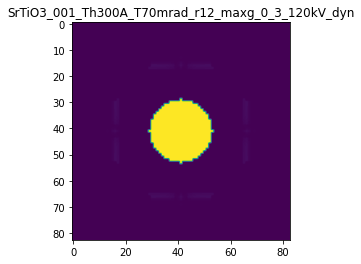

R-factor: 1.1339860843362289e-06

>>> producing the 9. dataset...

The offset applied on thickness: -0.000628930616460534

The offset applied on Ug: 0.07259772616660566

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.37106938353946
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

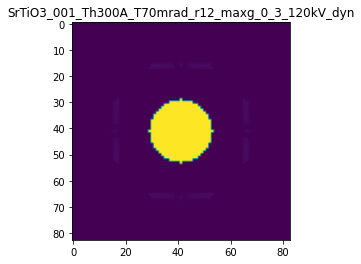

R-factor: 1.008766689677283e-06

>>> producing the 10. dataset...

The offset applied on thickness: -0.00046351012036786757

The offset applied on Ug: -0.009563308520337798

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5364898796321
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

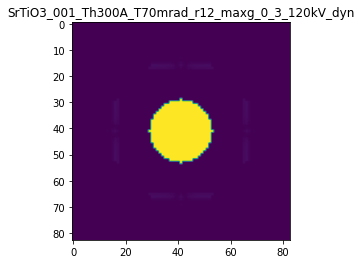

R-factor: 5.93848248006794e-07

>>> producing the 11. dataset...

The offset applied on thickness: 0.0003805099106665526

The offset applied on Ug: -0.012680321683417458

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.38050991066655
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

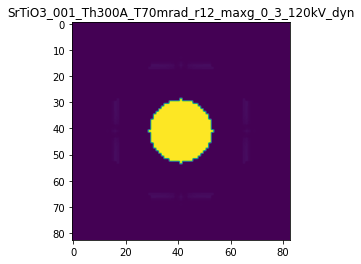

R-factor: 4.929616310300813e-07

>>> producing the 12. dataset...

The offset applied on thickness: 0.00040474695548231755

The offset applied on Ug: -0.05912332554515354

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4047469554823
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

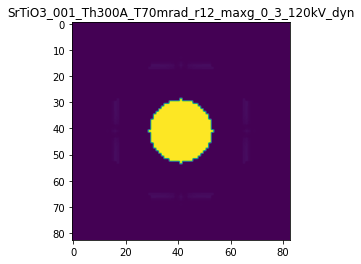

R-factor: 7.117585814916795e-07

>>> producing the 13. dataset...

The offset applied on thickness: -0.000342378011603816

The offset applied on Ug: 0.04616571979068894

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.65762198839616
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

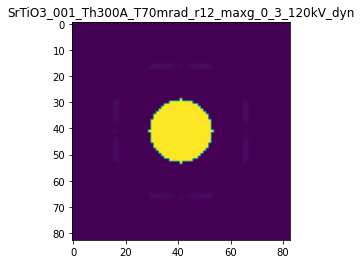

R-factor: 5.818669053227585e-07

>>> producing the 14. dataset...

The offset applied on thickness: 0.000703399192997723

The offset applied on Ug: -0.006139930799595277

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7033991929977
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

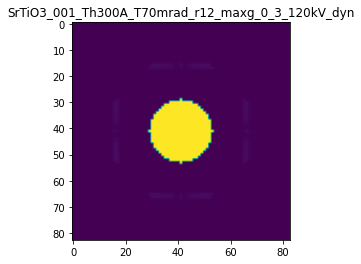

R-factor: 8.886221420583077e-07

>>> producing the 15. dataset...

The offset applied on thickness: 0.0006488436957542241

The offset applied on Ug: -0.027487655729860682

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.64884369575424
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

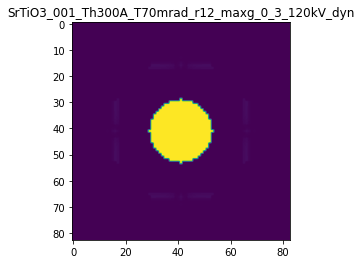

R-factor: 8.573025164271017e-07

>>> producing the 16. dataset...

The offset applied on thickness: 0.000861374439569659

The offset applied on Ug: 0.046380941866786006

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.86137443956966
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

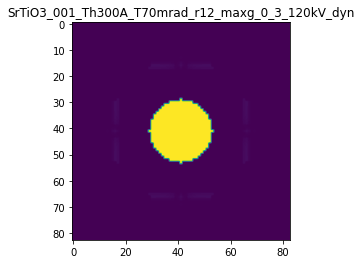

R-factor: 1.146530895275164e-06

>>> producing the 17. dataset...

The offset applied on thickness: 0.0006527209600234991

The offset applied on Ug: -0.023209833110463124

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6527209600235
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

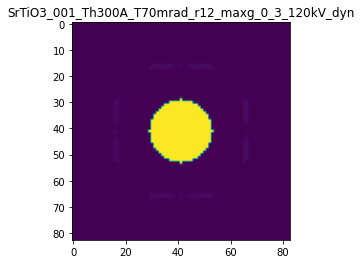

R-factor: 8.494238604062634e-07

>>> producing the 18. dataset...

The offset applied on thickness: -7.227999373246275e-05

The offset applied on Ug: -0.049208365333452346

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9277200062676
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

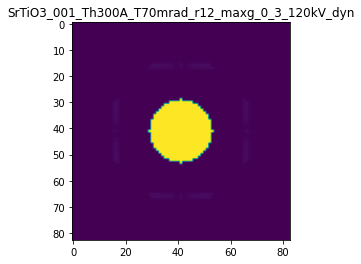

R-factor: 2.952373800382941e-07

>>> producing the 19. dataset...

The offset applied on thickness: 0.0009832024847981858

The offset applied on Ug: 0.004059676386173301

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.98320248479814
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

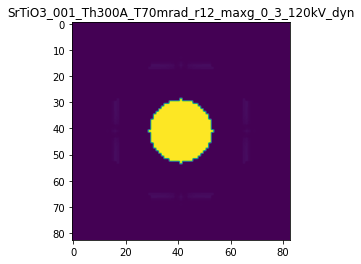

R-factor: 1.2442900649880479e-06

>>> producing the 20. dataset...

The offset applied on thickness: -0.0005617477475931935

The offset applied on Ug: -0.06858676901270344

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.43825225240676
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

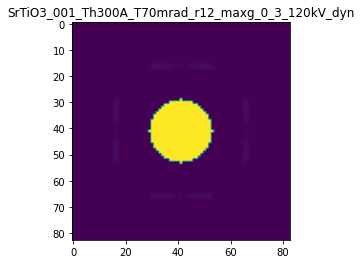

R-factor: 8.155304834279256e-07

>>> producing the 21. dataset...

The offset applied on thickness: 0.0005529813946742408

The offset applied on Ug: -0.06688850391743138

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.55298139467425
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

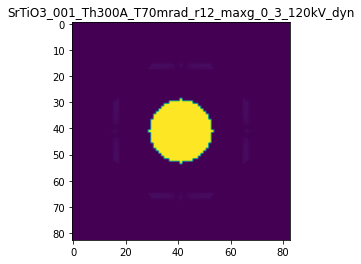

R-factor: 9.0351004103506e-07

>>> producing the 22. dataset...

The offset applied on thickness: 0.0009904292801900451

The offset applied on Ug: -0.03611267589960297

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.99042928019
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrTi

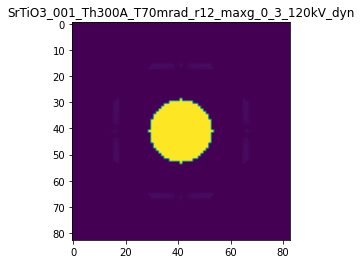

R-factor: 1.2921888107152375e-06

>>> producing the 23. dataset...

The offset applied on thickness: 0.0008431331835854233

The offset applied on Ug: -0.04973970001531972

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8431331835854
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

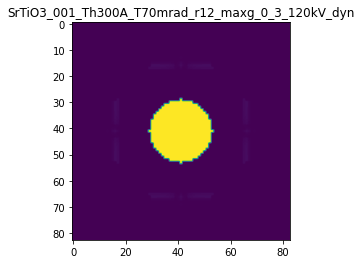

R-factor: 1.1595642942315677e-06

>>> producing the 24. dataset...

The offset applied on thickness: 0.0007623570907991108

The offset applied on Ug: -0.033419888021006476

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7623570907991
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

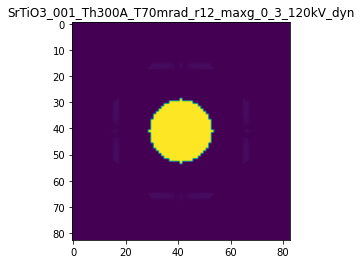

R-factor: 1.0108347167181114e-06

>>> producing the 25. dataset...

The offset applied on thickness: 0.0003378792536458506

The offset applied on Ug: 0.02306647374088758

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.33787925364584
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

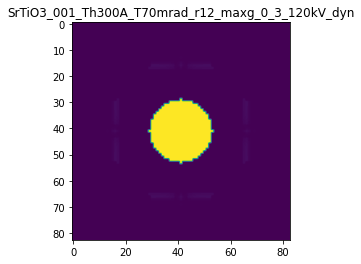

R-factor: 4.577773414765429e-07

>>> producing the 26. dataset...

The offset applied on thickness: -0.0009512604914463385

The offset applied on Ug: -0.04072415373073433

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.04873950855364
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

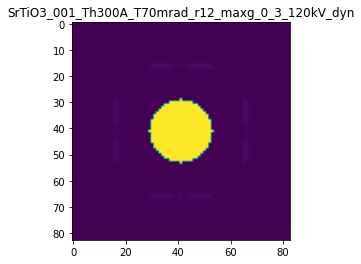

R-factor: 1.2469497712617583e-06

>>> producing the 27. dataset...

The offset applied on thickness: 3.967616371306959e-05

The offset applied on Ug: 0.025647398142934534

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.03967616371307
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

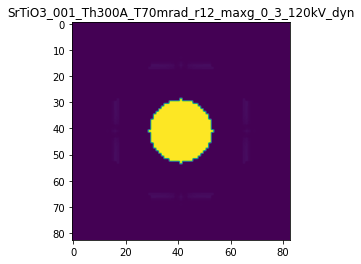

R-factor: 1.5454867495864486e-07

>>> producing the 28. dataset...

The offset applied on thickness: 0.0009616186956375878

The offset applied on Ug: 0.006307885344290707

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9616186956376
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

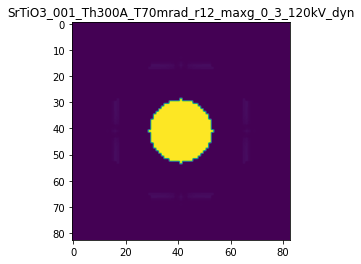

R-factor: 1.2192391240671116e-06

>>> producing the 29. dataset...

The offset applied on thickness: -0.0001051309011748549

The offset applied on Ug: -0.06282338715098608

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8948690988251
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

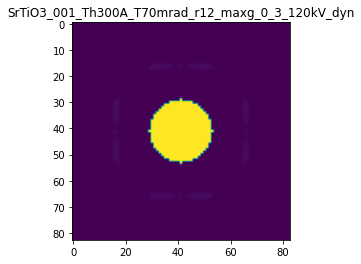

R-factor: 3.8164225056370914e-07

>>> producing the 30. dataset...

The offset applied on thickness: 0.00031782181341056815

The offset applied on Ug: 0.05106705732103164

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.31782181341055
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

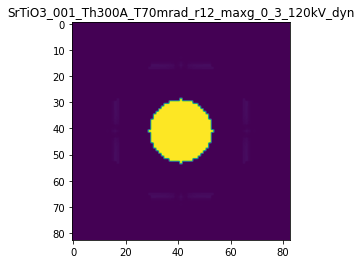

R-factor: 4.88789080329094e-07

>>> producing the 31. dataset...

The offset applied on thickness: -0.0007715254212489134

The offset applied on Ug: -0.041401522767183396

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.22847457875105
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

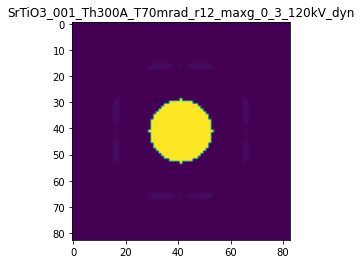

R-factor: 1.0237591343995578e-06

>>> producing the 32. dataset...

The offset applied on thickness: -0.0009862193084341662

The offset applied on Ug: -0.06931811371104918

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0137806915658
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

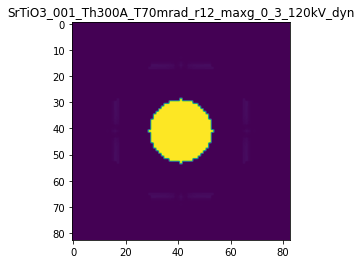

R-factor: 1.3365863271903125e-06

>>> producing the 33. dataset...

The offset applied on thickness: 0.00013306026227881662

The offset applied on Ug: -0.016785468298093277

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.13306026227883
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

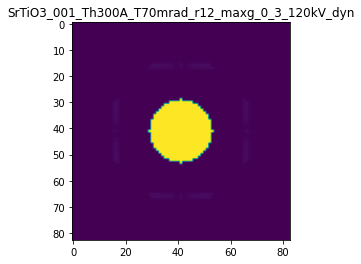

R-factor: 2.2063138044325873e-07

>>> producing the 34. dataset...

The offset applied on thickness: 0.00039474225125502314

The offset applied on Ug: -0.010804501866523264

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.394742251255
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

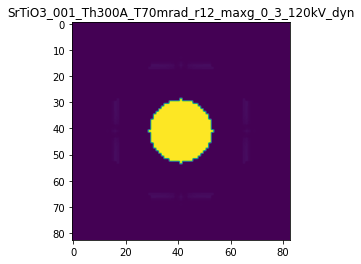

R-factor: 5.071796078147545e-07

>>> producing the 35. dataset...

The offset applied on thickness: -0.000927040790952499

The offset applied on Ug: 0.05616805553798347

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0729592090475
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

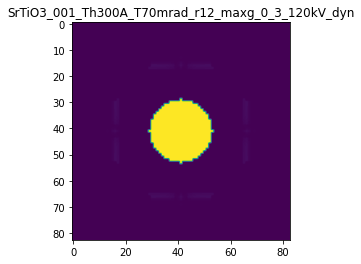

R-factor: 1.2768624985403023e-06

>>> producing the 36. dataset...

The offset applied on thickness: 0.0008220511518237203

The offset applied on Ug: -0.015873678918209767

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8220511518237
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

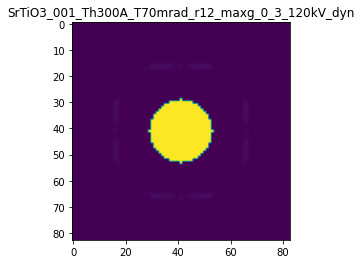

R-factor: 1.0461309157877161e-06

>>> producing the 37. dataset...

The offset applied on thickness: -0.000974231741761046

The offset applied on Ug: -0.009983351895844468

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.02576825823894
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

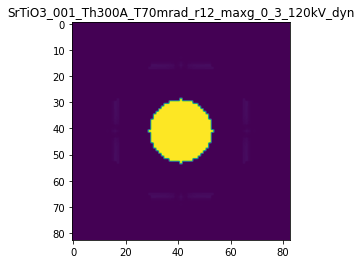

R-factor: 1.233735714977124e-06

>>> producing the 38. dataset...

The offset applied on thickness: -0.0003156151835155394

The offset applied on Ug: -0.006644661436991903

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.68438481648445
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

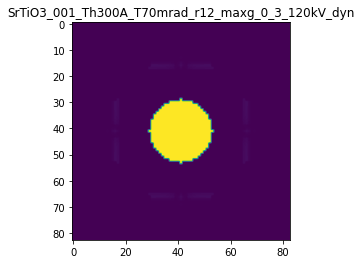

R-factor: 4.0466600572387716e-07

>>> producing the 39. dataset...

The offset applied on thickness: 0.00018239218522011336

The offset applied on Ug: -0.030869585151507926

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.18239218522007
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

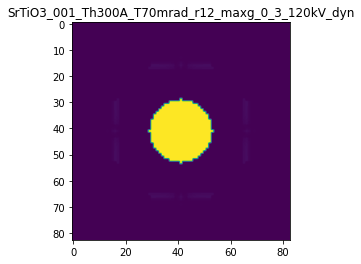

R-factor: 3.425585497977916e-07

>>> producing the 40. dataset...

The offset applied on thickness: 9.215074459513261e-05

The offset applied on Ug: 0.0065206062932881715

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.09215074459513
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

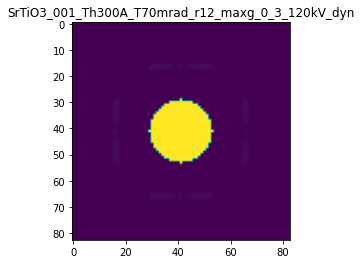

R-factor: 1.2522812832063832e-07

>>> producing the 41. dataset...

The offset applied on thickness: -0.0005690240208896539

The offset applied on Ug: -0.07945066623634482

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4309759791103
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

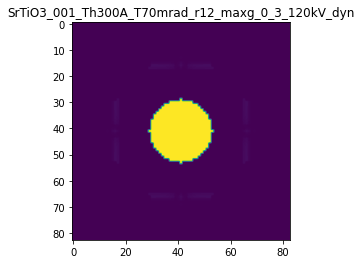

R-factor: 8.458391074736728e-07

>>> producing the 42. dataset...

The offset applied on thickness: -9.529102328450722e-06

The offset applied on Ug: -0.0009431957026187731

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.99047089767157
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

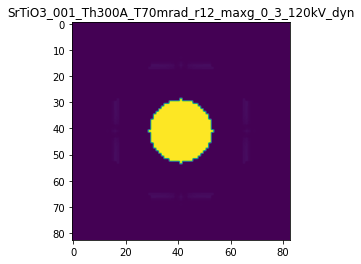

R-factor: 1.3386331500303011e-08

>>> producing the 43. dataset...

The offset applied on thickness: -0.00021614725767036825

The offset applied on Ug: -0.046409781236814655

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7838527423296
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

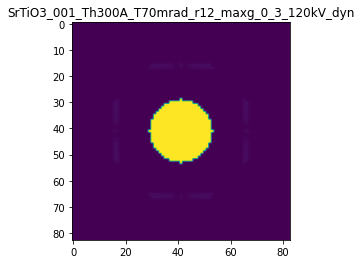

R-factor: 3.700284441239891e-07

>>> producing the 44. dataset...

The offset applied on thickness: 0.0005553741243291493

The offset applied on Ug: -0.07241521721926658

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.55537412432915
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

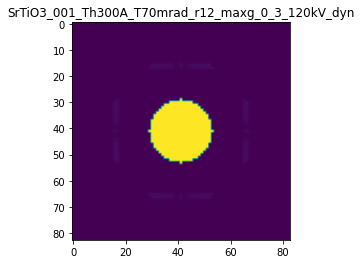

R-factor: 9.332187930141901e-07

>>> producing the 45. dataset...

The offset applied on thickness: 0.00016058299569015455

The offset applied on Ug: -0.03429861291966873

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.16058299569016
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

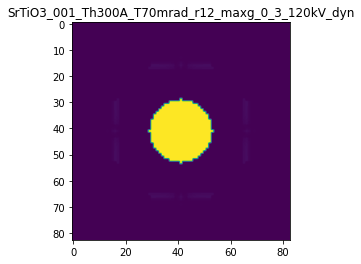

R-factor: 3.3975149046442696e-07

>>> producing the 46. dataset...

The offset applied on thickness: 7.553993545445038e-05

The offset applied on Ug: 0.039742955064279675

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.07553993545446
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

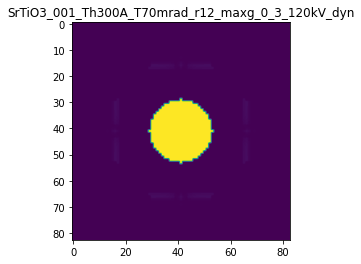

R-factor: 2.447545620834977e-07

>>> producing the 47. dataset...

The offset applied on thickness: 0.0008874815024132834

The offset applied on Ug: 0.027063993207698544

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.88748150241327
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

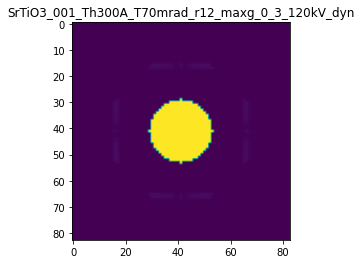

R-factor: 1.152227672026448e-06

>>> producing the 48. dataset...

The offset applied on thickness: -0.0003491052360286231

The offset applied on Ug: 0.03481672221860558

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6508947639714
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

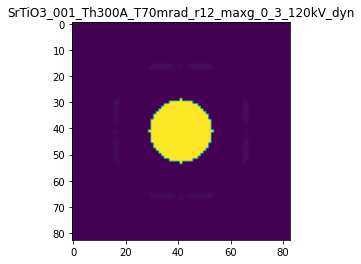

R-factor: 5.361743196018914e-07

>>> producing the 49. dataset...

The offset applied on thickness: 0.0004229518807714858

The offset applied on Ug: -0.0463309832357224

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.42295188077145
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

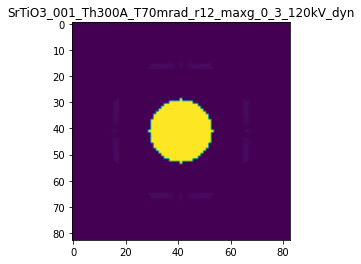

R-factor: 6.680328848469435e-07

>>> producing the 50. dataset...

The offset applied on thickness: -0.0005863047979960746

The offset applied on Ug: -0.06553488569683888

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4136952020039
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

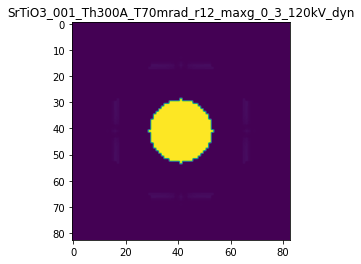

R-factor: 8.395899074714345e-07

>>> producing the 51. dataset...

The offset applied on thickness: 0.0007436545466506903

The offset applied on Ug: -0.07584144428866645

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7436545466507
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

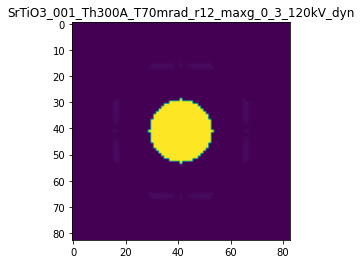

R-factor: 1.151196422391793e-06

>>> producing the 52. dataset...

The offset applied on thickness: -5.7968899123819416e-05

The offset applied on Ug: 0.03840151042072419

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9420311008762
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

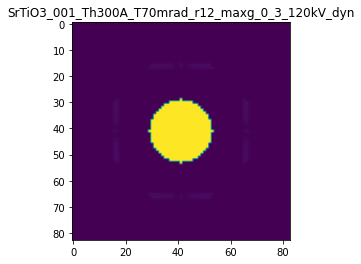

R-factor: 2.73947435638739e-07

>>> producing the 53. dataset...

The offset applied on thickness: -0.00027780219366894563

The offset applied on Ug: -0.027907878919105577

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.72219780633105
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

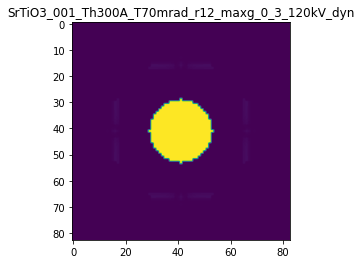

R-factor: 3.918826249165895e-07

>>> producing the 54. dataset...

The offset applied on thickness: -0.0008170583782461851

The offset applied on Ug: -0.035445575561292804

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1829416217538
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

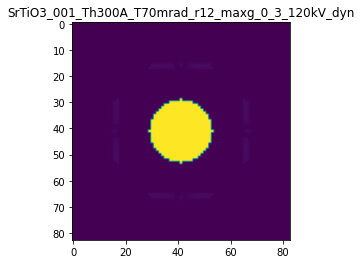

R-factor: 1.0720012593362036e-06

>>> producing the 55. dataset...

The offset applied on thickness: -0.0009090824348814113

The offset applied on Ug: 0.016209522910214585

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.09091756511856
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

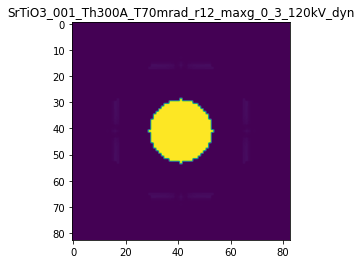

R-factor: 1.1515972009871552e-06

>>> producing the 56. dataset...

The offset applied on thickness: 0.00046407059222270465

The offset applied on Ug: 0.07953615518393463

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4640705922227
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

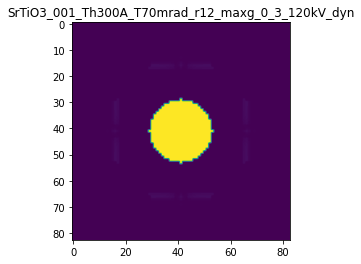

R-factor: 7.272013811989545e-07

>>> producing the 57. dataset...

The offset applied on thickness: 0.00030865975674909343

The offset applied on Ug: -0.05183191419549207

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3086597567491
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

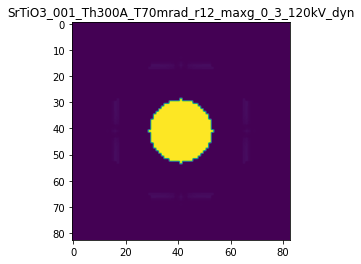

R-factor: 5.776704187294355e-07

>>> producing the 58. dataset...

The offset applied on thickness: -0.00034578450076597125

The offset applied on Ug: 0.0069062772162566686

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.65421549923406
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

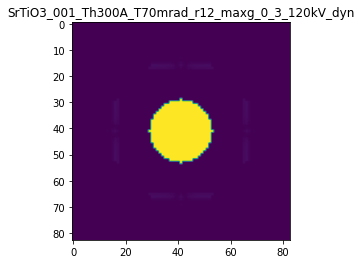

R-factor: 4.3940783542831166e-07

>>> producing the 59. dataset...

The offset applied on thickness: 0.000912422728753143

The offset applied on Ug: 0.04363231353661803

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.91242272875314
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

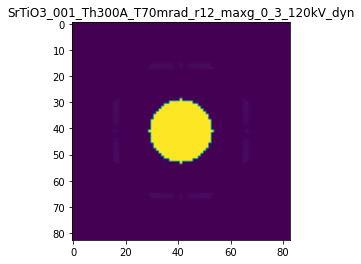

R-factor: 1.2068403876729835e-06

>>> producing the 60. dataset...

The offset applied on thickness: -5.51826129369204e-05

The offset applied on Ug: -0.01719741423212305

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9448173870631
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

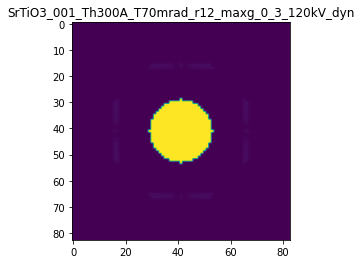

R-factor: 1.1913737130832765e-07

>>> producing the 61. dataset...

The offset applied on thickness: 0.0003785011483639309

The offset applied on Ug: -0.0317020261697542

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3785011483639
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

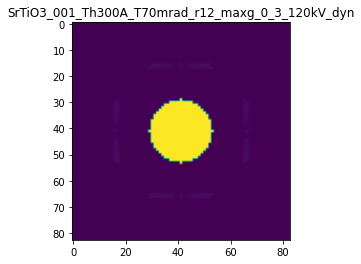

R-factor: 5.575081915994287e-07

>>> producing the 62. dataset...

The offset applied on thickness: -0.00013088539103583763

The offset applied on Ug: 0.013174489427858944

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.86911460896414
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

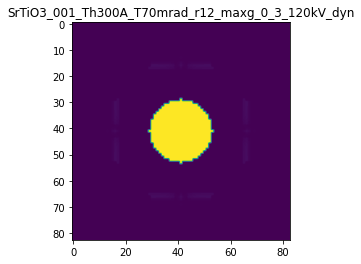

R-factor: 2.0158011406491462e-07

>>> producing the 63. dataset...

The offset applied on thickness: 0.00010277266227072457

The offset applied on Ug: -0.057375857296117945

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1027726622707
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

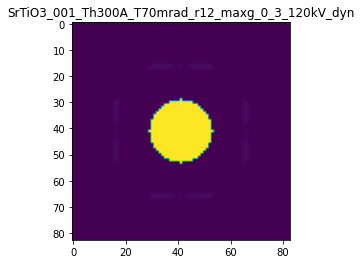

R-factor: 4.216064820062471e-07

>>> producing the 64. dataset...

The offset applied on thickness: -0.0009087035357250814

The offset applied on Ug: 0.006737152368508799

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0912964642749
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

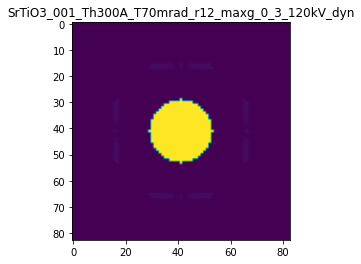

R-factor: 1.1442665124657634e-06

>>> producing the 65. dataset...

The offset applied on thickness: 0.0009572396103783963

The offset applied on Ug: -0.07742602086604469

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9572396103784
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

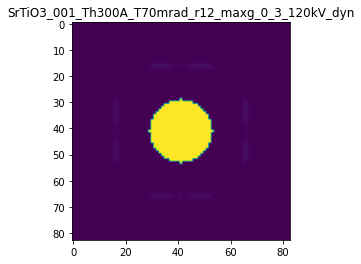

R-factor: 1.4000192160884753e-06

>>> producing the 66. dataset...

The offset applied on thickness: -0.0006247874098777555

The offset applied on Ug: 0.010493797466242327

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3752125901222
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

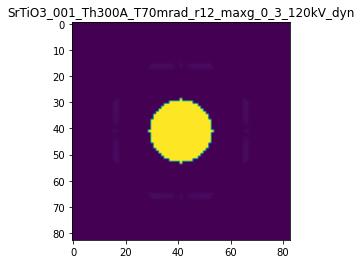

R-factor: 7.910932939313526e-07

>>> producing the 67. dataset...

The offset applied on thickness: -0.0005513984540168078

The offset applied on Ug: 0.027812737901767248

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4486015459832
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

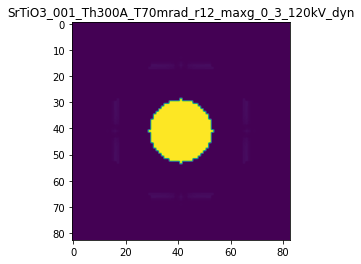

R-factor: 7.400241163826326e-07

>>> producing the 68. dataset...

The offset applied on thickness: -6.447678608138263e-05

The offset applied on Ug: 0.0020423600087416637

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9355232139186
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

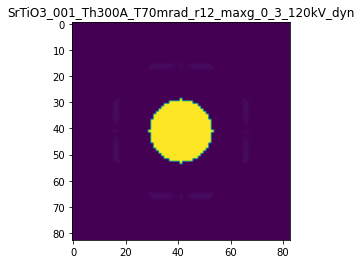

R-factor: 8.320022426186882e-08

>>> producing the 69. dataset...

The offset applied on thickness: 0.0006955153912494734

The offset applied on Ug: -0.020787695948417735

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.69551539124944
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

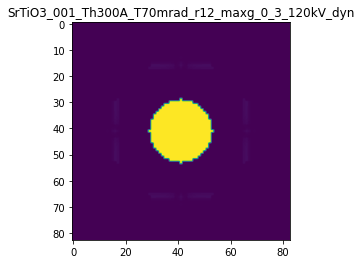

R-factor: 8.969961844737557e-07

>>> producing the 70. dataset...

The offset applied on thickness: 0.0009168267377993605

The offset applied on Ug: -0.0313745608470027

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.91682673779934
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

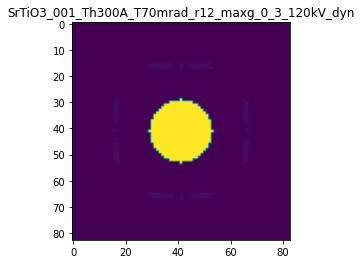

R-factor: 1.1908228527604795e-06

>>> producing the 71. dataset...

The offset applied on thickness: 0.0006306661781364043

The offset applied on Ug: -0.06741749002840329

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6306661781364
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

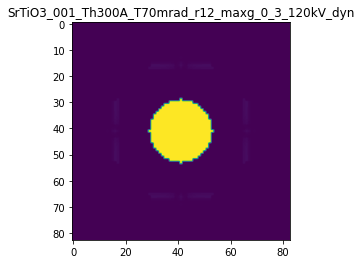

R-factor: 9.89049624813433e-07

>>> producing the 72. dataset...

The offset applied on thickness: -0.00018412994630639124

The offset applied on Ug: 0.06488553178911528

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8158700536936
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

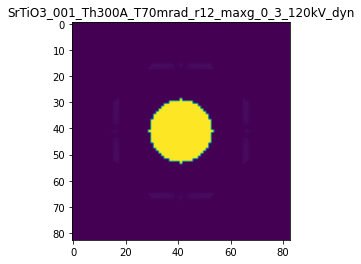

R-factor: 5.33724822843824e-07

>>> producing the 73. dataset...

The offset applied on thickness: -1.9298190340111044e-05

The offset applied on Ug: -0.06580058209902999

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9807018096599
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

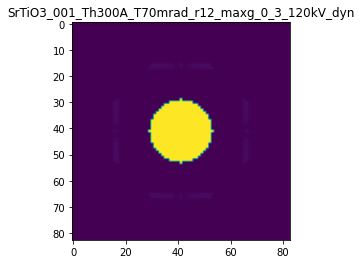

R-factor: 3.945162720294834e-07

>>> producing the 74. dataset...

The offset applied on thickness: -0.0003165624793031849

The offset applied on Ug: 0.05264452051958221

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6834375206968
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

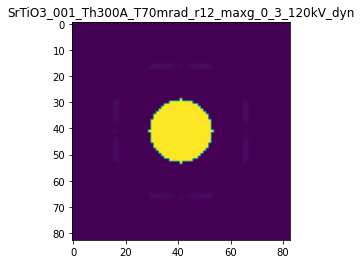

R-factor: 5.89076838337189e-07

>>> producing the 75. dataset...

The offset applied on thickness: -0.00012938721487165062

The offset applied on Ug: -0.05258806843913955

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.87061278512834
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

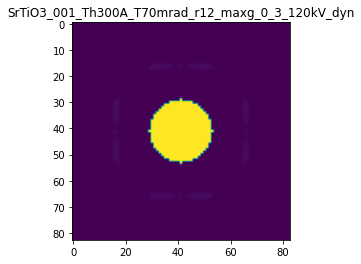

R-factor: 3.3975052502300034e-07

>>> producing the 76. dataset...

The offset applied on thickness: -0.00020061384696177576

The offset applied on Ug: -0.0707556284184491

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7993861530382
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

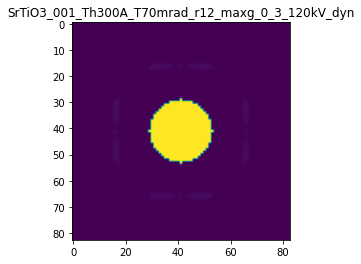

R-factor: 4.7357479988394216e-07

>>> producing the 77. dataset...

The offset applied on thickness: -9.32889162193069e-05

The offset applied on Ug: -0.05135531352409023

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9067110837807
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

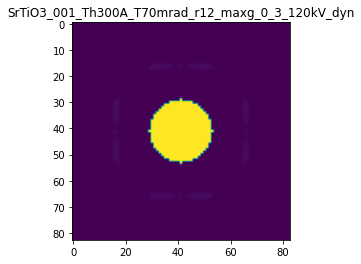

R-factor: 3.146967596383734e-07

>>> producing the 78. dataset...

The offset applied on thickness: 0.00034602844247950547

The offset applied on Ug: 0.06795869965479913

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3460284424795
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

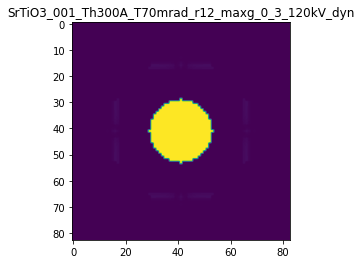

R-factor: 5.681251665348519e-07

>>> producing the 79. dataset...

The offset applied on thickness: 0.0007603233958277122

The offset applied on Ug: 0.008263932625175219

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7603233958277
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

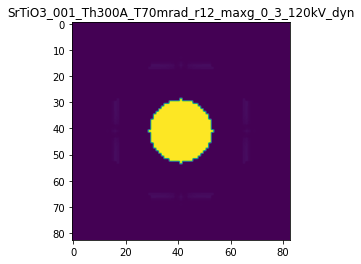

R-factor: 9.66864125552165e-07

>>> producing the 80. dataset...

The offset applied on thickness: -0.00041458433393081596

The offset applied on Ug: -0.071110844051776

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.58541566606914
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

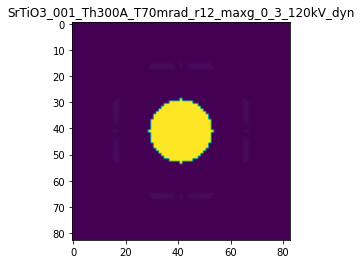

R-factor: 6.503923771883504e-07

>>> producing the 81. dataset...

The offset applied on thickness: 0.0008256833353935535

The offset applied on Ug: -0.008193868543836143

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.82568333539353
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

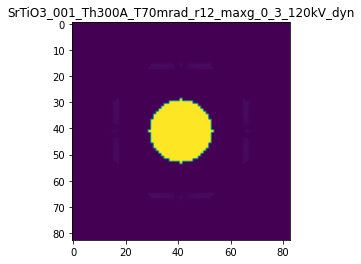

R-factor: 1.0436036271304231e-06

>>> producing the 82. dataset...

The offset applied on thickness: 0.000763885858120215

The offset applied on Ug: 0.0468977772766395

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7638858581202
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

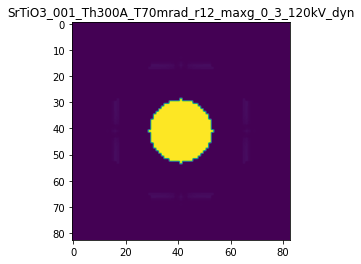

R-factor: 1.0264658976491996e-06

>>> producing the 83. dataset...

The offset applied on thickness: -0.00027304348079008124

The offset applied on Ug: 0.05997999530958092

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.72695651920986
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

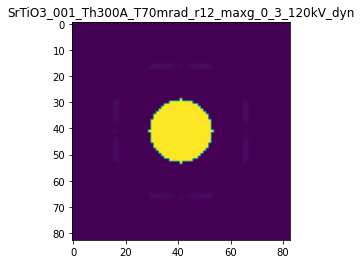

R-factor: 5.863785278116736e-07

>>> producing the 84. dataset...

The offset applied on thickness: 0.0008548180467999159

The offset applied on Ug: -0.05636385352645286

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.85481804679995
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

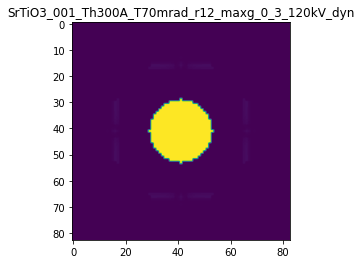

R-factor: 1.1989857708223052e-06

>>> producing the 85. dataset...

The offset applied on thickness: -0.0005662013236817254

The offset applied on Ug: -0.07556201018972748

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.43379867631825
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

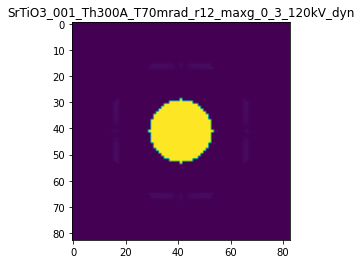

R-factor: 8.343979007734503e-07

>>> producing the 86. dataset...

The offset applied on thickness: -0.0008202489608439429

The offset applied on Ug: -0.057912092829376455

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1797510391561
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

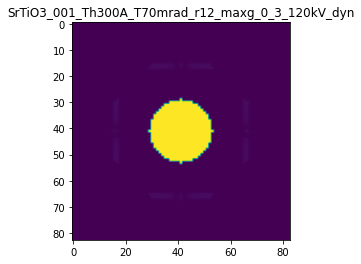

R-factor: 1.1124444565250711e-06

>>> producing the 87. dataset...

The offset applied on thickness: -0.00044830338663372714

The offset applied on Ug: -0.032691169083033544

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5516966133663
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

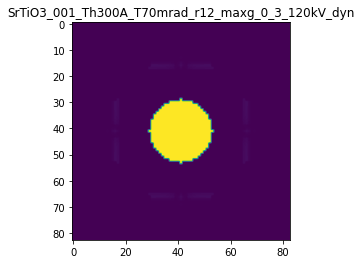

R-factor: 6.102133463935959e-07

>>> producing the 88. dataset...

The offset applied on thickness: -0.0008400709188650426

The offset applied on Ug: -0.02343919470729741

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1599290811349
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

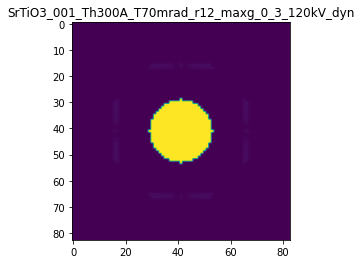

R-factor: 1.083895657382804e-06

>>> producing the 89. dataset...

The offset applied on thickness: -0.000927335558364605

The offset applied on Ug: -0.07791358047650264

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.07266444163537
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

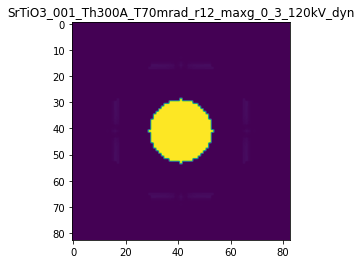

R-factor: 1.2795457023075786e-06

>>> producing the 90. dataset...

The offset applied on thickness: -0.0008229357501835335

The offset applied on Ug: -0.020022799617432502

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.17706424981645
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

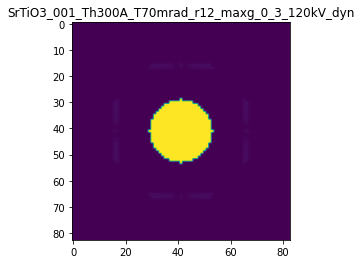

R-factor: 1.057759433854033e-06

>>> producing the 91. dataset...

The offset applied on thickness: -0.00026383241175670857

The offset applied on Ug: -0.008802640681667029

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7361675882433
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

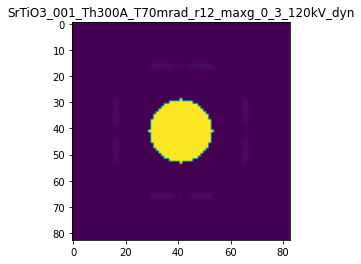

R-factor: 3.427884789430174e-07

>>> producing the 92. dataset...

The offset applied on thickness: 0.0007985046990066587

The offset applied on Ug: 0.00540000494533464

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7985046990066
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

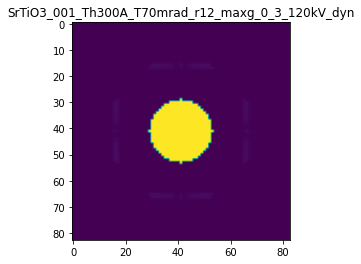

R-factor: 1.012249033011779e-06

>>> producing the 93. dataset...

The offset applied on thickness: 0.0003986395399594884

The offset applied on Ug: -0.016041913151491977

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3986395399595
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

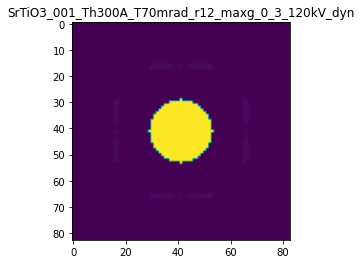

R-factor: 5.239579275545681e-07

>>> producing the 94. dataset...

The offset applied on thickness: -0.0006068863473995538

The offset applied on Ug: 0.06067050858240959

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.39311365260045
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

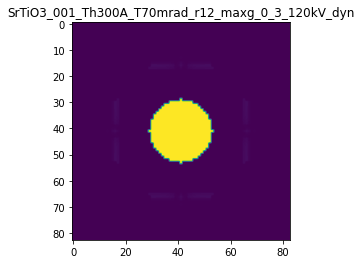

R-factor: 9.323007659817042e-07

>>> producing the 95. dataset...

The offset applied on thickness: -0.000827796315834014

The offset applied on Ug: -0.05234913474430055

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.172203684166
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

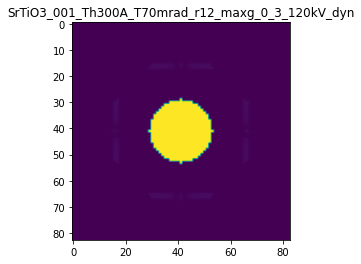

R-factor: 1.1118954335297354e-06

>>> producing the 96. dataset...

The offset applied on thickness: 0.0006198107350104667

The offset applied on Ug: -0.018270078752166546

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.61981073501045
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

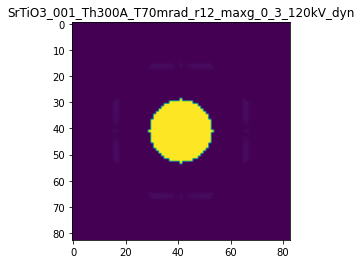

R-factor: 7.988311204308593e-07

>>> producing the 97. dataset...

The offset applied on thickness: 0.0006802884534198528

The offset applied on Ug: 0.0035041322213214343

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6802884534198
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

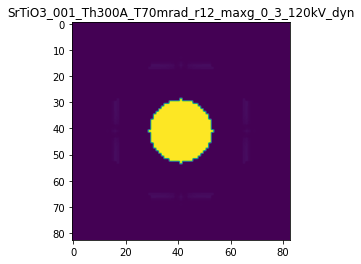

R-factor: 8.610909045626369e-07

>>> producing the 98. dataset...

The offset applied on thickness: 0.000603581915913201

The offset applied on Ug: -0.015643191766377386

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6035819159132
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

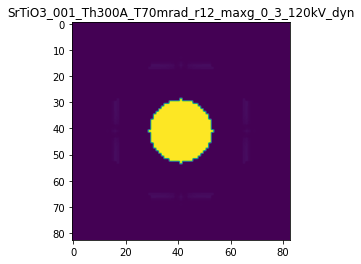

R-factor: 7.743386392136774e-07

>>> producing the 99. dataset...

The offset applied on thickness: -9.147768902805154e-05

The offset applied on Ug: 0.017725734097628083

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.90852231097193
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

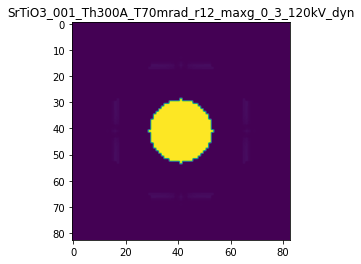

R-factor: 1.8370872007593874e-07

>>> producing the 100. dataset...

The offset applied on thickness: -0.0003818226377661471

The offset applied on Ug: -0.02707688763612378

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.61817736223384
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

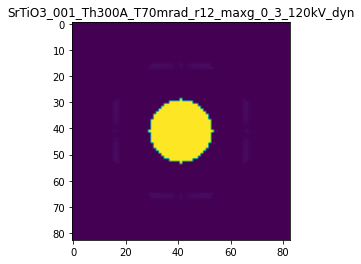

R-factor: 5.184257221372923e-07

>>> producing the 101. dataset...

The offset applied on thickness: 0.0005667130777188765

The offset applied on Ug: -0.01938630040068919

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5667130777189
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

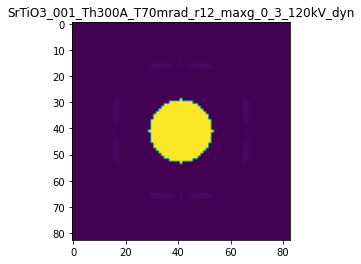

R-factor: 7.356016036599822e-07

>>> producing the 102. dataset...

The offset applied on thickness: -0.0009142126882418924

The offset applied on Ug: -0.06511118820714733

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0857873117581
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

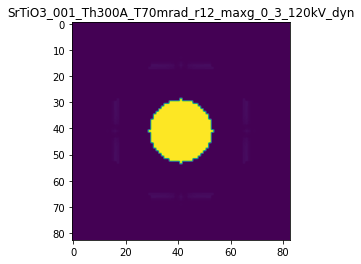

R-factor: 1.240671878733799e-06

>>> producing the 103. dataset...

The offset applied on thickness: -0.00010215841219120071

The offset applied on Ug: -0.02877919598051115

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8978415878088
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

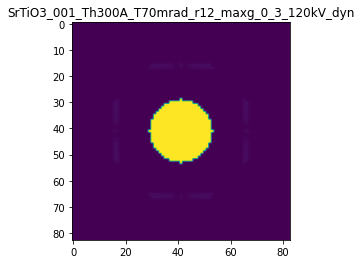

R-factor: 2.0594993267859598e-07

>>> producing the 104. dataset...

The offset applied on thickness: -0.0003841785656318333

The offset applied on Ug: 0.010445463490750663

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6158214343682
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

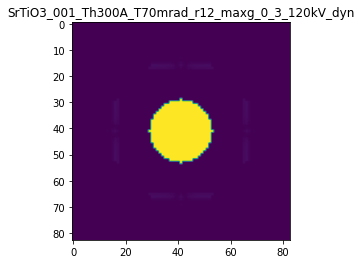

R-factor: 4.92716996995896e-07

>>> producing the 105. dataset...

The offset applied on thickness: 0.0005505712797777156

The offset applied on Ug: 0.014733522185277934

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.55057127977767
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

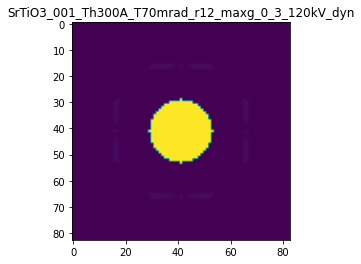

R-factor: 7.115461593007495e-07

>>> producing the 106. dataset...

The offset applied on thickness: -0.0009772026572842675

The offset applied on Ug: 0.00400037144632682

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0227973427157
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

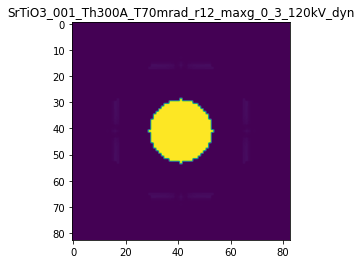

R-factor: 1.229542197823072e-06

>>> producing the 107. dataset...

The offset applied on thickness: 0.0008898223804503129

The offset applied on Ug: -0.004001719284095291

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8898223804503
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

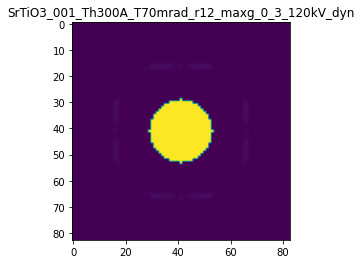

R-factor: 1.1235313513036313e-06

>>> producing the 108. dataset...

The offset applied on thickness: -0.0008254647085577747

The offset applied on Ug: 0.05706954541792735

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1745352914422
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

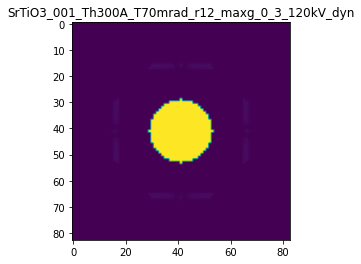

R-factor: 1.1651667423406916e-06

>>> producing the 109. dataset...

The offset applied on thickness: -0.0007980464650483589

The offset applied on Ug: 0.06011535646953895

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2019535349516
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

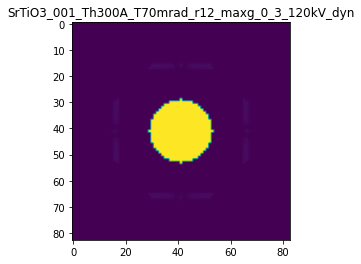

R-factor: 1.1462162479091024e-06

>>> producing the 110. dataset...

The offset applied on thickness: -0.0002448288407866275

The offset applied on Ug: 0.007297729695124265

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7551711592134
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

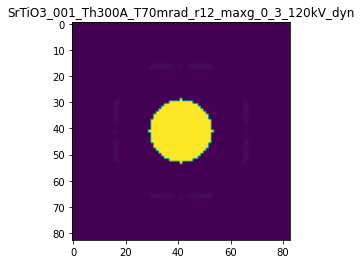

R-factor: 3.1512809381176954e-07

>>> producing the 111. dataset...

The offset applied on thickness: -0.0003280240737680678

The offset applied on Ug: -0.0665560443670095

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6719759262319
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

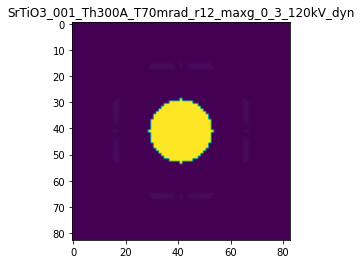

R-factor: 5.46364223871116e-07

>>> producing the 112. dataset...

The offset applied on thickness: -8.470714469580964e-05

The offset applied on Ug: -0.017095940998129732

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9152928553042
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

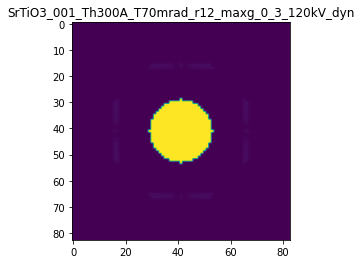

R-factor: 1.407320885518238e-07

>>> producing the 113. dataset...

The offset applied on thickness: 0.0005593644269688814

The offset applied on Ug: -0.05033476334833528

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.55936442696884
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

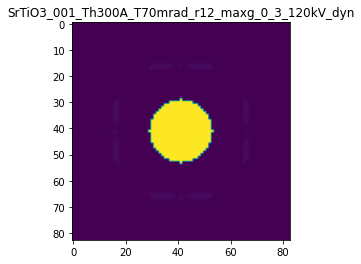

R-factor: 8.382327878820128e-07

>>> producing the 114. dataset...

The offset applied on thickness: -0.00018072472160815333

The offset applied on Ug: -0.04771644782207567

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.81927527839184
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

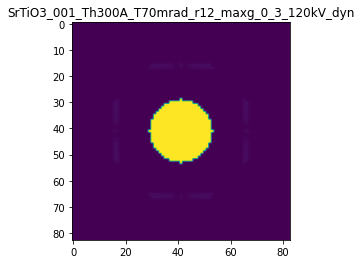

R-factor: 3.490665972420239e-07

>>> producing the 115. dataset...

The offset applied on thickness: 0.0009571524759908414

The offset applied on Ug: -0.058904278523165224

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9571524759908
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

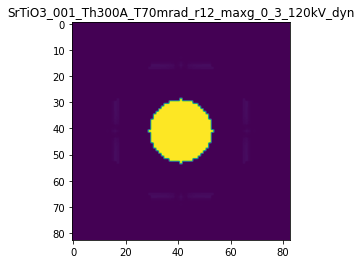

R-factor: 1.3261320534898294e-06

>>> producing the 116. dataset...

The offset applied on thickness: 0.00019679625396829947

The offset applied on Ug: 0.029740019394834397

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1967962539683
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

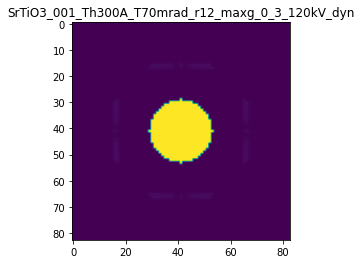

R-factor: 2.975802696376218e-07

>>> producing the 117. dataset...

The offset applied on thickness: 5.194222421703843e-05

The offset applied on Ug: -0.0673936926631173

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.05194222421704
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

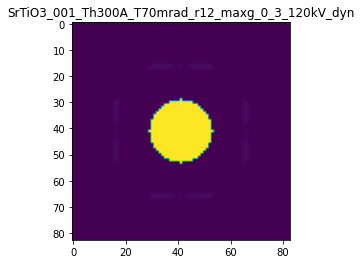

R-factor: 4.452644319913644e-07

>>> producing the 118. dataset...

The offset applied on thickness: 0.0005881350316334084

The offset applied on Ug: 0.034161223537692804

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5881350316334
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

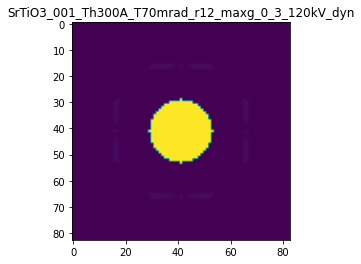

R-factor: 7.86703762324769e-07

>>> producing the 119. dataset...

The offset applied on thickness: -0.0008902985512935515

The offset applied on Ug: 0.07228978210762735

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1097014487064
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

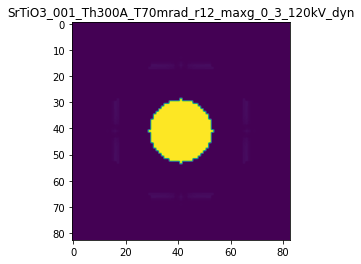

R-factor: 1.299423988600289e-06

>>> producing the 120. dataset...

The offset applied on thickness: -0.0003644918346825869

The offset applied on Ug: -0.04784902230784125

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.63550816531745
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

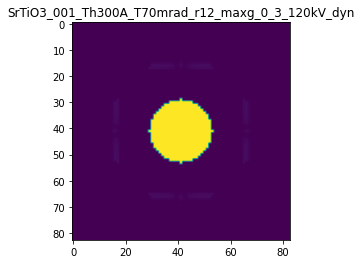

R-factor: 5.354958142095494e-07

>>> producing the 121. dataset...

The offset applied on thickness: 0.00043678816118875654

The offset applied on Ug: -0.06535125001860019

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.43678816118876
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

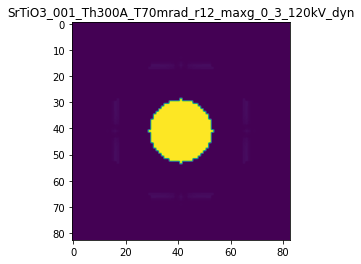

R-factor: 7.761038158181e-07

>>> producing the 122. dataset...

The offset applied on thickness: 0.0006066801431015467

The offset applied on Ug: -0.052216954865827246

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6066801431015
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

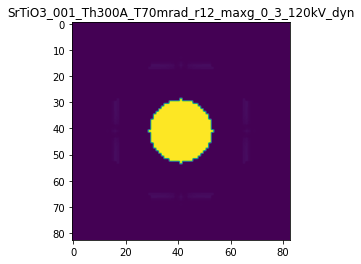

R-factor: 8.995788425267859e-07

>>> producing the 123. dataset...

The offset applied on thickness: -0.000752952666553764

The offset applied on Ug: -0.03253858905393761

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2470473334462
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

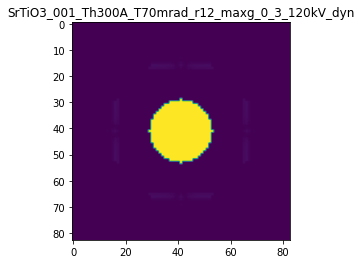

R-factor: 9.878435793129462e-07

>>> producing the 124. dataset...

The offset applied on thickness: 0.00014892398309975928

The offset applied on Ug: 0.004049698187969657

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.14892398309973
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

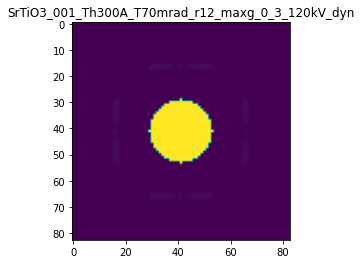

R-factor: 1.924311479771763e-07

>>> producing the 125. dataset...

The offset applied on thickness: 0.00022770620364778726

The offset applied on Ug: 0.027261411918232153

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2277062036478
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

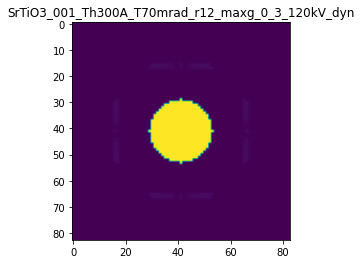

R-factor: 3.2952166211974843e-07

>>> producing the 126. dataset...

The offset applied on thickness: -0.0003083890458609144

The offset applied on Ug: 0.06202378944518278

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6916109541391
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

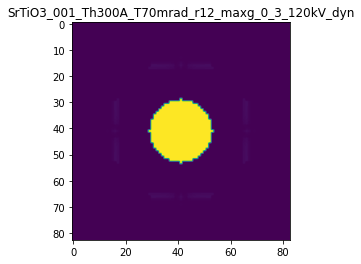

R-factor: 6.313218786778101e-07

>>> producing the 127. dataset...

The offset applied on thickness: -0.0003985493498579893

The offset applied on Ug: -0.07777156660530926

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.601450650142
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

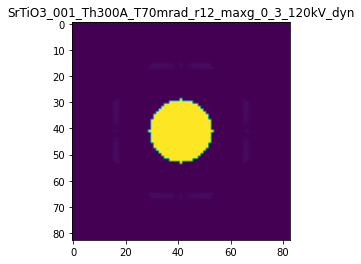

R-factor: 6.528454667627729e-07

>>> producing the 128. dataset...

The offset applied on thickness: 0.0008652753728215084

The offset applied on Ug: 0.07168235421535725

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8652753728215
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

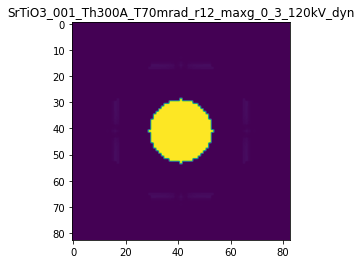

R-factor: 1.1950383548376648e-06

>>> producing the 129. dataset...

The offset applied on thickness: 0.0005438295715764141

The offset applied on Ug: -0.07557489868319542

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5438295715764
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

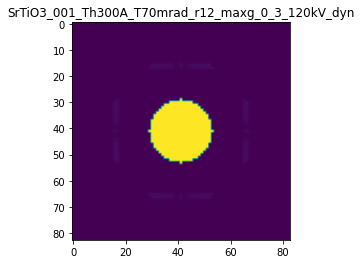

R-factor: 9.369445953122465e-07

>>> producing the 130. dataset...

The offset applied on thickness: 0.0005631142662915929

The offset applied on Ug: -0.05559187327946615

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.56311426629156
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

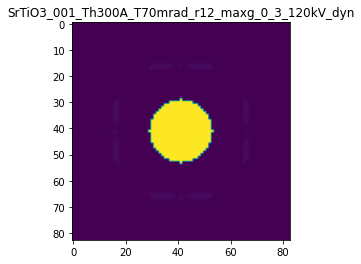

R-factor: 8.638690437748943e-07

>>> producing the 131. dataset...

The offset applied on thickness: 0.0007904697745532667

The offset applied on Ug: -0.058128196952951613

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7904697745533
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

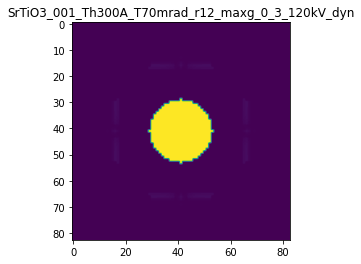

R-factor: 1.1325842104353367e-06

>>> producing the 132. dataset...

The offset applied on thickness: -0.000902451841611899

The offset applied on Ug: 0.027096673430981967

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.09754815838807
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

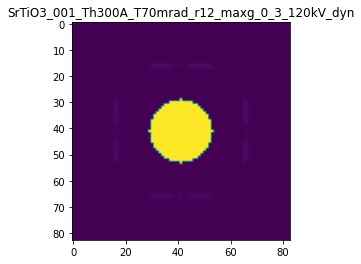

R-factor: 1.1605043775800611e-06

>>> producing the 133. dataset...

The offset applied on thickness: 0.00027323031920097887

The offset applied on Ug: 0.011194390263050576

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.27323031920093
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

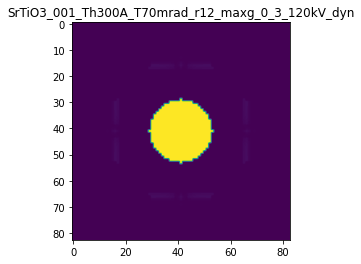

R-factor: 3.583745474326569e-07

>>> producing the 134. dataset...

The offset applied on thickness: 0.0007277728837396551

The offset applied on Ug: 0.03506360008268759

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.72777288373965
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

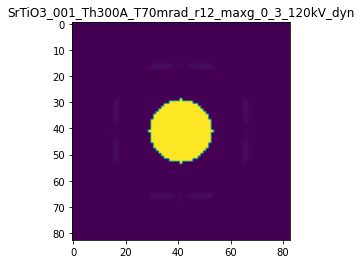

R-factor: 9.626761979037683e-07

>>> producing the 135. dataset...

The offset applied on thickness: 0.0008212622555746137

The offset applied on Ug: -0.017961337614302585

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8212622555746
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

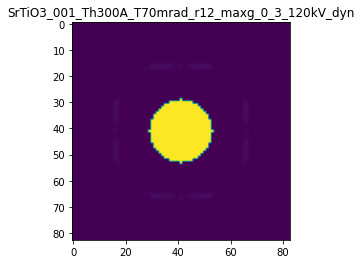

R-factor: 1.048531872758732e-06

>>> producing the 136. dataset...

The offset applied on thickness: 0.0004461092965950706

The offset applied on Ug: 0.045012780264576356

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.44610929659507
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

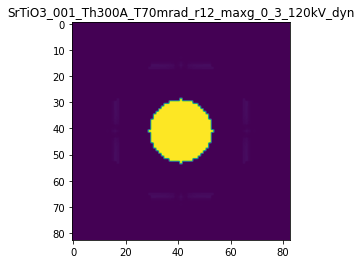

R-factor: 6.299197566949102e-07

>>> producing the 137. dataset...

The offset applied on thickness: -0.00041935207766015425

The offset applied on Ug: -0.014566101057446339

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.58064792233984
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_f

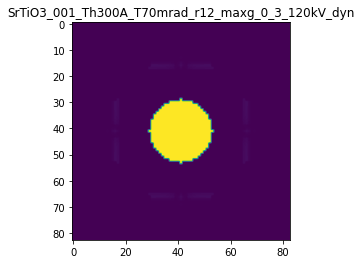

R-factor: 5.454936956217589e-07

>>> producing the 138. dataset...

The offset applied on thickness: -1.9960757235948145e-05

The offset applied on Ug: -0.04111003897260032

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.98003924276406
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

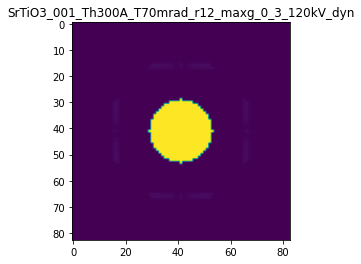

R-factor: 2.44422622770946e-07

>>> producing the 139. dataset...

The offset applied on thickness: 0.0006146449712974776

The offset applied on Ug: 0.022290830225480018

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6146449712975
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

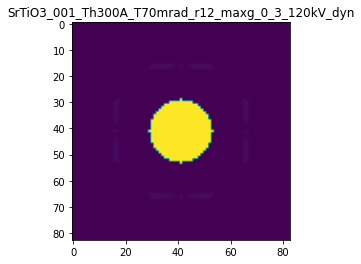

R-factor: 8.025893297283679e-07

>>> producing the 140. dataset...

The offset applied on thickness: 0.0008378747376274482

The offset applied on Ug: 0.03906207881936588

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8378747376275
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

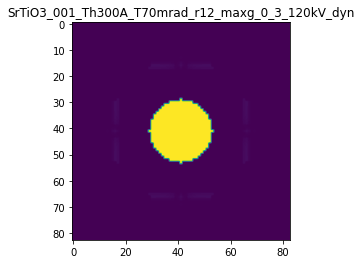

R-factor: 1.1066907329351144e-06



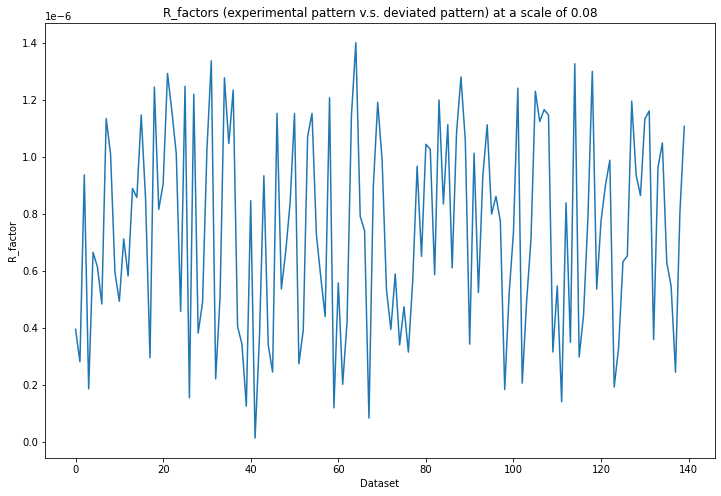

>>> start to train the ANN 

Epoch 1/30
5/5 [==============================] - 1s 128ms/step - loss: 0.3615 - acc: 0.8000 - val_loss: 0.3555 - val_acc: 1.0000
Epoch 2/30
5/5 [==============================] - 1s 107ms/step - loss: 0.3397 - acc: 1.0000 - val_loss: 0.3102 - val_acc: 1.0000
Epoch 3/30
5/5 [==============================] - 1s 108ms/step - loss: 0.2919 - acc: 1.0000 - val_loss: 0.2640 - val_acc: 1.0000
Epoch 4/30
5/5 [==============================] - 1s 107ms/step - loss: 0.2499 - acc: 1.0000 - val_loss: 0.2272 - val_acc: 1.0000
Epoch 5/30
5/5 [==============================] - 1s 108ms/step - loss: 0.2152 - acc: 1.0000 - val_loss: 0.1972 - val_acc: 1.0000
Epoch 6/30
5/5 [==============================] - 1s 108ms/step - loss: 0.1852 - acc: 1.0000 - val_loss: 0.1695 - val_acc: 1.0000
Epoch 7/30
5/5 [==============================] - 1s 109ms/step - loss: 0.1597 - acc: 1.0000 - val_loss: 0.1454 - val_acc: 1.0000
Epoch 8/30
5/5 [==============================] - 1s 108ms/st

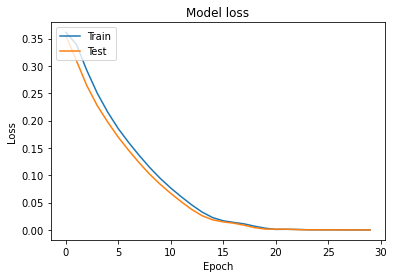

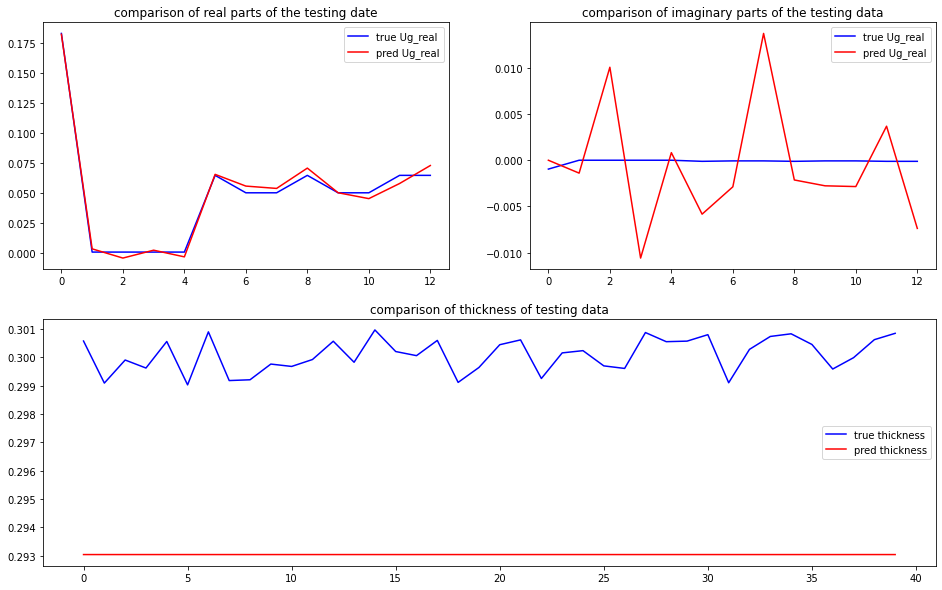

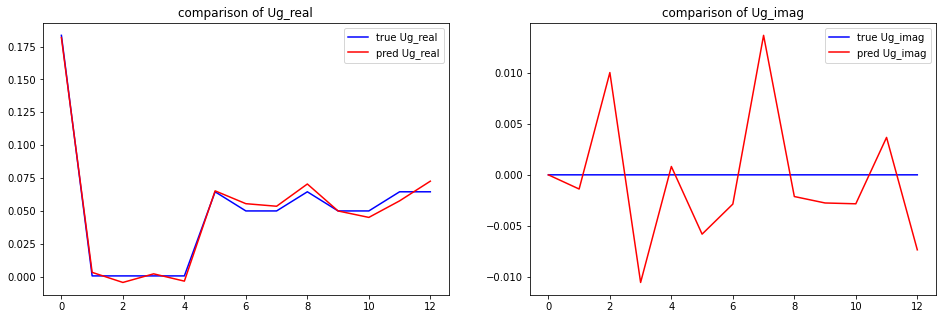

predicted thickness: 29.304641485214233 nm
mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=293.04641485214233
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 13 different beams

InputUg:
[ 0.18183428+0.00000000e+00j -

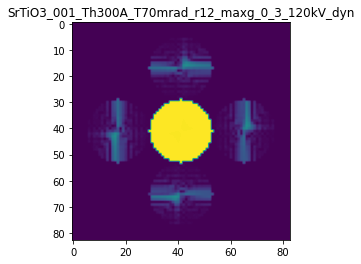

X_sim.max(): 0.9999305333510333
R-factor at a scale of 0.08 is 0.014590728560504132.

-----------------------------------------------------------------------------------------------------

>>> start to produce Dataset at a scale of 0.16

-----------------------------------------------------------------------------------------------------

>>> producing the 1. dataset...

The offset applied on thickness: -0.00018865786430185462

The offset applied on Ug: 0.05004681974287102

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001


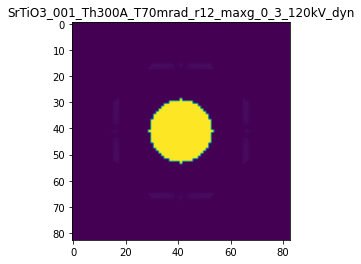

R-factor: 4.532778043753274e-07

>>> producing the 2. dataset...

The offset applied on thickness: -0.000956901787951953

The offset applied on Ug: -0.022995215976688604

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.04309821204805
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

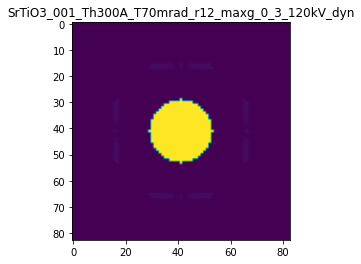

R-factor: 1.2292233301540602e-06

>>> producing the 3. dataset...

The offset applied on thickness: 0.0003558280671883931

The offset applied on Ug: 0.13826331775055473

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3558280671884
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

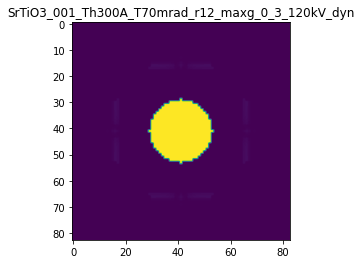

R-factor: 9.01571961442136e-07

>>> producing the 4. dataset...

The offset applied on thickness: 0.00025525736966479796

The offset applied on Ug: -0.05894956967169136

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2552573696648
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

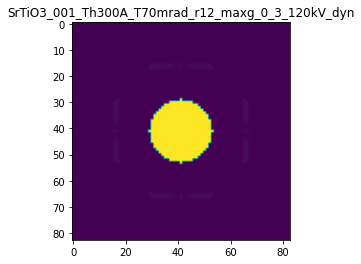

R-factor: 5.643976519121858e-07

>>> producing the 5. dataset...

The offset applied on thickness: -0.00031902847910628986

The offset applied on Ug: 0.013127481290673941

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6809715208937
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

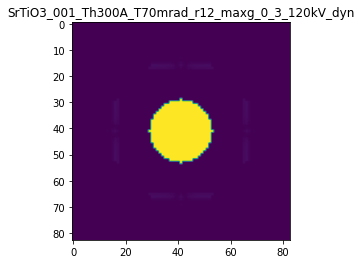

R-factor: 4.1954112674522384e-07

>>> producing the 6. dataset...

The offset applied on thickness: -2.8176263047989812e-05

The offset applied on Ug: 0.01978218894540589

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.97182373695205
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

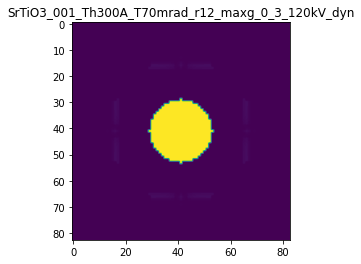

R-factor: 1.3984723471565938e-07

>>> producing the 7. dataset...

The offset applied on thickness: -0.0009028566729906418

The offset applied on Ug: 0.053467441194000605

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.09714332700935
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

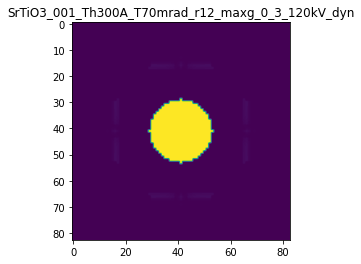

R-factor: 1.2387273562115005e-06

>>> producing the 8. dataset...

The offset applied on thickness: -0.0008304509025960396

The offset applied on Ug: -0.05255877292690066

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.16954909740394
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

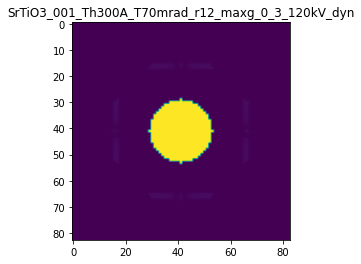

R-factor: 1.1155292246534087e-06

>>> producing the 9. dataset...

The offset applied on thickness: -0.0009082359389313208

The offset applied on Ug: 0.09098552700229473

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0917640610687
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

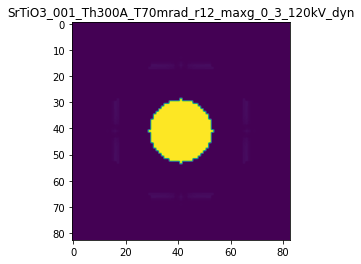

R-factor: 1.3953376918775988e-06

>>> producing the 10. dataset...

The offset applied on thickness: 0.0007981057476210219

The offset applied on Ug: 0.11789363245779452

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.798105747621
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

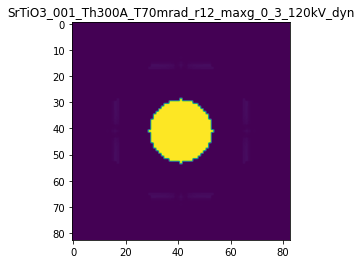

R-factor: 1.1995486807840595e-06

>>> producing the 11. dataset...

The offset applied on thickness: -0.00011125522393315967

The offset applied on Ug: 0.04868284460690038

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8887447760668
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

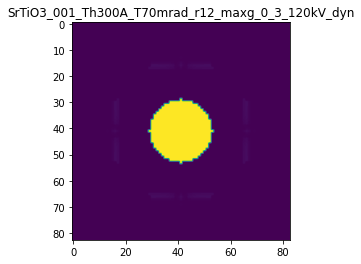

R-factor: 3.777188204494405e-07

>>> producing the 12. dataset...

The offset applied on thickness: 0.00018726113961347557

The offset applied on Ug: 0.15752923197263616

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1872611396135
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

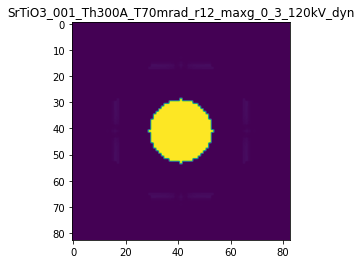

R-factor: 9.325963573307434e-07

>>> producing the 13. dataset...

The offset applied on thickness: -0.0004323436413592277

The offset applied on Ug: 0.024432534964452125

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.56765635864076
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

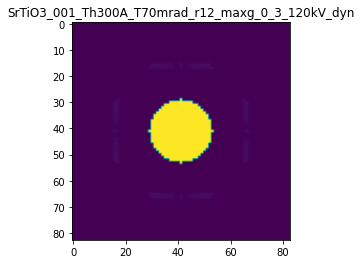

R-factor: 5.890817139501042e-07

>>> producing the 14. dataset...

The offset applied on thickness: -0.0005768118848201485

The offset applied on Ug: 0.07215369389700779

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4231881151798
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

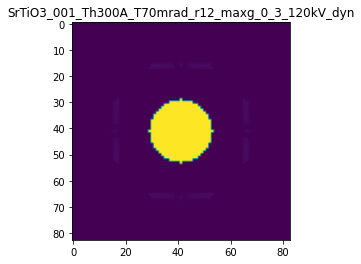

R-factor: 9.52041685213323e-07

>>> producing the 15. dataset...

The offset applied on thickness: 0.0009294903231046407

The offset applied on Ug: -0.1268584145590895

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.92949032310463
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

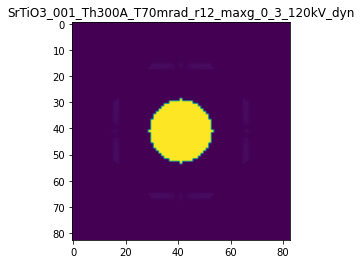

R-factor: 1.5909944220337314e-06

>>> producing the 16. dataset...

The offset applied on thickness: 0.00047519675474067794

The offset applied on Ug: -0.10813496759882937

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.47519675474064
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

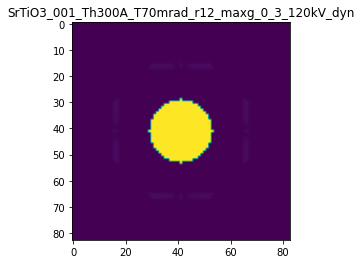

R-factor: 1.0419793604837621e-06

>>> producing the 17. dataset...

The offset applied on thickness: -0.0009289540680044422

The offset applied on Ug: -0.06629598407404337

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.07104593199557
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

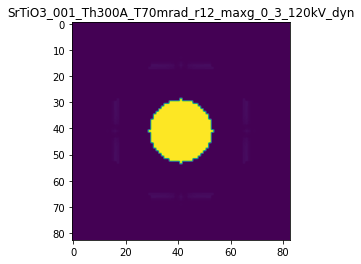

R-factor: 1.2608826062807796e-06

>>> producing the 18. dataset...

The offset applied on thickness: -0.0004718152471300956

The offset applied on Ug: 0.124103554996368

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5281847528699
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

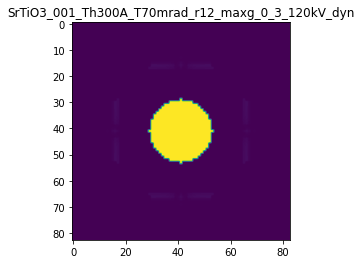

R-factor: 1.1273016094476815e-06

>>> producing the 19. dataset...

The offset applied on thickness: 0.00021731341520012925

The offset applied on Ug: -0.06965274734034502

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2173134152001
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

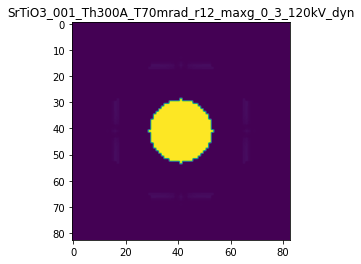

R-factor: 5.903889487487185e-07

>>> producing the 20. dataset...

The offset applied on thickness: -0.00016539566790897586

The offset applied on Ug: -0.028575206654154073

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.83460433209103
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

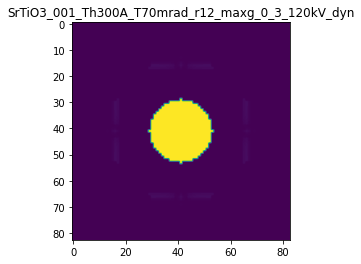

R-factor: 2.59946475990251e-07

>>> producing the 21. dataset...

The offset applied on thickness: -0.00026660292560494827

The offset applied on Ug: 0.042582845013102

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.73339707439504
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

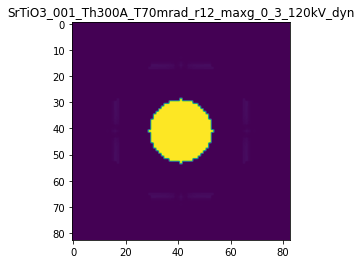

R-factor: 4.87000734484751e-07

>>> producing the 22. dataset...

The offset applied on thickness: 0.00021364032269683287

The offset applied on Ug: -0.01184877068772625

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2136403226968
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

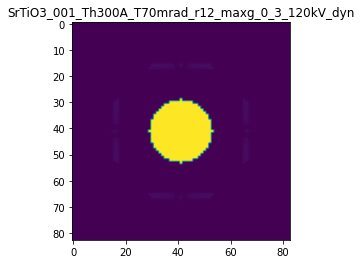

R-factor: 2.906292820632711e-07

>>> producing the 23. dataset...

The offset applied on thickness: 7.575176925304961e-06

The offset applied on Ug: -0.09334483142126417

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0075751769253
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

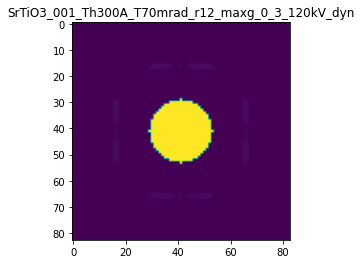

R-factor: 5.765897403313118e-07

>>> producing the 24. dataset...

The offset applied on thickness: 0.0008844602384040601

The offset applied on Ug: -0.13417520003508362

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.884460238404
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

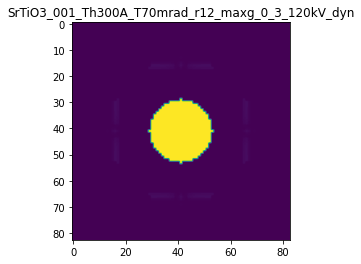

R-factor: 1.5823558762841998e-06

>>> producing the 25. dataset...

The offset applied on thickness: 0.0006016026456492775

The offset applied on Ug: 0.06411539671132346

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6016026456493
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

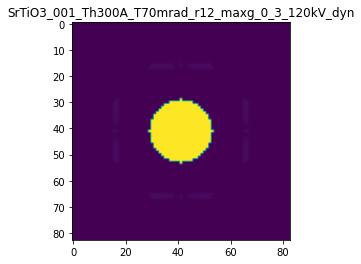

R-factor: 8.558030937593821e-07

>>> producing the 26. dataset...

The offset applied on thickness: -0.0003802429553441089

The offset applied on Ug: -0.07328190386448113

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6197570446559
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

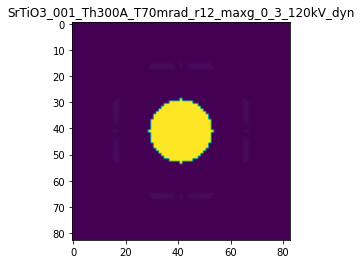

R-factor: 6.198135994646032e-07

>>> producing the 27. dataset...

The offset applied on thickness: -6.64240469244195e-05

The offset applied on Ug: 0.1418067826013328

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.93357595307555
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

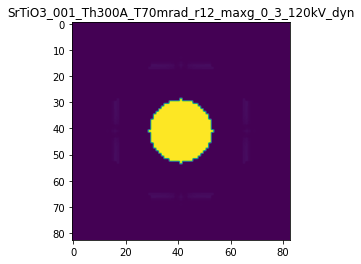

R-factor: 9.10948657990605e-07

>>> producing the 28. dataset...

The offset applied on thickness: 0.0008798515408915353

The offset applied on Ug: -0.13477212965433688

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.87985154089154
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

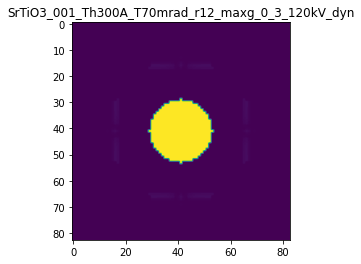

R-factor: 1.5808073200911785e-06

>>> producing the 29. dataset...

The offset applied on thickness: 0.0009123874844644915

The offset applied on Ug: 0.12010796229217181

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9123874844645
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

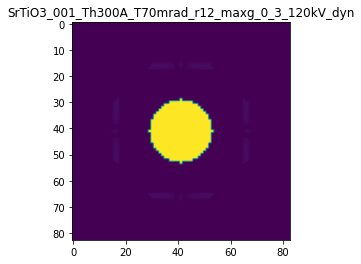

R-factor: 1.3398275869641043e-06

>>> producing the 30. dataset...

The offset applied on thickness: -0.00017109414674685254

The offset applied on Ug: 0.025182042317364442

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8289058532531
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

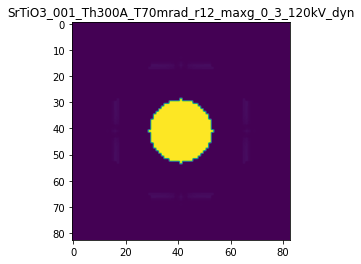

R-factor: 3.01504557359314e-07

>>> producing the 31. dataset...

The offset applied on thickness: -0.0009855260557973017

The offset applied on Ug: 0.04207209162211562

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0144739442027
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

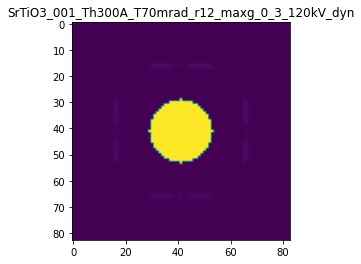

R-factor: 1.298832101624744e-06

>>> producing the 32. dataset...

The offset applied on thickness: -0.000461962008379049

The offset applied on Ug: -0.04872989780426984

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5380379916209
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

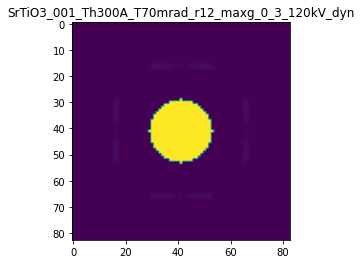

R-factor: 6.560285634569891e-07

>>> producing the 33. dataset...

The offset applied on thickness: 0.0008972841982315032

The offset applied on Ug: 0.1502166404753007

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8972841982315
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

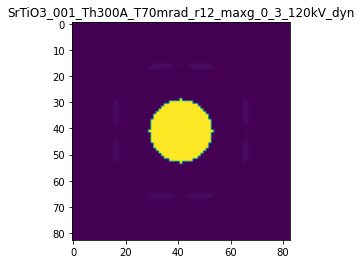

R-factor: 1.3957718449131762e-06

>>> producing the 34. dataset...

The offset applied on thickness: 0.0003683052752138629

The offset applied on Ug: 0.018098294155297696

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.36830527521386
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

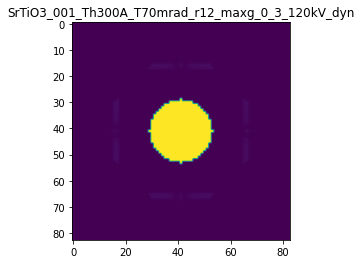

R-factor: 4.873964726942914e-07

>>> producing the 35. dataset...

The offset applied on thickness: 0.00032983269836362795

The offset applied on Ug: -0.14576363995692493

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3298326983636
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

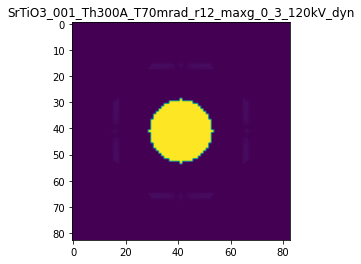

R-factor: 1.127892633659687e-06

>>> producing the 36. dataset...

The offset applied on thickness: 0.0005725711039188659

The offset applied on Ug: -0.09769358551977302

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.57257110391885
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

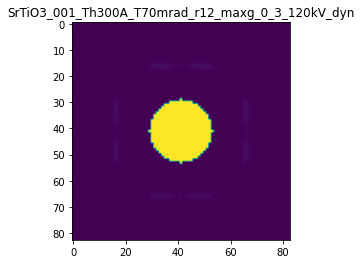

R-factor: 1.0802033239662799e-06

>>> producing the 37. dataset...

The offset applied on thickness: 0.00030493543044266946

The offset applied on Ug: -0.13396972688037792

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3049354304427
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

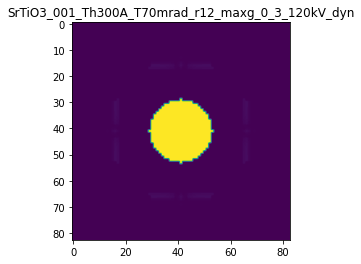

R-factor: 1.038170859765648e-06

>>> producing the 38. dataset...

The offset applied on thickness: -0.00025180758698134054

The offset applied on Ug: -0.1381901047403848

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.74819241301867
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

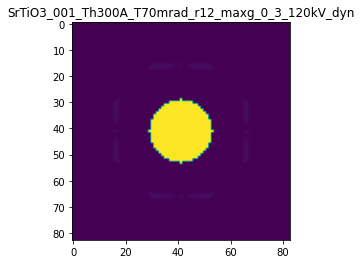

R-factor: 8.47388002428487e-07

>>> producing the 39. dataset...

The offset applied on thickness: 0.0001804757962060497

The offset applied on Ug: -0.13384885295484625

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.18047579620605
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

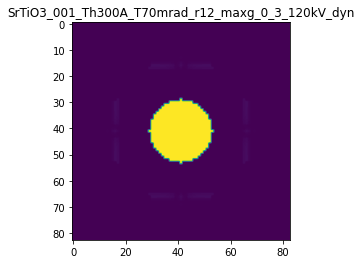

R-factor: 9.37924752570667e-07

>>> producing the 40. dataset...

The offset applied on thickness: -0.0005394829790187176

The offset applied on Ug: 0.11925706377168986

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.46051702098123
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

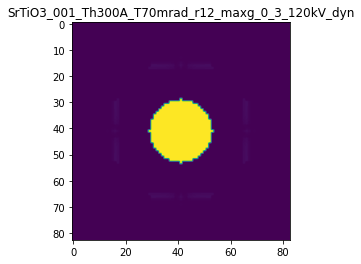

R-factor: 1.1623194022175176e-06

>>> producing the 41. dataset...

The offset applied on thickness: -0.00038456175404692994

The offset applied on Ug: -0.12371471105480485

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.61543824595304
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

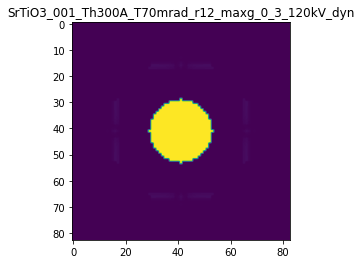

R-factor: 8.493514353447341e-07

>>> producing the 42. dataset...

The offset applied on thickness: 0.0005032720465932521

The offset applied on Ug: 0.0916511566120078

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5032720465932
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

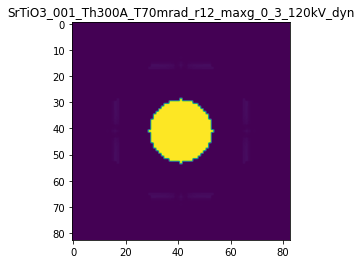

R-factor: 8.033719860648729e-07

>>> producing the 43. dataset...

The offset applied on thickness: -0.0007931603552952897

The offset applied on Ug: 0.06993869001837003

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2068396447047
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

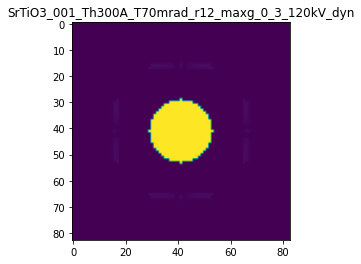

R-factor: 1.18016063531965e-06

>>> producing the 44. dataset...

The offset applied on thickness: -0.0002212025427599167

The offset applied on Ug: 0.027028913565400606

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.77879745724005
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

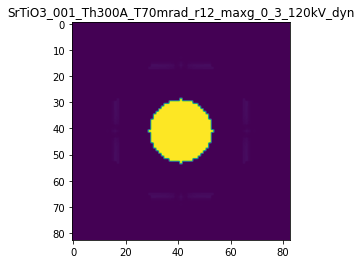

R-factor: 3.621932685768585e-07

>>> producing the 45. dataset...

The offset applied on thickness: 8.998457684715255e-05

The offset applied on Ug: -0.1001268263450784

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.08998457684714
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

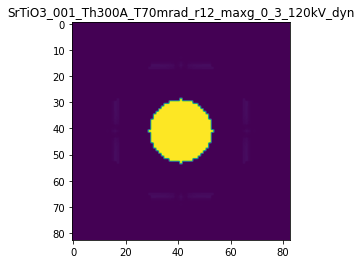

R-factor: 6.699533698156769e-07

>>> producing the 46. dataset...

The offset applied on thickness: 0.00018824913811351363

The offset applied on Ug: 0.0670272199578364

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.18824913811346
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

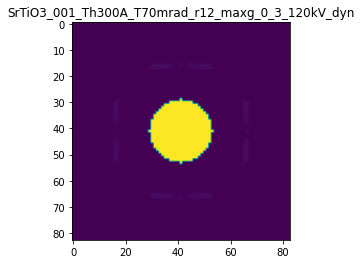

R-factor: 4.4716194009357076e-07

>>> producing the 47. dataset...

The offset applied on thickness: 0.0007274823943406937

The offset applied on Ug: 0.009191342323168818

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.72748239434065
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

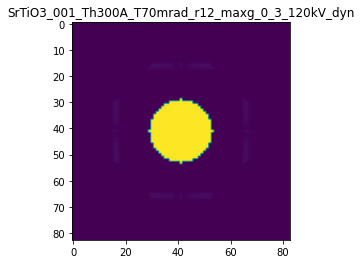

R-factor: 9.263635412230506e-07

>>> producing the 48. dataset...

The offset applied on thickness: 0.0001449529988087195

The offset applied on Ug: -0.14412528501888058

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1449529988087
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

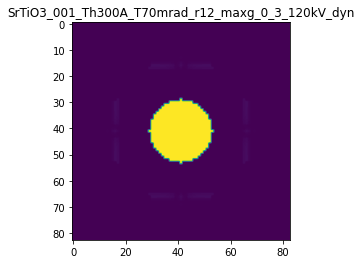

R-factor: 9.74587775965125e-07

>>> producing the 49. dataset...

The offset applied on thickness: 6.365038156433966e-06

The offset applied on Ug: 0.015885353131471405

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.00636503815645
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

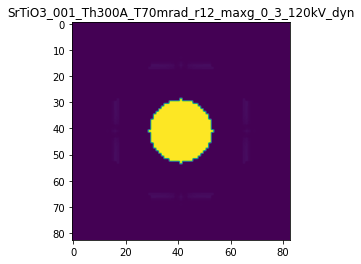

R-factor: 9.479410630811967e-08

>>> producing the 50. dataset...

The offset applied on thickness: -0.00046988863067941436

The offset applied on Ug: 0.004865878935960453

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.53011136932054
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

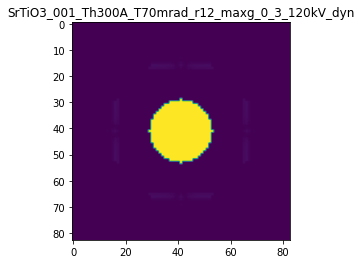

R-factor: 5.925210536619085e-07

>>> producing the 51. dataset...

The offset applied on thickness: 0.00010150860352079016

The offset applied on Ug: 0.11626812545431087

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1015086035208
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

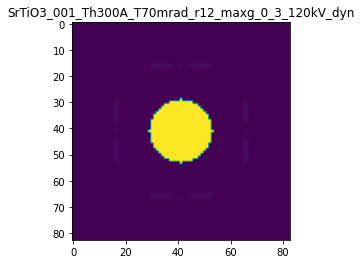

R-factor: 6.872013805766753e-07

>>> producing the 52. dataset...

The offset applied on thickness: -0.0008914161075553563

The offset applied on Ug: 0.017043189705749136

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.10858389244464
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

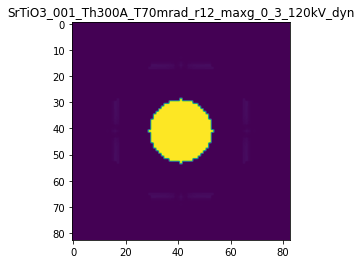

R-factor: 1.1305794870441713e-06

>>> producing the 53. dataset...

The offset applied on thickness: 0.0004592830153578509

The offset applied on Ug: -0.05291130847336582

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.45928301535787
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

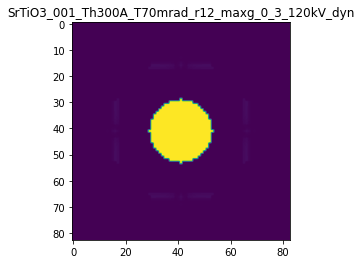

R-factor: 7.377118723360571e-07

>>> producing the 54. dataset...

The offset applied on thickness: -0.00011106279236470318

The offset applied on Ug: 0.1178514616208163

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.88893720763525
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

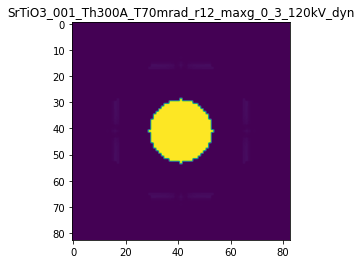

R-factor: 7.935000142482111e-07

>>> producing the 55. dataset...

The offset applied on thickness: -0.0004456699762298917

The offset applied on Ug: -0.08816149653864173

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5543300237701
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

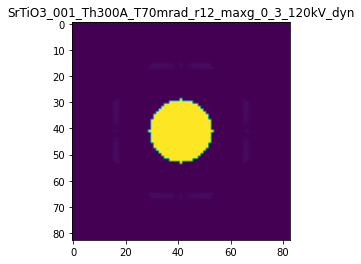

R-factor: 7.34176122055915e-07

>>> producing the 56. dataset...

The offset applied on thickness: -0.0002610563693241819

The offset applied on Ug: 0.003859199445112083

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7389436306758
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

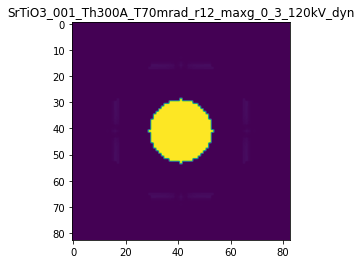

R-factor: 3.301470708460722e-07

>>> producing the 57. dataset...

The offset applied on thickness: 0.000981397702122602

The offset applied on Ug: -0.13722883324250165

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9813977021226
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

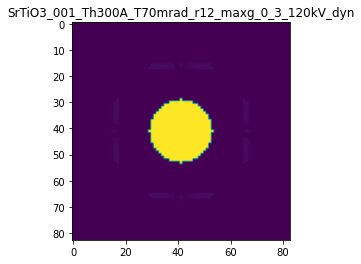

R-factor: 1.6964269243425393e-06

>>> producing the 58. dataset...

The offset applied on thickness: -0.0006388621797373544

The offset applied on Ug: 0.025929807421296226

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3611378202626
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

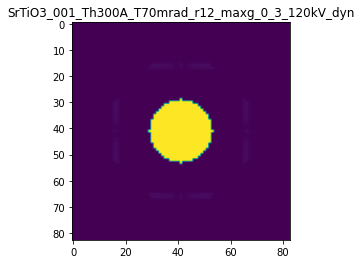

R-factor: 8.385594920337474e-07

>>> producing the 59. dataset...

The offset applied on thickness: -0.00033619276569225675

The offset applied on Ug: 0.09820628262154113

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.66380723430774
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

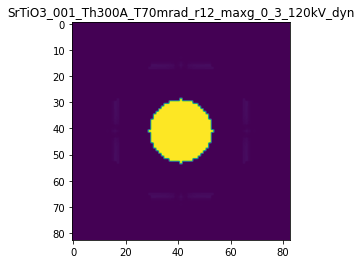

R-factor: 8.586831955113248e-07

>>> producing the 60. dataset...

The offset applied on thickness: -0.0004159710479156189

The offset applied on Ug: -0.14970321392472055

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.58402895208434
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

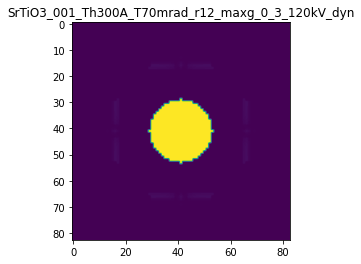

R-factor: 9.971846833627992e-07

>>> producing the 61. dataset...

The offset applied on thickness: -0.0008732979497599134

The offset applied on Ug: 0.13014327621853197

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.12670205024006
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

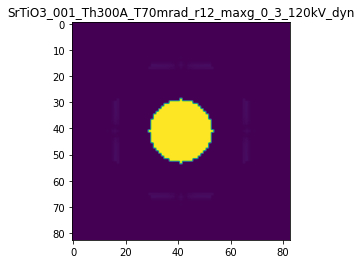

R-factor: 1.5453059259675342e-06

>>> producing the 62. dataset...

The offset applied on thickness: -0.0005412442617988327

The offset applied on Ug: 0.04739185973372912

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.45875573820115
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

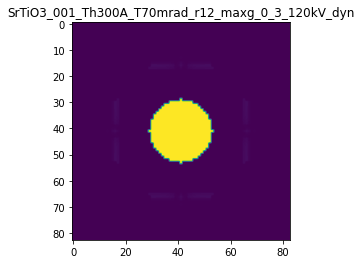

R-factor: 8.043110080840934e-07

>>> producing the 63. dataset...

The offset applied on thickness: 0.000369070189793445

The offset applied on Ug: 0.14267215122792135

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.36907018979343
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

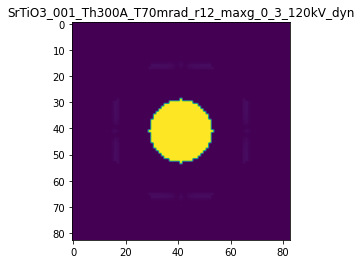

R-factor: 9.31467020751986e-07

>>> producing the 64. dataset...

The offset applied on thickness: 0.000324889777165404

The offset applied on Ug: -0.15940925103424972

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.32488977716537
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

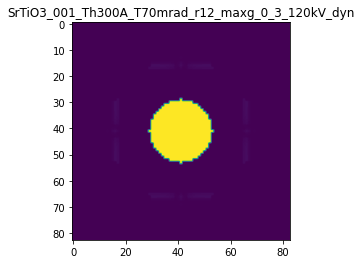

R-factor: 1.2032314542914843e-06

>>> producing the 65. dataset...

The offset applied on thickness: 0.0007472876148919967

The offset applied on Ug: 0.02053714843570031

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.747287614892
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

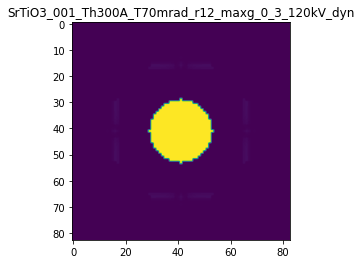

R-factor: 9.668532876983224e-07

>>> producing the 66. dataset...

The offset applied on thickness: -6.928760600151796e-05

The offset applied on Ug: -0.11038090839439317

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9307123939985
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

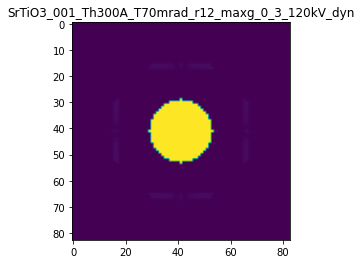

R-factor: 6.53307336773497e-07

>>> producing the 67. dataset...

The offset applied on thickness: -0.00016553276430013054

The offset applied on Ug: 0.026574088588490453

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.83446723569983
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

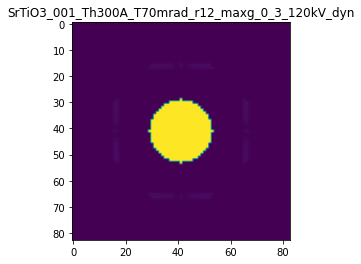

R-factor: 3.031230941087056e-07

>>> producing the 68. dataset...

The offset applied on thickness: -0.0009138039559843821

The offset applied on Ug: -0.07764458089656628

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0861960440156
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

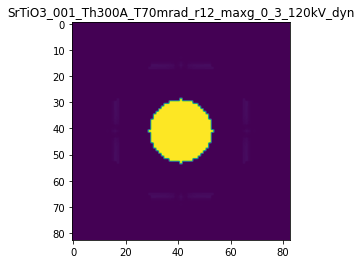

R-factor: 1.2624468112992161e-06

>>> producing the 69. dataset...

The offset applied on thickness: 5.2066234557636815e-05

The offset applied on Ug: 0.13455877585694803

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0520662345576
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

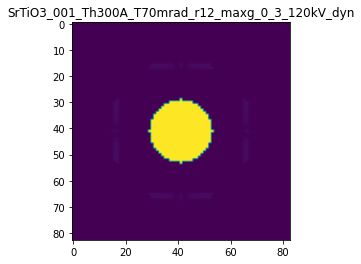

R-factor: 8.043837575213726e-07

>>> producing the 70. dataset...

The offset applied on thickness: 0.00020089638190160119

The offset applied on Ug: -0.01246386857569302

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2008963819016
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

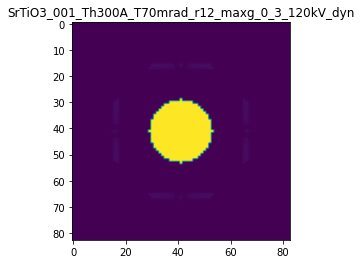

R-factor: 2.7840039909454886e-07

>>> producing the 71. dataset...

The offset applied on thickness: -0.0007938306638693547

The offset applied on Ug: -0.11486228092264252

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.20616933613064
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

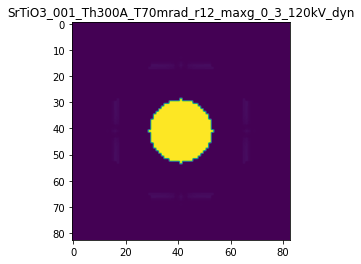

R-factor: 1.1889671724632615e-06

>>> producing the 72. dataset...

The offset applied on thickness: -7.113209286462019e-05

The offset applied on Ug: 0.010134584001237883

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9288679071353
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

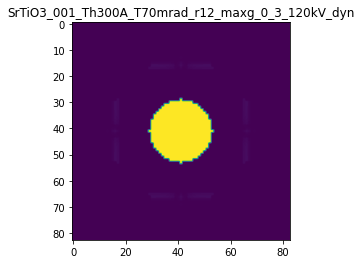

R-factor: 1.236578331045951e-07

>>> producing the 73. dataset...

The offset applied on thickness: -0.0007075814621259297

The offset applied on Ug: 0.048953811579515796

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2924185378741
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

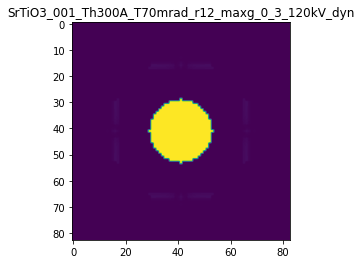

R-factor: 9.990964551553048e-07

>>> producing the 74. dataset...

The offset applied on thickness: 4.7483384396332486e-05

The offset applied on Ug: 0.11623414761408338

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0474833843963
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

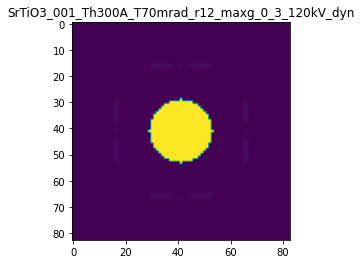

R-factor: 6.940170296022872e-07

>>> producing the 75. dataset...

The offset applied on thickness: -0.0005883402836783613

The offset applied on Ug: 0.15405831590061383

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4116597163216
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

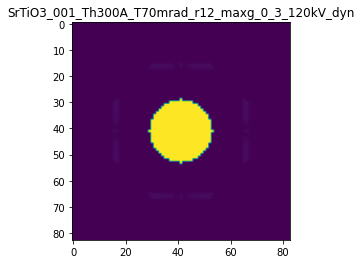

R-factor: 1.4016045669885775e-06

>>> producing the 76. dataset...

The offset applied on thickness: -0.000936391273527599

The offset applied on Ug: -0.15254444811065812

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.06360872647235
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

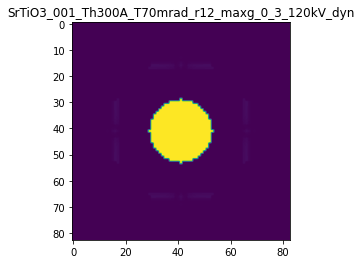

R-factor: 1.4471130872211294e-06

>>> producing the 77. dataset...

The offset applied on thickness: 0.00030563583461218726

The offset applied on Ug: 0.1418305180181923

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3056358346122
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

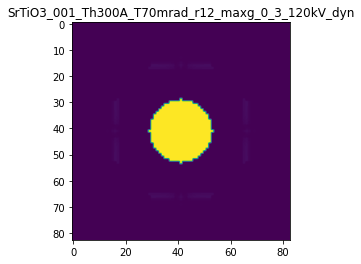

R-factor: 8.900970611523143e-07

>>> producing the 78. dataset...

The offset applied on thickness: -0.0004137973085437856

The offset applied on Ug: -0.030889941486510326

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5862026914562
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

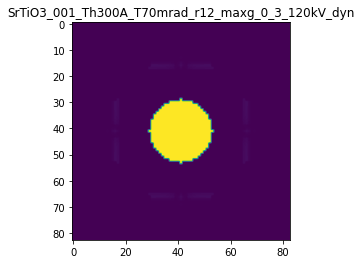

R-factor: 5.645333980468131e-07

>>> producing the 79. dataset...

The offset applied on thickness: 0.0003630828116237783

The offset applied on Ug: -0.019348993494960567

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.36308281162377
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

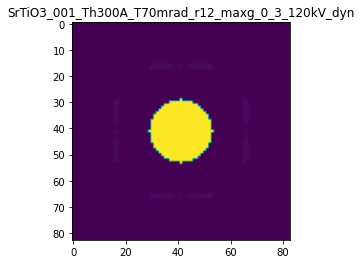

R-factor: 4.913087113974658e-07

>>> producing the 80. dataset...

The offset applied on thickness: -0.000654810826607114

The offset applied on Ug: -0.0852390419938057

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.34518917339284
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

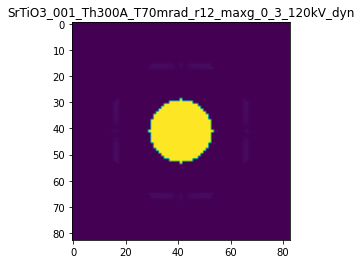

R-factor: 9.60913484603532e-07

>>> producing the 81. dataset...

The offset applied on thickness: -6.930284256436848e-05

The offset applied on Ug: -0.1269736501724911

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.93069715743565
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

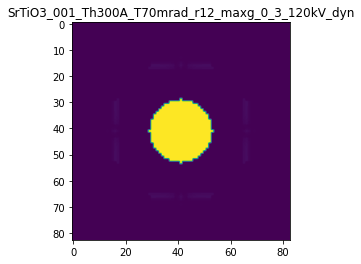

R-factor: 7.530950690603576e-07

>>> producing the 82. dataset...

The offset applied on thickness: -0.0007541990170175648

The offset applied on Ug: -0.1402629823265242

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2458009829824
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

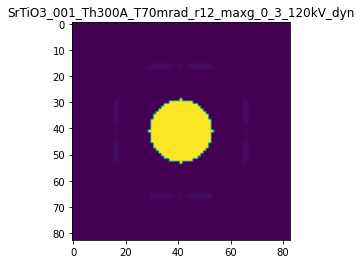

R-factor: 1.2145751803121955e-06

>>> producing the 83. dataset...

The offset applied on thickness: -0.00016422264822480036

The offset applied on Ug: 0.13625123095822106

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.83577735177516
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

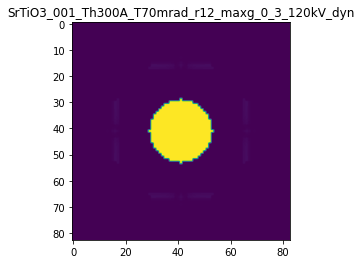

R-factor: 9.423326738681146e-07

>>> producing the 84. dataset...

The offset applied on thickness: 0.0005266734310985824

The offset applied on Ug: -0.13249180537578628

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5266734310986
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

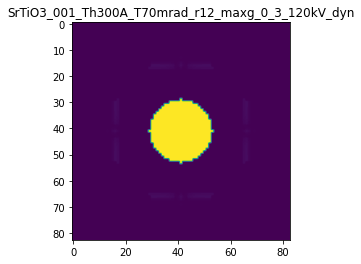

R-factor: 1.2256143958213407e-06

>>> producing the 85. dataset...

The offset applied on thickness: -0.0006843417269220953

The offset applied on Ug: -0.048766460432266394

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3156582730779
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

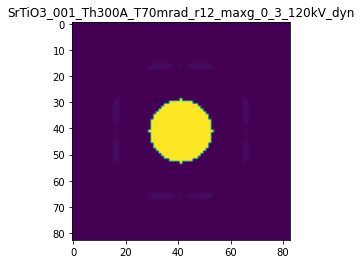

R-factor: 9.291374491784541e-07

>>> producing the 86. dataset...

The offset applied on thickness: 0.0009830782561271324

The offset applied on Ug: -0.01504845300700719

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.98307825612716
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

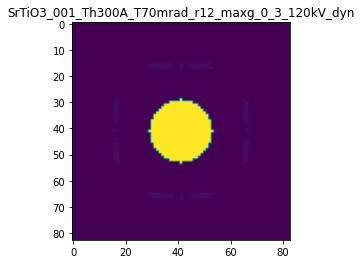

R-factor: 1.2467367127271442e-06

>>> producing the 87. dataset...

The offset applied on thickness: -0.0006595324118098364

The offset applied on Ug: -0.15629846932012562

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.34046758819017
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

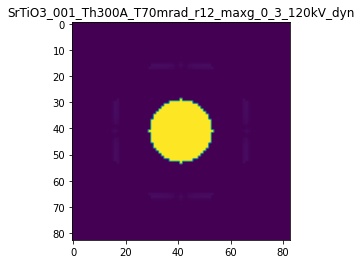

R-factor: 1.1921306664113049e-06

>>> producing the 88. dataset...

The offset applied on thickness: 0.0004594058308865041

The offset applied on Ug: -0.08071849827019303

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4594058308865
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

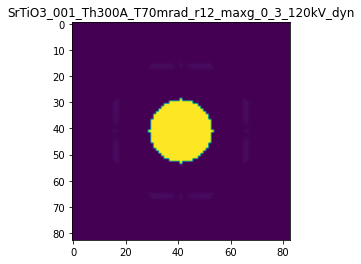

R-factor: 8.789418767211253e-07

>>> producing the 89. dataset...

The offset applied on thickness: 0.0002551639454801522

The offset applied on Ug: 0.015077774539945387

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.25516394548015
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

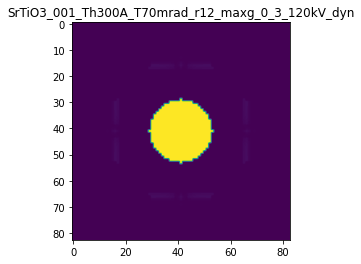

R-factor: 3.4158576933339294e-07

>>> producing the 90. dataset...

The offset applied on thickness: -0.00026049782027423964

The offset applied on Ug: -0.10830693922532142

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7395021797257
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

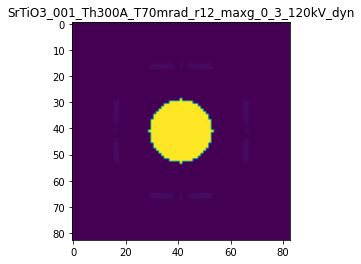

R-factor: 6.964049484541026e-07

>>> producing the 91. dataset...

The offset applied on thickness: -0.0008050587158606502

The offset applied on Ug: 0.10730388632495685

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1949412841393
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

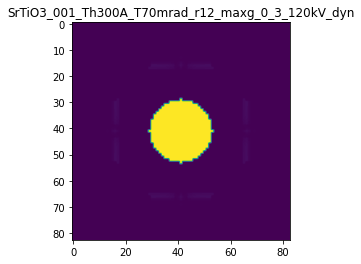

R-factor: 1.3608750651064903e-06

>>> producing the 92. dataset...

The offset applied on thickness: -0.0003122365974812147

The offset applied on Ug: -0.12632409647450735

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6877634025188
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

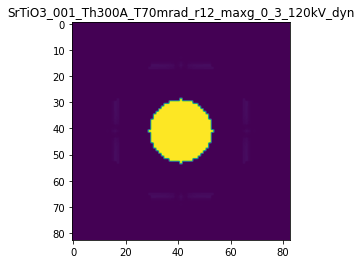

R-factor: 8.175014387463396e-07

>>> producing the 93. dataset...

The offset applied on thickness: 0.00023202881120101783

The offset applied on Ug: -0.0004371567982908786

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.23202881120096
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

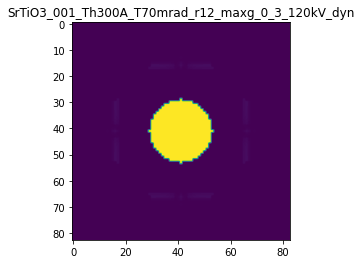

R-factor: 2.9247919605953406e-07

>>> producing the 94. dataset...

The offset applied on thickness: -0.0008893852059321599

The offset applied on Ug: 0.10477379374089335

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1106147940678
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

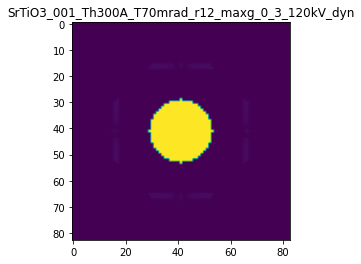

R-factor: 1.4358771930282785e-06

>>> producing the 95. dataset...

The offset applied on thickness: -2.956834937285513e-05

The offset applied on Ug: -0.04252453272424966

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9704316506271
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

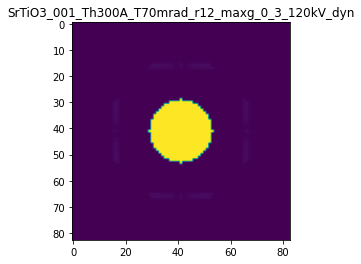

R-factor: 2.515774228190106e-07

>>> producing the 96. dataset...

The offset applied on thickness: -0.0005838485108646947

The offset applied on Ug: 0.09966522617006199

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4161514891353
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

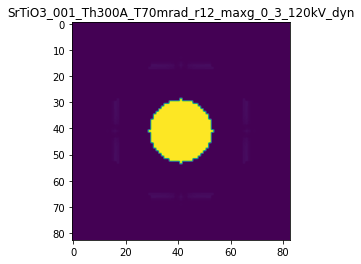

R-factor: 1.0996594755033352e-06

>>> producing the 97. dataset...

The offset applied on thickness: -0.0001690911145582945

The offset applied on Ug: -0.007431087583037624

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.83090888544166
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

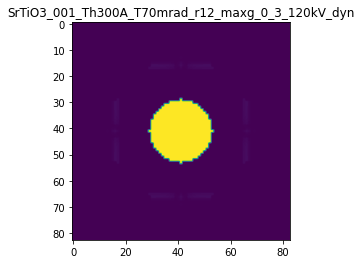

R-factor: 2.2225413399988063e-07

>>> producing the 98. dataset...

The offset applied on thickness: 0.000267196741548174

The offset applied on Ug: 0.11905919860137981

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.26719674154816
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

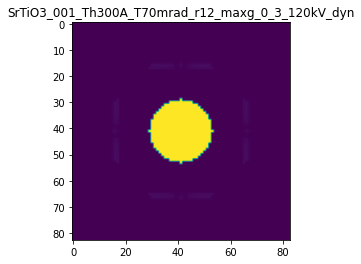

R-factor: 7.530697393329268e-07

>>> producing the 99. dataset...

The offset applied on thickness: -0.00045632673212361196

The offset applied on Ug: 0.037183110945559754

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5436732678764
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

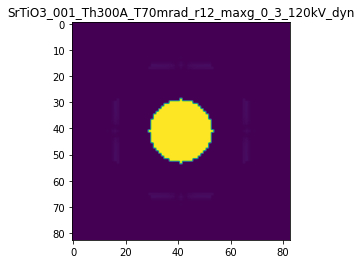

R-factor: 6.670130674378571e-07

>>> producing the 100. dataset...

The offset applied on thickness: 0.0008640676291955127

The offset applied on Ug: -0.09990736384196662

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.86406762919546
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

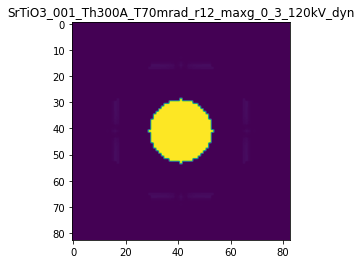

R-factor: 1.3906103121190418e-06

>>> producing the 101. dataset...

The offset applied on thickness: -4.696076585996667e-05

The offset applied on Ug: -0.08007454842399486

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.95303923414
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

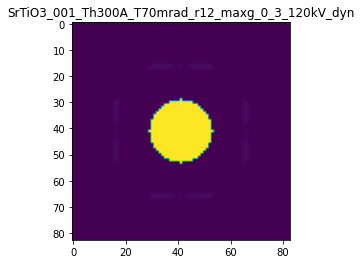

R-factor: 4.7455945622253633e-07

>>> producing the 102. dataset...

The offset applied on thickness: 0.000905140271192175

The offset applied on Ug: 0.028511289380988566

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9051402711921
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

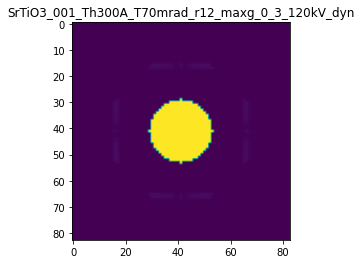

R-factor: 1.176469262086583e-06

>>> producing the 103. dataset...

The offset applied on thickness: -0.00045324045720760987

The offset applied on Ug: 0.05635745685781071

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.54675954279236
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

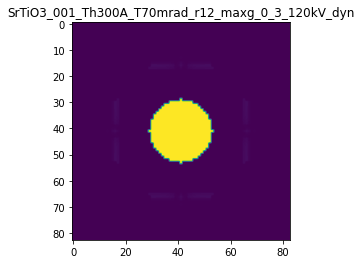

R-factor: 7.465886987973377e-07

>>> producing the 104. dataset...

The offset applied on thickness: 0.00035953577933101413

The offset applied on Ug: 0.027921329158013073

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.359535779331
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

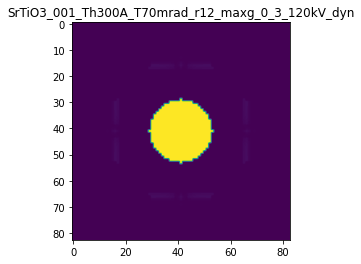

R-factor: 4.930241473023602e-07

>>> producing the 105. dataset...

The offset applied on thickness: -0.0009116448965089021

The offset applied on Ug: -0.07867529672730214

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0883551034911
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

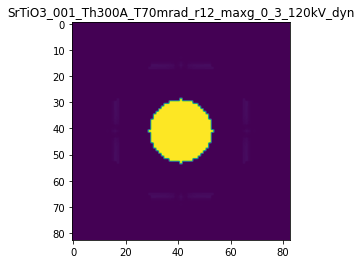

R-factor: 1.2616311951468193e-06

>>> producing the 106. dataset...

The offset applied on thickness: 0.0009289706896818264

The offset applied on Ug: 0.07756646103072928

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9289706896818
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

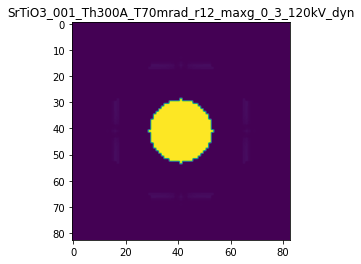

R-factor: 1.2841496340030734e-06

>>> producing the 107. dataset...

The offset applied on thickness: 0.00010410485384968138

The offset applied on Ug: -0.056255720836237054

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1041048538497
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

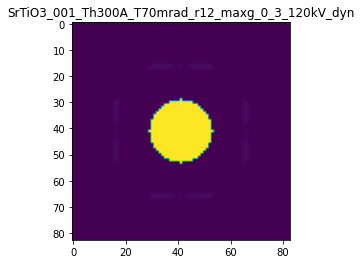

R-factor: 4.1605455733132857e-07

>>> producing the 108. dataset...

The offset applied on thickness: -5.584823251299631e-05

The offset applied on Ug: 0.1143020144594842

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.944151767487
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

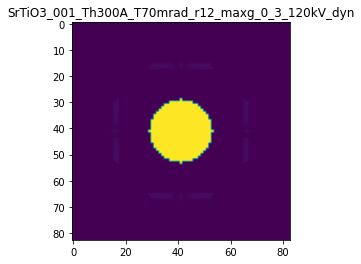

R-factor: 7.355091090426749e-07

>>> producing the 109. dataset...

The offset applied on thickness: 0.00024357347197520652

The offset applied on Ug: -0.14364409405792272

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2435734719752
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

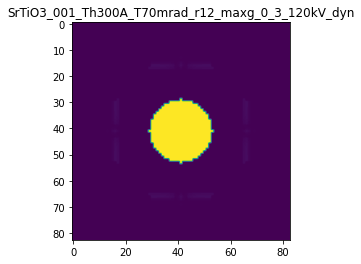

R-factor: 1.0442854286501018e-06

>>> producing the 110. dataset...

The offset applied on thickness: 0.0009238967051337348

The offset applied on Ug: 0.09406884673863562

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9238967051337
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

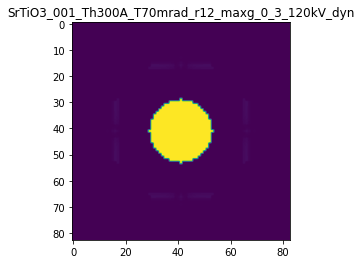

R-factor: 1.306490001050889e-06

>>> producing the 111. dataset...

The offset applied on thickness: 0.0003083451043284879

The offset applied on Ug: 0.09600898871959715

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.30834510432845
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

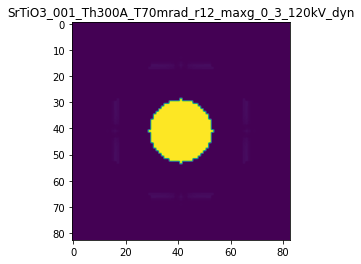

R-factor: 6.650172963895044e-07

>>> producing the 112. dataset...

The offset applied on thickness: 0.0007146786399727461

The offset applied on Ug: -0.034293521851308455

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.71467863997276
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

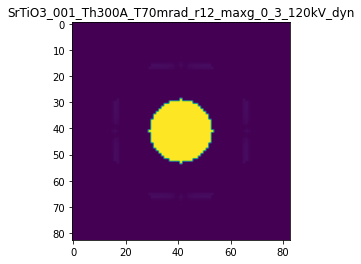

R-factor: 9.56340767543928e-07

>>> producing the 113. dataset...

The offset applied on thickness: -0.0003757829007086646

The offset applied on Ug: 0.12106600553714454

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.62421709929134
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

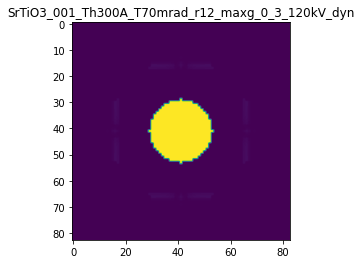

R-factor: 1.0240504008949356e-06

>>> producing the 114. dataset...

The offset applied on thickness: -0.00023449705476384896

The offset applied on Ug: 0.12544367122598513

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7655029452361
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

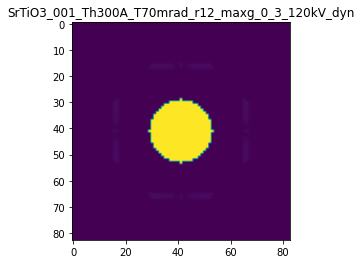

R-factor: 9.301572386512567e-07

>>> producing the 115. dataset...

The offset applied on thickness: -0.0004189664685109993

The offset applied on Ug: -0.08205340945741835

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.581033531489
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

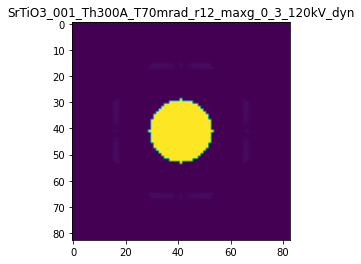

R-factor: 6.873259409530774e-07

>>> producing the 116. dataset...

The offset applied on thickness: -0.0002873072250139439

The offset applied on Ug: -0.06314222666932807

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.712692774986
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

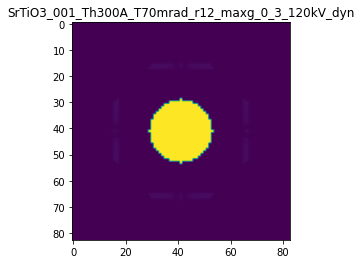

R-factor: 4.978085666812547e-07

>>> producing the 117. dataset...

The offset applied on thickness: 0.0005192222131315245

The offset applied on Ug: 0.1480575446429998

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5192222131315
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

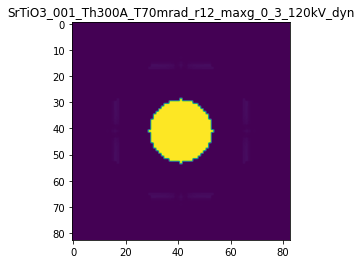

R-factor: 1.0546440503224607e-06

>>> producing the 118. dataset...

The offset applied on thickness: 7.682666683558992e-06

The offset applied on Ug: -0.10618214905567755

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.00768266668354
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

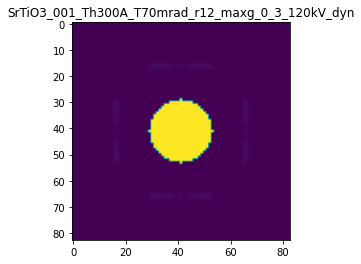

R-factor: 6.552363506820479e-07

>>> producing the 119. dataset...

The offset applied on thickness: -0.0005364419108835095

The offset applied on Ug: -0.1295467458750649

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4635580891165
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

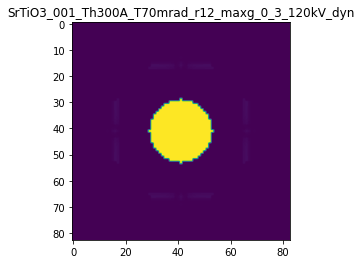

R-factor: 9.805024588199736e-07

>>> producing the 120. dataset...

The offset applied on thickness: 0.00016855986286314794

The offset applied on Ug: -0.11056935562114842

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1685598628631
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

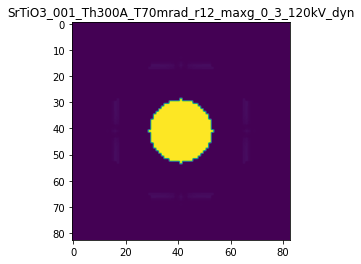

R-factor: 7.894129444384714e-07

>>> producing the 121. dataset...

The offset applied on thickness: -0.0009898824827917721

The offset applied on Ug: 0.089042771752437

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.01011751720824
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

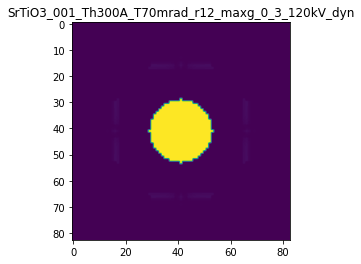

R-factor: 1.4795131574987164e-06

>>> producing the 122. dataset...

The offset applied on thickness: -0.0008297436336371351

The offset applied on Ug: 0.11049883058939287

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1702563663629
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

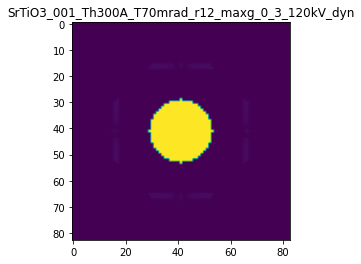

R-factor: 1.4020709472984193e-06

>>> producing the 123. dataset...

The offset applied on thickness: -0.0002735183742715435

The offset applied on Ug: -0.0666926728909602

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.72648162572847
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

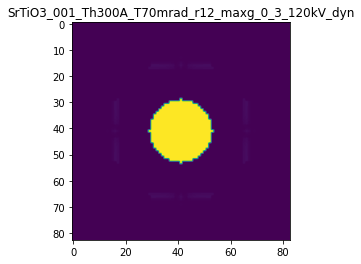

R-factor: 5.028048499540233e-07

>>> producing the 124. dataset...

The offset applied on thickness: 7.40907562158215e-05

The offset applied on Ug: -0.04191764777966892

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0740907562158
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

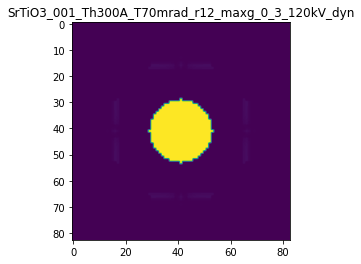

R-factor: 3.0725193466429176e-07

>>> producing the 125. dataset...

The offset applied on thickness: -0.0002913000631834244

The offset applied on Ug: -0.15811550965189253

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7086999368166
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

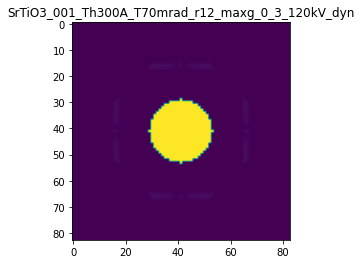

R-factor: 9.70830097062987e-07

>>> producing the 126. dataset...

The offset applied on thickness: 0.0007430254036930526

The offset applied on Ug: -0.1562153941067966

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.743025403693
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

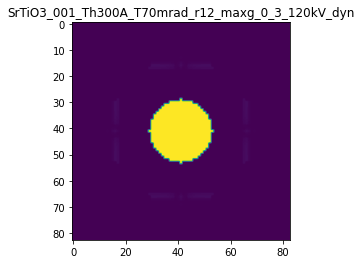

R-factor: 1.559753642131313e-06

>>> producing the 127. dataset...

The offset applied on thickness: 0.000681037284289578

The offset applied on Ug: 0.10998261218499593

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6810372842896
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

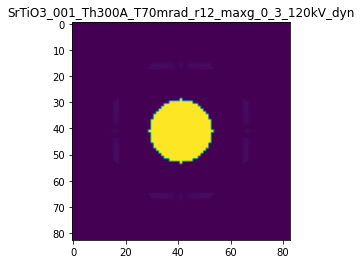

R-factor: 1.0486684524509387e-06

>>> producing the 128. dataset...

The offset applied on thickness: 0.000381794592239763

The offset applied on Ug: -0.02596419175861467

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3817945922397
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

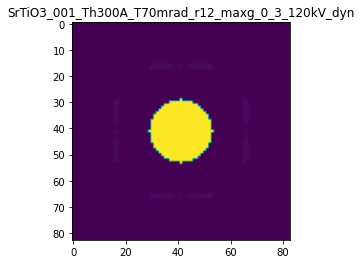

R-factor: 5.382603310220702e-07

>>> producing the 129. dataset...

The offset applied on thickness: 0.0004950438307350473

The offset applied on Ug: -0.08258318398135835

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.495043830735
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

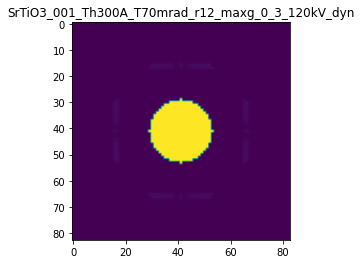

R-factor: 9.23894235443668e-07

>>> producing the 130. dataset...

The offset applied on thickness: 0.0008171300693044344

The offset applied on Ug: -0.10949777213947293

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8171300693044
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

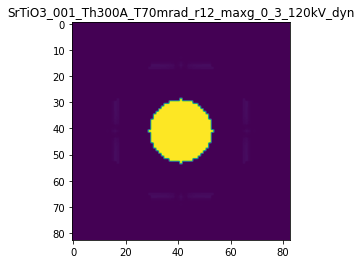

R-factor: 1.388342684240191e-06

>>> producing the 131. dataset...

The offset applied on thickness: -8.482381797070615e-05

The offset applied on Ug: -0.05034575922698895

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9151761820293
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

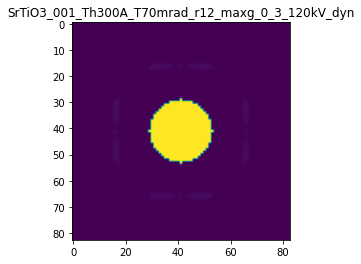

R-factor: 3.06033432940312e-07

>>> producing the 132. dataset...

The offset applied on thickness: -0.00037860147296214764

The offset applied on Ug: 0.0711780748881997

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.62139852703785
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

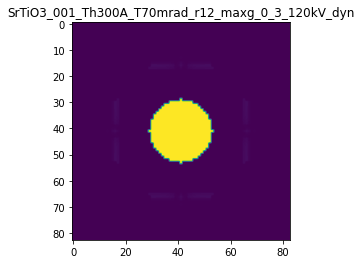

R-factor: 7.483281305485117e-07

>>> producing the 133. dataset...

The offset applied on thickness: -7.260076760786328e-05

The offset applied on Ug: -0.012464616922342664

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.92739923239213
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

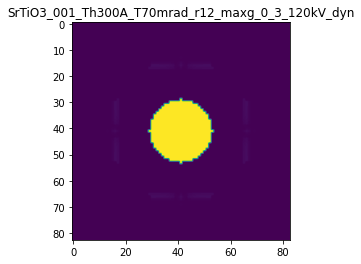

R-factor: 1.1385667638192679e-07

>>> producing the 134. dataset...

The offset applied on thickness: 0.00041989823855537357

The offset applied on Ug: -0.008544571448415219

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.41989823855533
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_f

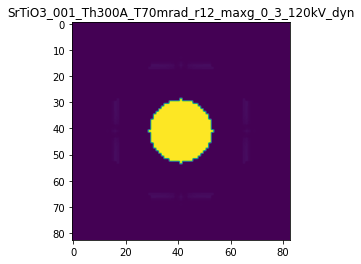

R-factor: 5.346554712404637e-07

>>> producing the 135. dataset...

The offset applied on thickness: -0.0001663374909769464

The offset applied on Ug: 0.12224741237181175

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.83366250902304
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

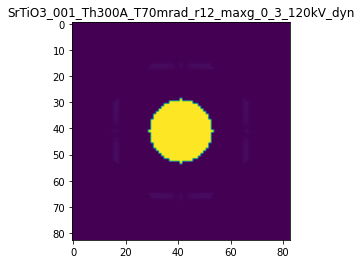

R-factor: 8.590781775066434e-07

>>> producing the 136. dataset...

The offset applied on thickness: -0.0008717098298624891

The offset applied on Ug: -0.043868116590382866

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.12829017013746
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

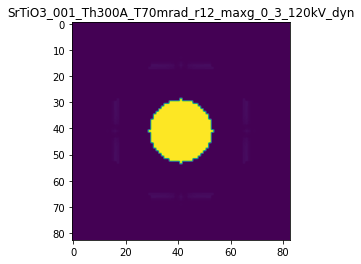

R-factor: 1.1522716438218696e-06

>>> producing the 137. dataset...

The offset applied on thickness: 0.0005269399425971479

The offset applied on Ug: 0.1008754838000062

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.52693994259715
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

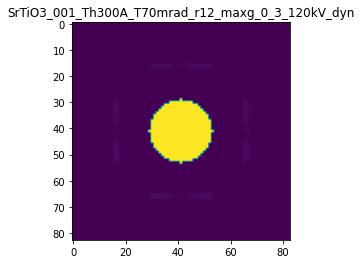

R-factor: 8.559592677929582e-07

>>> producing the 138. dataset...

The offset applied on thickness: -0.00014352950888908844

The offset applied on Ug: 0.04380663154414112

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.85647049111094
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

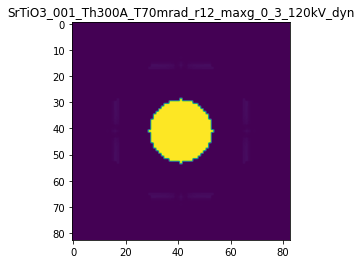

R-factor: 3.7732483718462334e-07

>>> producing the 139. dataset...

The offset applied on thickness: -0.00038307089211994216

The offset applied on Ug: -0.11465193225288356

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6169291078801
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

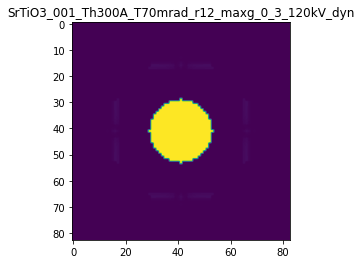

R-factor: 8.048221137467746e-07

>>> producing the 140. dataset...

The offset applied on thickness: -0.0007974723595650355

The offset applied on Ug: -0.11859673273793828

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.202527640435
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

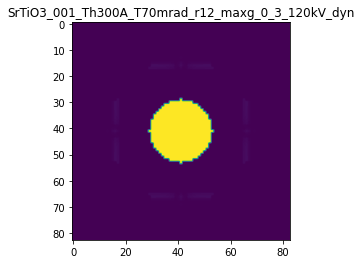

R-factor: 1.2017420536729059e-06



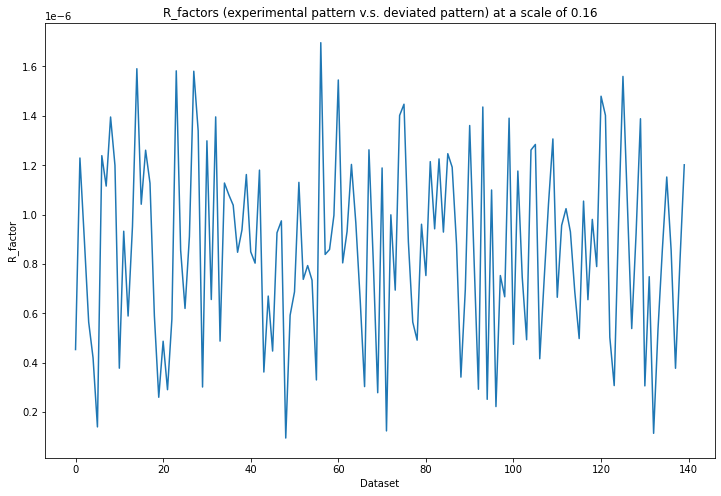

>>> start to train the ANN 

Epoch 1/30
5/5 [==============================] - 1s 130ms/step - loss: 0.3617 - acc: 0.8000 - val_loss: 0.3557 - val_acc: 1.0000
Epoch 2/30
5/5 [==============================] - 1s 107ms/step - loss: 0.3431 - acc: 1.0000 - val_loss: 0.3099 - val_acc: 1.0000
Epoch 3/30
5/5 [==============================] - 1s 109ms/step - loss: 0.2939 - acc: 1.0000 - val_loss: 0.2689 - val_acc: 1.0000
Epoch 4/30
5/5 [==============================] - 1s 108ms/step - loss: 0.2530 - acc: 1.0000 - val_loss: 0.2309 - val_acc: 1.0000
Epoch 5/30
5/5 [==============================] - 1s 108ms/step - loss: 0.2169 - acc: 1.0000 - val_loss: 0.2053 - val_acc: 1.0000
Epoch 6/30
5/5 [==============================] - 1s 109ms/step - loss: 0.1874 - acc: 1.0000 - val_loss: 0.1695 - val_acc: 1.0000
Epoch 7/30
5/5 [==============================] - 1s 108ms/step - loss: 0.1594 - acc: 1.0000 - val_loss: 0.1444 - val_acc: 1.0000
Epoch 8/30
5/5 [==============================] - 1s 108ms/st

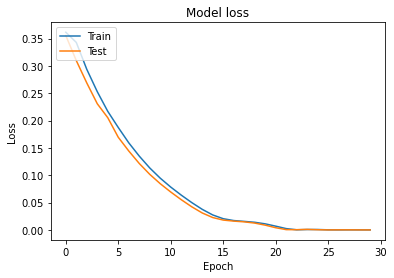

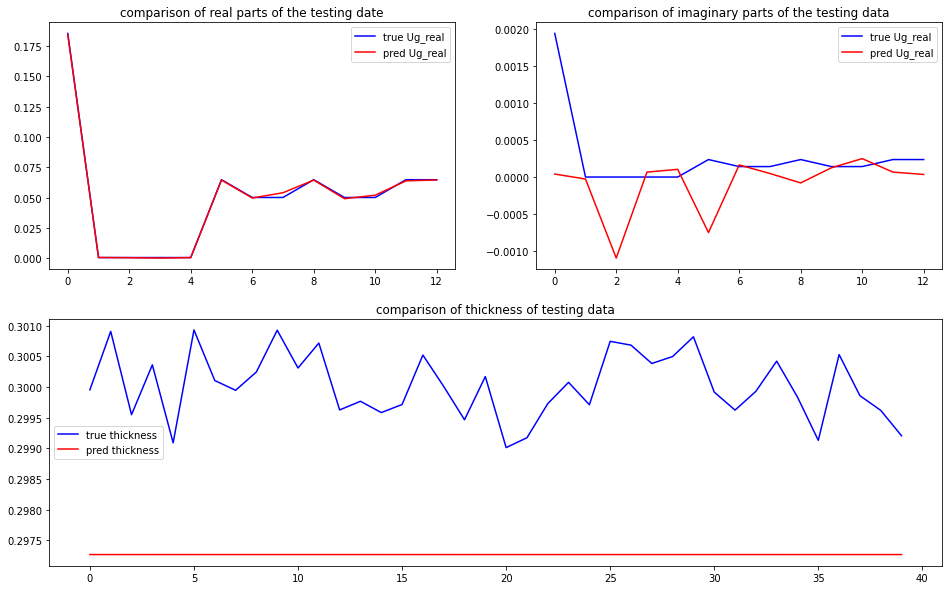

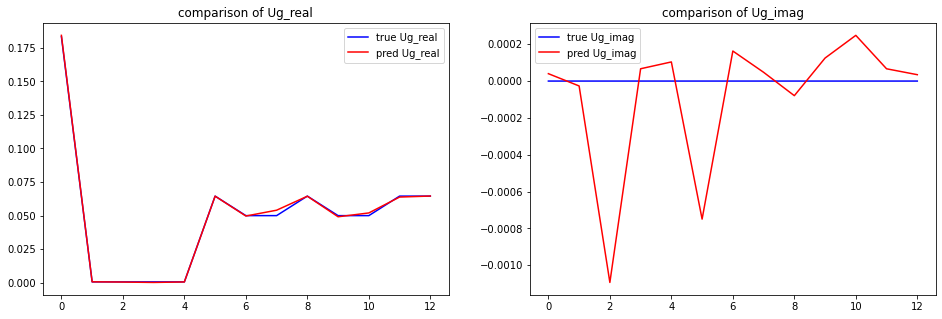

predicted thickness: 29.726526141166687 nm
mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=297.26526141166687
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 13 different beams

InputUg:
[0.18442863+0.00000000e+00j 0.

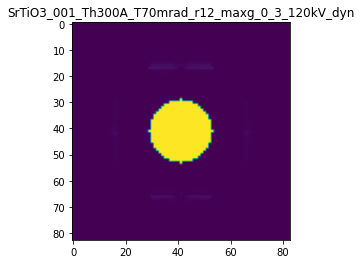

X_sim.max(): 0.9999981393939317
R-factor at a scale of 0.16 is 0.00012025489698006029.

-----------------------------------------------------------------------------------------------------

>>> start to produce Dataset at a scale of 0.32

-----------------------------------------------------------------------------------------------------

>>> producing the 1. dataset...

The offset applied on thickness: -4.3120760421389014e-06

The offset applied on Ug: 0.2645904974455763

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001

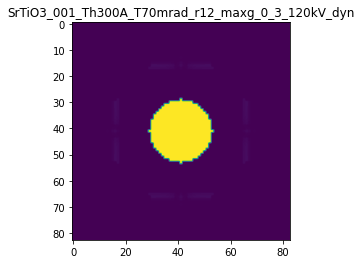

R-factor: 1.6333017119707176e-06

>>> producing the 2. dataset...

The offset applied on thickness: 0.000842457820678134

The offset applied on Ug: 0.020043013989953524

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.84245782067813
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

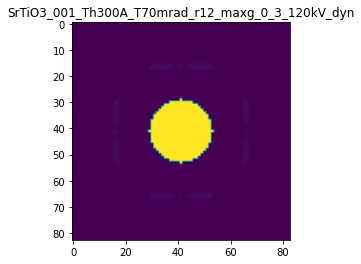

R-factor: 1.0859064302861054e-06

>>> producing the 3. dataset...

The offset applied on thickness: 0.0005682580396900579

The offset applied on Ug: 0.15087766474411196

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5682580396901
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

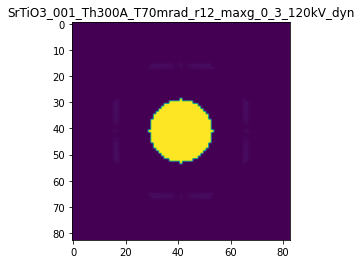

R-factor: 1.101193761688794e-06

>>> producing the 4. dataset...

The offset applied on thickness: 0.0005217014527726908

The offset applied on Ug: 0.08601847570438942

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5217014527727
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

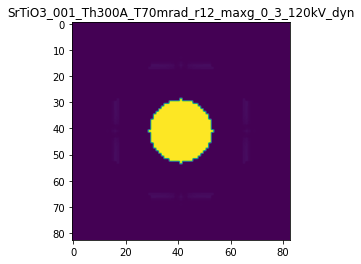

R-factor: 8.082172858511112e-07

>>> producing the 5. dataset...

The offset applied on thickness: -0.0002460434691019178

The offset applied on Ug: 0.1900246840766237

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7539565308981
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

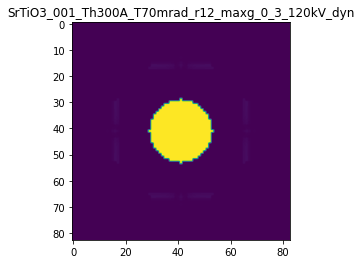

R-factor: 1.3268493914698736e-06

>>> producing the 6. dataset...

The offset applied on thickness: -0.0005916979524340438

The offset applied on Ug: -0.07474162858015618

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.40830204756594
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

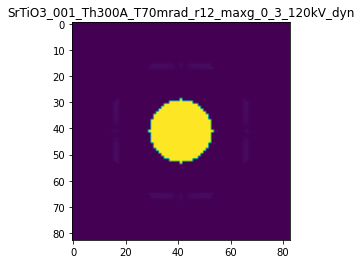

R-factor: 8.638448892868376e-07

>>> producing the 7. dataset...

The offset applied on thickness: 0.00024372663248866666

The offset applied on Ug: -0.010868793157429692

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2437266324887
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

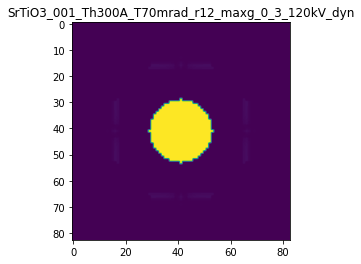

R-factor: 3.234054764052736e-07

>>> producing the 8. dataset...

The offset applied on thickness: -0.0007294110794912998

The offset applied on Ug: -0.27996413561820105

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.27058892050866
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

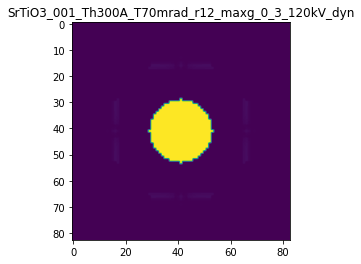

R-factor: 1.8363788161291655e-06

>>> producing the 9. dataset...

The offset applied on thickness: -0.0007209371674178973

The offset applied on Ug: 0.2419729146847257

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2790628325821
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

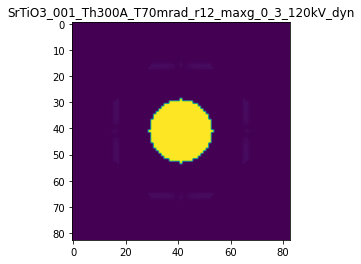

R-factor: 2.01953353959378e-06

>>> producing the 10. dataset...

The offset applied on thickness: 0.00043728424683208545

The offset applied on Ug: 0.22003599935053317

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.43728424683206
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

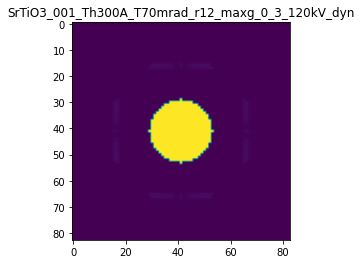

R-factor: 1.3612006078952117e-06

>>> producing the 11. dataset...

The offset applied on thickness: 0.0009677336523021527

The offset applied on Ug: -0.21065789639112922

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9677336523021
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

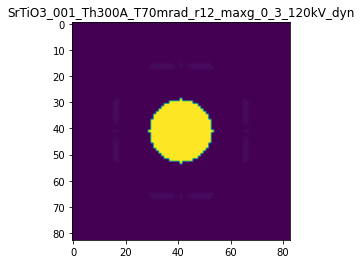

R-factor: 2.0707818527801427e-06

>>> producing the 12. dataset...

The offset applied on thickness: -6.550151085463685e-05

The offset applied on Ug: -0.07763817005278853

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9344984891453
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

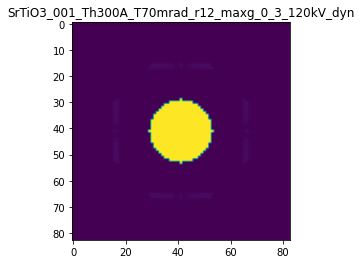

R-factor: 4.5853035156413254e-07

>>> producing the 13. dataset...

The offset applied on thickness: -0.000606954004665539

The offset applied on Ug: -0.17974962549662493

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.39304599533443
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

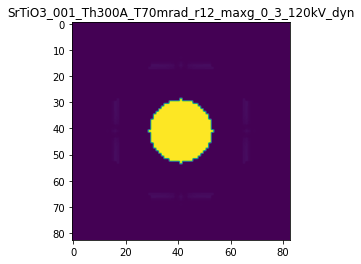

R-factor: 1.266245955546962e-06

>>> producing the 14. dataset...

The offset applied on thickness: 0.0009526904303828054

The offset applied on Ug: 0.14836825129751907

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9526904303828
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

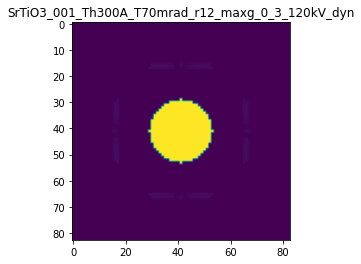

R-factor: 1.4519308316710792e-06

>>> producing the 15. dataset...

The offset applied on thickness: -8.719011674533861e-05

The offset applied on Ug: 0.105581277228599

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9128098832546
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

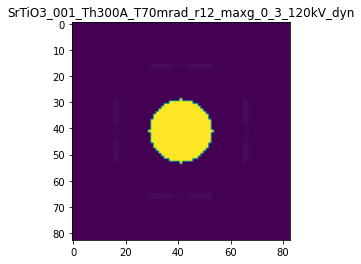

R-factor: 7.025244564427266e-07

>>> producing the 16. dataset...

The offset applied on thickness: 0.00011801876110191678

The offset applied on Ug: 0.16106813583150598

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1180187611019
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

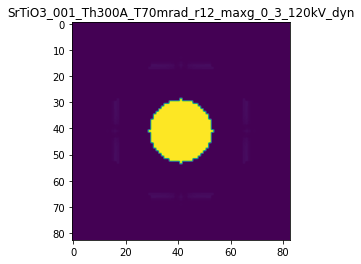

R-factor: 9.533203718315235e-07

>>> producing the 17. dataset...

The offset applied on thickness: 0.0008159208144079959

The offset applied on Ug: 0.009787266727756717

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.815920814408
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

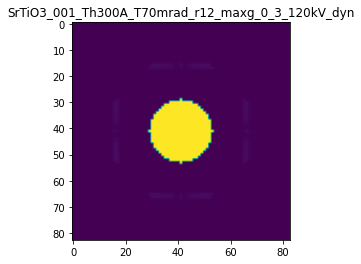

R-factor: 1.0385921701035636e-06

>>> producing the 18. dataset...

The offset applied on thickness: 0.0004426708605770413

The offset applied on Ug: -0.14132827481835372

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.44267086057704
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

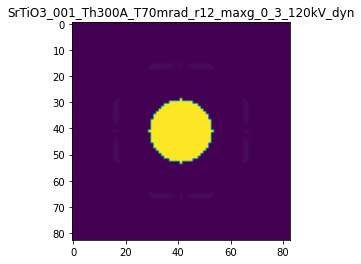

R-factor: 1.1995758277856658e-06

>>> producing the 19. dataset...

The offset applied on thickness: -0.0007414344331748097

The offset applied on Ug: -0.07521316035408908

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.25856556682515
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

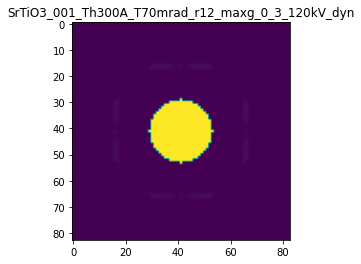

R-factor: 1.0471056640966046e-06

>>> producing the 20. dataset...

The offset applied on thickness: 0.0008069586527004476

The offset applied on Ug: -0.03701602171718392

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8069586527005
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

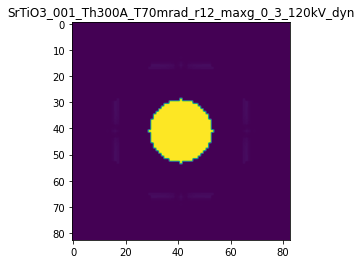

R-factor: 1.0749390264969148e-06

>>> producing the 21. dataset...

The offset applied on thickness: -0.000695718720011834

The offset applied on Ug: -0.07837454328751285

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3042812799882
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

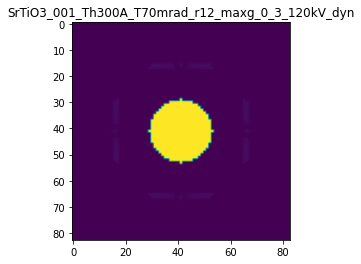

R-factor: 9.974433122688525e-07

>>> producing the 22. dataset...

The offset applied on thickness: 0.00016712599687261086

The offset applied on Ug: 0.22706359211371677

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.16712599687264
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

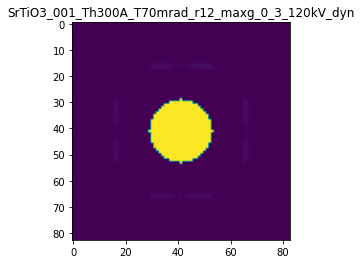

R-factor: 1.3441609747682107e-06

>>> producing the 23. dataset...

The offset applied on thickness: -0.0006164536190676409

The offset applied on Ug: -0.17745376757718795

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.38354638093233
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

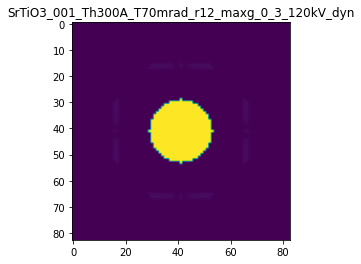

R-factor: 1.2614791048473916e-06

>>> producing the 24. dataset...

The offset applied on thickness: -7.613023290208921e-05

The offset applied on Ug: 0.03722558653791879

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.92386976709787
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

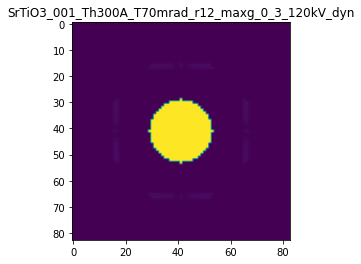

R-factor: 2.813320989233044e-07

>>> producing the 25. dataset...

The offset applied on thickness: 7.761415903627134e-05

The offset applied on Ug: -0.08866328975906888

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0776141590363
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

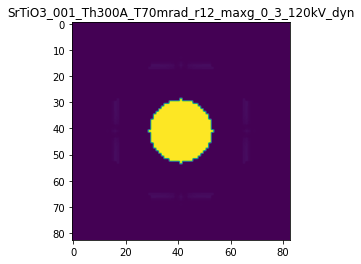

R-factor: 5.919101961772512e-07

>>> producing the 26. dataset...

The offset applied on thickness: 0.00011300387934166189

The offset applied on Ug: 0.051279842711264435

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.11300387934165
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

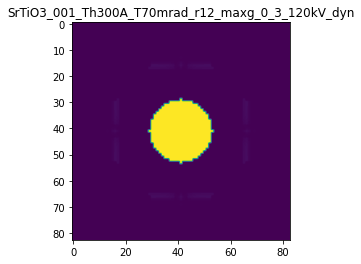

R-factor: 3.234267950217144e-07

>>> producing the 27. dataset...

The offset applied on thickness: 0.0003640187590069004

The offset applied on Ug: 0.008236171265720174

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.36401875900685
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

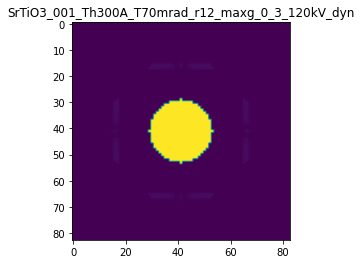

R-factor: 4.6822659373182856e-07

>>> producing the 28. dataset...

The offset applied on thickness: 0.00048161931663043945

The offset applied on Ug: 0.1953769108932419

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.48161931663043
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

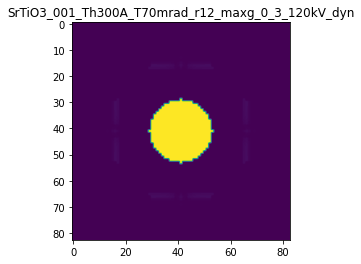

R-factor: 1.2599942174552572e-06

>>> producing the 29. dataset...

The offset applied on thickness: 0.000882322902303551

The offset applied on Ug: 0.2311942958003912

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.88232290230354
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

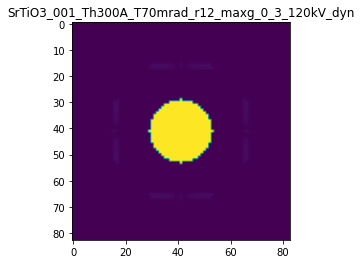

R-factor: 1.6949475308746537e-06

>>> producing the 30. dataset...

The offset applied on thickness: -0.0007974886340236196

The offset applied on Ug: 0.16754024770036857

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.20251136597636
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

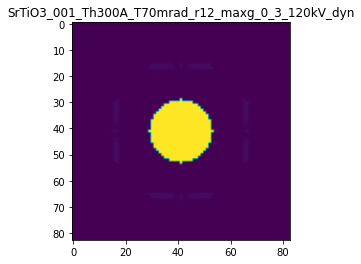

R-factor: 1.670008795499228e-06

>>> producing the 31. dataset...

The offset applied on thickness: -0.000993345958457007

The offset applied on Ug: 0.18331270547905207

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.00665404154296
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

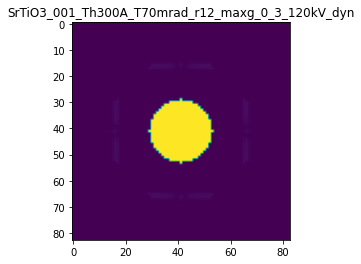

R-factor: 1.9431685135821335e-06

>>> producing the 32. dataset...

The offset applied on thickness: 0.0003901655893050995

The offset applied on Ug: -0.0866910915611281

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.39016558930507
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

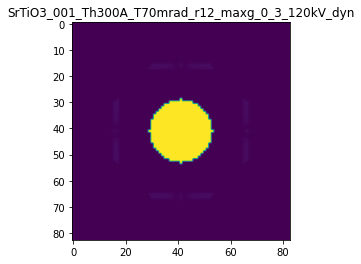

R-factor: 8.439461605248113e-07

>>> producing the 33. dataset...

The offset applied on thickness: 0.0006773684592243285

The offset applied on Ug: -0.14038188980316021

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.67736845922434
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

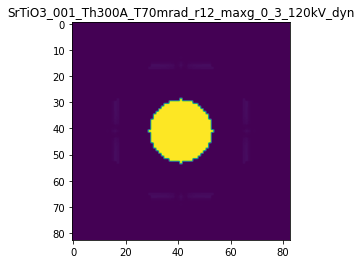

R-factor: 1.4109079695331218e-06

>>> producing the 34. dataset...

The offset applied on thickness: -0.0009061027515295373

The offset applied on Ug: -0.012733737052302558

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.09389724847045
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

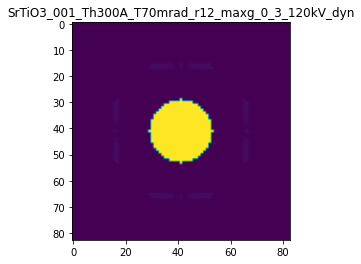

R-factor: 1.1516462232988681e-06

>>> producing the 35. dataset...

The offset applied on thickness: -0.0001284627670284657

The offset applied on Ug: -0.10505715988786378

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8715372329715
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

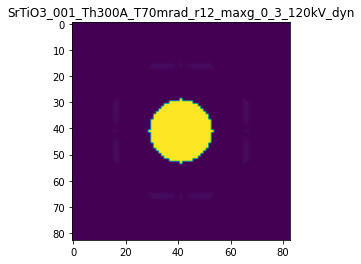

R-factor: 6.230392925084447e-07

>>> producing the 36. dataset...

The offset applied on thickness: 0.00043555025446105015

The offset applied on Ug: 0.13716674949398275

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4355502544611
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

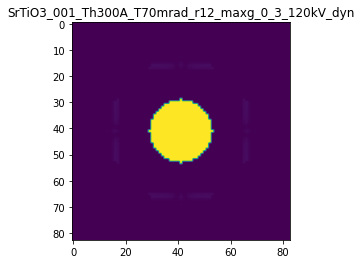

R-factor: 9.464843809284717e-07

>>> producing the 37. dataset...

The offset applied on thickness: -0.0006271989181683528

The offset applied on Ug: 0.2857145574987831

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3728010818316
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

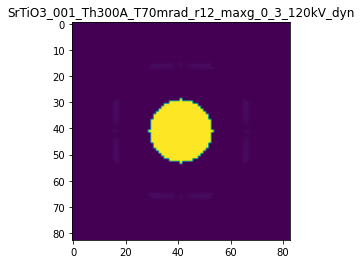

R-factor: 2.195759883608263e-06

>>> producing the 38. dataset...

The offset applied on thickness: -0.0007393235969631178

The offset applied on Ug: 0.08027737449778805

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2606764030369
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

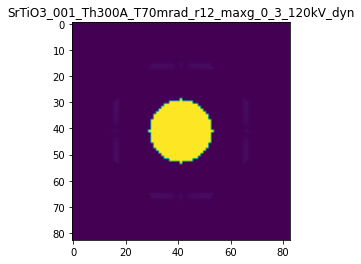

R-factor: 1.1621165518937403e-06

>>> producing the 39. dataset...

The offset applied on thickness: -9.455069271805838e-06

The offset applied on Ug: -0.27240273240257695

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.99054493072816
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

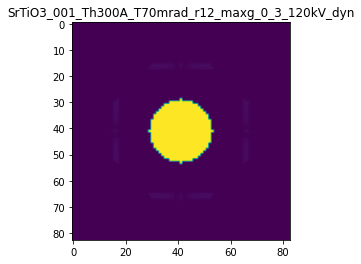

R-factor: 1.6604050284966205e-06

>>> producing the 40. dataset...

The offset applied on thickness: 0.0008606178076063043

The offset applied on Ug: 0.269671786991658

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.86061780760633
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

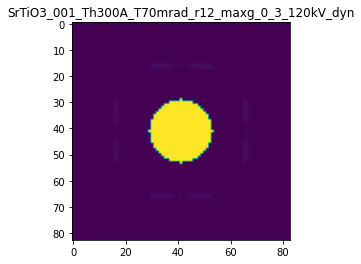

R-factor: 1.8619319385012065e-06

>>> producing the 41. dataset...

The offset applied on thickness: 0.0008481080977538416

The offset applied on Ug: 0.30759942066024537

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8481080977538
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

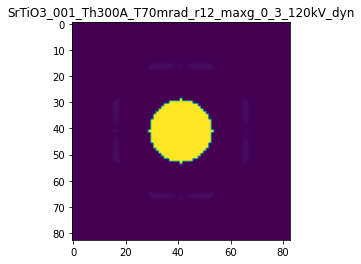

R-factor: 2.0379585780784468e-06

>>> producing the 42. dataset...

The offset applied on thickness: 0.0007596807409554165

The offset applied on Ug: 0.2983810437727212

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7596807409554
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

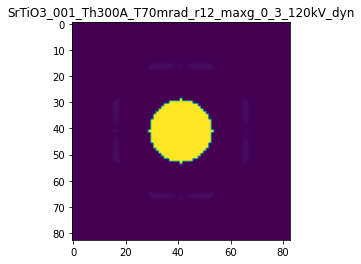

R-factor: 1.937273290033795e-06

>>> producing the 43. dataset...

The offset applied on thickness: -0.00043278371926959935

The offset applied on Ug: -0.20561852363048708

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5672162807304
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

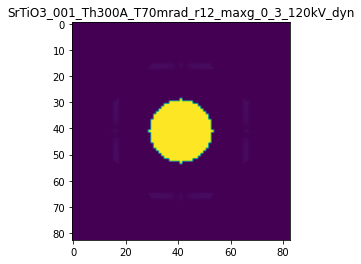

R-factor: 1.2882827256460176e-06

>>> producing the 44. dataset...

The offset applied on thickness: 0.0005783555593224559

The offset applied on Ug: 0.15781314807960925

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.57835555932246
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

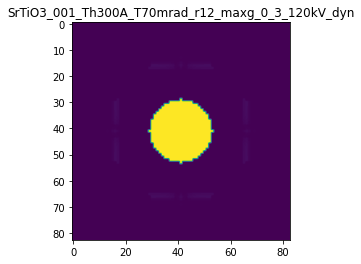

R-factor: 1.140926463991467e-06

>>> producing the 45. dataset...

The offset applied on thickness: -0.0002616141308861526

The offset applied on Ug: 0.0879146333560901

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7383858691138
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

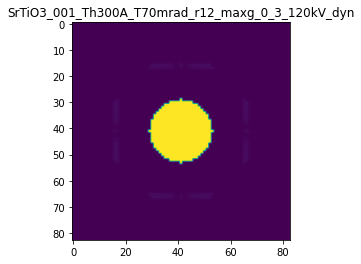

R-factor: 7.336747771214215e-07

>>> producing the 46. dataset...

The offset applied on thickness: 0.0009088849876259808

The offset applied on Ug: -0.12787692117260982

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.908884987626
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

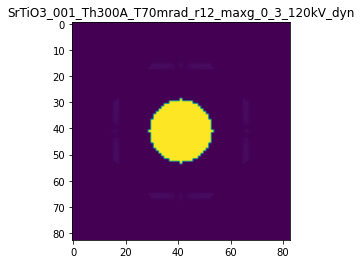

R-factor: 1.5748555792570807e-06

>>> producing the 47. dataset...

The offset applied on thickness: 5.772225914673768e-05

The offset applied on Ug: 0.18963651883384358

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0577222591467
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

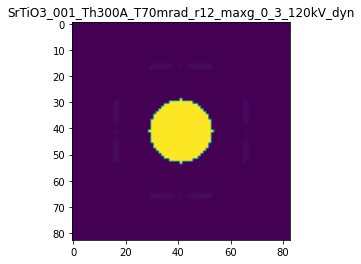

R-factor: 1.1395827235806159e-06

>>> producing the 48. dataset...

The offset applied on thickness: -0.0003737451948672026

The offset applied on Ug: 0.07067824887684694

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.62625480513276
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

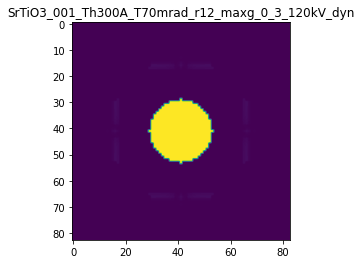

R-factor: 7.409517023774301e-07

>>> producing the 49. dataset...

The offset applied on thickness: 0.0004281837507729343

The offset applied on Ug: -0.14556224915947633

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4281837507729
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

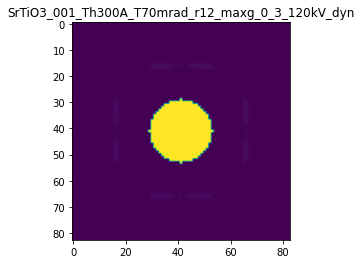

R-factor: 1.2107877603161868e-06

>>> producing the 50. dataset...

The offset applied on thickness: 7.195527325130292e-05

The offset applied on Ug: 0.15364170911137146

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0719552732513
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

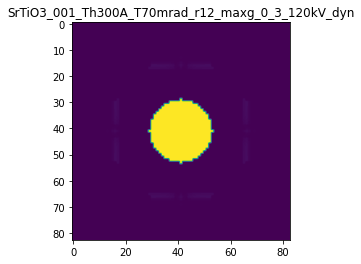

R-factor: 9.153809789542632e-07

>>> producing the 51. dataset...

The offset applied on thickness: 0.00012884752594016113

The offset applied on Ug: -0.2634292937929751

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.12884752594016
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

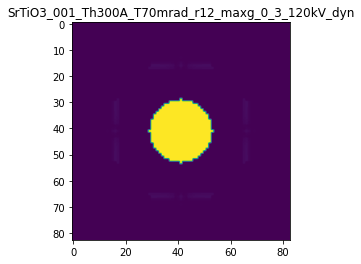

R-factor: 1.6877356169810532e-06

>>> producing the 52. dataset...

The offset applied on thickness: 0.0008200196045678689

The offset applied on Ug: 0.07928441071736181

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.82001960456785
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

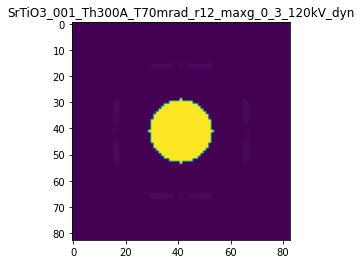

R-factor: 1.1521852063019243e-06

>>> producing the 53. dataset...

The offset applied on thickness: -0.0007902578417073341

The offset applied on Ug: -0.1499128923429977

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.20974215829267
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

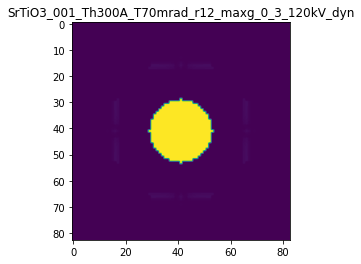

R-factor: 1.2816861589029828e-06

>>> producing the 54. dataset...

The offset applied on thickness: -0.0009951306416312057

The offset applied on Ug: 0.11950725946694327

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0048693583688
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

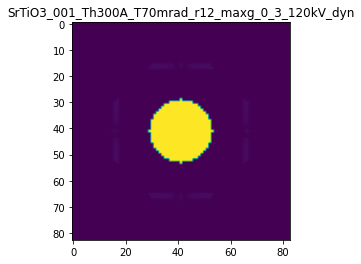

R-factor: 1.6170773482552404e-06

>>> producing the 55. dataset...

The offset applied on thickness: 0.0006653378996454016

The offset applied on Ug: -0.2084346520880588

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6653378996454
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

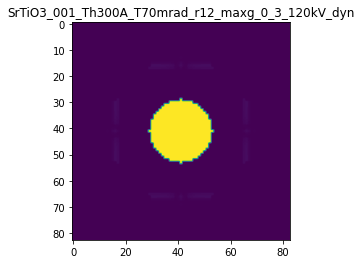

R-factor: 1.7805163399477467e-06

>>> producing the 56. dataset...

The offset applied on thickness: 0.000595737435886856

The offset applied on Ug: -0.1939045020881666

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.59573743588686
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

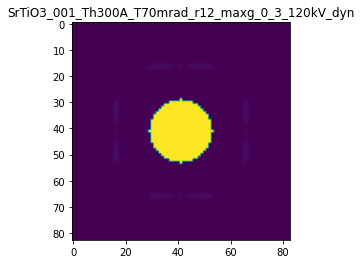

R-factor: 1.6355055666782929e-06

>>> producing the 57. dataset...

The offset applied on thickness: -0.000981349396925969

The offset applied on Ug: -0.1880061839293557

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.01865060307404
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

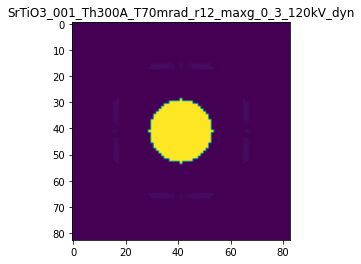

R-factor: 1.5976413333281097e-06

>>> producing the 58. dataset...

The offset applied on thickness: -6.294458262070557e-05

The offset applied on Ug: 0.3003693164140455

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9370554173793
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

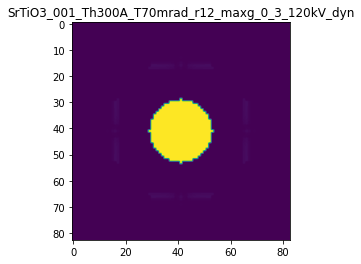

R-factor: 1.8865906236337177e-06

>>> producing the 59. dataset...

The offset applied on thickness: -0.0004570340491688874

The offset applied on Ug: 0.18201261055383214

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5429659508311
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

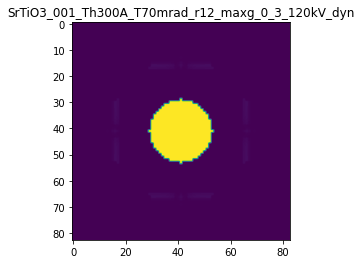

R-factor: 1.4467712725003128e-06

>>> producing the 60. dataset...

The offset applied on thickness: 0.0008449487443205894

The offset applied on Ug: 0.10950025782178287

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.84494874432056
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

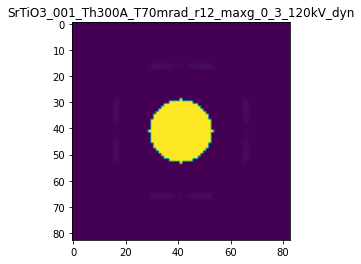

R-factor: 1.237703064010138e-06

>>> producing the 61. dataset...

The offset applied on thickness: -0.0008271726399489065

The offset applied on Ug: 0.13502757594900403

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1728273600511
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

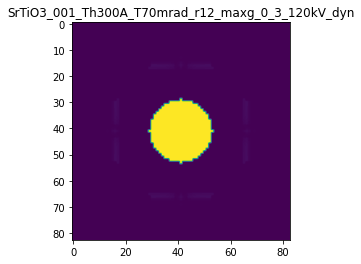

R-factor: 1.5245902003147583e-06

>>> producing the 62. dataset...

The offset applied on thickness: 0.00042658680940381476

The offset applied on Ug: -0.009070293206293626

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.42658680940383
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

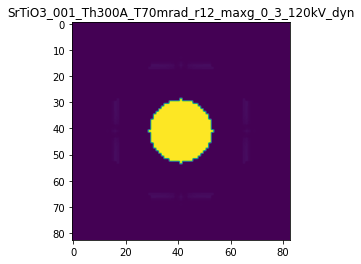

R-factor: 5.438150102081784e-07

>>> producing the 63. dataset...

The offset applied on thickness: -0.00047338873143018366

The offset applied on Ug: -0.09087010927861101

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5266112685698
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

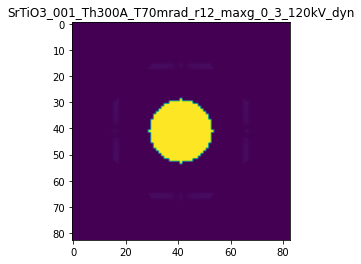

R-factor: 7.70656590966986e-07

>>> producing the 64. dataset...

The offset applied on thickness: -0.000944916090260453

The offset applied on Ug: 0.3143617213996598

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.05508390973955
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

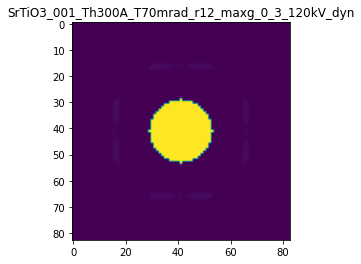

R-factor: 2.630596926144369e-06

>>> producing the 65. dataset...

The offset applied on thickness: -0.0001818590302974241

The offset applied on Ug: -0.15298968527902213

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.81814096970254
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

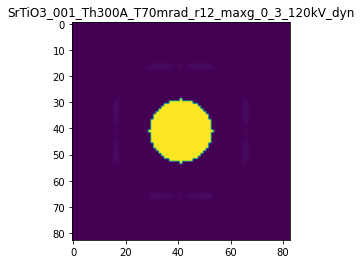

R-factor: 9.062933167452211e-07

>>> producing the 66. dataset...

The offset applied on thickness: -0.0008461206948303211

The offset applied on Ug: -0.00014051807303502528

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.15387930516965
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_f

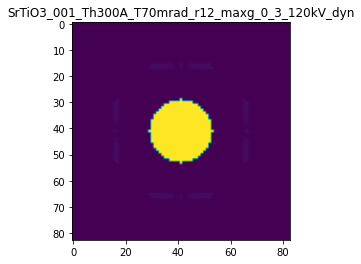

R-factor: 1.0639533662542208e-06

>>> producing the 67. dataset...

The offset applied on thickness: -0.0006678885605113094

The offset applied on Ug: -0.1959005723312049

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3321114394887
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

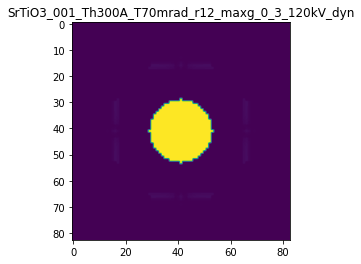

R-factor: 1.3842952867149266e-06

>>> producing the 68. dataset...

The offset applied on thickness: 0.0002470063541593992

The offset applied on Ug: 0.0674020866439372

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2470063541594
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

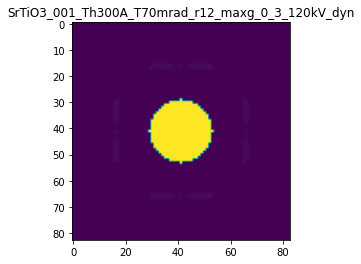

R-factor: 4.874594347612992e-07

>>> producing the 69. dataset...

The offset applied on thickness: 0.0008236693515343287

The offset applied on Ug: -0.009118230991397098

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8236693515343
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

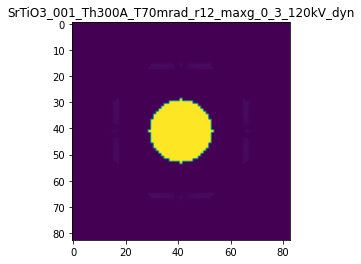

R-factor: 1.041301880033589e-06

>>> producing the 70. dataset...

The offset applied on thickness: -0.00026534838159322695

The offset applied on Ug: -0.2404366527871852

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7346516184068
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

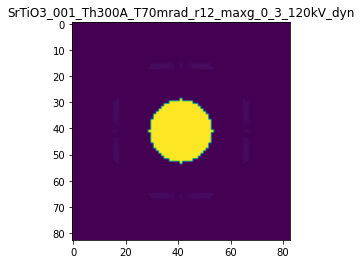

R-factor: 1.4203483992764424e-06

>>> producing the 71. dataset...

The offset applied on thickness: -0.0005555358778116297

The offset applied on Ug: -0.1590668336004164

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4444641221883
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

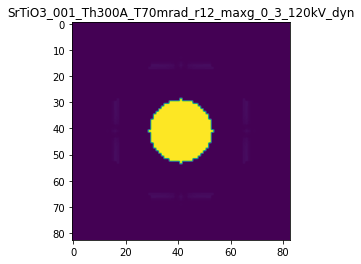

R-factor: 1.1326924441824777e-06

>>> producing the 72. dataset...

The offset applied on thickness: 0.0004812077536828845

The offset applied on Ug: -0.25763370690950266

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.48120775368284
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

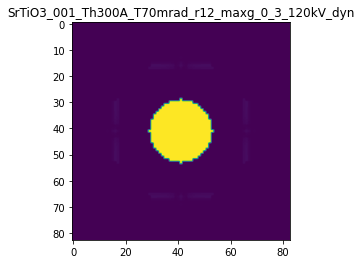

R-factor: 1.9073550849310487e-06

>>> producing the 73. dataset...

The offset applied on thickness: 0.0005166245625909054

The offset applied on Ug: -0.06546838910698874

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5166245625909
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

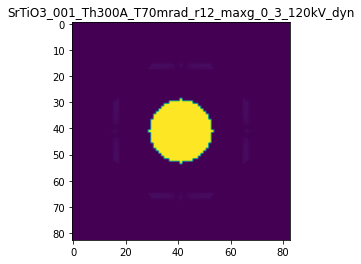

R-factor: 8.586628594777664e-07

>>> producing the 74. dataset...

The offset applied on thickness: 0.0009861498688331454

The offset applied on Ug: 0.035638132165554524

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.98614986883314
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

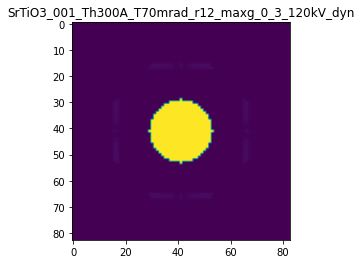

R-factor: 1.2883768228669808e-06

>>> producing the 75. dataset...

The offset applied on thickness: -0.00020226757034296305

The offset applied on Ug: -0.08268712685987033

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.797732429657
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

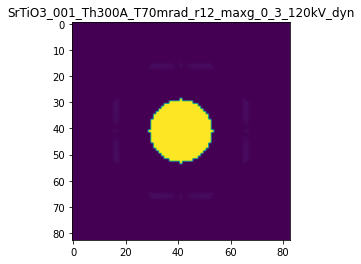

R-factor: 5.336293340531931e-07

>>> producing the 76. dataset...

The offset applied on thickness: 0.0008667214632200133

The offset applied on Ug: 0.05967513096532556

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.86672146322
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

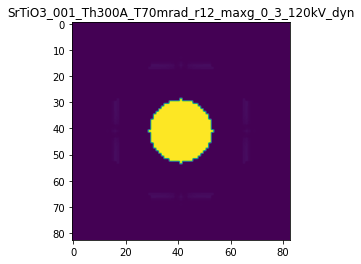

R-factor: 1.1760254863078086e-06

>>> producing the 77. dataset...

The offset applied on thickness: -0.0002559768987205977

The offset applied on Ug: 0.04493208690481076

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7440231012794
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

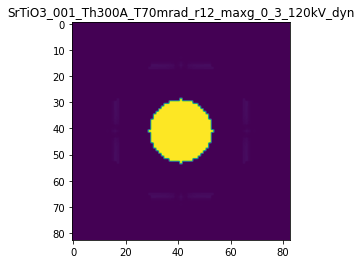

R-factor: 4.889388857175482e-07

>>> producing the 78. dataset...

The offset applied on thickness: -0.0009172961095618964

The offset applied on Ug: -0.12044840289973173

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0827038904381
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

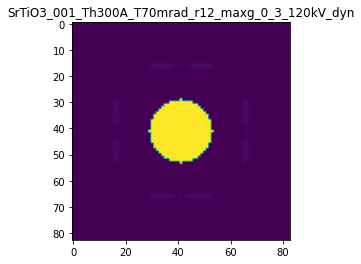

R-factor: 1.3484221423070168e-06

>>> producing the 79. dataset...

The offset applied on thickness: -0.0009541443452173088

The offset applied on Ug: -0.251339628053046

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0458556547827
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

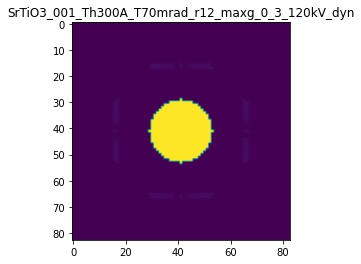

R-factor: 1.8401893749285344e-06

>>> producing the 80. dataset...

The offset applied on thickness: 0.00011392018976040209

The offset applied on Ug: 0.0911949394324256

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1139201897604
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

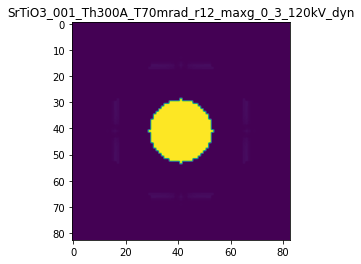

R-factor: 5.411622579012958e-07

>>> producing the 81. dataset...

The offset applied on thickness: -0.0004968445389670018

The offset applied on Ug: -0.15013156723351742

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.50315546103303
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

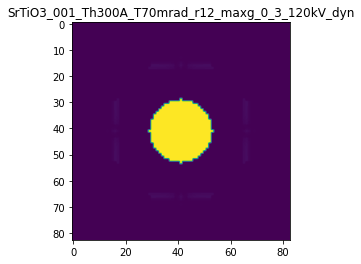

R-factor: 1.050833039545875e-06

>>> producing the 82. dataset...

The offset applied on thickness: -0.00019715870170303429

The offset applied on Ug: -0.19222125182546507

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8028412982969
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

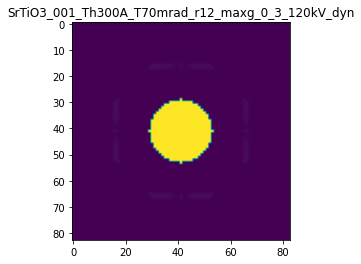

R-factor: 1.1337280762939827e-06

>>> producing the 83. dataset...

The offset applied on thickness: -0.0005140229007893129

The offset applied on Ug: 0.06475540131469792

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.48597709921063
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

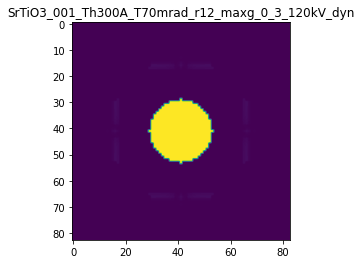

R-factor: 8.507647249530499e-07

>>> producing the 84. dataset...

The offset applied on thickness: -0.0005324124486758182

The offset applied on Ug: 0.22722316079805352

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4675875513242
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

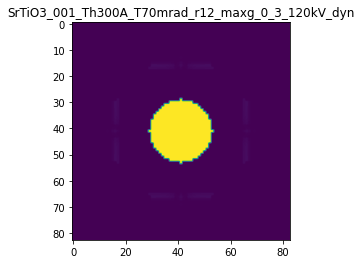

R-factor: 1.7741839122507999e-06

>>> producing the 85. dataset...

The offset applied on thickness: -0.0005252394898190698

The offset applied on Ug: 0.1688147806000496

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4747605101809
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

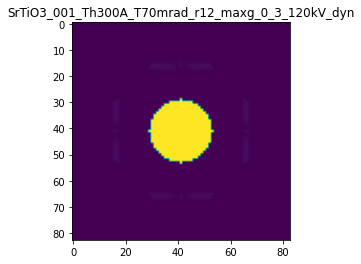

R-factor: 1.42889537698942e-06

>>> producing the 86. dataset...

The offset applied on thickness: -0.0007150268587375837

The offset applied on Ug: 0.1907001128232195

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2849731412624
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

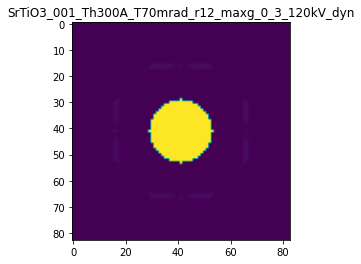

R-factor: 1.722769477781288e-06

>>> producing the 87. dataset...

The offset applied on thickness: -5.257667676199707e-05

The offset applied on Ug: -0.14862400680517837

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.94742332323796
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

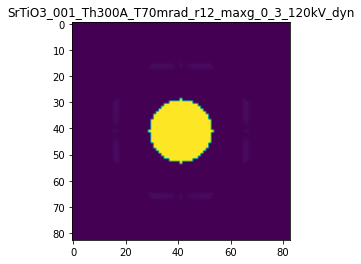

R-factor: 8.873704079189388e-07

>>> producing the 88. dataset...

The offset applied on thickness: 0.0009111709706178397

The offset applied on Ug: -0.10169368484738449

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.91117097061783
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

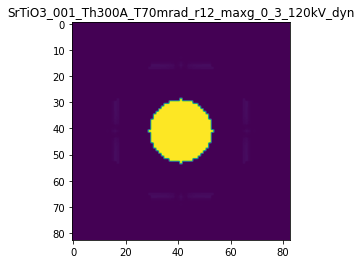

R-factor: 1.4492115219492618e-06

>>> producing the 89. dataset...

The offset applied on thickness: 0.00013429666656288174

The offset applied on Ug: 0.25438459943464004

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1342966665629
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

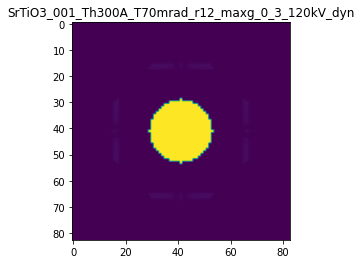

R-factor: 1.5135385036880423e-06

>>> producing the 90. dataset...

The offset applied on thickness: -0.00013807577826721086

The offset applied on Ug: 0.09344040927006099

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8619242217328
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

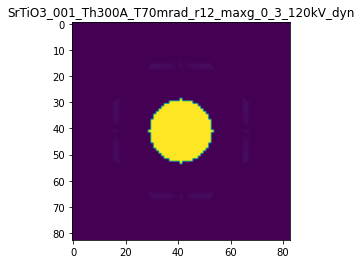

R-factor: 6.64572402853499e-07

>>> producing the 91. dataset...

The offset applied on thickness: -0.0003081068056258884

The offset applied on Ug: -0.06865248159685379

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.69189319437413
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

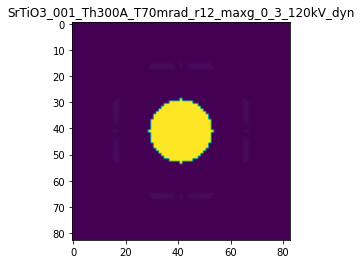

R-factor: 5.377804868636224e-07

>>> producing the 92. dataset...

The offset applied on thickness: 0.0006882595825042386

The offset applied on Ug: 0.043040199107320445

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6882595825042
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

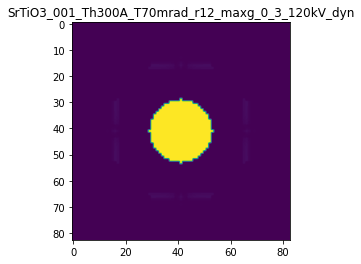

R-factor: 9.261001859931436e-07

>>> producing the 93. dataset...

The offset applied on thickness: 0.000288375936519105

The offset applied on Ug: -0.20821294807672985

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.28837593651906
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

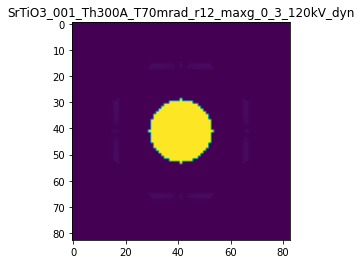

R-factor: 1.4638783292488235e-06

>>> producing the 94. dataset...

The offset applied on thickness: 0.0007598056711253811

The offset applied on Ug: 0.06648288092142529

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7598056711254
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

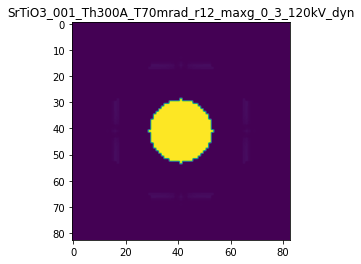

R-factor: 1.0553901719523523e-06

>>> producing the 95. dataset...

The offset applied on thickness: -0.0008078328874773224

The offset applied on Ug: 0.319857846819577

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.19216711252267
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

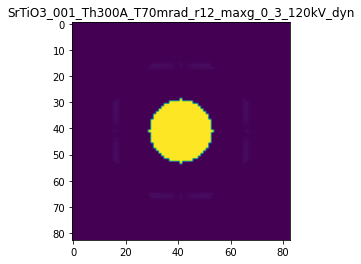

R-factor: 2.5461638434072887e-06

>>> producing the 96. dataset...

The offset applied on thickness: -0.0009408962454279229

The offset applied on Ug: -0.27166584662846205

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.05910375457205
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

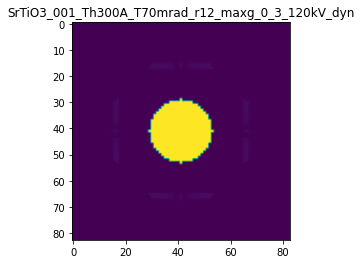

R-factor: 1.92952182201787e-06

>>> producing the 97. dataset...

The offset applied on thickness: 0.0008953749542774631

The offset applied on Ug: 0.16306135089214074

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.89537495427743
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

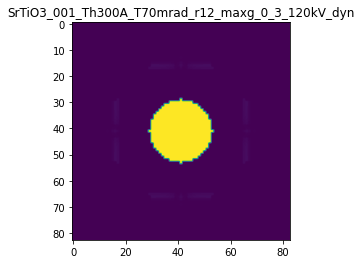

R-factor: 1.428651283222079e-06

>>> producing the 98. dataset...

The offset applied on thickness: -0.0006990811131043597

The offset applied on Ug: 0.17499892745104595

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.30091888689566
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

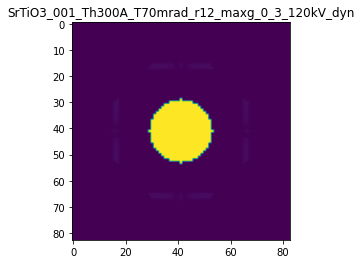

R-factor: 1.619745819791121e-06

>>> producing the 99. dataset...

The offset applied on thickness: 0.00027625548613981253

The offset applied on Ug: 0.12213280412671033

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2762554861398
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

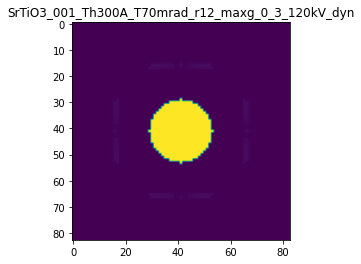

R-factor: 7.736552308055209e-07

>>> producing the 100. dataset...

The offset applied on thickness: 0.0005021012734190855

The offset applied on Ug: 0.19178231192464246

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5021012734191
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

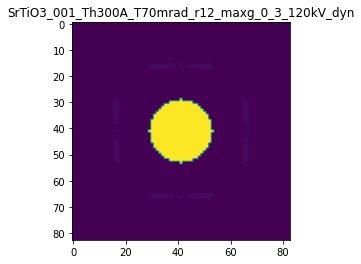

R-factor: 1.2552546625750798e-06

>>> producing the 101. dataset...

The offset applied on thickness: 0.00037580670887888746

The offset applied on Ug: -0.1446196837857871

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3758067088789
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

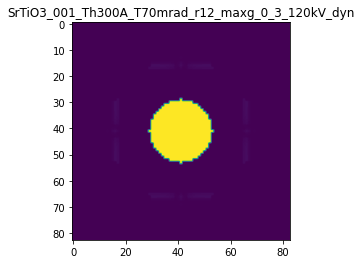

R-factor: 1.1602538856073932e-06

>>> producing the 102. dataset...

The offset applied on thickness: -0.0008483130321333263

The offset applied on Ug: -0.15237495909460222

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1516869678666
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

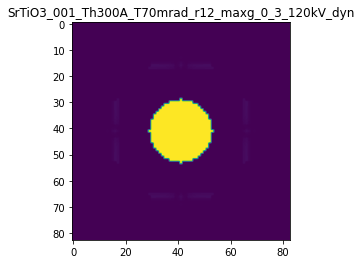

R-factor: 1.350783968855252e-06

>>> producing the 103. dataset...

The offset applied on thickness: 0.00045938694359154875

The offset applied on Ug: 0.24343749435197132

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.45938694359154
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

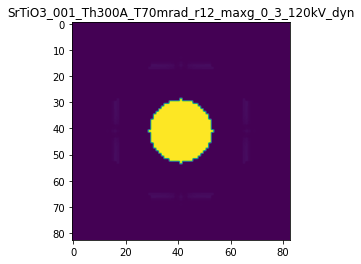

R-factor: 1.496218184363422e-06

>>> producing the 104. dataset...

The offset applied on thickness: -0.0007320239159597373

The offset applied on Ug: -0.028764453163789484

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.26797608404024
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

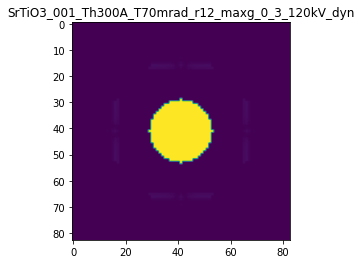

R-factor: 9.563264279579188e-07

>>> producing the 105. dataset...

The offset applied on thickness: 0.0004070230924720704

The offset applied on Ug: 0.20897162635500535

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.40702309247206
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

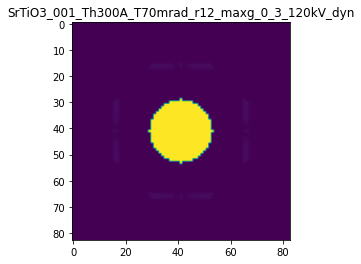

R-factor: 1.2896039545492435e-06

>>> producing the 106. dataset...

The offset applied on thickness: 0.0007183566151568984

The offset applied on Ug: -0.041085673460836816

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7183566151569
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

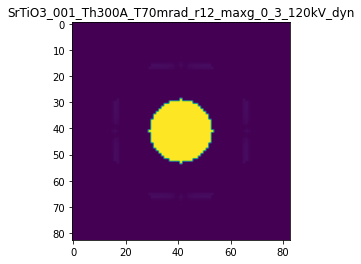

R-factor: 9.827138811186104e-07

>>> producing the 107. dataset...

The offset applied on thickness: -8.046527661990432e-05

The offset applied on Ug: -0.1979882716481984

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9195347233801
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

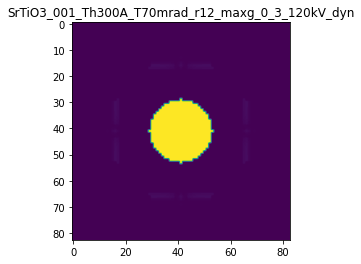

R-factor: 1.1789174002801484e-06

>>> producing the 108. dataset...

The offset applied on thickness: -0.0008915626419561961

The offset applied on Ug: 0.16209040436635974

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1084373580438
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

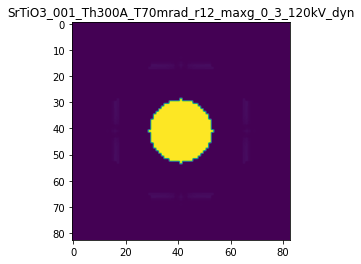

R-factor: 1.731244921065017e-06

>>> producing the 109. dataset...

The offset applied on thickness: -0.0007172850413994196

The offset applied on Ug: -0.1582157261612029

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2827149586006
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

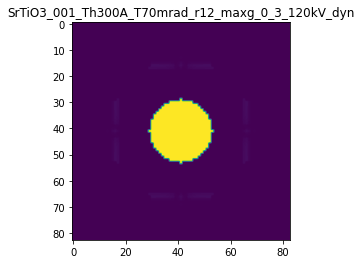

R-factor: 1.2449282723317879e-06

>>> producing the 110. dataset...

The offset applied on thickness: 9.351366510258696e-05

The offset applied on Ug: -0.2451349760982952

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.09351366510253
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

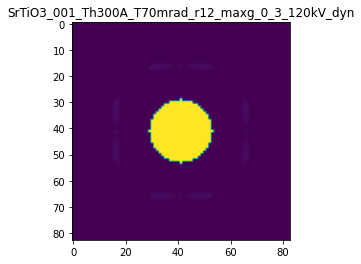

R-factor: 1.554002573089838e-06

>>> producing the 111. dataset...

The offset applied on thickness: 0.00012579123509478364

The offset applied on Ug: -0.29933955251253197

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.12579123509477
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

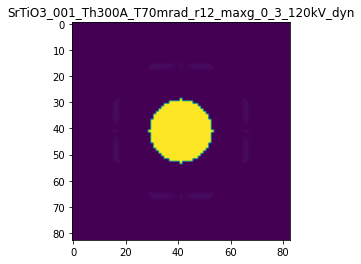

R-factor: 1.9035770431677012e-06

>>> producing the 112. dataset...

The offset applied on thickness: -0.0006722780333492316

The offset applied on Ug: -0.19223443542223373

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.32772196665076
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

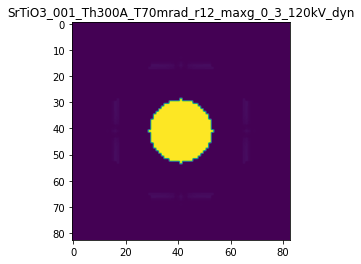

R-factor: 1.369541131612626e-06

>>> producing the 113. dataset...

The offset applied on thickness: -0.00016780918819330926

The offset applied on Ug: -0.04627289460397023

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8321908118067
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

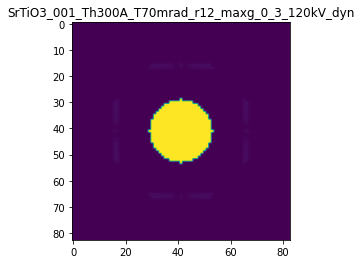

R-factor: 3.3353729959449114e-07

>>> producing the 114. dataset...

The offset applied on thickness: 0.0007935493832783232

The offset applied on Ug: 0.2563418184425376

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7935493832783
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

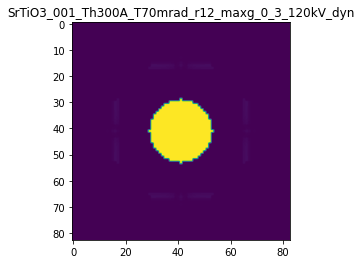

R-factor: 1.7537529222353815e-06

>>> producing the 115. dataset...

The offset applied on thickness: -0.00042500713743935095

The offset applied on Ug: 0.0012115444310940404

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.57499286256063
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_

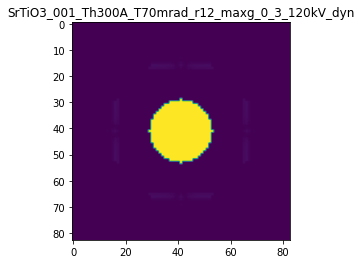

R-factor: 5.351445347762019e-07

>>> producing the 116. dataset...

The offset applied on thickness: 0.0006790618646260447

The offset applied on Ug: -0.048716686154576506

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.679061864626
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

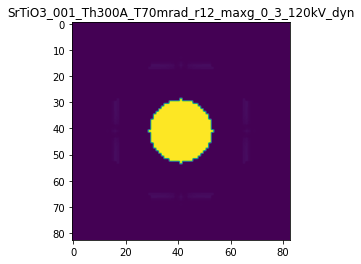

R-factor: 9.679222305486125e-07

>>> producing the 117. dataset...

The offset applied on thickness: -0.0004618876375299157

The offset applied on Ug: -0.21101182217577438

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5381123624701
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

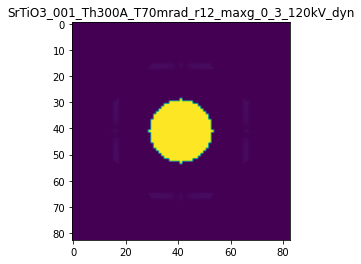

R-factor: 1.3314673350130988e-06

>>> producing the 118. dataset...

The offset applied on thickness: -0.0007529023551540262

The offset applied on Ug: -0.00688182448085712

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.24709764484595
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

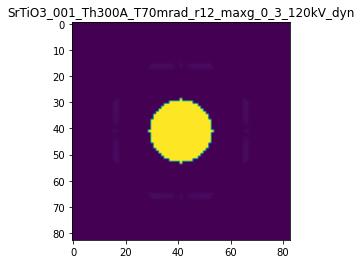

R-factor: 9.530625939690689e-07

>>> producing the 119. dataset...

The offset applied on thickness: -0.0006718211403115174

The offset applied on Ug: -0.0013642199958982814

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3281788596885
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

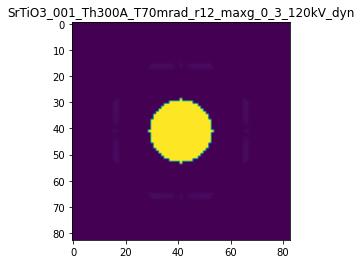

R-factor: 8.459727560149653e-07

>>> producing the 120. dataset...

The offset applied on thickness: 0.000569469199521069

The offset applied on Ug: 0.2714153276339305

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.56946919952105
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

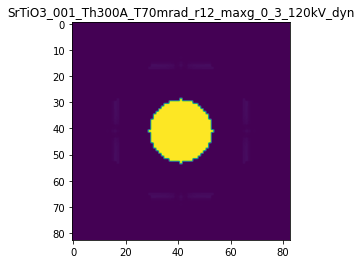

R-factor: 1.6927933227645949e-06

>>> producing the 121. dataset...

The offset applied on thickness: 0.0005034565790479087

The offset applied on Ug: 0.1526660889881061

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5034565790479
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

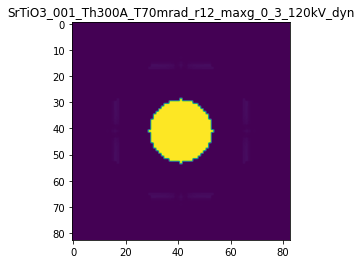

R-factor: 1.0659085082049777e-06

>>> producing the 122. dataset...

The offset applied on thickness: 3.3155318400577284e-06

The offset applied on Ug: 0.2114141602983434

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0033155318401
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

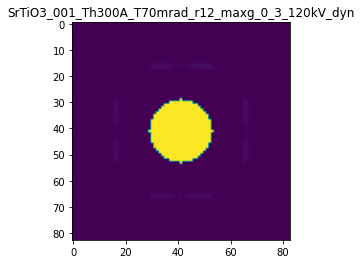

R-factor: 1.3005249157484522e-06

>>> producing the 123. dataset...

The offset applied on thickness: 0.00024318187651900769

The offset applied on Ug: -0.0702626181657861

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.243181876519
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

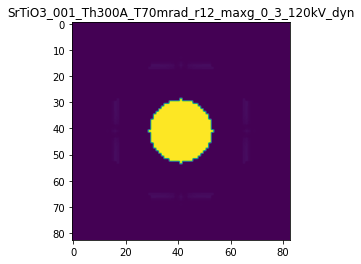

R-factor: 6.170423503771653e-07

>>> producing the 124. dataset...

The offset applied on thickness: 0.0006976276865452204

The offset applied on Ug: -0.07313589831056945

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6976276865452
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

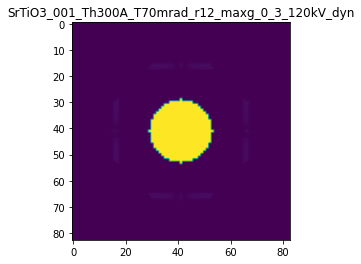

R-factor: 1.088088854598348e-06

>>> producing the 125. dataset...

The offset applied on thickness: -0.000837921374640636

The offset applied on Ug: -0.05693595693453162

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.16207862535936
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

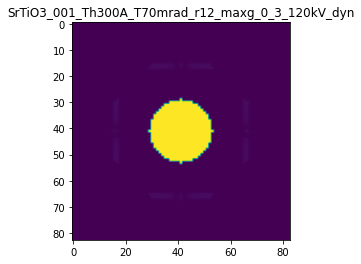

R-factor: 1.1324454376687428e-06

>>> producing the 126. dataset...

The offset applied on thickness: -0.0004327963242155892

The offset applied on Ug: 0.19933114889902065

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.56720367578436
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

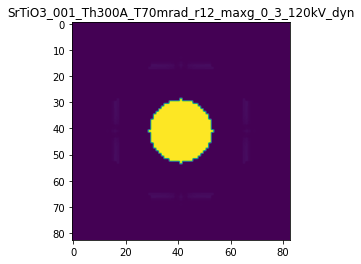

R-factor: 1.5278232267179993e-06

>>> producing the 127. dataset...

The offset applied on thickness: 0.0004613187579846836

The offset applied on Ug: 0.2584836998005969

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.46131875798466
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

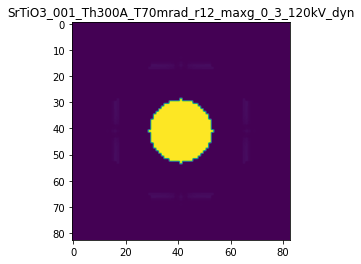

R-factor: 1.5781756780040573e-06

>>> producing the 128. dataset...

The offset applied on thickness: -0.00015013386496386794

The offset applied on Ug: 0.09173057819627232

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8498661350361
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

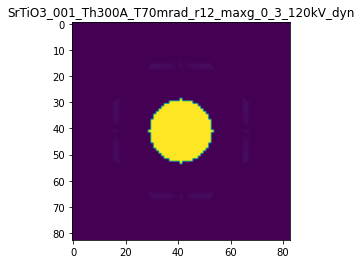

R-factor: 6.633976277914792e-07

>>> producing the 129. dataset...

The offset applied on thickness: -0.00026117071071252076

The offset applied on Ug: -0.0925014123260791

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7388292892875
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

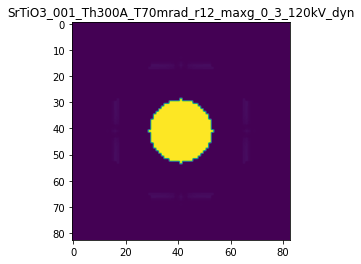

R-factor: 6.185211001163601e-07

>>> producing the 130. dataset...

The offset applied on thickness: -0.00041493543383884577

The offset applied on Ug: 0.268220236958905

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5850645661611
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

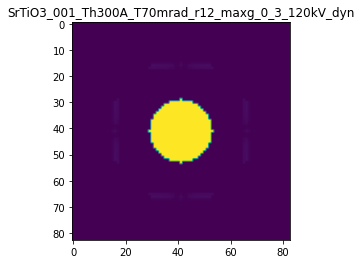

R-factor: 1.9230580297978415e-06

>>> producing the 131. dataset...

The offset applied on thickness: -0.0009724168602507446

The offset applied on Ug: -0.10813220433372735

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.02758313974925
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

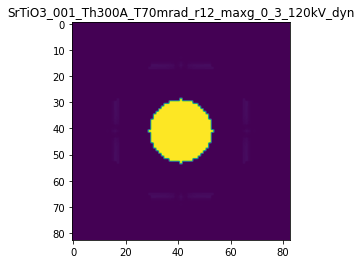

R-factor: 1.3914745513944796e-06

>>> producing the 132. dataset...

The offset applied on thickness: -0.0007119704071006893

The offset applied on Ug: 0.24274683292015817

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2880295928993
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

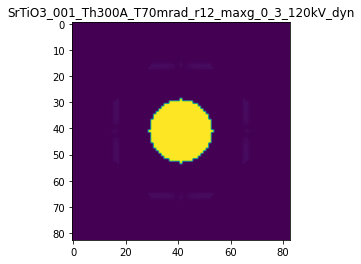

R-factor: 2.016227765689398e-06

>>> producing the 133. dataset...

The offset applied on thickness: 0.0008159123826968993

The offset applied on Ug: 0.2997114404715979

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.81591238269687
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

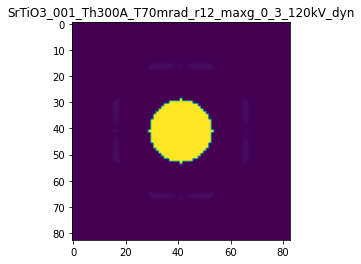

R-factor: 1.9791998925853807e-06

>>> producing the 134. dataset...

The offset applied on thickness: -0.0003015032386482026

The offset applied on Ug: -0.06713197035325394

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6984967613518
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

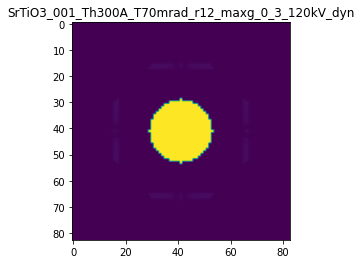

R-factor: 5.260495897247457e-07

>>> producing the 135. dataset...

The offset applied on thickness: 0.0009500129043723964

The offset applied on Ug: 0.29720446674068385

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9500129043724
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

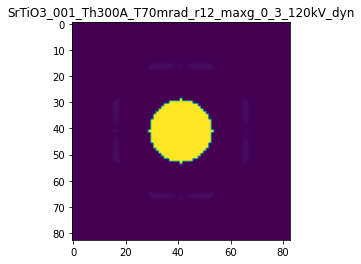

R-factor: 2.052749009625166e-06

>>> producing the 136. dataset...

The offset applied on thickness: -0.000606088139357182

The offset applied on Ug: 0.1587807587010115

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3939118606428
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

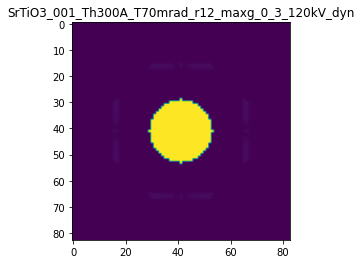

R-factor: 1.4442811137352257e-06

>>> producing the 137. dataset...

The offset applied on thickness: -0.00021514810792808126

The offset applied on Ug: 0.3089637978657958

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7848518920719
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

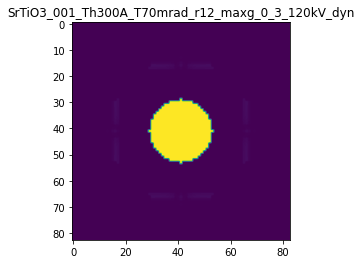

R-factor: 2.0329636147917994e-06

>>> producing the 138. dataset...

The offset applied on thickness: 0.00048539011016057065

The offset applied on Ug: -0.03123490029873821

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.48539011016055
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

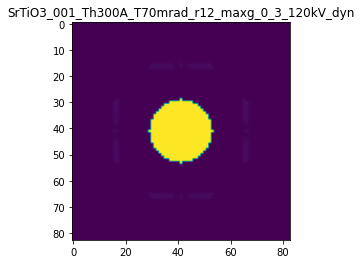

R-factor: 6.773734774871766e-07

>>> producing the 139. dataset...

The offset applied on thickness: -0.0003662101857793287

The offset applied on Ug: 0.07117084235328398

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6337898142207
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

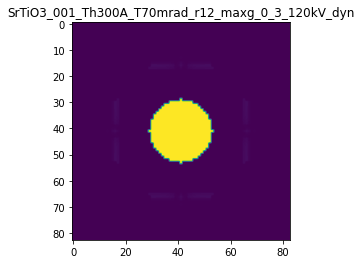

R-factor: 7.363117280025901e-07

>>> producing the 140. dataset...

The offset applied on thickness: -0.0009104819077913473

The offset applied on Ug: -0.04752042274964161

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0895180922086
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

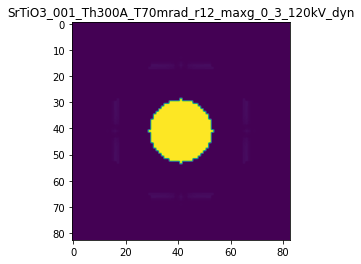

R-factor: 1.205889559842487e-06



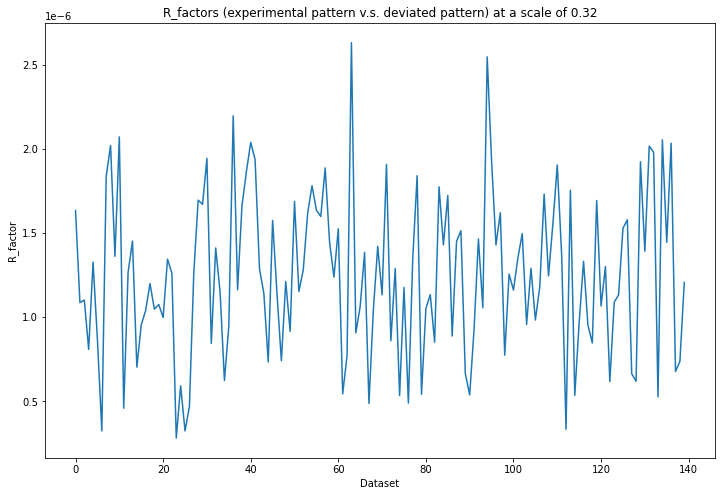

>>> start to train the ANN 

Epoch 1/30
5/5 [==============================] - 1s 133ms/step - loss: 0.3618 - acc: 0.8000 - val_loss: 0.3559 - val_acc: 1.0000
Epoch 2/30
5/5 [==============================] - 1s 108ms/step - loss: 0.3409 - acc: 1.0000 - val_loss: 0.3172 - val_acc: 1.0000
Epoch 3/30
5/5 [==============================] - 1s 109ms/step - loss: 0.2968 - acc: 1.0000 - val_loss: 0.2585 - val_acc: 1.0000
Epoch 4/30
5/5 [==============================] - 1s 108ms/step - loss: 0.2590 - acc: 1.0000 - val_loss: 0.2255 - val_acc: 1.0000
Epoch 5/30
5/5 [==============================] - 1s 109ms/step - loss: 0.2043 - acc: 1.0000 - val_loss: 0.1811 - val_acc: 1.0000
Epoch 6/30
5/5 [==============================] - 1s 109ms/step - loss: 0.1597 - acc: 1.0000 - val_loss: 0.1319 - val_acc: 1.0000
Epoch 7/30
5/5 [==============================] - 1s 109ms/step - loss: 0.1219 - acc: 1.0000 - val_loss: 0.1049 - val_acc: 1.0000
Epoch 8/30
5/5 [==============================] - 1s 109ms/st

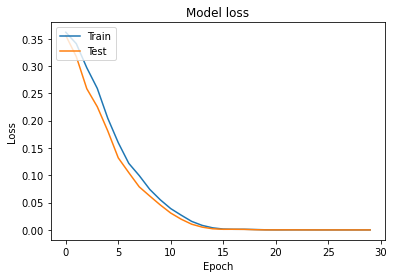

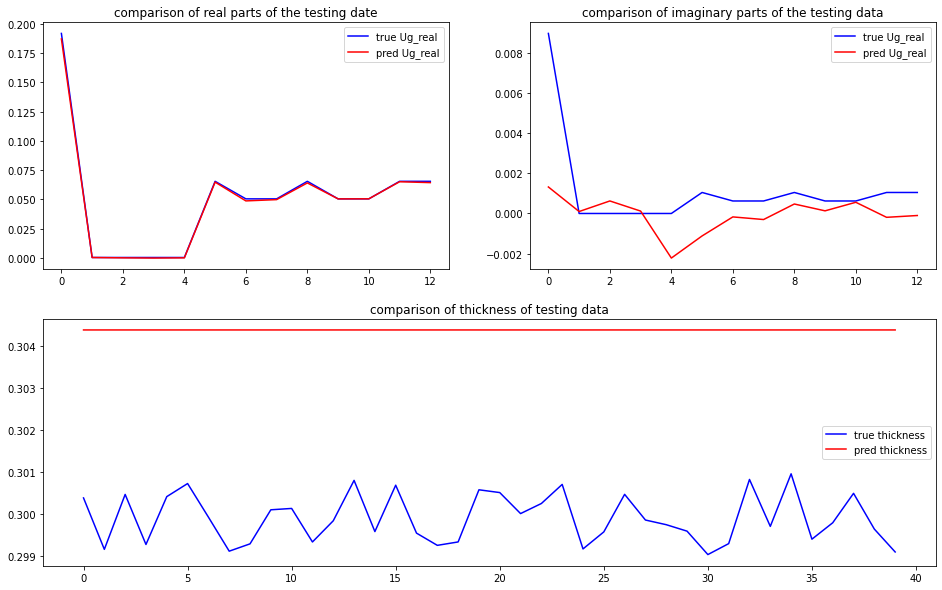

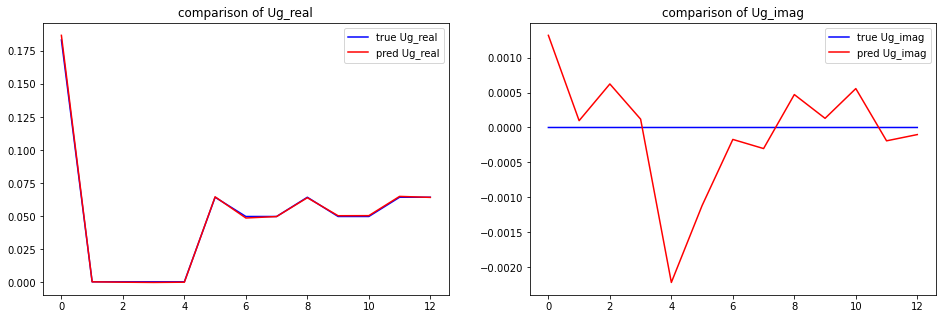

predicted thickness: 30.4375022649765 nm
mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=304.375022649765
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 13 different beams

InputUg:
[1.87045768e-01+0.00000000e+00j 3.

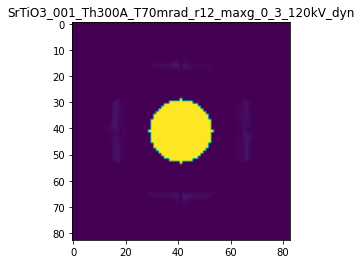

X_sim.max(): 0.9999943214015055
R-factor at a scale of 0.32 is 0.00023350265304895656.

-----------------------------------------------------------------------------------------------------

>>> start to produce Dataset at a scale of 0.64

-----------------------------------------------------------------------------------------------------

>>> producing the 1. dataset...

The offset applied on thickness: -0.0005377327910980891

The offset applied on Ug: -0.464863110804163

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001


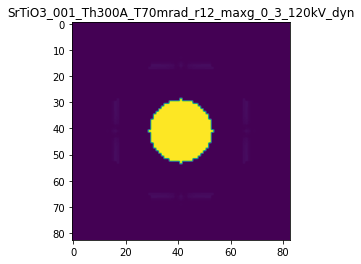

R-factor: 2.750803856172655e-06

>>> producing the 2. dataset...

The offset applied on thickness: -0.0008645414832772338

The offset applied on Ug: -0.07425274773626114

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.13545851672274
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

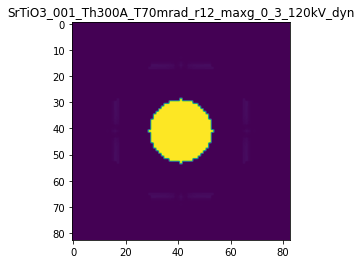

R-factor: 1.195891434472189e-06

>>> producing the 3. dataset...

The offset applied on thickness: -0.0007421181921894809

The offset applied on Ug: -0.28855547350772126

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.25788180781046
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

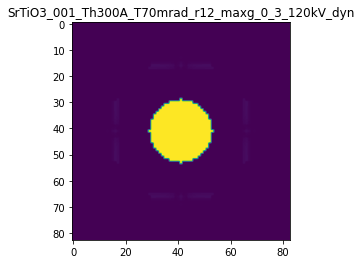

R-factor: 1.8869227947740627e-06

>>> producing the 4. dataset...

The offset applied on thickness: -0.00023358047032057038

The offset applied on Ug: 0.36083389646202224

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7664195296794
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

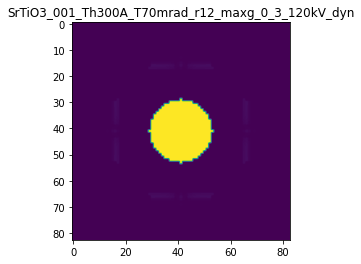

R-factor: 2.363904959417009e-06

>>> producing the 5. dataset...

The offset applied on thickness: 0.0008093223564927794

The offset applied on Ug: -0.2909997024414618

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.80932235649277
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

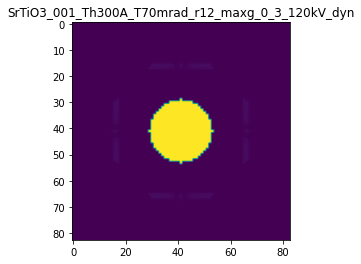

R-factor: 2.379911965936033e-06

>>> producing the 6. dataset...

The offset applied on thickness: 0.0006156893496561143

The offset applied on Ug: -0.06168839111471598

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6156893496561
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

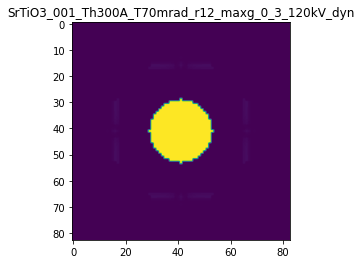

R-factor: 9.48347999277719e-07

>>> producing the 7. dataset...

The offset applied on thickness: -0.0004153425911730635

The offset applied on Ug: -0.10782401114954283

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.58465740882696
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

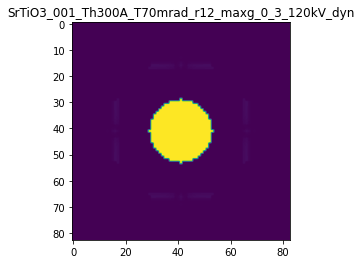

R-factor: 7.934754872974463e-07

>>> producing the 8. dataset...

The offset applied on thickness: 0.00025142222367279855

The offset applied on Ug: -0.4287045547715205

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2514222236728
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

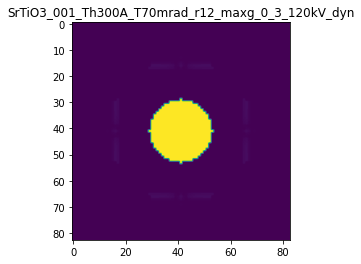

R-factor: 2.7682099469552625e-06

>>> producing the 9. dataset...

The offset applied on thickness: 0.00029678748992478446

The offset applied on Ug: 0.6198693761627878

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2967874899248
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

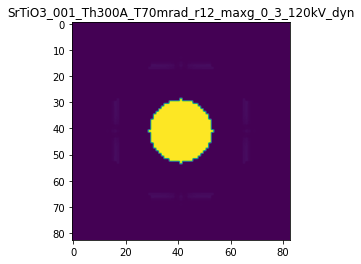

R-factor: 3.704185555254945e-06

>>> producing the 10. dataset...

The offset applied on thickness: 0.0006332365186679543

The offset applied on Ug: -0.29973598102781895

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.63323651866796
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

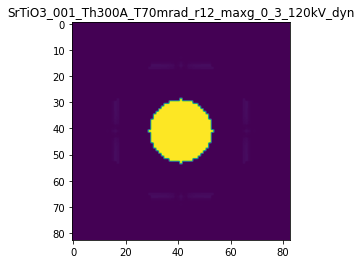

R-factor: 2.280185690092182e-06

>>> producing the 11. dataset...

The offset applied on thickness: 0.00039255677104946377

The offset applied on Ug: -0.09871482690994868

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3925567710495
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

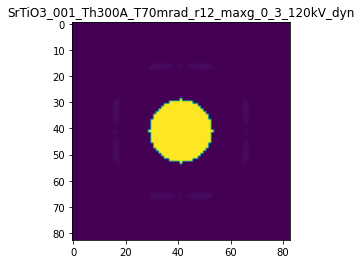

R-factor: 9.13177992059806e-07

>>> producing the 12. dataset...

The offset applied on thickness: -0.0006247846982443211

The offset applied on Ug: 0.08400646560099574

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.37521530175565
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

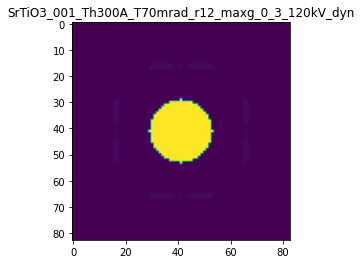

R-factor: 1.0600864676591563e-06

>>> producing the 13. dataset...

The offset applied on thickness: -0.0005780418620331381

The offset applied on Ug: -0.3714808619987372

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.42195813796684
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

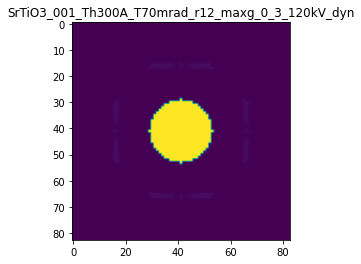

R-factor: 2.2437806757125753e-06

>>> producing the 14. dataset...

The offset applied on thickness: -0.0007395666823142157

The offset applied on Ug: 0.5874731319939361

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.26043331768574
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

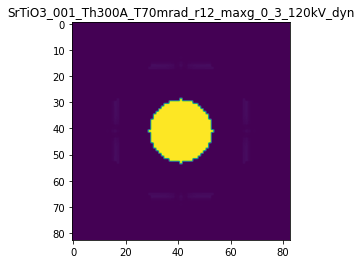

R-factor: 4.09458932217802e-06

>>> producing the 15. dataset...

The offset applied on thickness: -0.00045064414934428275

The offset applied on Ug: -0.053141560943136455

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.54935585065573
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

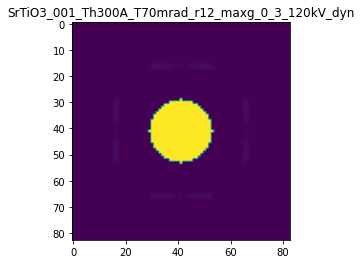

R-factor: 6.505952673311983e-07

>>> producing the 16. dataset...

The offset applied on thickness: -0.0006756375399305721

The offset applied on Ug: -0.024432250760670654

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.32436246006944
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

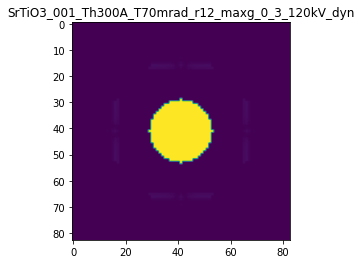

R-factor: 8.797680450270548e-07

>>> producing the 17. dataset...

The offset applied on thickness: -0.0004453003675814593

The offset applied on Ug: -0.36402175646671864

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.55469963241853
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

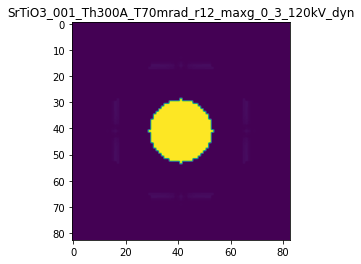

R-factor: 2.1589440434662344e-06

>>> producing the 18. dataset...

The offset applied on thickness: 7.993226861661373e-06

The offset applied on Ug: -0.023717224218642627

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0079932268617
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

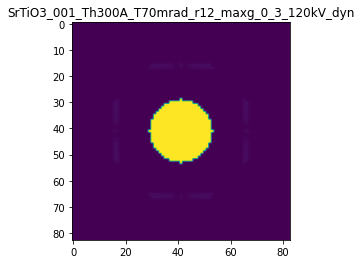

R-factor: 1.501454170979625e-07

>>> producing the 19. dataset...

The offset applied on thickness: -0.0006547244395024445

The offset applied on Ug: -0.4362606616916888

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.34527556049756
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

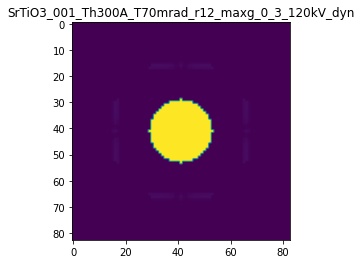

R-factor: 2.6272045925306007e-06

>>> producing the 20. dataset...

The offset applied on thickness: 0.0006793606655492213

The offset applied on Ug: -0.6310630188855112

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6793606655492
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

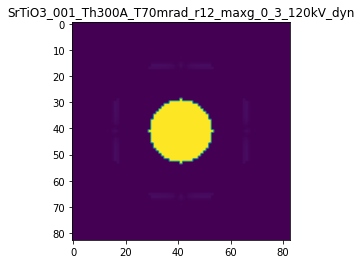

R-factor: 4.277919929187335e-06

>>> producing the 21. dataset...

The offset applied on thickness: 0.0005245183945268943

The offset applied on Ug: 0.4175772792948102

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.52451839452686
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

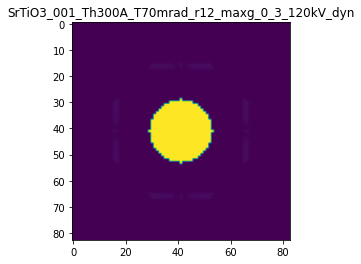

R-factor: 2.4754703893437835e-06

>>> producing the 22. dataset...

The offset applied on thickness: 0.0007419761650073593

The offset applied on Ug: 0.10158076179257379

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7419761650074
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

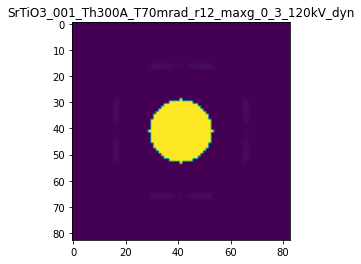

R-factor: 1.0972692037692546e-06

>>> producing the 23. dataset...

The offset applied on thickness: -0.0007248273654297128

The offset applied on Ug: -0.6166080217658393

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.27517263457025
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

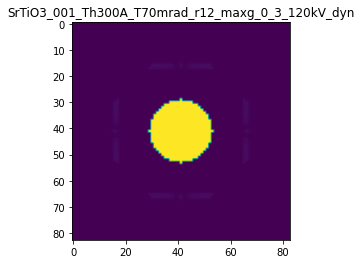

R-factor: 3.6499429753966076e-06

>>> producing the 24. dataset...

The offset applied on thickness: -0.0007547629707567214

The offset applied on Ug: 0.08208509188036274

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2452370292433
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

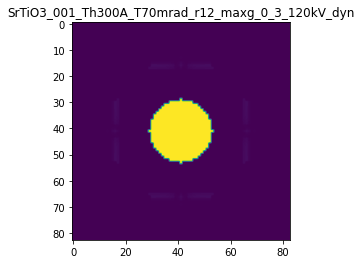

R-factor: 1.1869398291431964e-06

>>> producing the 25. dataset...

The offset applied on thickness: 2.5724380296424878e-05

The offset applied on Ug: -0.4245470163307358

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0257243802964
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

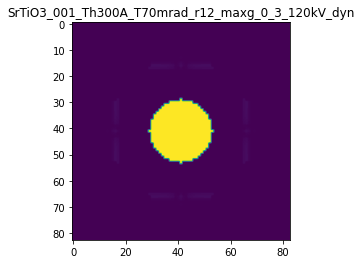

R-factor: 2.603430215682523e-06

>>> producing the 26. dataset...

The offset applied on thickness: -0.0004994191363721204

The offset applied on Ug: 0.3676806216813563

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5005808636279
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

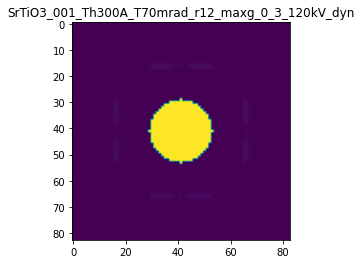

R-factor: 2.586373536838131e-06

>>> producing the 27. dataset...

The offset applied on thickness: 6.463206312444858e-05

The offset applied on Ug: -0.09578913041681077

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.06463206312446
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

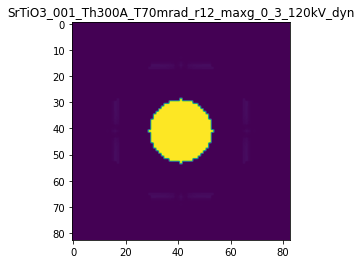

R-factor: 6.265862440257386e-07

>>> producing the 28. dataset...

The offset applied on thickness: -0.0008006213974171959

The offset applied on Ug: -0.41213663600335665

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1993786025828
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

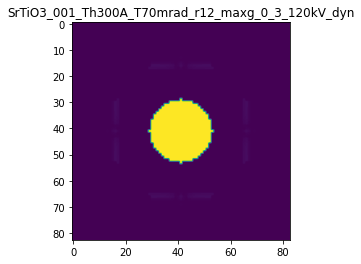

R-factor: 2.5508817804777846e-06

>>> producing the 29. dataset...

The offset applied on thickness: 0.00043695201785469483

The offset applied on Ug: -0.541625840433577

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4369520178547
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

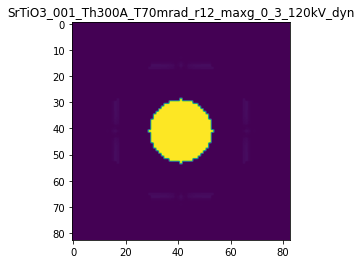

R-factor: 3.572900945275129e-06

>>> producing the 30. dataset...

The offset applied on thickness: 0.0009939824825819206

The offset applied on Ug: -0.5367652990192935

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9939824825819
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

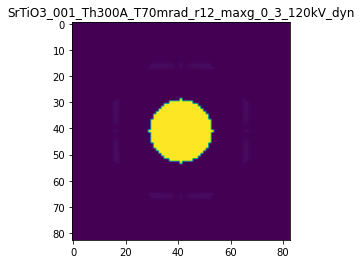

R-factor: 3.9608778219620706e-06

>>> producing the 31. dataset...

The offset applied on thickness: -0.0008497949030934054

The offset applied on Ug: -0.5573107844899395

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1502050969066
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

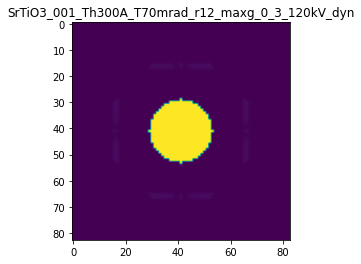

R-factor: 3.3617642072330213e-06

>>> producing the 32. dataset...

The offset applied on thickness: 0.00017704704828094408

The offset applied on Ug: 0.53419973825918

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1770470482809
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

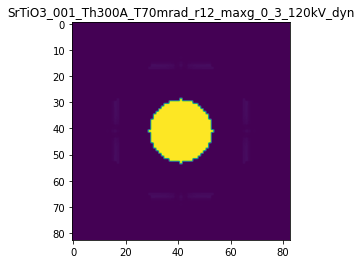

R-factor: 3.2164959659268282e-06

>>> producing the 33. dataset...

The offset applied on thickness: 0.0009960468605011163

The offset applied on Ug: -0.22502068999256777

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9960468605011
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

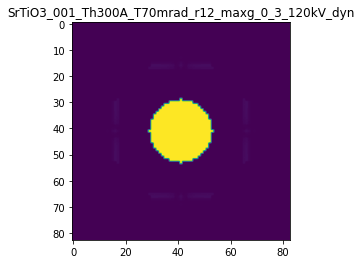

R-factor: 2.1761350502369123e-06

>>> producing the 34. dataset...

The offset applied on thickness: -0.0001943176316715771

The offset applied on Ug: -0.11885116265867637

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8056823683284
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

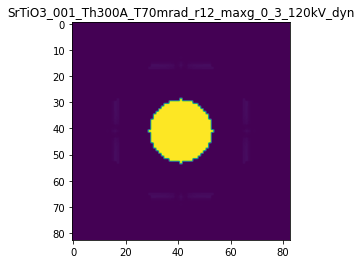

R-factor: 7.205189353411556e-07

>>> producing the 35. dataset...

The offset applied on thickness: 0.0007475226727293752

The offset applied on Ug: 0.3722631871107768

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.74752267272936
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

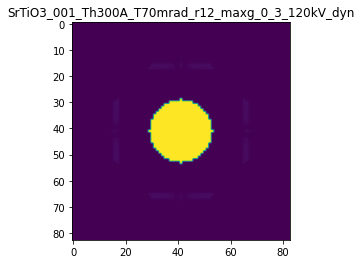

R-factor: 2.3037635601898877e-06

>>> producing the 36. dataset...

The offset applied on thickness: -7.954735749393649e-08

The offset applied on Ug: 0.1684192607212003

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9999204526425
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

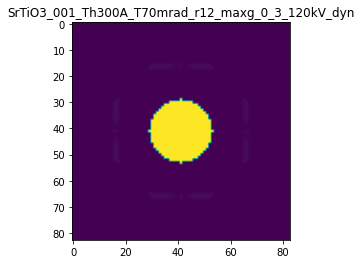

R-factor: 1.0368517793650755e-06

>>> producing the 37. dataset...

The offset applied on thickness: -0.00012844576751758785

The offset applied on Ug: 0.40802702127129536

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8715542324824
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

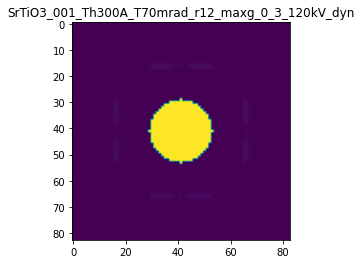

R-factor: 2.5902787756624308e-06

>>> producing the 38. dataset...

The offset applied on thickness: -0.0003109661758690485

The offset applied on Ug: 0.35013091627169646

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.68903382413095
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

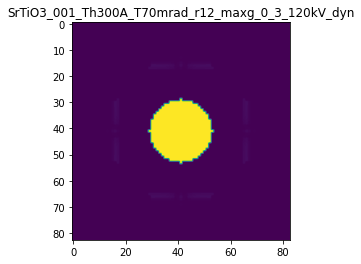

R-factor: 2.348643385115694e-06

>>> producing the 39. dataset...

The offset applied on thickness: -0.0009904381289634228

The offset applied on Ug: -0.3844826385776425

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.00956187103657
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

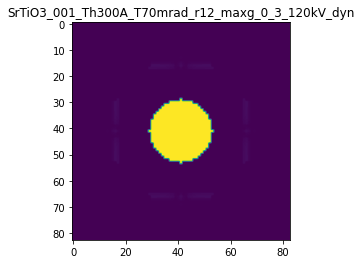

R-factor: 2.5162747963793056e-06

>>> producing the 40. dataset...

The offset applied on thickness: 0.0009478767199803693

The offset applied on Ug: -0.23816343569667184

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.94787671998034
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

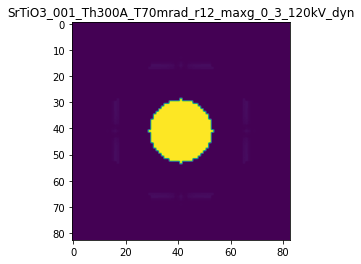

R-factor: 2.2050215797729426e-06

>>> producing the 41. dataset...

The offset applied on thickness: 0.0004258978652670211

The offset applied on Ug: 0.4563371970998578

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.425897865267
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

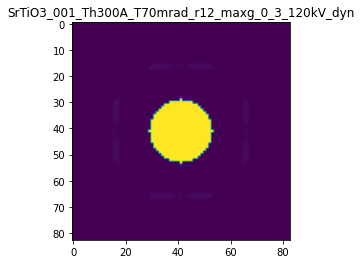

R-factor: 2.6996146938576333e-06

>>> producing the 42. dataset...

The offset applied on thickness: -0.0003129995464743831

The offset applied on Ug: 0.07109733793411394

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.68700045352557
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

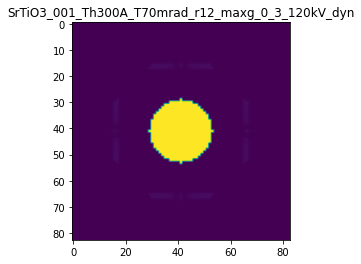

R-factor: 6.849870015592319e-07

>>> producing the 43. dataset...

The offset applied on thickness: 0.0004807190054387176

The offset applied on Ug: 0.6088326859026898

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4807190054387
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

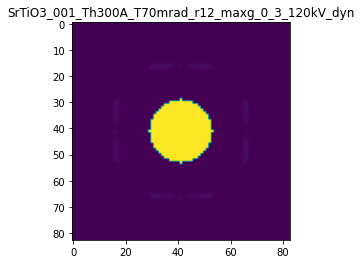

R-factor: 3.6053900283577923e-06

>>> producing the 44. dataset...

The offset applied on thickness: -4.79340131771977e-06

The offset applied on Ug: 0.3531046910913473

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9952065986823
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

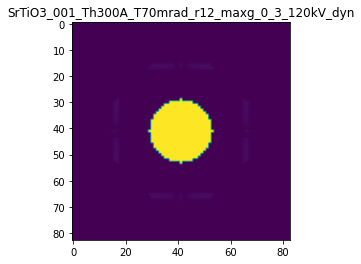

R-factor: 2.181720950367392e-06

>>> producing the 45. dataset...

The offset applied on thickness: -0.000685259072968808

The offset applied on Ug: -0.28457484113928433

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3147409270312
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

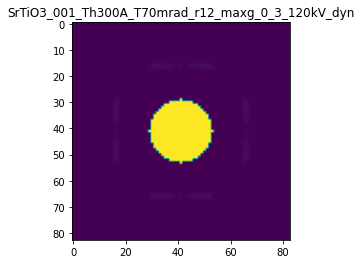

R-factor: 1.8326460935854478e-06

>>> producing the 46. dataset...

The offset applied on thickness: 0.000773054431223601

The offset applied on Ug: -0.0854577124396198

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7730544312236
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

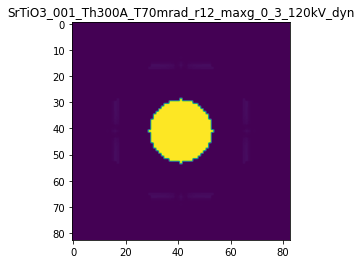

R-factor: 1.2253679982833955e-06

>>> producing the 47. dataset...

The offset applied on thickness: 0.00044741570957158226

The offset applied on Ug: -0.5834661801619988

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.44741570957154
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

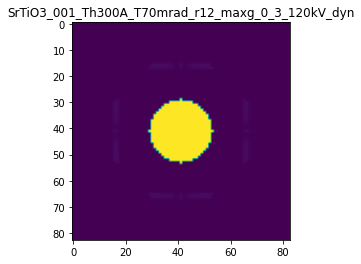

R-factor: 3.83089404050854e-06

>>> producing the 48. dataset...

The offset applied on thickness: -0.0006330919929203416

The offset applied on Ug: -0.6226739050958269

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.36690800707964
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

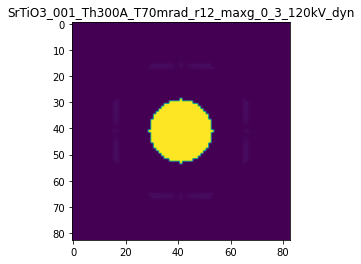

R-factor: 3.6680755105767434e-06

>>> producing the 49. dataset...

The offset applied on thickness: 0.0009584388085989511

The offset applied on Ug: 0.6284542036736634

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.95843880859894
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

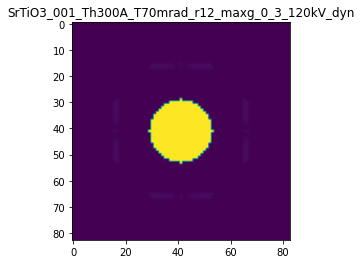

R-factor: 3.763348385348788e-06

>>> producing the 50. dataset...

The offset applied on thickness: -8.27986241584695e-05

The offset applied on Ug: 0.21300676762674983

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.91720137584156
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

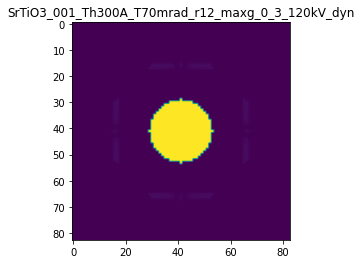

R-factor: 1.3588082425058587e-06

>>> producing the 51. dataset...

The offset applied on thickness: 0.0008701266950314604

The offset applied on Ug: -0.08480264860038432

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.87012669503144
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

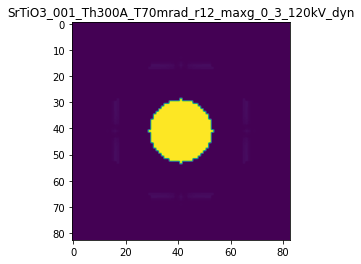

R-factor: 1.331011677062174e-06

>>> producing the 52. dataset...

The offset applied on thickness: 0.0007820149450919958

The offset applied on Ug: 0.00718779316956784

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.782014945092
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

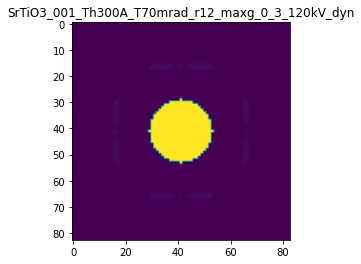

R-factor: 9.931934549686587e-07

>>> producing the 53. dataset...

The offset applied on thickness: 0.0005493857297103392

The offset applied on Ug: -0.4345558310688895

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.54938572971037
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

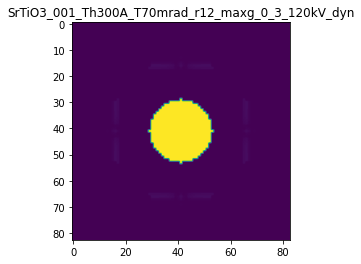

R-factor: 3.010974522292632e-06

>>> producing the 54. dataset...

The offset applied on thickness: 0.0004595875982105786

The offset applied on Ug: 0.5535065537575262

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4595875982106
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

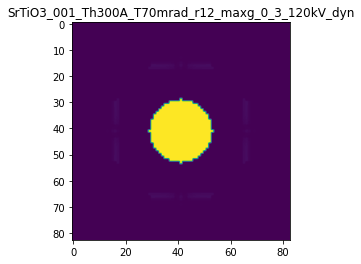

R-factor: 3.2768801283858055e-06

>>> producing the 55. dataset...

The offset applied on thickness: -0.0003464296534382259

The offset applied on Ug: -0.06651602039224556

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.65357034656176
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

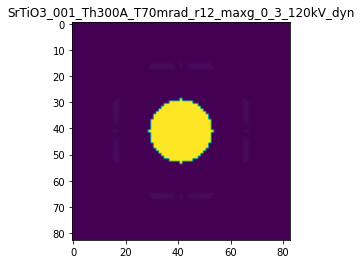

R-factor: 5.639104465231283e-07

>>> producing the 56. dataset...

The offset applied on thickness: 0.000893229606804878

The offset applied on Ug: 0.08632977781852304

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8932296068049
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

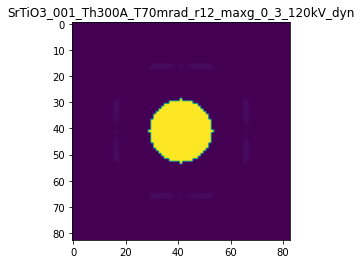

R-factor: 1.255072702134209e-06

>>> producing the 57. dataset...

The offset applied on thickness: -8.957791337907306e-05

The offset applied on Ug: 0.5920718169214838

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.91042208662094
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

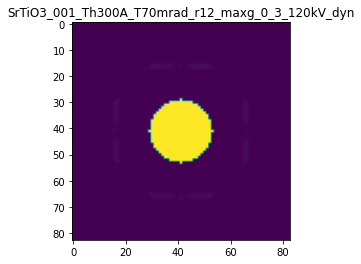

R-factor: 3.7120498116681503e-06

>>> producing the 58. dataset...

The offset applied on thickness: -0.0005220044991671014

The offset applied on Ug: 0.4718228548081869

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4779955008329
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

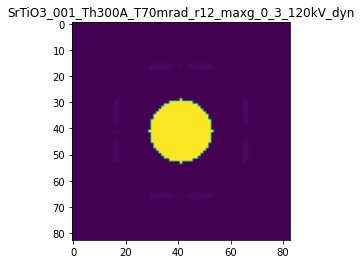

R-factor: 3.23710905177336e-06

>>> producing the 59. dataset...

The offset applied on thickness: -0.0005133632283197778

The offset applied on Ug: 0.4642428647586439

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4866367716802
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

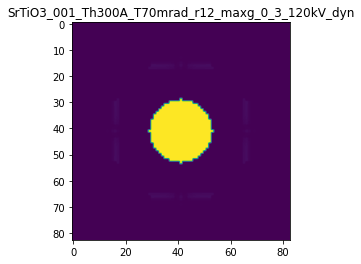

R-factor: 3.1848052639929574e-06

>>> producing the 60. dataset...

The offset applied on thickness: -0.0005115078954978299

The offset applied on Ug: 0.32441999982411546

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4884921045022
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

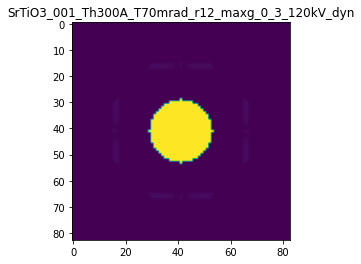

R-factor: 2.3336996644397992e-06

>>> producing the 61. dataset...

The offset applied on thickness: 0.0009573212044092789

The offset applied on Ug: 0.5584310489543587

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.95732120440925
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

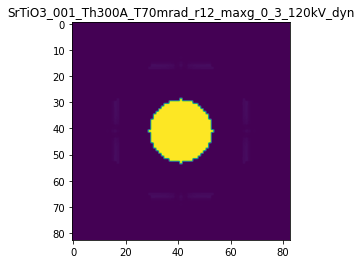

R-factor: 3.3862970532408355e-06

>>> producing the 62. dataset...

The offset applied on thickness: 0.0003017338538587253

The offset applied on Ug: 0.5589635214905571

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3017338538587
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

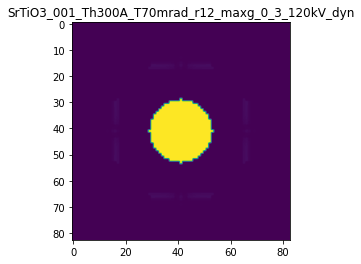

R-factor: 3.330191781905002e-06

>>> producing the 63. dataset...

The offset applied on thickness: 0.00039415711470920135

The offset applied on Ug: -0.09202520037617645

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3941571147092
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

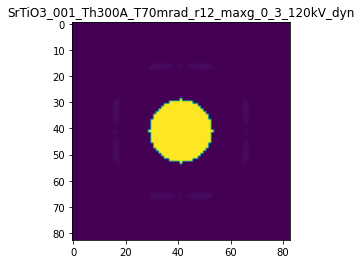

R-factor: 8.772023617210268e-07

>>> producing the 64. dataset...

The offset applied on thickness: -0.0008759797740974609

The offset applied on Ug: 0.49133485715732805

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1240202259025
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

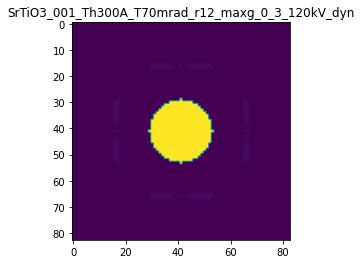

R-factor: 3.612942783720087e-06

>>> producing the 65. dataset...

The offset applied on thickness: 0.0007565557032860122

The offset applied on Ug: 0.3645376029319475

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.75655570328604
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

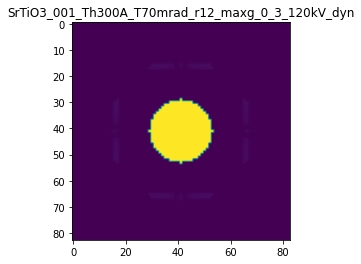

R-factor: 2.266959229764655e-06

>>> producing the 66. dataset...

The offset applied on thickness: 0.0003272693109133833

The offset applied on Ug: -0.02806482726993437

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3272693109134
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

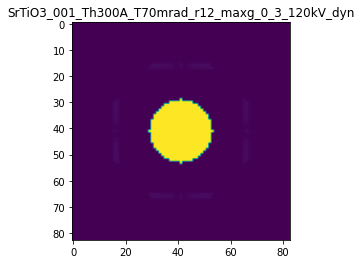

R-factor: 4.846554557551496e-07

>>> producing the 67. dataset...

The offset applied on thickness: 0.00038421357369545464

The offset applied on Ug: -0.27018757672528493

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.38421357369543
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

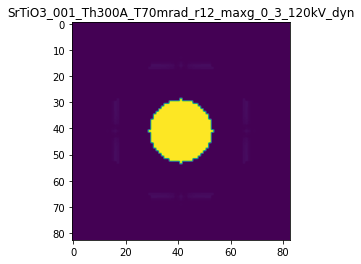

R-factor: 1.9061814972109095e-06

>>> producing the 68. dataset...

The offset applied on thickness: 0.0004867564259644615

The offset applied on Ug: 0.37148940811131026

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4867564259645
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

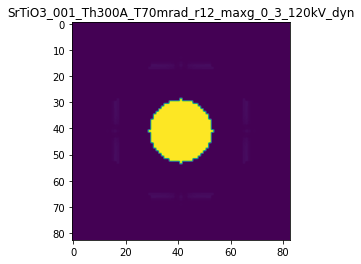

R-factor: 2.2071791804943023e-06

>>> producing the 69. dataset...

The offset applied on thickness: -0.000310669167410943

The offset applied on Ug: 0.06265877184254137

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.689330832589
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

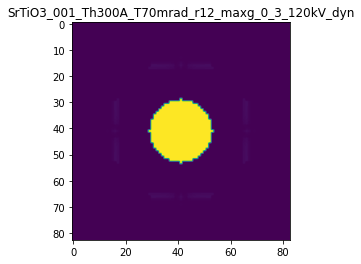

R-factor: 6.369344660642949e-07

>>> producing the 70. dataset...

The offset applied on thickness: 0.0007897487676852737

The offset applied on Ug: -0.2662475147742018

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7897487676853
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

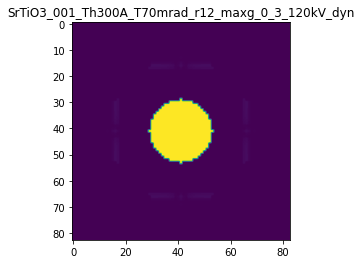

R-factor: 2.2205661818766304e-06

>>> producing the 71. dataset...

The offset applied on thickness: 0.00010750623766697998

The offset applied on Ug: -0.5743686213785104

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.10750623766694
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

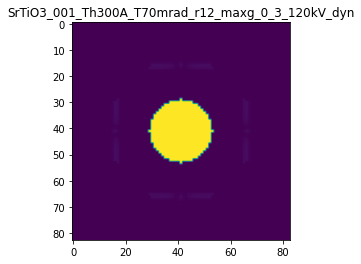

R-factor: 3.5550044662271066e-06

>>> producing the 72. dataset...

The offset applied on thickness: -0.0005135117717895129

The offset applied on Ug: -0.13689878280565565

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4864882282105
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

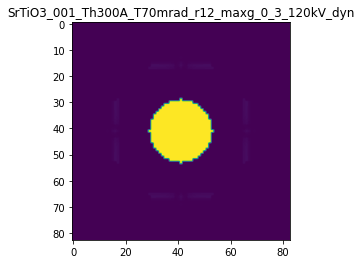

R-factor: 9.982702744233856e-07

>>> producing the 73. dataset...

The offset applied on thickness: -0.0008122687121793742

The offset applied on Ug: -0.15031421521863336

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1877312878206
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

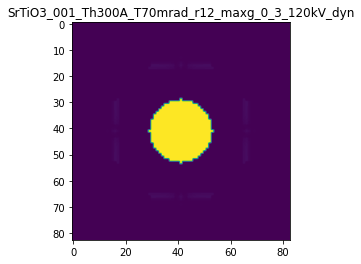

R-factor: 1.3058980126309653e-06

>>> producing the 74. dataset...

The offset applied on thickness: -0.0003869493867369729

The offset applied on Ug: -0.1161340847923907

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.61305061326306
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

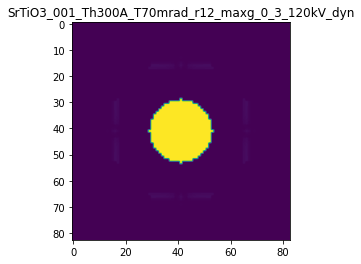

R-factor: 8.145173338690468e-07

>>> producing the 75. dataset...

The offset applied on thickness: 0.00034001352739801785

The offset applied on Ug: -0.10225923445883467

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.340013527398
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

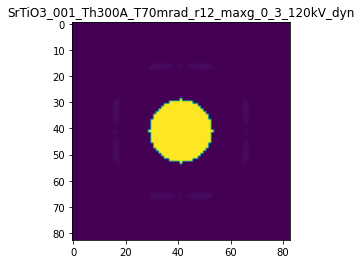

R-factor: 8.8558205661367e-07

>>> producing the 76. dataset...

The offset applied on thickness: 0.0006772017648856119

The offset applied on Ug: 0.16919149402489567

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6772017648856
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

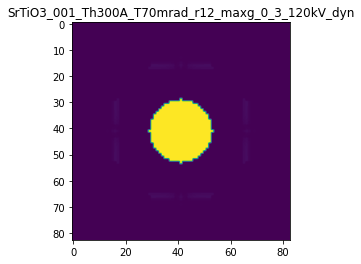

R-factor: 1.2627503373560166e-06

>>> producing the 77. dataset...

The offset applied on thickness: 0.0007697673389008586

The offset applied on Ug: 0.04476126620234879

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.76976733890086
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

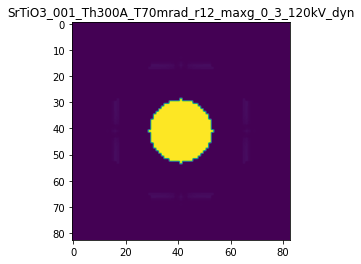

R-factor: 1.0300439397012246e-06

>>> producing the 78. dataset...

The offset applied on thickness: -0.00014164467000007887

The offset applied on Ug: 0.49854135641631475

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.85835532999994
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

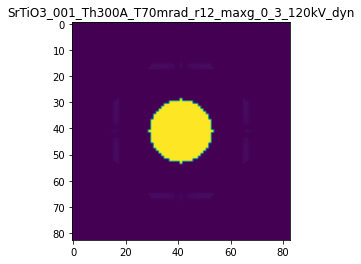

R-factor: 3.158988248297333e-06

>>> producing the 79. dataset...

The offset applied on thickness: 0.00013446546456486375

The offset applied on Ug: 0.5398283061180504

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.13446546456487
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

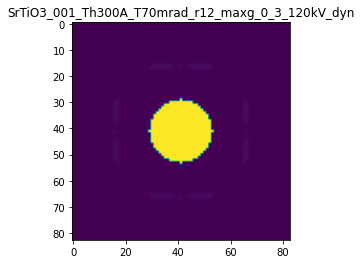

R-factor: 3.2710562270362886e-06

>>> producing the 80. dataset...

The offset applied on thickness: 0.0004075157466247721

The offset applied on Ug: 0.30563684932859503

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.40751574662477
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

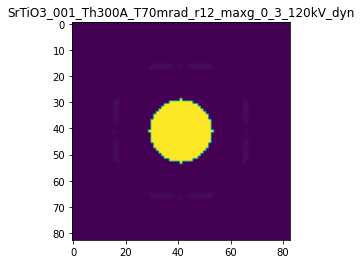

R-factor: 1.8179549666701628e-06

>>> producing the 81. dataset...

The offset applied on thickness: 0.0004083299525141975

The offset applied on Ug: 0.005504855034891989

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.40832995251424
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

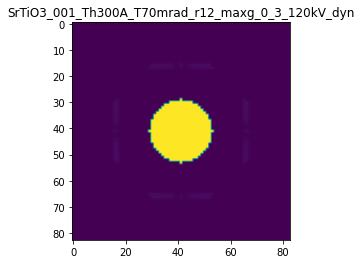

R-factor: 5.201266138932099e-07

>>> producing the 82. dataset...

The offset applied on thickness: 0.0009884538272732495

The offset applied on Ug: 0.3988166295703988

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.98845382727325
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

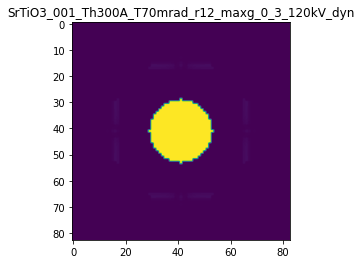

R-factor: 2.5697616241138477e-06

>>> producing the 83. dataset...

The offset applied on thickness: 0.0003481103671888095

The offset applied on Ug: 0.4921157575618483

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3481103671888
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

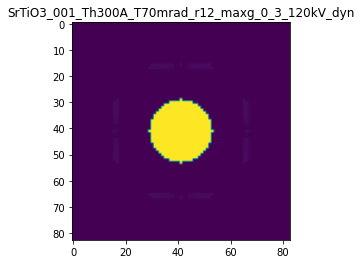

R-factor: 2.9170636812003435e-06

>>> producing the 84. dataset...

The offset applied on thickness: -0.0009695237406727296

The offset applied on Ug: 0.2407038875246427

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.03047625932726
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

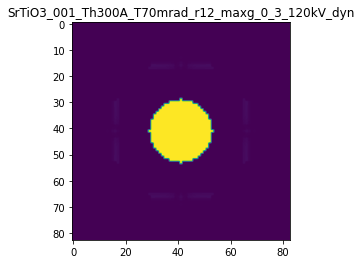

R-factor: 2.2344018140126426e-06

>>> producing the 85. dataset...

The offset applied on thickness: 0.0003823967379267448

The offset applied on Ug: 0.18180374005056352

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.38239673792674
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

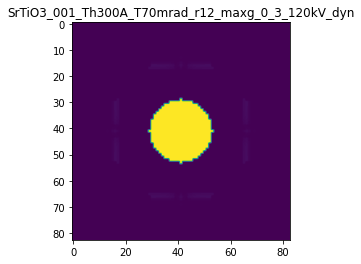

R-factor: 1.1354621890390661e-06

>>> producing the 86. dataset...

The offset applied on thickness: -0.0008556435080125486

The offset applied on Ug: 0.2232444840785462

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1443564919874
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

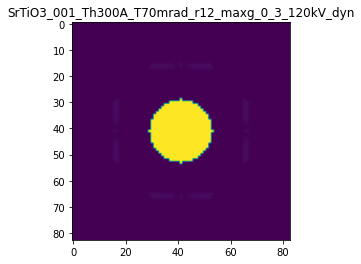

R-factor: 2.0331998048156267e-06

>>> producing the 87. dataset...

The offset applied on thickness: -0.0006106250072406674

The offset applied on Ug: -0.2703559587558527

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3893749927593
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

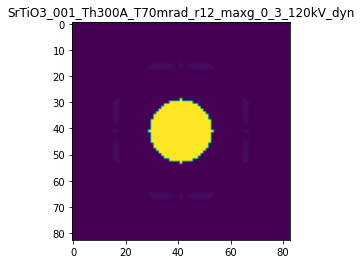

R-factor: 1.71660856993989e-06

>>> producing the 88. dataset...

The offset applied on thickness: -0.00030965233593937527

The offset applied on Ug: -0.33668374422895286

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6903476640606
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

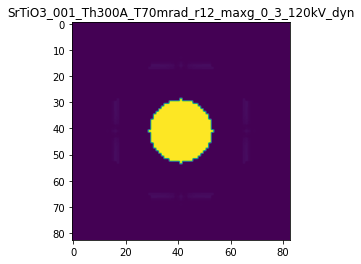

R-factor: 1.9844094969523066e-06

>>> producing the 89. dataset...

The offset applied on thickness: -0.0008255910545765551

The offset applied on Ug: -0.5673442876558897

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1744089454234
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

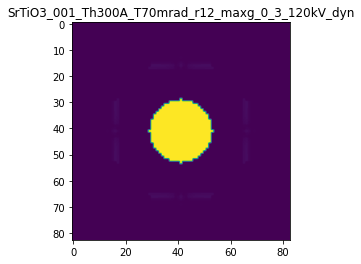

R-factor: 3.408900347784435e-06

>>> producing the 90. dataset...

The offset applied on thickness: 0.000451388621597032

The offset applied on Ug: -0.2878727536952712

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.45138862159706
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

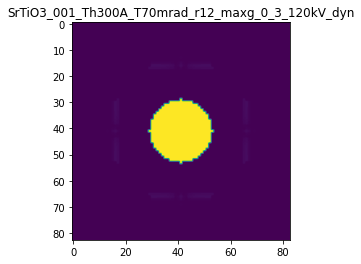

R-factor: 2.0625979379996784e-06

>>> producing the 91. dataset...

The offset applied on thickness: -0.000541106769501798

The offset applied on Ug: -0.028575166652457257

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4588932304982
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

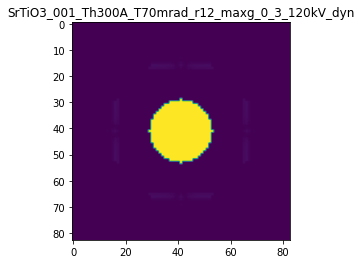

R-factor: 7.176484489151045e-07

>>> producing the 92. dataset...

The offset applied on thickness: 0.00018192395065700384

The offset applied on Ug: 0.001642538041038364

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.181923950657
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

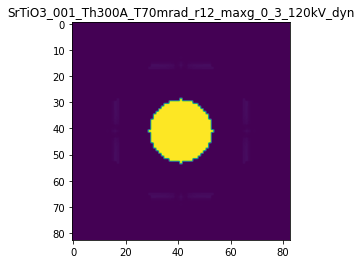

R-factor: 2.307602323008511e-07

>>> producing the 93. dataset...

The offset applied on thickness: -0.0004680681237536617

The offset applied on Ug: 0.22113267110051893

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.53193187624635
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

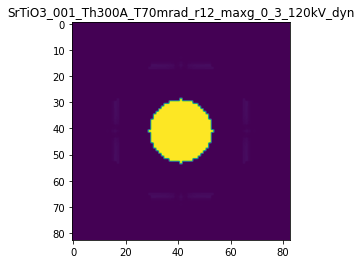

R-factor: 1.6849096111665508e-06

>>> producing the 94. dataset...

The offset applied on thickness: -6.0251361790450764e-05

The offset applied on Ug: 0.07548125244645164

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.93974863820955
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

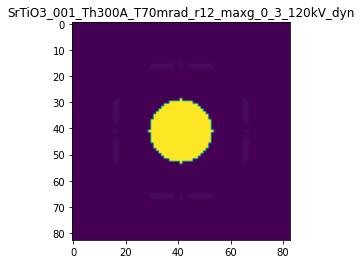

R-factor: 5.007196041314755e-07

>>> producing the 95. dataset...

The offset applied on thickness: 0.0008411415426524303

The offset applied on Ug: -0.5068674626077528

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8411415426524
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

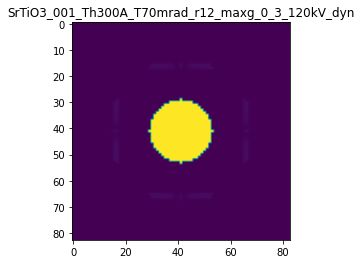

R-factor: 3.662330724347059e-06

>>> producing the 96. dataset...

The offset applied on thickness: 0.0005833032257828814

The offset applied on Ug: 0.2214760428684707

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.58330322578286
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

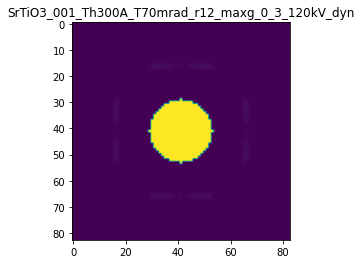

R-factor: 1.451354278771109e-06

>>> producing the 97. dataset...

The offset applied on thickness: -0.0005875691787228108

The offset applied on Ug: -0.3594165396967686

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.41243082127716
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

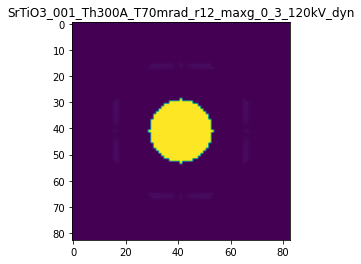

R-factor: 2.1808157371143064e-06

>>> producing the 98. dataset...

The offset applied on thickness: 0.000293989136802882

The offset applied on Ug: -0.6254876322100504

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2939891368029
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

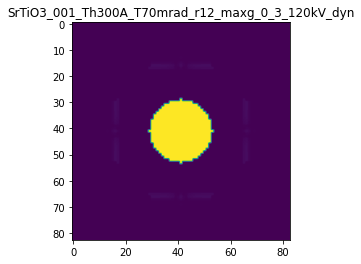

R-factor: 3.979167920710325e-06

>>> producing the 99. dataset...

The offset applied on thickness: 0.0006070927014520363

The offset applied on Ug: 0.1075463808062716

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.607092701452
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

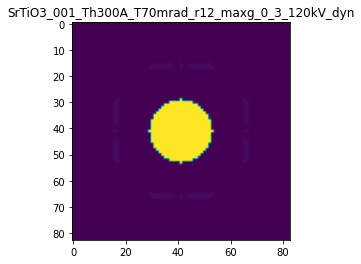

R-factor: 9.606853609505675e-07

>>> producing the 100. dataset...

The offset applied on thickness: -0.0002570149419038779

The offset applied on Ug: -0.28078457413888247

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7429850580961
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

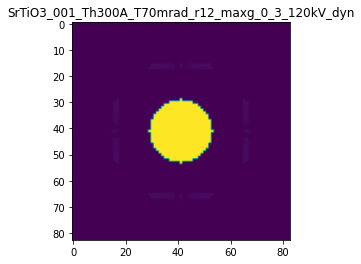

R-factor: 1.6555452656115667e-06

>>> producing the 101. dataset...

The offset applied on thickness: -0.0007159062961832853

The offset applied on Ug: -0.48174645096263263

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2840937038167
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

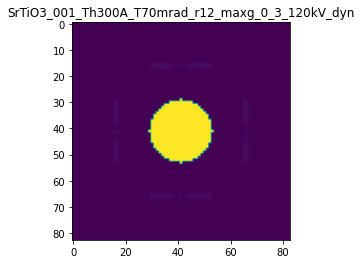

R-factor: 2.8990491382786635e-06

>>> producing the 102. dataset...

The offset applied on thickness: -0.0004656502162956593

The offset applied on Ug: 0.37599962541453397

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.53434978370433
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

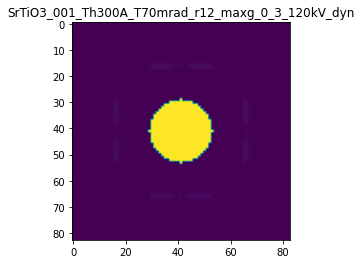

R-factor: 2.6128244975754577e-06

>>> producing the 103. dataset...

The offset applied on thickness: -0.0002887343566141496

The offset applied on Ug: 0.48450310240932737

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.71126564338584
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

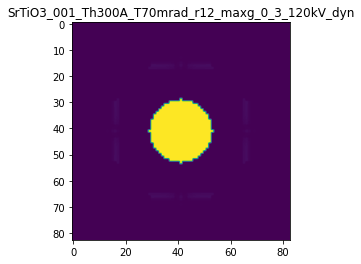

R-factor: 3.1613845689814815e-06

>>> producing the 104. dataset...

The offset applied on thickness: -0.0002593121877744533

The offset applied on Ug: -0.30336491416041017

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.74068781222553
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

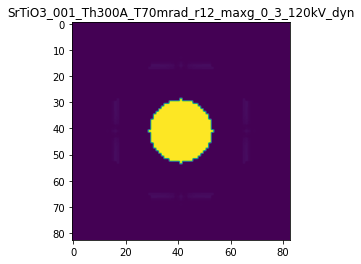

R-factor: 1.7888877002226587e-06

>>> producing the 105. dataset...

The offset applied on thickness: 0.00010325736423495236

The offset applied on Ug: -0.34984797808869317

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.10325736423493
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

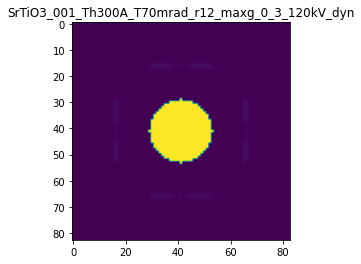

R-factor: 2.1957693491212776e-06

>>> producing the 106. dataset...

The offset applied on thickness: -0.0007356023411681259

The offset applied on Ug: 0.6186529147620773

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.26439765883185
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

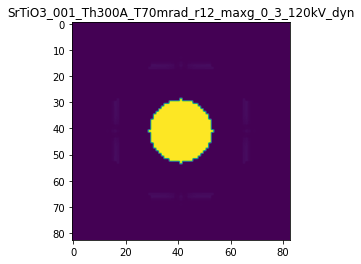

R-factor: 4.2824400371645626e-06

>>> producing the 107. dataset...

The offset applied on thickness: 0.0009169351780950486

The offset applied on Ug: 0.2553443401850224

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.91693517809506
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

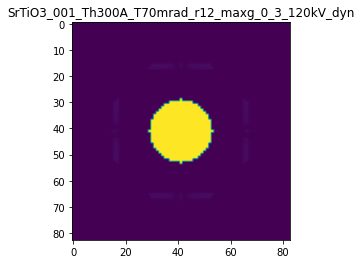

R-factor: 1.832604065650091e-06

>>> producing the 108. dataset...

The offset applied on thickness: 0.0003117595810698144

The offset applied on Ug: 0.02357921460345992

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3117595810698
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

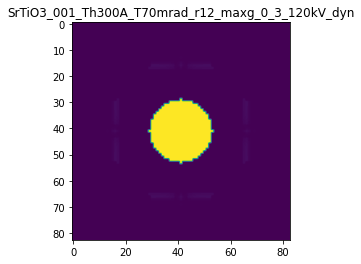

R-factor: 4.263832954477805e-07

>>> producing the 109. dataset...

The offset applied on thickness: 6.979528631792676e-05

The offset applied on Ug: -0.26444729386533267

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.06979528631797
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

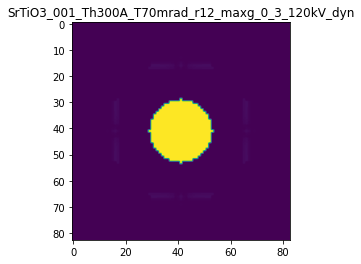

R-factor: 1.6569177359115369e-06

>>> producing the 110. dataset...

The offset applied on thickness: -0.0006477312713426562

The offset applied on Ug: 0.060618508023082

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.35226872865735
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

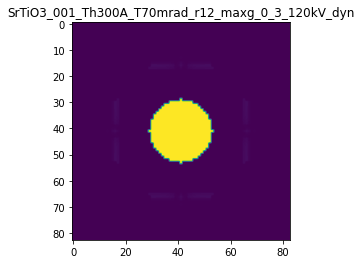

R-factor: 9.781500777750509e-07

>>> producing the 111. dataset...

The offset applied on thickness: 0.000768506498676297

The offset applied on Ug: -0.2016427049644571

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7685064986763
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

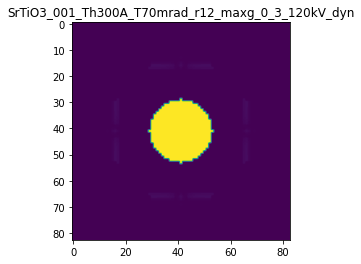

R-factor: 1.835626867633695e-06

>>> producing the 112. dataset...

The offset applied on thickness: -0.00030050361987222883

The offset applied on Ug: 0.573654866968293

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.69949638012775
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

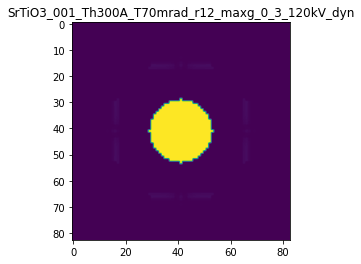

R-factor: 3.7196346907149104e-06

>>> producing the 113. dataset...

The offset applied on thickness: -0.0008964876267348732

The offset applied on Ug: -0.4724692461661901

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1035123732651
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

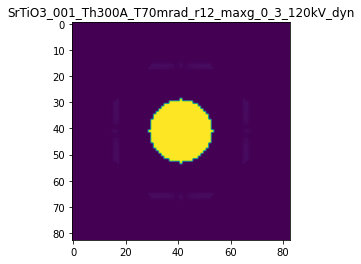

R-factor: 2.9150158011771003e-06

>>> producing the 114. dataset...

The offset applied on thickness: 0.0004182237982817931

The offset applied on Ug: -0.05989498995008376

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.41822379828176
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

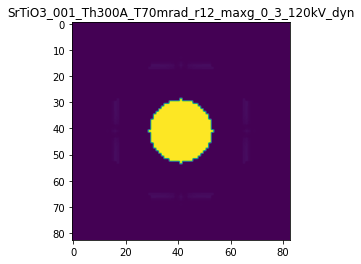

R-factor: 7.293732931751261e-07

>>> producing the 115. dataset...

The offset applied on thickness: -0.0004893150886822872

The offset applied on Ug: -0.2585511657411726

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5106849113177
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

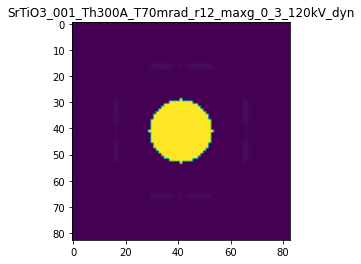

R-factor: 1.593042128478473e-06

>>> producing the 116. dataset...

The offset applied on thickness: -0.0009852390635110655

The offset applied on Ug: -0.13841556378226413

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0147609364889
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

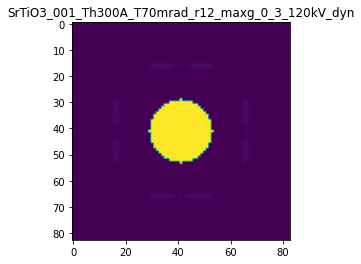

R-factor: 1.4671300914281126e-06

>>> producing the 117. dataset...

The offset applied on thickness: 0.0003238665578992044

The offset applied on Ug: 0.17339024104836553

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3238665578992
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

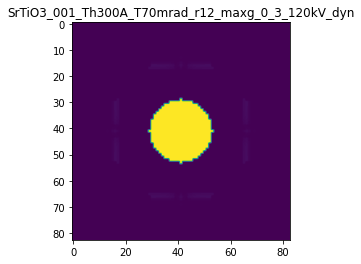

R-factor: 1.0648445848589665e-06

>>> producing the 118. dataset...

The offset applied on thickness: -0.0009565795364897833

The offset applied on Ug: -0.1714279876748823

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0434204635102
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

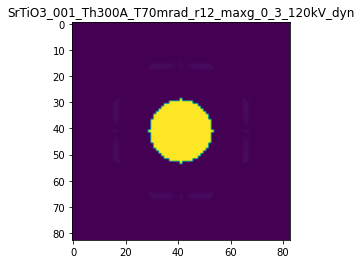

R-factor: 1.5222686856743522e-06

>>> producing the 119. dataset...

The offset applied on thickness: 0.00020592405771811053

The offset applied on Ug: 0.40009876808718475

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2059240577181
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

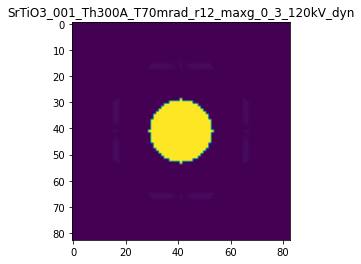

R-factor: 2.3836308861957344e-06

>>> producing the 120. dataset...

The offset applied on thickness: -0.0007345600317622085

The offset applied on Ug: 0.06468189051669711

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2654399682378
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

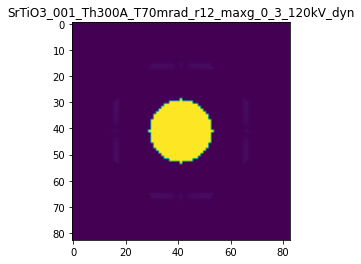

R-factor: 1.0927095340975424e-06

>>> producing the 121. dataset...

The offset applied on thickness: 0.0006395937553392163

The offset applied on Ug: -0.6254604717436612

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6395937553392
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

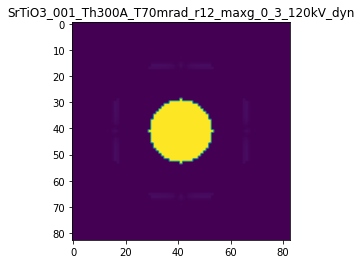

R-factor: 4.216087597419975e-06

>>> producing the 122. dataset...

The offset applied on thickness: -0.0006179373654135416

The offset applied on Ug: -0.20267607309956873

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3820626345864
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

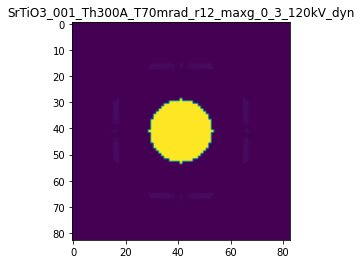

R-factor: 1.3839404725600822e-06

>>> producing the 123. dataset...

The offset applied on thickness: -0.00010138375685935297

The offset applied on Ug: -0.4064314428115797

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8986162431406
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

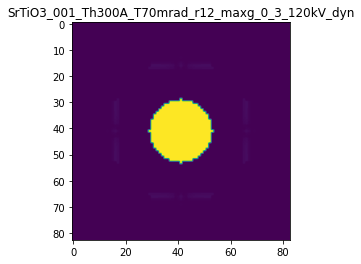

R-factor: 2.4321898267928837e-06

>>> producing the 124. dataset...

The offset applied on thickness: -0.000669044593597037

The offset applied on Ug: 0.2962549511971342

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.33095540640295
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

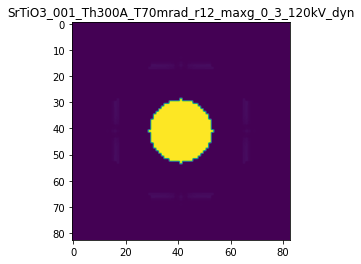

R-factor: 2.2923166017979174e-06

>>> producing the 125. dataset...

The offset applied on thickness: 0.0004625770872570068

The offset applied on Ug: -0.1336670622719153

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.462577087257
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

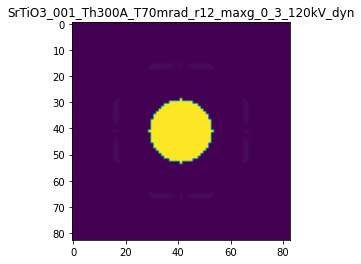

R-factor: 1.1740000599085606e-06

>>> producing the 126. dataset...

The offset applied on thickness: 4.8221110836675244e-05

The offset applied on Ug: -0.22015185681199953

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.04822111083666
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

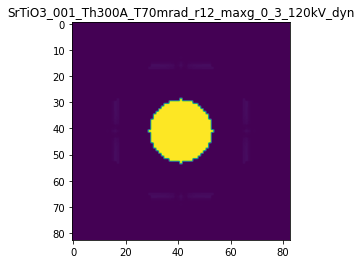

R-factor: 1.3744887988805307e-06

>>> producing the 127. dataset...

The offset applied on thickness: 0.0007947914941811234

The offset applied on Ug: -0.4125947314188207

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7947914941811
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

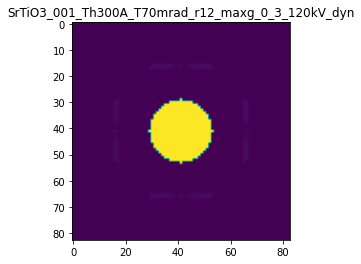

R-factor: 3.072426639548847e-06

>>> producing the 128. dataset...

The offset applied on thickness: 0.0006055530599113602

The offset applied on Ug: -0.046605348548813624

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6055530599113
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

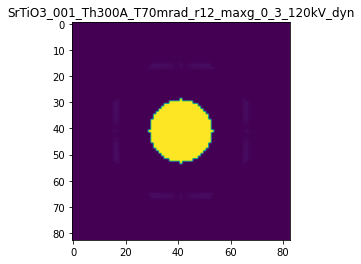

R-factor: 8.757015976029317e-07

>>> producing the 129. dataset...

The offset applied on thickness: -8.553466715037806e-05

The offset applied on Ug: 0.11027188152850287

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9144653328496
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

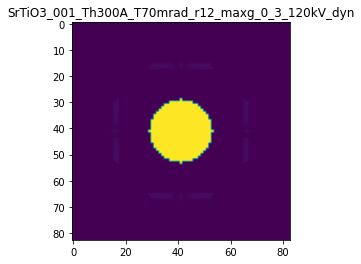

R-factor: 7.300880128911582e-07

>>> producing the 130. dataset...

The offset applied on thickness: 0.0009852877321339304

The offset applied on Ug: -0.25770997549911373

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9852877321339
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

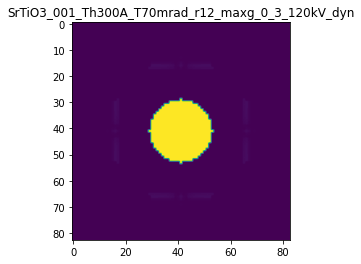

R-factor: 2.3492574137686567e-06

>>> producing the 131. dataset...

The offset applied on thickness: 0.0006213986059214214

The offset applied on Ug: 0.5259334536893395

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6213986059214
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

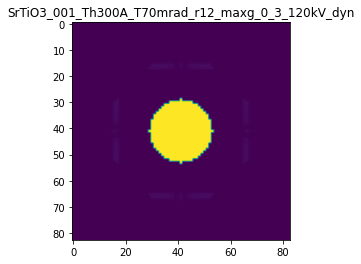

R-factor: 3.1116841026785627e-06

>>> producing the 132. dataset...

The offset applied on thickness: 0.00010436785285513329

The offset applied on Ug: -0.32124048346567735

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1043678528551
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

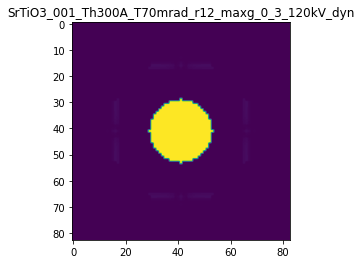

R-factor: 2.022923355957975e-06

>>> producing the 133. dataset...

The offset applied on thickness: 0.0008215313891462046

The offset applied on Ug: -0.47622004854277067

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8215313891462
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

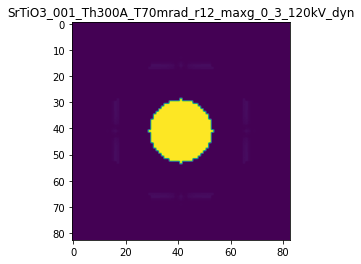

R-factor: 3.4664257145673773e-06

>>> producing the 134. dataset...

The offset applied on thickness: 0.0001544254435117771

The offset applied on Ug: 0.41775771827302793

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1544254435118
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

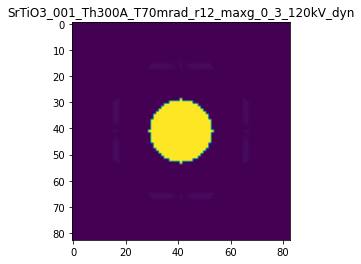

R-factor: 2.5068074337353614e-06

>>> producing the 135. dataset...

The offset applied on thickness: 0.0001474588043789309

The offset applied on Ug: 0.48422588838079494

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1474588043789
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

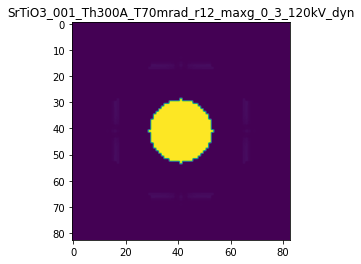

R-factor: 2.9194106451435517e-06

>>> producing the 136. dataset...

The offset applied on thickness: 0.0002480686467405211

The offset applied on Ug: -0.48306470505012356

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.24806864674053
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

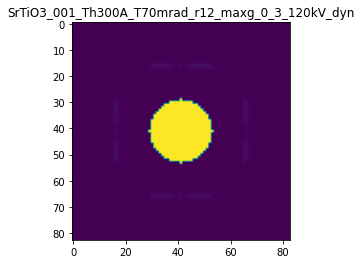

R-factor: 3.093443824131067e-06

>>> producing the 137. dataset...

The offset applied on thickness: 0.00023338606572886688

The offset applied on Ug: 0.6148190232433862

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.23338606572884
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

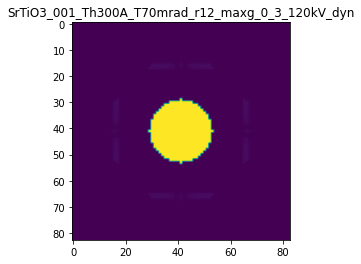

R-factor: 3.693730382480745e-06

>>> producing the 138. dataset...

The offset applied on thickness: -0.00031379635675886597

The offset applied on Ug: -0.22984857882069107

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.68620364324113
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

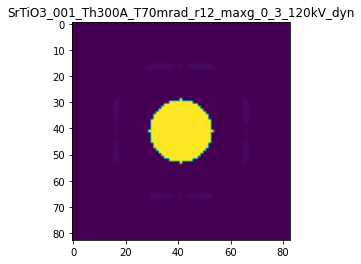

R-factor: 1.3720796878074446e-06

>>> producing the 139. dataset...

The offset applied on thickness: -0.0009742116962350851

The offset applied on Ug: 0.3446791662859951

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0257883037649
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

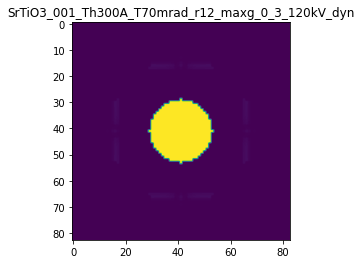

R-factor: 2.8306464887637448e-06

>>> producing the 140. dataset...

The offset applied on thickness: 0.0001833090200080232

The offset applied on Ug: 0.5488967413128603

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.183309020008
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

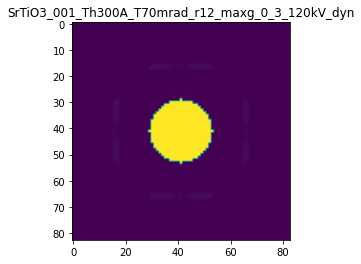

R-factor: 3.3049460587027277e-06



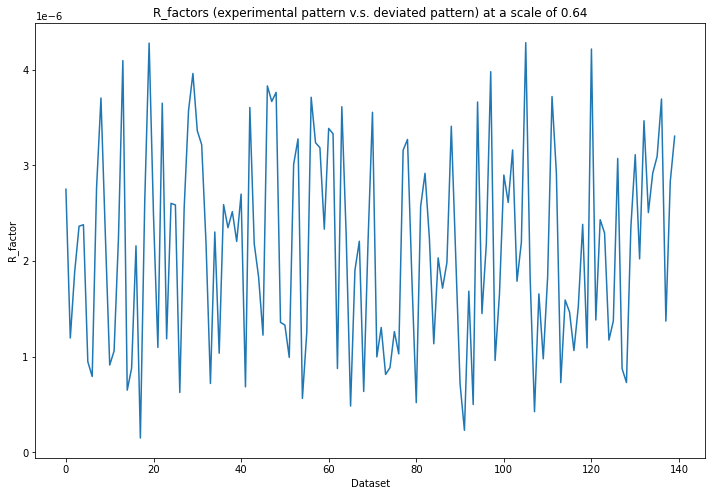

>>> start to train the ANN 

Epoch 1/30
5/5 [==============================] - 1s 128ms/step - loss: 0.3624 - acc: 0.8000 - val_loss: 0.3563 - val_acc: 1.0000
Epoch 2/30
5/5 [==============================] - 1s 108ms/step - loss: 0.3405 - acc: 1.0000 - val_loss: 0.3117 - val_acc: 1.0000
Epoch 3/30
5/5 [==============================] - 1s 109ms/step - loss: 0.2937 - acc: 1.0000 - val_loss: 0.2678 - val_acc: 1.0000
Epoch 4/30
5/5 [==============================] - 1s 109ms/step - loss: 0.2519 - acc: 1.0000 - val_loss: 0.2308 - val_acc: 1.0000
Epoch 5/30
5/5 [==============================] - 1s 109ms/step - loss: 0.2167 - acc: 1.0000 - val_loss: 0.1974 - val_acc: 1.0000
Epoch 6/30
5/5 [==============================] - 1s 108ms/step - loss: 0.1857 - acc: 1.0000 - val_loss: 0.1687 - val_acc: 1.0000
Epoch 7/30
5/5 [==============================] - 1s 109ms/step - loss: 0.1584 - acc: 1.0000 - val_loss: 0.1434 - val_acc: 1.0000
Epoch 8/30
5/5 [==============================] - 1s 109ms/st

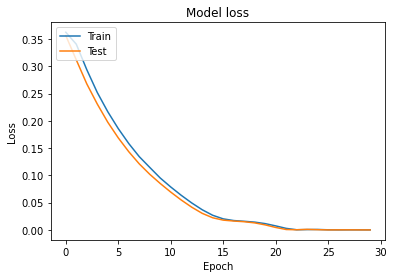

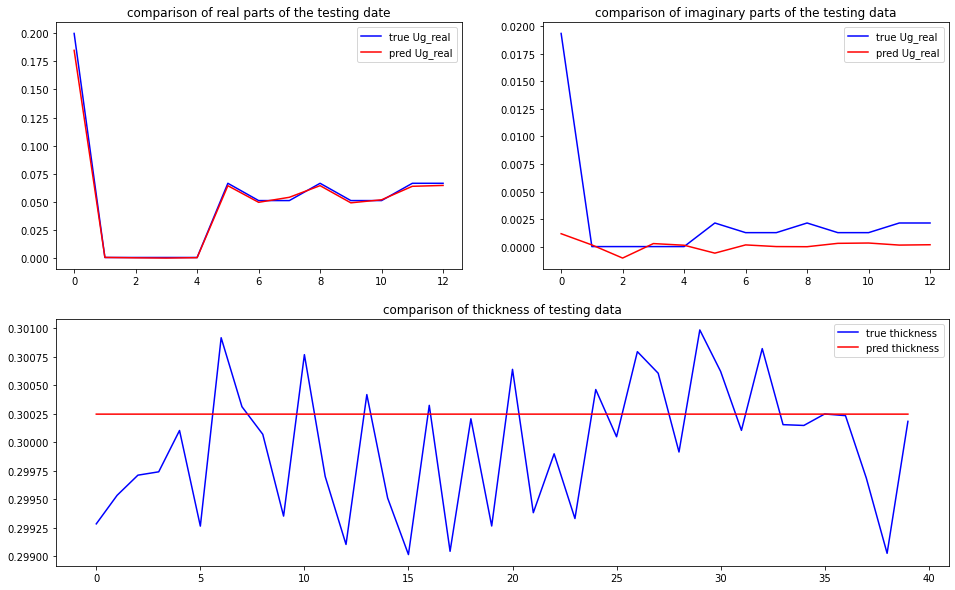

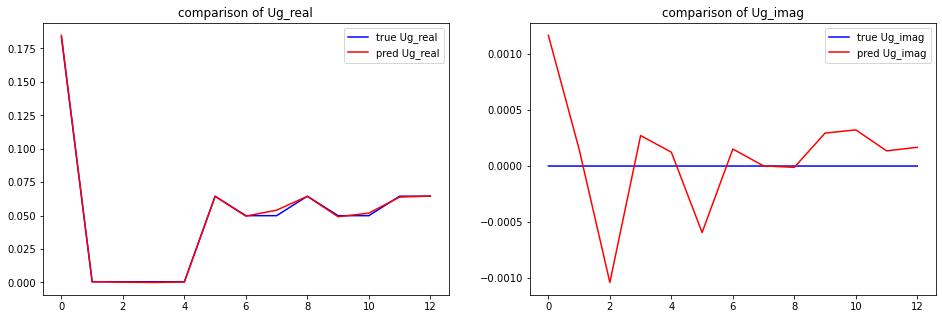

predicted thickness: 30.024680495262146 nm
mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.24680495262146
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 13 different beams

InputUg:
[1.84816405e-01+0.00000000e+00

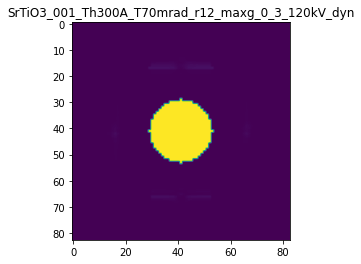

X_sim.max(): 0.999998462776806
R-factor at a scale of 0.64 is 0.00012641963513061443.

-----------------------------------------------------------------------------------------------------

>>> start to produce Dataset at a scale of 1.28

-----------------------------------------------------------------------------------------------------

>>> producing the 1. dataset...

The offset applied on thickness: -0.000544137174505541

The offset applied on Ug: -0.053021222338369686

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001

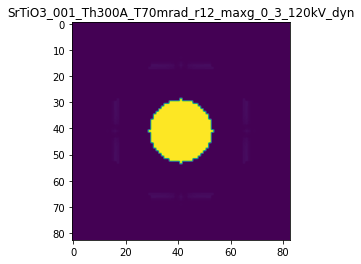

R-factor: 7.644105714091339e-07

>>> producing the 2. dataset...

The offset applied on thickness: 0.00015141804120634395

The offset applied on Ug: -1.254029836391466

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.15141804120634
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

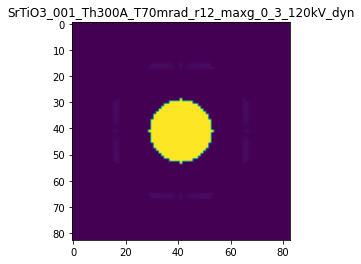

R-factor: 7.607915926954796e-06

>>> producing the 3. dataset...

The offset applied on thickness: -0.00045190000427550083

The offset applied on Ug: 0.7798586624739156

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5480999957245
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

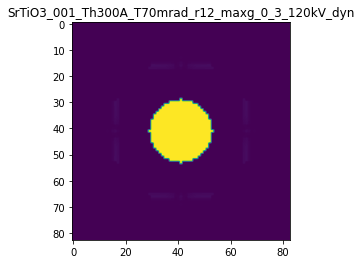

R-factor: 5.091028774657678e-06

>>> producing the 4. dataset...

The offset applied on thickness: -0.00027238671084868596

The offset applied on Ug: 0.44544179834587055

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7276132891513
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

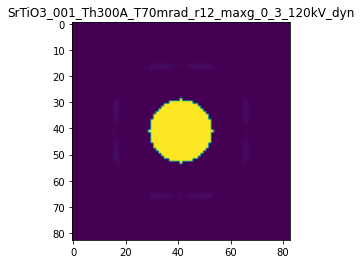

R-factor: 2.91001612170847e-06

>>> producing the 5. dataset...

The offset applied on thickness: -6.209883251654103e-05

The offset applied on Ug: -0.2010234695637837

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9379011674834
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

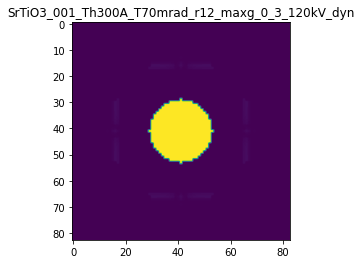

R-factor: 1.2021822280941558e-06

>>> producing the 6. dataset...

The offset applied on thickness: -0.0006434373929169493

The offset applied on Ug: -0.3405949981094938

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.35656260708305
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

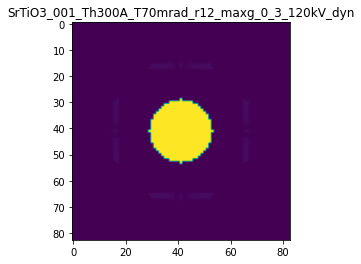

R-factor: 2.0988501265961097e-06

>>> producing the 7. dataset...

The offset applied on thickness: -0.0001680943111053934

The offset applied on Ug: 1.161634426069568

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8319056888946
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

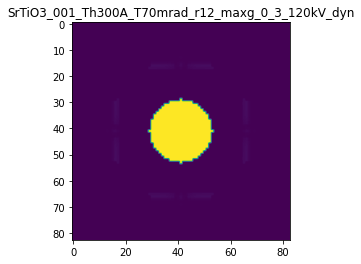

R-factor: 7.318910625073204e-06

>>> producing the 8. dataset...

The offset applied on thickness: -0.000174887460590615

The offset applied on Ug: 0.04600181514837004

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.82511253940936
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

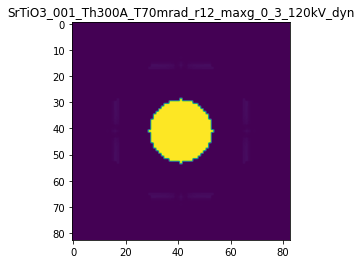

R-factor: 4.179833939545396e-07

>>> producing the 9. dataset...

The offset applied on thickness: -0.00032825430053599793

The offset applied on Ug: -0.9223984158592472

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.671745699464
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

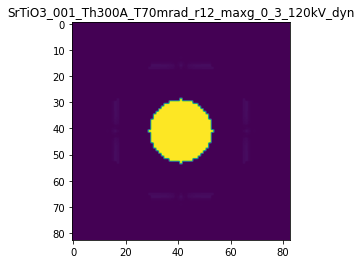

R-factor: 5.46099424148225e-06

>>> producing the 10. dataset...

The offset applied on thickness: 0.00018875731992989598

The offset applied on Ug: 0.35552989463872875

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1887573199299
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

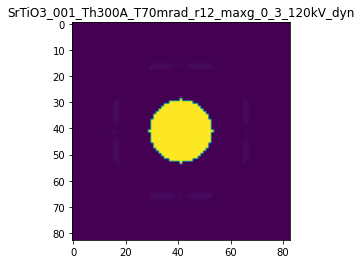

R-factor: 2.1164318728625715e-06

>>> producing the 11. dataset...

The offset applied on thickness: 0.0006571222650008834

The offset applied on Ug: -0.2213761232363359

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.65712226500085
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

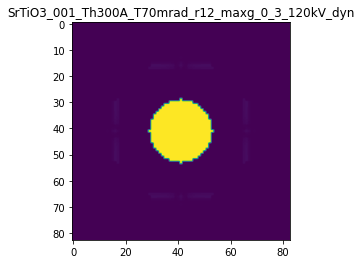

R-factor: 1.846697855321412e-06

>>> producing the 12. dataset...

The offset applied on thickness: 0.0006441944981840389

The offset applied on Ug: 0.305482533777278

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.64419449818405
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

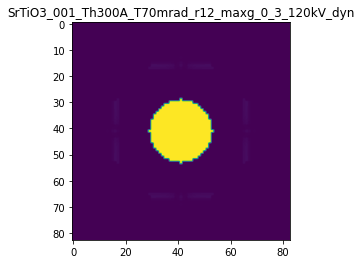

R-factor: 1.9063283360862506e-06

>>> producing the 13. dataset...

The offset applied on thickness: -0.000388614659131987

The offset applied on Ug: 1.03754687929403

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.611385340868
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrTi

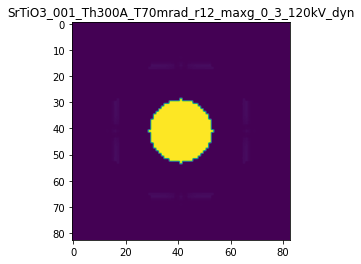

R-factor: 6.6583091771274505e-06

>>> producing the 14. dataset...

The offset applied on thickness: -0.00020823512751727357

The offset applied on Ug: -0.5175607976356303

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7917648724827
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

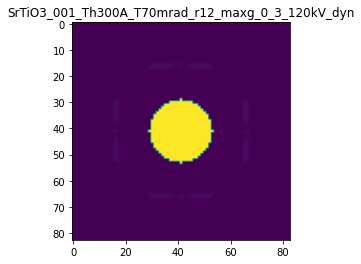

R-factor: 3.072439702876041e-06

>>> producing the 15. dataset...

The offset applied on thickness: 0.0007614793994183716

The offset applied on Ug: -0.8466692130324586

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.76147939941836
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

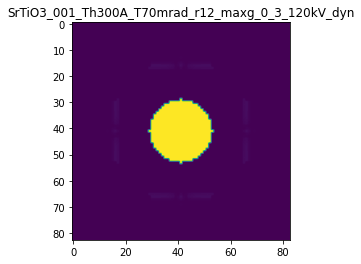

R-factor: 5.617657074591708e-06

>>> producing the 16. dataset...

The offset applied on thickness: 0.00033661395167067985

The offset applied on Ug: -0.24010136946548044

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.33661395167064
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

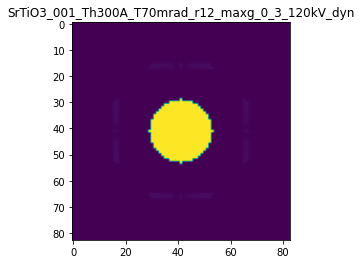

R-factor: 1.6907117542010967e-06

>>> producing the 17. dataset...

The offset applied on thickness: -0.0004970718466423718

The offset applied on Ug: 0.910304733198301

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.50292815335763
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

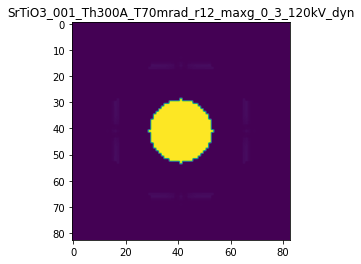

R-factor: 5.9283547423636e-06

>>> producing the 18. dataset...

The offset applied on thickness: -0.0008863493718417292

The offset applied on Ug: -0.12934693074555498

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.11365062815827
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

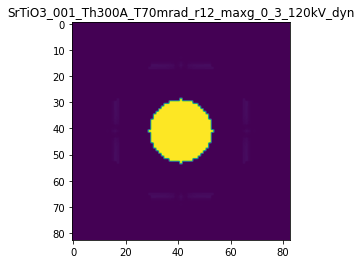

R-factor: 1.3300743800016958e-06

>>> producing the 19. dataset...

The offset applied on thickness: -0.00013136085706532706

The offset applied on Ug: 1.0770710445614144

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8686391429347
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

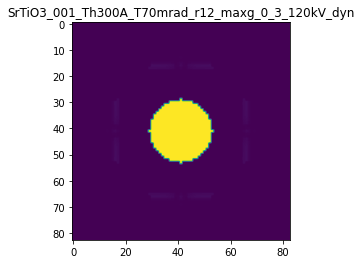

R-factor: 6.768268196136322e-06

>>> producing the 20. dataset...

The offset applied on thickness: -0.00019413132966469095

The offset applied on Ug: -0.07049082648361037

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8058686703353
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

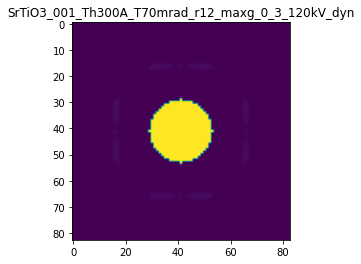

R-factor: 4.682611420663516e-07

>>> producing the 21. dataset...

The offset applied on thickness: -0.00036111022319817223

The offset applied on Ug: 0.17069529599820868

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6388897768018
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

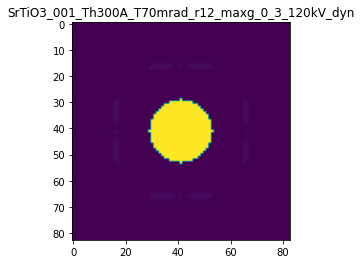

R-factor: 1.3003589063572375e-06

>>> producing the 22. dataset...

The offset applied on thickness: -0.0007359803565494354

The offset applied on Ug: -0.4509682510280038

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2640196434506
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

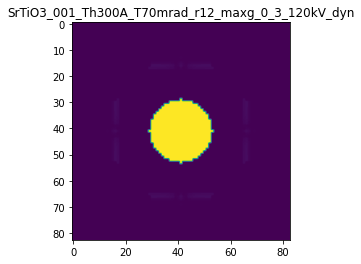

R-factor: 2.736421757148897e-06

>>> producing the 23. dataset...

The offset applied on thickness: -0.00019204916364693993

The offset applied on Ug: 0.09470958500180615

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.80795083635303
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

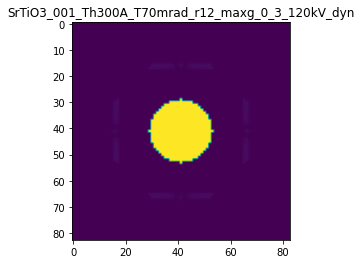

R-factor: 7.145155866990009e-07

>>> producing the 24. dataset...

The offset applied on thickness: 0.0003703969609878126

The offset applied on Ug: -0.5365640819302965

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3703969609878
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

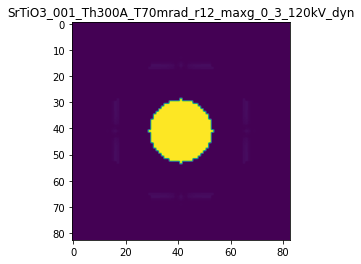

R-factor: 3.4971107116596794e-06

>>> producing the 25. dataset...

The offset applied on thickness: -0.0007845128950415217

The offset applied on Ug: 1.0447108909470724

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.21548710495847
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

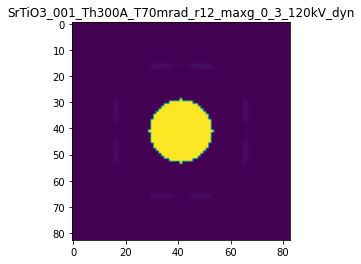

R-factor: 6.9409177942125475e-06

>>> producing the 26. dataset...

The offset applied on thickness: -0.000997705561714344

The offset applied on Ug: -0.3110592581988246

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0022944382856
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

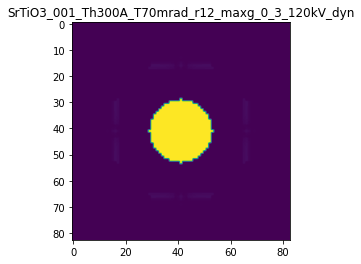

R-factor: 2.1571298131735805e-06

>>> producing the 27. dataset...

The offset applied on thickness: 0.0004387241750561024

The offset applied on Ug: 0.057751383398715175

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.43872417505605
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

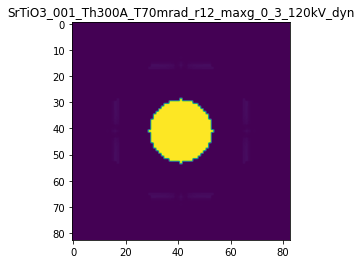

R-factor: 6.445308866195194e-07

>>> producing the 28. dataset...

The offset applied on thickness: 0.00011423212660613103

The offset applied on Ug: -1.0313665234261171

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1142321266061
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

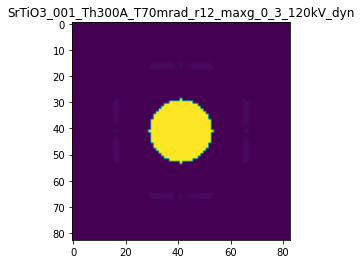

R-factor: 6.28139537630017e-06

>>> producing the 29. dataset...

The offset applied on thickness: 4.7632056458192465e-05

The offset applied on Ug: 0.5188839907124893

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.04763205645816
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

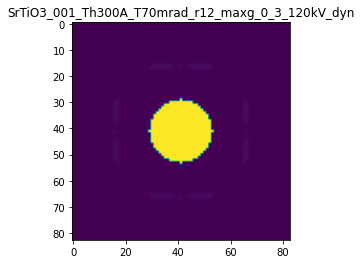

R-factor: 3.1844464638024448e-06

>>> producing the 30. dataset...

The offset applied on thickness: -0.00036531624431271293

The offset applied on Ug: -1.1629257636541561

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6346837556873
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

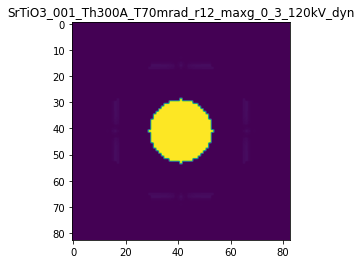

R-factor: 6.874613438261409e-06

>>> producing the 31. dataset...

The offset applied on thickness: -0.000589157345075724

The offset applied on Ug: 0.49592164220666574

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4108426549243
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

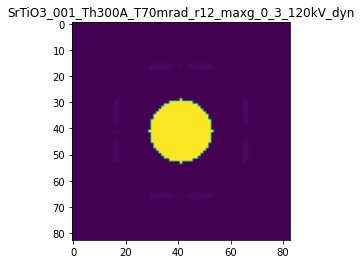

R-factor: 3.430692554653513e-06

>>> producing the 32. dataset...

The offset applied on thickness: 0.00015207894330496917

The offset applied on Ug: -0.3135183523824105

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.15207894330496
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

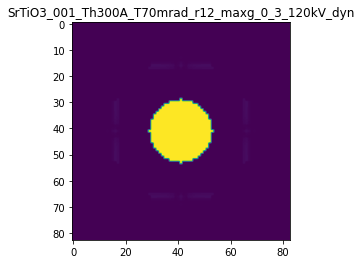

R-factor: 2.0065056580214348e-06

>>> producing the 33. dataset...

The offset applied on thickness: 0.0009256116075522594

The offset applied on Ug: -0.28703718572177084

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.92561160755224
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

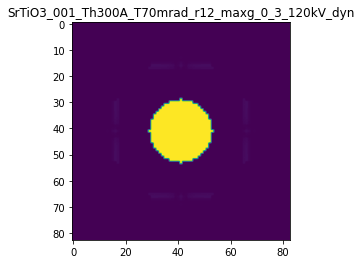

R-factor: 2.4606636822546102e-06

>>> producing the 34. dataset...

The offset applied on thickness: -0.0004637088675971821

The offset applied on Ug: -1.154724350167407

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5362911324028
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

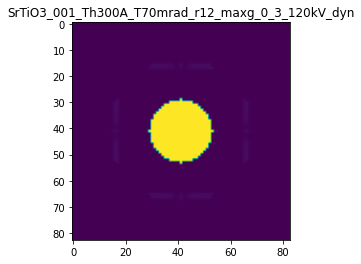

R-factor: 6.805515145591281e-06

>>> producing the 35. dataset...

The offset applied on thickness: -3.5448940068651514e-05

The offset applied on Ug: 1.0679269411666568

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.96455105993135
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

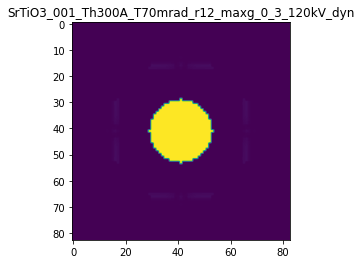

R-factor: 6.661646329608296e-06

>>> producing the 36. dataset...

The offset applied on thickness: -0.00038497870909074506

The offset applied on Ug: -0.7646408733720014

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6150212909092
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

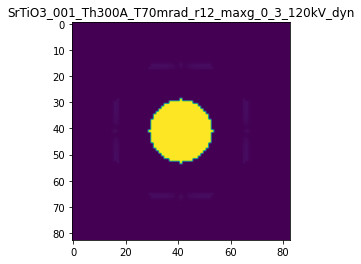

R-factor: 4.513791928375148e-06

>>> producing the 37. dataset...

The offset applied on thickness: -0.0006282900727314236

The offset applied on Ug: -1.0244672829196195

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.37170992726857
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

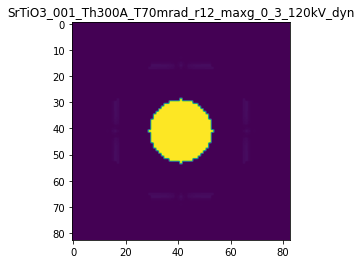

R-factor: 6.021212233348405e-06

>>> producing the 38. dataset...

The offset applied on thickness: 0.0002537253798778045

The offset applied on Ug: -0.8209313159713298

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2537253798778
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

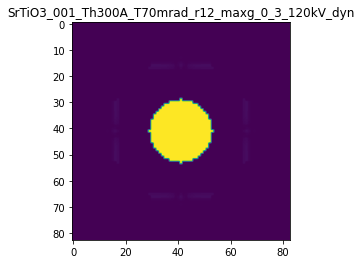

R-factor: 5.120036579120122e-06

>>> producing the 39. dataset...

The offset applied on thickness: 0.0004986200680773623

The offset applied on Ug: -0.451935360533879

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.49862006807734
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

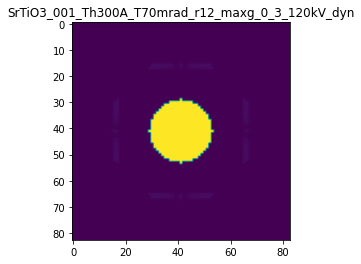

R-factor: 3.0781494487435205e-06

>>> producing the 40. dataset...

The offset applied on thickness: -0.0008295304604222682

The offset applied on Ug: 0.146656813307587

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1704695395777
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

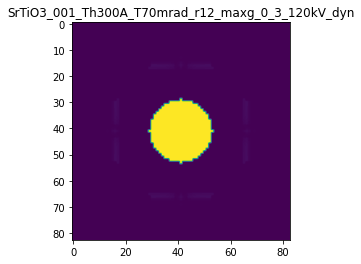

R-factor: 1.5886616749093996e-06

>>> producing the 41. dataset...

The offset applied on thickness: -0.0007181793945493842

The offset applied on Ug: 0.3250972807262224

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2818206054506
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

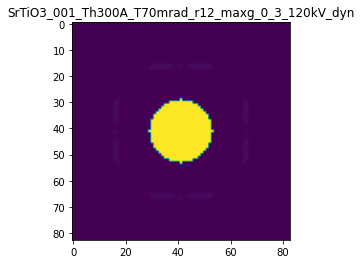

R-factor: 2.502214813861447e-06

>>> producing the 42. dataset...

The offset applied on thickness: -0.0006655718219078126

The offset applied on Ug: -0.2752034077806948

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3344281780922
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

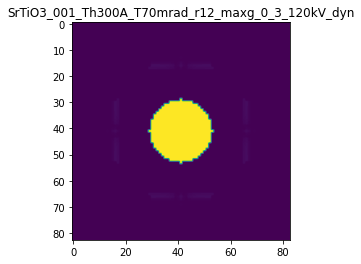

R-factor: 1.7739285330570791e-06

>>> producing the 43. dataset...

The offset applied on thickness: -0.00040822735465161287

The offset applied on Ug: -0.3740238772871021

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5917726453484
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

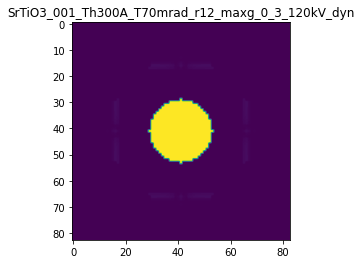

R-factor: 2.2086985167705584e-06

>>> producing the 44. dataset...

The offset applied on thickness: 0.00021256874115736468

The offset applied on Ug: -0.8378027646758059

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2125687411574
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

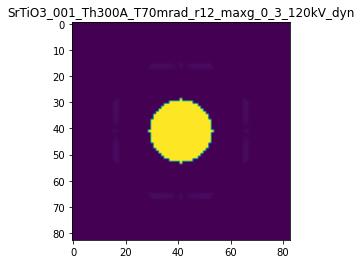

R-factor: 5.194594247653536e-06

>>> producing the 45. dataset...

The offset applied on thickness: 0.0004978867834881992

The offset applied on Ug: 0.027721896083291994

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4978867834882
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

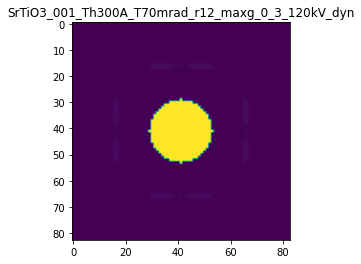

R-factor: 6.63804838280612e-07

>>> producing the 46. dataset...

The offset applied on thickness: -0.0008879252597956082

The offset applied on Ug: -1.274521636837638

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1120747402044
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

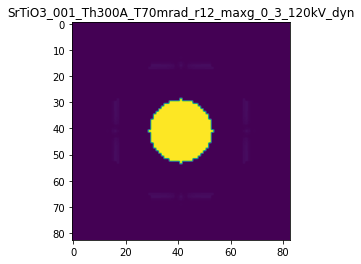

R-factor: 7.461376458398626e-06

>>> producing the 47. dataset...

The offset applied on thickness: 0.0005628113455079502

The offset applied on Ug: -1.2059087432201492

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.56281134550795
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

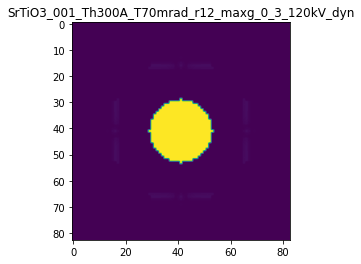

R-factor: 7.593157276843048e-06

>>> producing the 48. dataset...

The offset applied on thickness: 0.00044165309054472826

The offset applied on Ug: -0.8995357110759679

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4416530905447
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

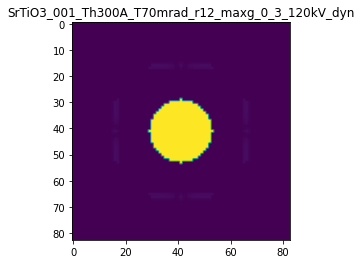

R-factor: 5.7101817400897315e-06

>>> producing the 49. dataset...

The offset applied on thickness: 0.00015877527099342426

The offset applied on Ug: 0.08265943870570595

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.15877527099343
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

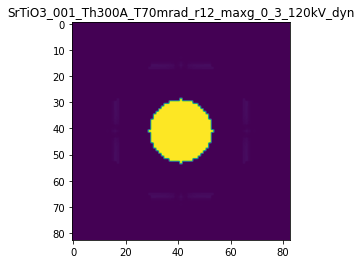

R-factor: 5.095813788886843e-07

>>> producing the 50. dataset...

The offset applied on thickness: 0.00010163842522611466

The offset applied on Ug: 0.22600673594656712

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1016384252261
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

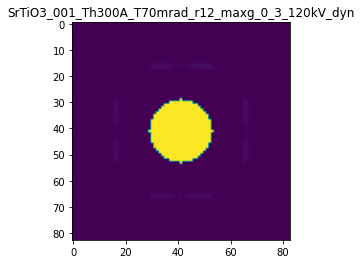

R-factor: 1.3483241429209842e-06

>>> producing the 51. dataset...

The offset applied on thickness: -0.0009343811143785253

The offset applied on Ug: -0.6621353376289867

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.06561888562146
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

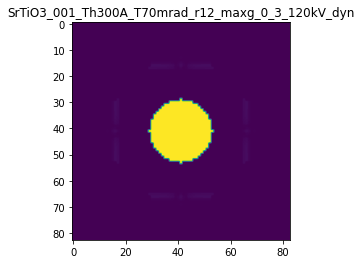

R-factor: 3.969360245835739e-06

>>> producing the 52. dataset...

The offset applied on thickness: 0.0007786676671517019

The offset applied on Ug: 0.8066992847887997

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7786676671517
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

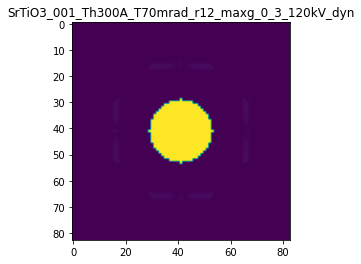

R-factor: 4.776639402426654e-06

>>> producing the 53. dataset...

The offset applied on thickness: 0.0004736773344578036

The offset applied on Ug: 0.18796734442744678

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.47367733445776
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

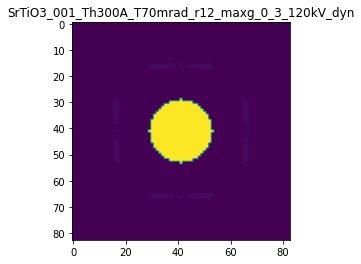

R-factor: 1.2187751018052624e-06

>>> producing the 54. dataset...

The offset applied on thickness: 4.3504134947590865e-05

The offset applied on Ug: -0.5940700496943393

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.04350413494757
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

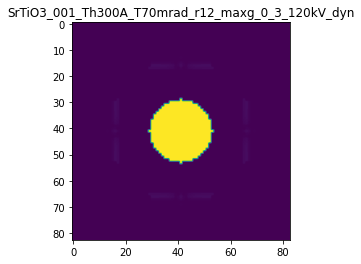

R-factor: 3.6363104329403497e-06

>>> producing the 55. dataset...

The offset applied on thickness: 0.0005607220058867461

The offset applied on Ug: 0.06541798462308179

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.56072200588676
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

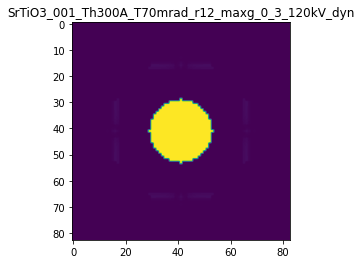

R-factor: 8.081319264225518e-07

>>> producing the 56. dataset...

The offset applied on thickness: -0.00030462953097237767

The offset applied on Ug: 0.004863117317736681

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.69537046902764
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

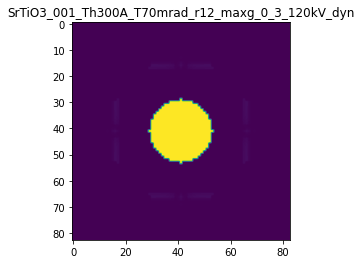

R-factor: 3.8563193294218615e-07

>>> producing the 57. dataset...

The offset applied on thickness: -0.00015657033380273244

The offset applied on Ug: 0.8318118043676132

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.84342966619727
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

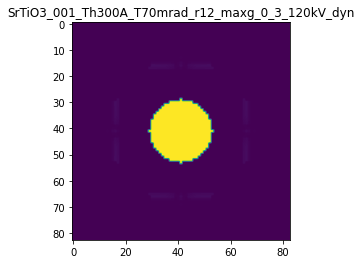

R-factor: 5.243571933767559e-06

>>> producing the 58. dataset...

The offset applied on thickness: -0.0001282766286402366

The offset applied on Ug: -0.06306345578502999

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.87172337135974
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

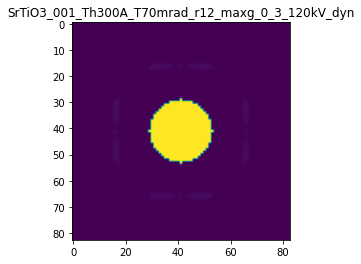

R-factor: 3.9235307133344586e-07

>>> producing the 59. dataset...

The offset applied on thickness: 0.0007593110816241569

The offset applied on Ug: -0.4633909835398532

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7593110816241
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

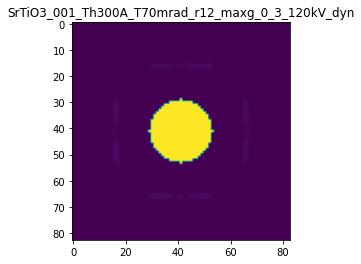

R-factor: 3.3415768848168433e-06

>>> producing the 60. dataset...

The offset applied on thickness: -0.0009365060025279825

The offset applied on Ug: -0.1307166441690026

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.063493997472
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

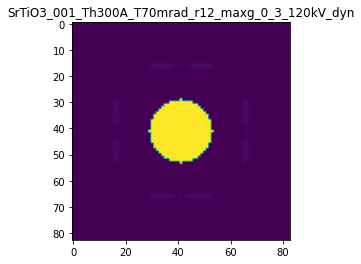

R-factor: 1.3926508039232813e-06

>>> producing the 61. dataset...

The offset applied on thickness: -0.0005239710629573764

The offset applied on Ug: 1.151456037287863

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4760289370426
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

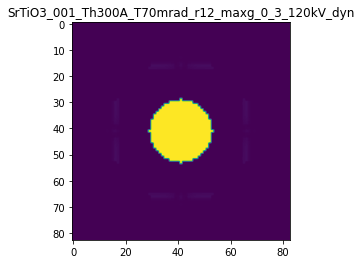

R-factor: 7.448918425962399e-06

>>> producing the 62. dataset...

The offset applied on thickness: -0.00015903157645038557

The offset applied on Ug: 0.13383515554652634

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8409684235496
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

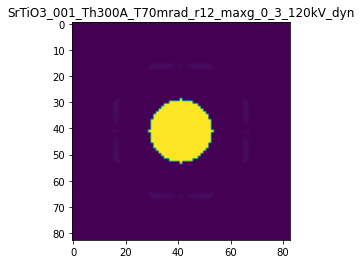

R-factor: 9.240027758261798e-07

>>> producing the 63. dataset...

The offset applied on thickness: 0.0007433258432470853

The offset applied on Ug: -0.9149698714678198

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7433258432471
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

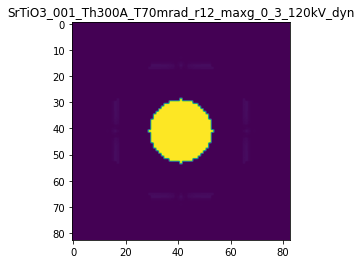

R-factor: 6.0090840248481945e-06

>>> producing the 64. dataset...

The offset applied on thickness: 0.0009085914579260715

The offset applied on Ug: -0.3700289984678244

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.90859145792604
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

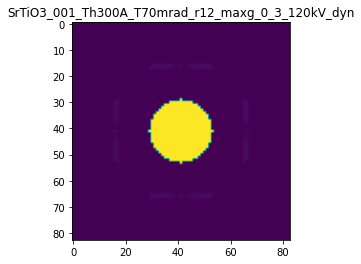

R-factor: 2.9224402132883413e-06

>>> producing the 65. dataset...

The offset applied on thickness: 0.0006609772880107059

The offset applied on Ug: 0.3145680450487478

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6609772880107
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

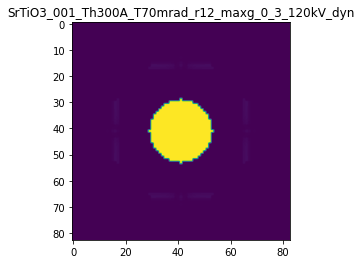

R-factor: 1.9615336607980676e-06

>>> producing the 66. dataset...

The offset applied on thickness: 0.0009692393652950228

The offset applied on Ug: -0.9826109627381311

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.96923936529504
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

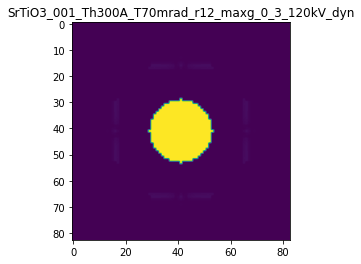

R-factor: 6.5682157104818225e-06

>>> producing the 67. dataset...

The offset applied on thickness: -0.0006341379064956536

The offset applied on Ug: -1.107012654644046

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.36586209350435
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

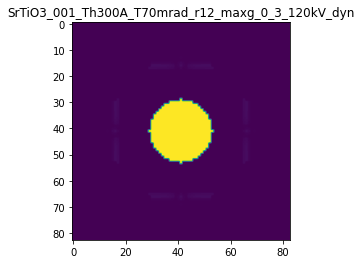

R-factor: 6.505235543568454e-06

>>> producing the 68. dataset...

The offset applied on thickness: 8.319159943936461e-05

The offset applied on Ug: 0.9596849158458796

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0831915994394
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

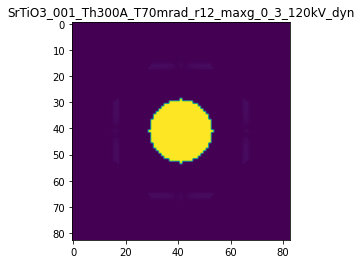

R-factor: 5.922479335310821e-06

>>> producing the 69. dataset...

The offset applied on thickness: -0.0002504361351160487

The offset applied on Ug: -0.38632845511721825

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.74956386488395
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

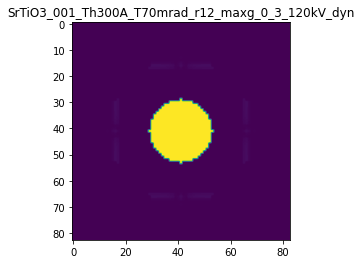

R-factor: 2.2822787318437475e-06

>>> producing the 70. dataset...

The offset applied on thickness: 0.0003182627326212273

The offset applied on Ug: -0.5928296556757229

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3182627326212
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

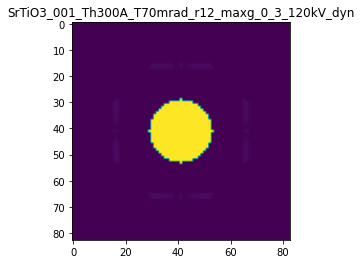

R-factor: 3.7996880457083393e-06

>>> producing the 71. dataset...

The offset applied on thickness: 0.0008070148662100012

The offset applied on Ug: 0.39726753925705

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.80701486620995
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

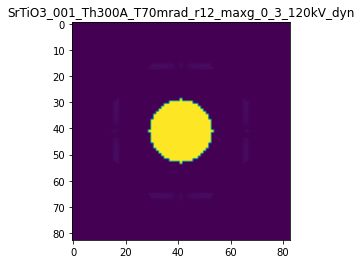

R-factor: 2.4617850807138865e-06

>>> producing the 72. dataset...

The offset applied on thickness: -0.000833464059641732

The offset applied on Ug: 0.34451432736716214

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.16653594035824
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

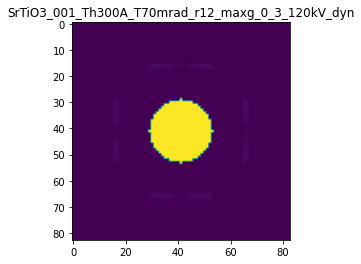

R-factor: 2.7117418386454156e-06

>>> producing the 73. dataset...

The offset applied on thickness: 0.0008005481699527662

The offset applied on Ug: -0.2500144253651175

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8005481699528
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

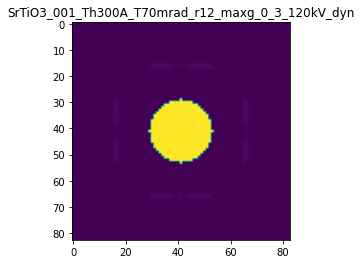

R-factor: 2.1380537754689073e-06

>>> producing the 74. dataset...

The offset applied on thickness: -0.00035891366951427116

The offset applied on Ug: 0.6237847630738006

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6410863304857
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

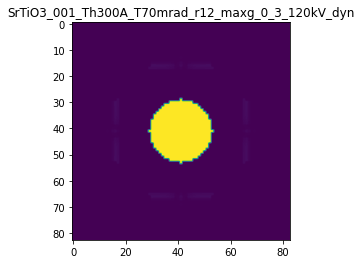

R-factor: 4.066320660551921e-06

>>> producing the 75. dataset...

The offset applied on thickness: 0.0003601004392982041

The offset applied on Ug: -0.10470094732404078

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.36010043929815
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

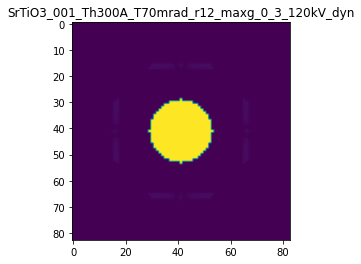

R-factor: 9.175090515113315e-07

>>> producing the 76. dataset...

The offset applied on thickness: 0.0003617455552852642

The offset applied on Ug: -1.2088137304236906

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.36174555528527
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

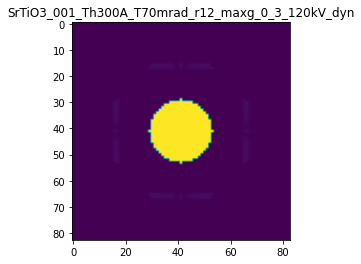

R-factor: 7.475607122241228e-06

>>> producing the 77. dataset...

The offset applied on thickness: -0.00011155237064616142

The offset applied on Ug: -1.0064445417579604

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.88844762935383
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

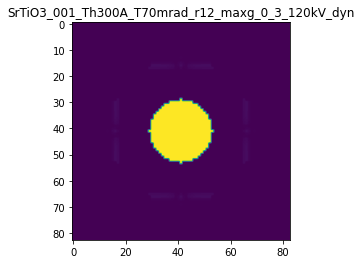

R-factor: 6.020850957803944e-06

>>> producing the 78. dataset...

The offset applied on thickness: 0.00011722127435992059

The offset applied on Ug: -0.8314175690489637

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1172212743599
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

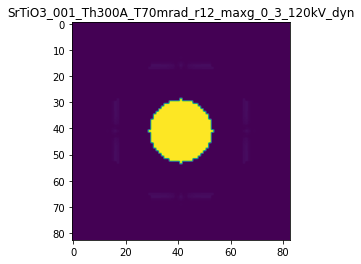

R-factor: 5.099130007203938e-06

>>> producing the 79. dataset...

The offset applied on thickness: -0.0009039786899400117

The offset applied on Ug: 0.47774977088096565

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.09602131006
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

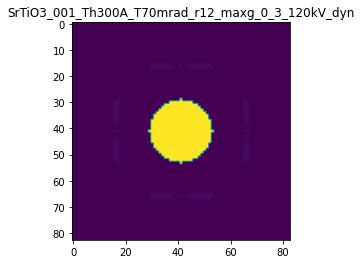

R-factor: 3.5537148025370143e-06

>>> producing the 80. dataset...

The offset applied on thickness: -0.0007011279484292103

The offset applied on Ug: 0.5290363351244696

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2988720515708
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

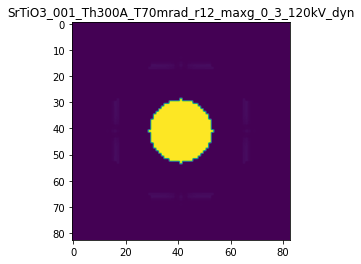

R-factor: 3.7113698729906187e-06

>>> producing the 81. dataset...

The offset applied on thickness: -0.0007701613758744341

The offset applied on Ug: -0.3293068930921524

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.22983862412553
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

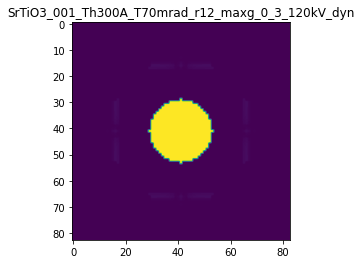

R-factor: 2.1076006456206825e-06

>>> producing the 82. dataset...

The offset applied on thickness: -0.00041637932538270573

The offset applied on Ug: -0.8285389310021333

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5836206746173
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

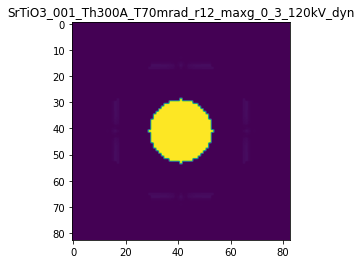

R-factor: 4.888439110679565e-06

>>> producing the 83. dataset...

The offset applied on thickness: 5.2751823143494694e-05

The offset applied on Ug: 0.3908407322941503

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0527518231435
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

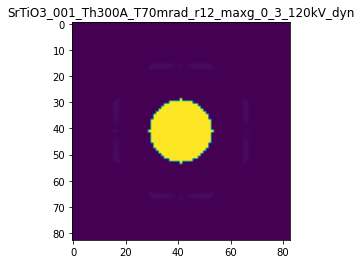

R-factor: 2.386049855333749e-06

>>> producing the 84. dataset...

The offset applied on thickness: 0.0007619342727936993

The offset applied on Ug: 0.4375132510944934

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.76193427279367
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

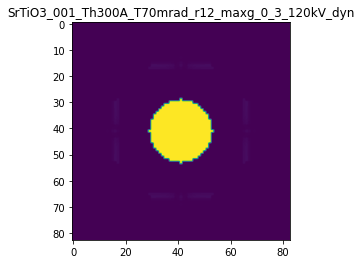

R-factor: 2.659994808523292e-06

>>> producing the 85. dataset...

The offset applied on thickness: 0.0003151828590671757

The offset applied on Ug: -0.4924259841128776

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3151828590672
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

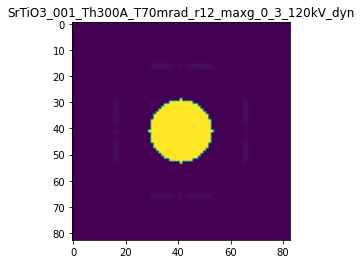

R-factor: 3.1946583276063543e-06

>>> producing the 86. dataset...

The offset applied on thickness: -0.0004460540554383812

The offset applied on Ug: 0.15353336863833333

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5539459445616
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

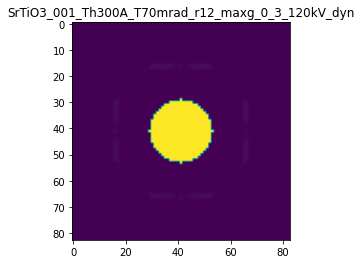

R-factor: 1.2717555396519187e-06

>>> producing the 87. dataset...

The offset applied on thickness: 0.0009444571249969358

The offset applied on Ug: 0.24088247480081806

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9444571249969
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

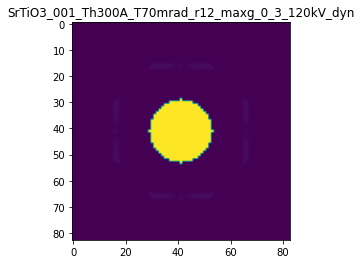

R-factor: 1.783533038766124e-06

>>> producing the 88. dataset...

The offset applied on thickness: -0.0004770005193489715

The offset applied on Ug: 1.0938764500517772

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.52299948065104
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

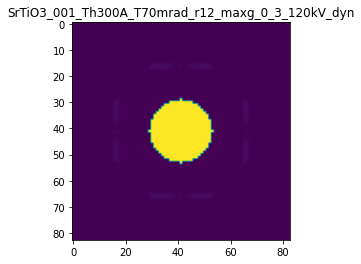

R-factor: 7.061441769994338e-06

>>> producing the 89. dataset...

The offset applied on thickness: -0.0009556601666634592

The offset applied on Ug: -0.551213741476669

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0443398333365
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

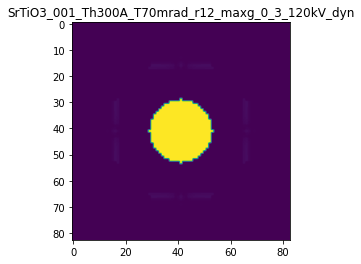

R-factor: 3.3650152983959453e-06

>>> producing the 90. dataset...

The offset applied on thickness: -0.0005068987949031381

The offset applied on Ug: 0.3021981953826841

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4931012050969
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

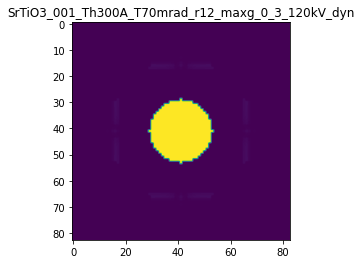

R-factor: 2.1966733083484188e-06

>>> producing the 91. dataset...

The offset applied on thickness: 0.0004734654098291333

The offset applied on Ug: 0.8293810809731249

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4734654098291
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

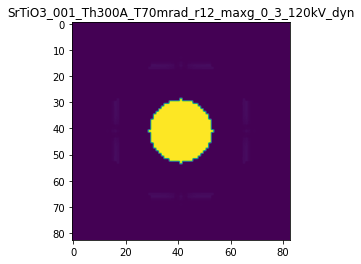

R-factor: 4.9438542348582434e-06

>>> producing the 92. dataset...

The offset applied on thickness: -0.00033524860370577625

The offset applied on Ug: 0.08484042390834276

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6647513962942
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

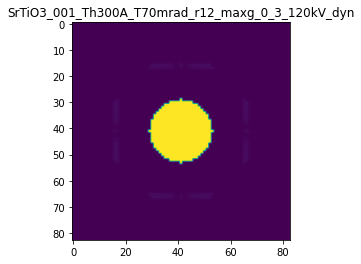

R-factor: 7.822466508791935e-07

>>> producing the 93. dataset...

The offset applied on thickness: -0.000976682232868554

The offset applied on Ug: -0.5835189116140563

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0233177671314
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

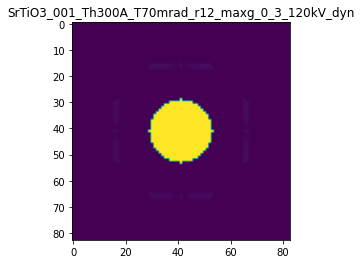

R-factor: 3.549935446710815e-06

>>> producing the 94. dataset...

The offset applied on thickness: -0.000637142747454056

The offset applied on Ug: -1.1461376361755604

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3628572525459
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

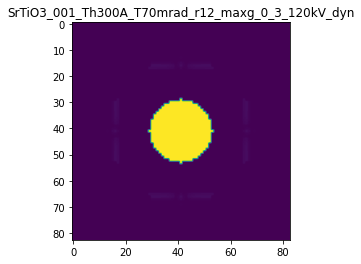

R-factor: 6.734301845505693e-06

>>> producing the 95. dataset...

The offset applied on thickness: 0.0003707719317082949

The offset applied on Ug: 1.1880538210070015

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3707719317083
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

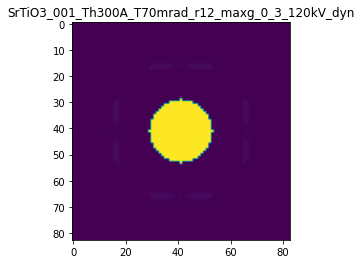

R-factor: 7.222083188651054e-06

>>> producing the 96. dataset...

The offset applied on thickness: 0.0009507825526787301

The offset applied on Ug: 1.1944654564259083

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.95078255267873
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

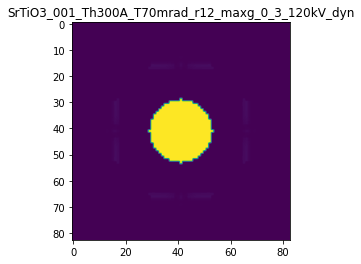

R-factor: 7.087303066812076e-06

>>> producing the 97. dataset...

The offset applied on thickness: 0.00037181524513582364

The offset applied on Ug: 0.9158594303312143

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3718152451358
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

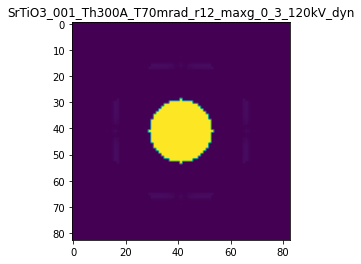

R-factor: 5.510059554655516e-06

>>> producing the 98. dataset...

The offset applied on thickness: -0.0008445272233170458

The offset applied on Ug: 0.4755569486444773

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1554727766829
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

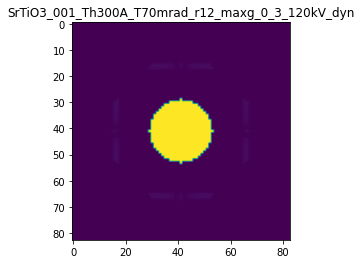

R-factor: 3.4942580481312562e-06

>>> producing the 99. dataset...

The offset applied on thickness: 9.387854855470357e-05

The offset applied on Ug: 0.8441662952544988

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0938785485547
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

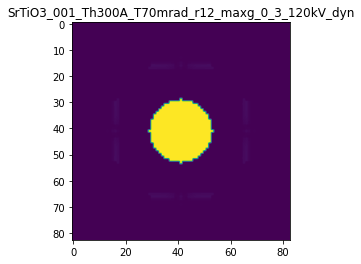

R-factor: 5.192246707049376e-06

>>> producing the 100. dataset...

The offset applied on thickness: 2.7233558745972885e-05

The offset applied on Ug: 1.088448332926681

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.02723355874593
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

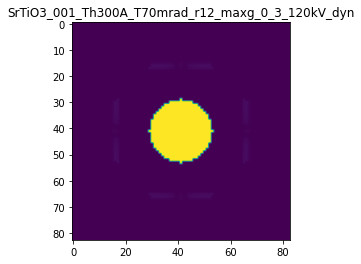

R-factor: 6.759494139199248e-06

>>> producing the 101. dataset...

The offset applied on thickness: 0.000807489213647828

The offset applied on Ug: -0.6686545876506574

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8074892136478
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

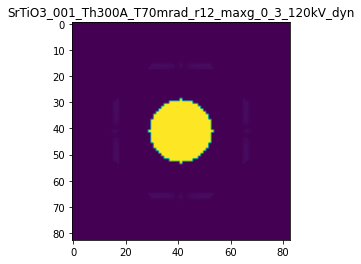

R-factor: 4.5946087154354905e-06

>>> producing the 102. dataset...

The offset applied on thickness: -0.00029812303189398714

The offset applied on Ug: -1.0517615425105944

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.70187696810603
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

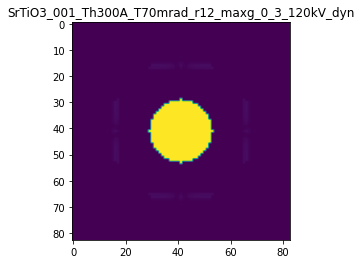

R-factor: 6.232880683947873e-06

>>> producing the 103. dataset...

The offset applied on thickness: -0.00027360538193378246

The offset applied on Ug: -0.2852816846702368

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7263946180662
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

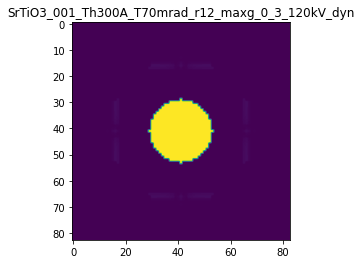

R-factor: 1.68173978221704e-06

>>> producing the 104. dataset...

The offset applied on thickness: 0.0007233134367788674

The offset applied on Ug: 0.17498465834191648

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7233134367789
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

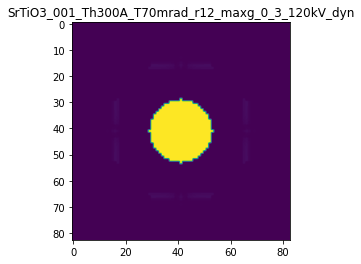

R-factor: 1.3234717732408791e-06

>>> producing the 105. dataset...

The offset applied on thickness: -0.00013511753196379273

The offset applied on Ug: 1.0086589640507597

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8648824680362
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

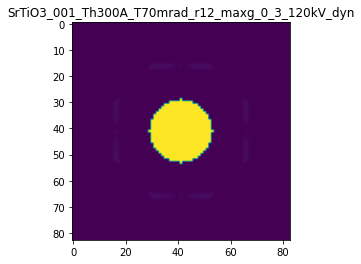

R-factor: 6.340452104613701e-06

>>> producing the 106. dataset...

The offset applied on thickness: 0.0008508928318715534

The offset applied on Ug: 0.38558157106086155

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.85089283187153
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

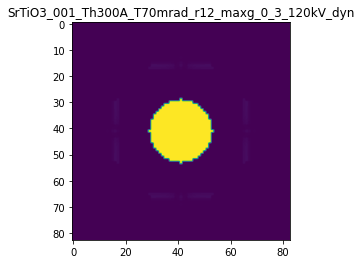

R-factor: 2.4247660977482623e-06

>>> producing the 107. dataset...

The offset applied on thickness: -0.0006246134565871626

The offset applied on Ug: -0.8344854043732787

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.37538654341284
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

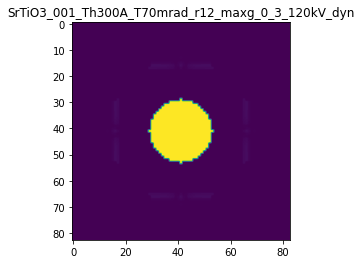

R-factor: 4.904715868563399e-06

>>> producing the 108. dataset...

The offset applied on thickness: 0.0009832848537862785

The offset applied on Ug: -0.6998993404304079

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9832848537863
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

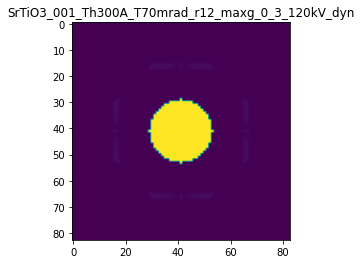

R-factor: 4.911049446121339e-06

>>> producing the 109. dataset...

The offset applied on thickness: 0.0005575186468936169

The offset applied on Ug: 1.111334329218565

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.55751864689364
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

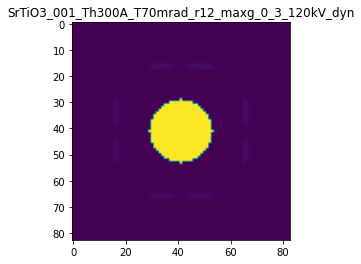

R-factor: 6.660920684848876e-06

>>> producing the 110. dataset...

The offset applied on thickness: -4.558295861864093e-05

The offset applied on Ug: -1.0922942790400911

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.95441704138136
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

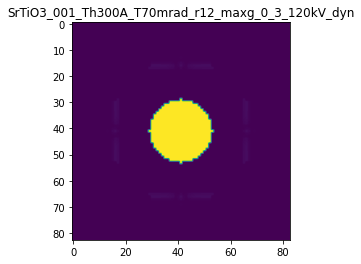

R-factor: 6.556549406896934e-06

>>> producing the 111. dataset...

The offset applied on thickness: -0.00016920623328309348

The offset applied on Ug: 0.5149043790819351

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8307937667169
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

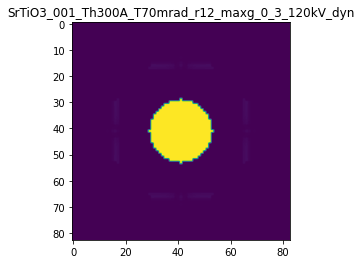

R-factor: 3.276366553515487e-06

>>> producing the 112. dataset...

The offset applied on thickness: 7.152307118756496e-05

The offset applied on Ug: 0.2947925715390082

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0715230711876
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

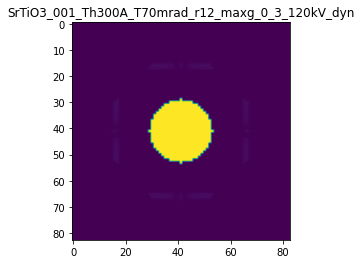

R-factor: 1.7812810553150488e-06

>>> producing the 113. dataset...

The offset applied on thickness: 0.00029892615580384897

The offset applied on Ug: 0.12856924422788354

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2989261558038
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

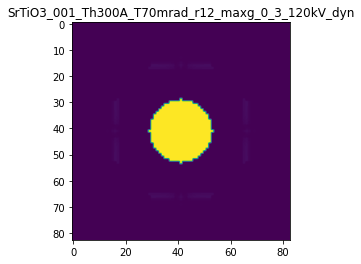

R-factor: 8.187672461496832e-07

>>> producing the 114. dataset...

The offset applied on thickness: -0.0008808944040747166

The offset applied on Ug: -1.234347616106309

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.11910559592525
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

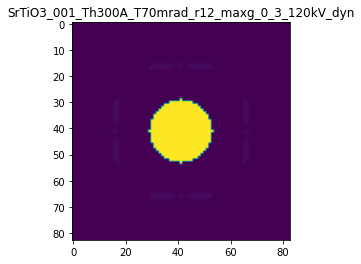

R-factor: 7.228141193223909e-06

>>> producing the 115. dataset...

The offset applied on thickness: -0.0003551145794411545

The offset applied on Ug: -0.550636662498687

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.64488542055886
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

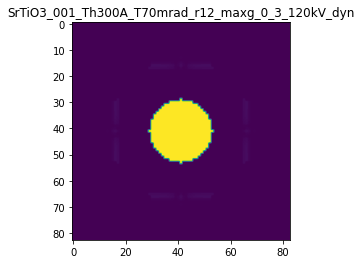

R-factor: 3.249109751566466e-06

>>> producing the 116. dataset...

The offset applied on thickness: 0.0007788473219133352

The offset applied on Ug: 0.45804214087916223

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.77884732191336
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

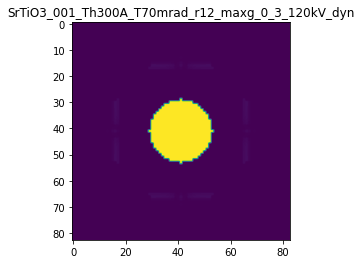

R-factor: 2.7769551348856013e-06

>>> producing the 117. dataset...

The offset applied on thickness: 0.000362039031321431

The offset applied on Ug: 0.9398922337408334

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3620390313214
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

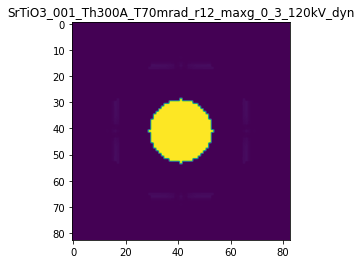

R-factor: 5.664273306082215e-06

>>> producing the 118. dataset...

The offset applied on thickness: 0.0005545949305560254

The offset applied on Ug: -0.9852088805231566

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.55459493055605
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

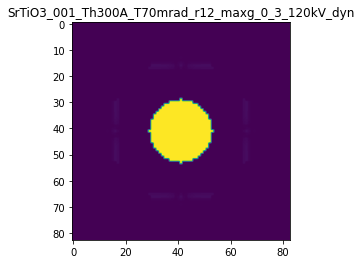

R-factor: 6.293325813800192e-06

>>> producing the 119. dataset...

The offset applied on thickness: 0.00030920715280377455

The offset applied on Ug: -1.1161280478933322

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.30920715280376
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

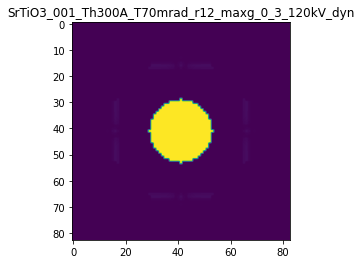

R-factor: 6.899523004872922e-06

>>> producing the 120. dataset...

The offset applied on thickness: -0.00021179978299540236

The offset applied on Ug: 1.21985913522783

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7882002170046
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

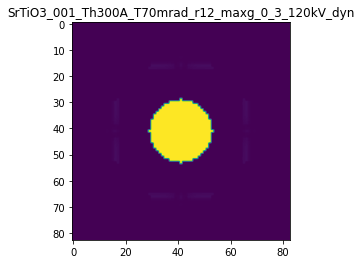

R-factor: 7.707688975647148e-06

>>> producing the 121. dataset...

The offset applied on thickness: -0.0006776866104620798

The offset applied on Ug: -0.4820233873010457

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3223133895379
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

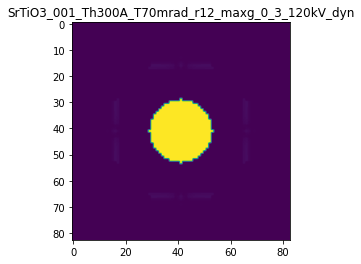

R-factor: 2.8874272413199376e-06

>>> producing the 122. dataset...

The offset applied on thickness: -0.00036214335476254057

The offset applied on Ug: 0.2071334548186357

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.63785664523743
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

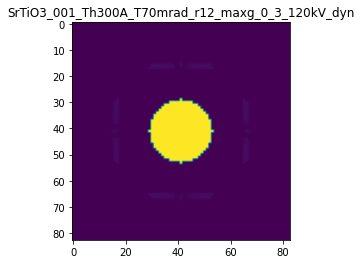

R-factor: 1.5164870310956756e-06

>>> producing the 123. dataset...

The offset applied on thickness: 0.0003703537963839052

The offset applied on Ug: 0.003193422023367987

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3703537963839
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

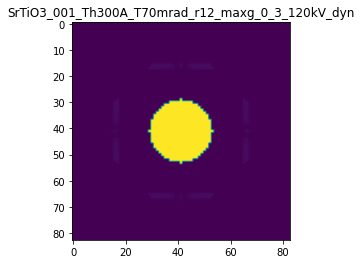

R-factor: 4.6977655028169573e-07

>>> producing the 124. dataset...

The offset applied on thickness: 0.00017980337470365805

The offset applied on Ug: -1.1526253650477054

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1798033747036
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

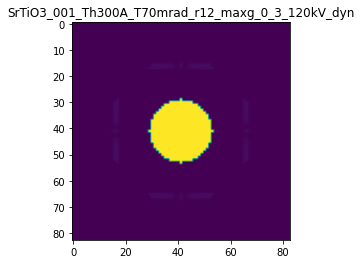

R-factor: 7.033115281311443e-06

>>> producing the 125. dataset...

The offset applied on thickness: -0.0009197857867639052

The offset applied on Ug: -0.004234115711792299

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0802142132361
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

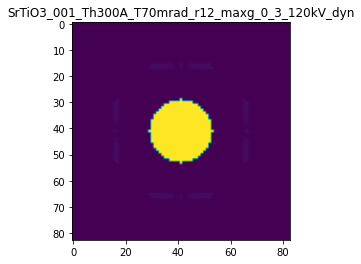

R-factor: 1.159921940132722e-06

>>> producing the 126. dataset...

The offset applied on thickness: -0.0007103007682563417

The offset applied on Ug: -1.2091240970332182

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.28969923174367
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

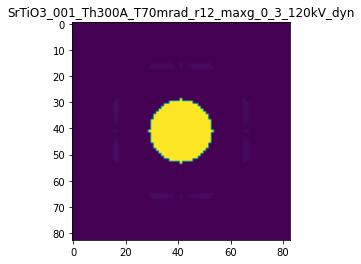

R-factor: 7.094759759462687e-06

>>> producing the 127. dataset...

The offset applied on thickness: 1.852343825566827e-05

The offset applied on Ug: 0.0031953364229428873

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0185234382556
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

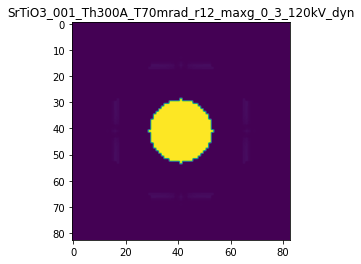

R-factor: 2.9126364941991633e-08

>>> producing the 128. dataset...

The offset applied on thickness: -0.0008018903669367674

The offset applied on Ug: -0.7436927947871499

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1981096330632
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

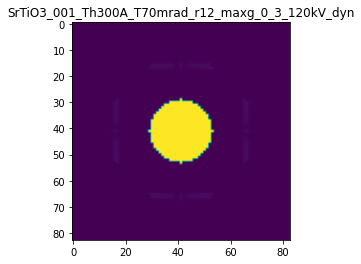

R-factor: 4.388095954300906e-06

>>> producing the 129. dataset...

The offset applied on thickness: -0.0008593580409342289

The offset applied on Ug: 0.40045364409763723

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.14064195906576
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

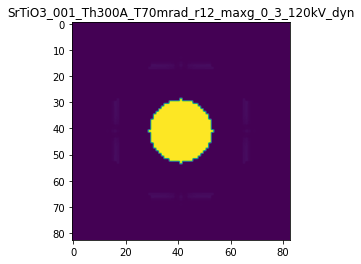

R-factor: 3.061304098123178e-06

>>> producing the 130. dataset...

The offset applied on thickness: 0.0004098480838285028

The offset applied on Ug: -1.0326869039972626

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4098480838285
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

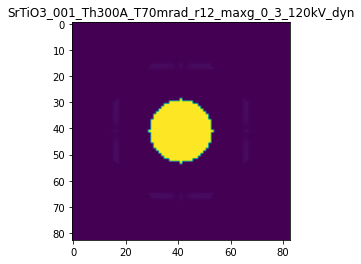

R-factor: 6.4746821168433475e-06

>>> producing the 131. dataset...

The offset applied on thickness: -0.0008249212965275456

The offset applied on Ug: 0.7952469433781891

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1750787034724
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

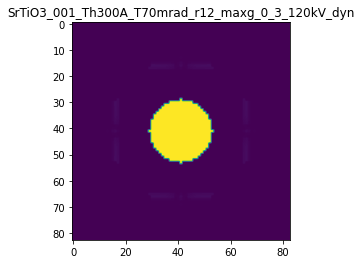

R-factor: 5.426804470124705e-06

>>> producing the 132. dataset...

The offset applied on thickness: 6.388580092589558e-05

The offset applied on Ug: -0.7585234735531089

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0638858009259
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

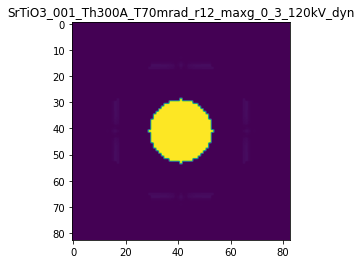

R-factor: 4.6333896409628775e-06

>>> producing the 133. dataset...

The offset applied on thickness: -0.0008300459593175351

The offset applied on Ug: 0.7937050042920857

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.16995404068246
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

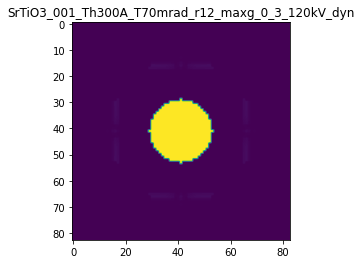

R-factor: 5.420764560683124e-06

>>> producing the 134. dataset...

The offset applied on thickness: -0.00018291124868907005

The offset applied on Ug: -0.3421505493918335

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8170887513109
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

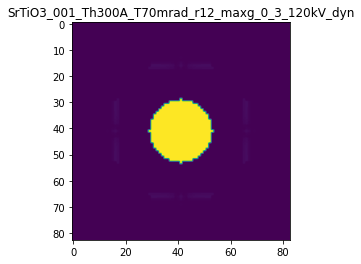

R-factor: 2.0263308512932807e-06

>>> producing the 135. dataset...

The offset applied on thickness: 0.0005874693410385135

The offset applied on Ug: -0.22965116780710587

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5874693410385
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

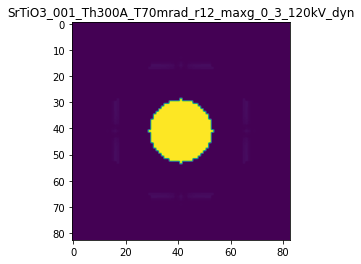

R-factor: 1.834373056178695e-06

>>> producing the 136. dataset...

The offset applied on thickness: -0.0005811824303807745

The offset applied on Ug: -0.44884098984628396

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4188175696192
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

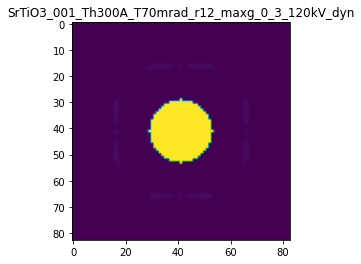

R-factor: 2.6711780144082906e-06

>>> producing the 137. dataset...

The offset applied on thickness: 0.0006161341478467486

The offset applied on Ug: -0.15302706685081377

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6161341478467
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

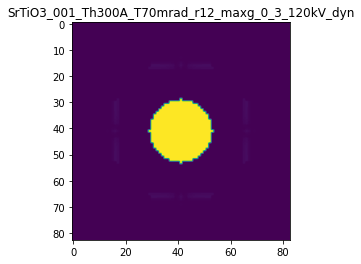

R-factor: 1.4228513863091291e-06

>>> producing the 138. dataset...

The offset applied on thickness: 0.0006540186402115276

The offset applied on Ug: -0.6512166279072801

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6540186402115
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

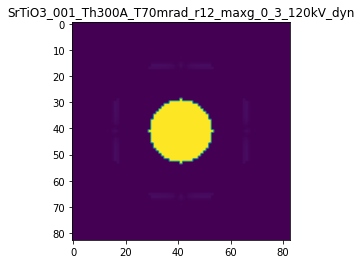

R-factor: 4.379903200060369e-06

>>> producing the 139. dataset...

The offset applied on thickness: -0.000702545456470294

The offset applied on Ug: -1.1032544711992573

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2974545435297
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

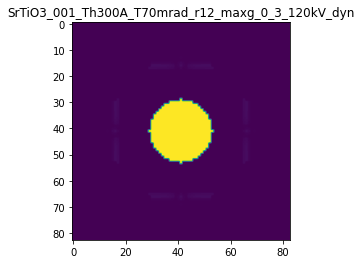

R-factor: 6.4756912976688475e-06

>>> producing the 140. dataset...

The offset applied on thickness: -5.6987040464595794e-05

The offset applied on Ug: -0.5203620407732115

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9430129595354
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

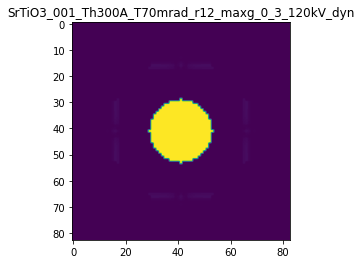

R-factor: 3.1376553424964876e-06



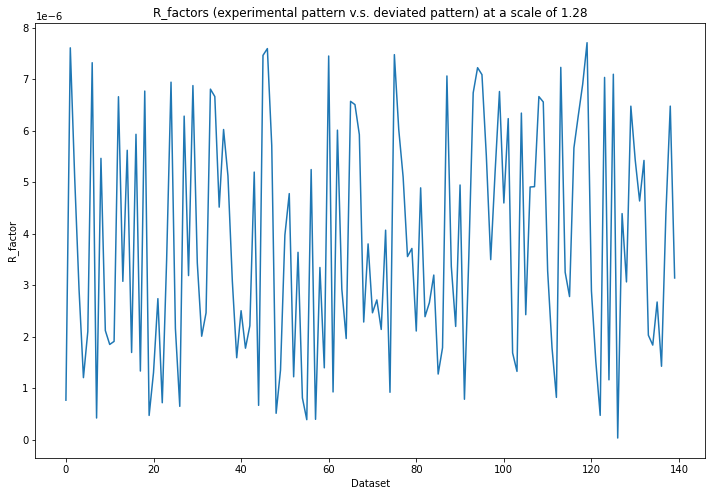

>>> start to train the ANN 

Epoch 1/30
5/5 [==============================] - 1s 131ms/step - loss: 0.3591 - acc: 0.8000 - val_loss: 0.3532 - val_acc: 1.0000
Epoch 2/30
5/5 [==============================] - 1s 109ms/step - loss: 0.3388 - acc: 1.0000 - val_loss: 0.3129 - val_acc: 1.0000
Epoch 3/30
5/5 [==============================] - 1s 109ms/step - loss: 0.2882 - acc: 1.0000 - val_loss: 0.2503 - val_acc: 1.0000
Epoch 4/30
5/5 [==============================] - 1s 108ms/step - loss: 0.2321 - acc: 1.0000 - val_loss: 0.2044 - val_acc: 1.0000
Epoch 5/30
5/5 [==============================] - 1s 108ms/step - loss: 0.1860 - acc: 1.0000 - val_loss: 0.1590 - val_acc: 1.0000
Epoch 6/30
5/5 [==============================] - 1s 109ms/step - loss: 0.1452 - acc: 1.0000 - val_loss: 0.1323 - val_acc: 1.0000
Epoch 7/30
5/5 [==============================] - 1s 109ms/step - loss: 0.1157 - acc: 1.0000 - val_loss: 0.0952 - val_acc: 1.0000
Epoch 8/30
5/5 [==============================] - 1s 109ms/st

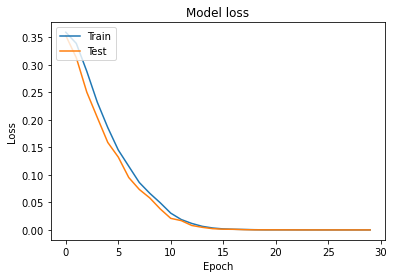

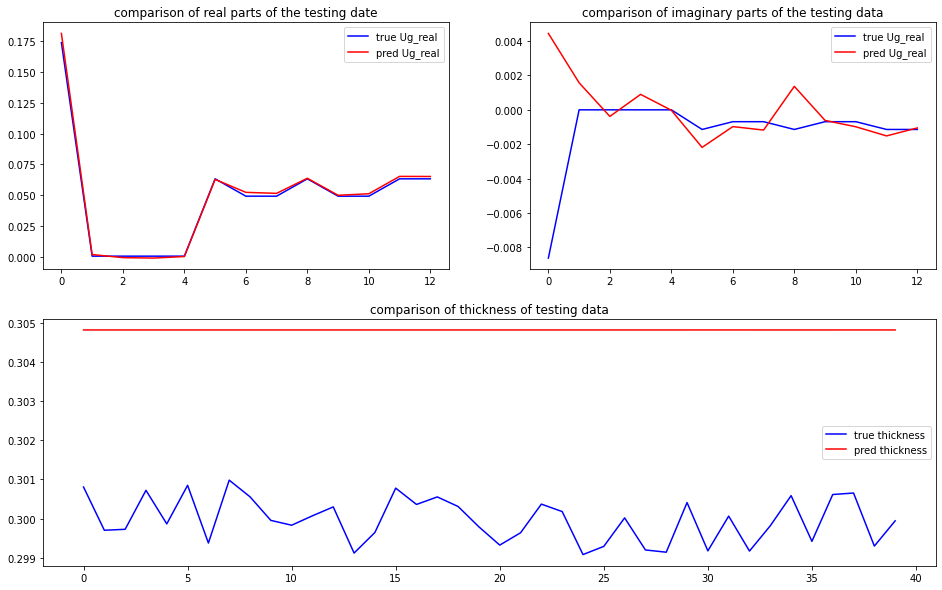

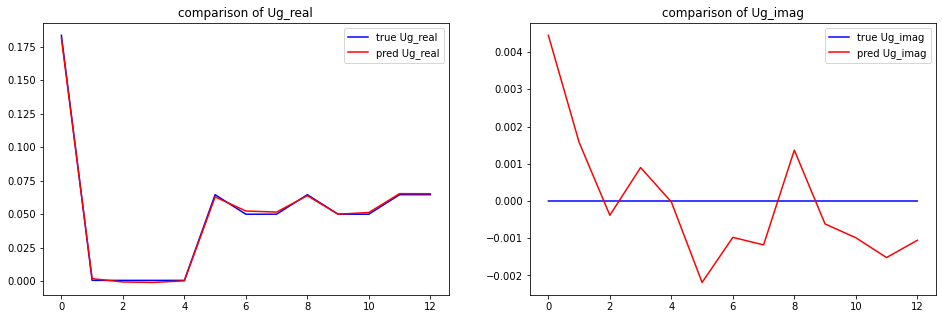

predicted thickness: 30.48245906829834 nm
mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=304.8245906829834
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 13 different beams

InputUg:
[ 0.18142685+0.00000000e+00j  0.

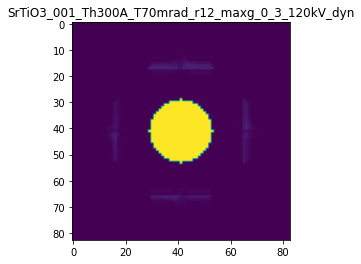

X_sim.max(): 0.9999942111915391
R-factor at a scale of 1.28 is 0.0004275655101173064.

-----------------------------------------------------------------------------------------------------

>>> start to produce Dataset at a scale of 2.56

-----------------------------------------------------------------------------------------------------

>>> producing the 1. dataset...

The offset applied on thickness: 0.00011776037195418754

The offset applied on Ug: -0.23471843997315717

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001

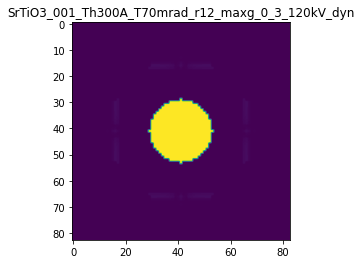

R-factor: 1.5062569841968082e-06

>>> producing the 2. dataset...

The offset applied on thickness: -0.0008589626650655964

The offset applied on Ug: 2.034140284489354

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1410373349344
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

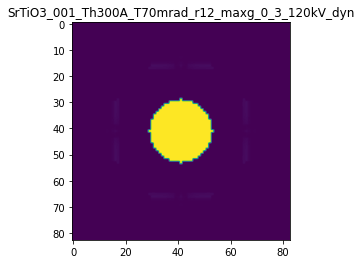

R-factor: 1.3177064548263125e-05

>>> producing the 3. dataset...

The offset applied on thickness: 0.0004713859393017934

The offset applied on Ug: -1.8218557281254681

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4713859393018
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

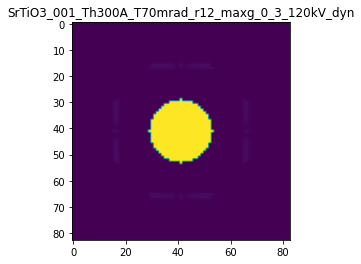

R-factor: 1.1061028579499879e-05

>>> producing the 4. dataset...

The offset applied on thickness: -0.0005842025996755778

The offset applied on Ug: 0.6169428816624014

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.41579740032444
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

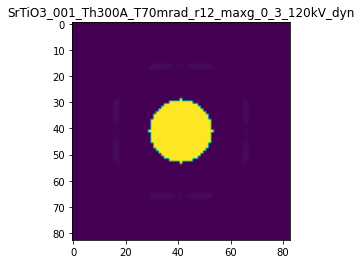

R-factor: 4.169290955575221e-06

>>> producing the 5. dataset...

The offset applied on thickness: 0.0006940828109081787

The offset applied on Ug: -1.8295942044085711

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6940828109081
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

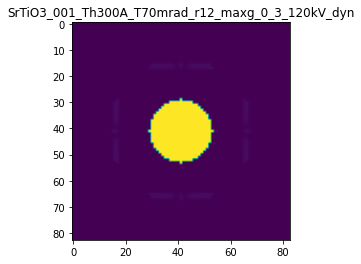

R-factor: 1.1255584951193179e-05

>>> producing the 6. dataset...

The offset applied on thickness: 0.0007742325541306554

The offset applied on Ug: -2.150696396846825

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.77423255413066
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

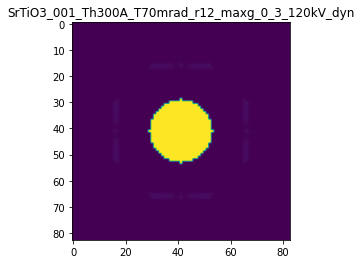

R-factor: 1.3092987222122059e-05

>>> producing the 7. dataset...

The offset applied on thickness: 0.0009171055905002201

The offset applied on Ug: 0.8074030854577876

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9171055905002
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

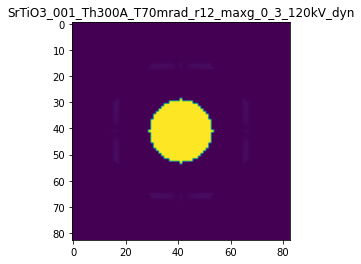

R-factor: 4.7795438742095986e-06

>>> producing the 8. dataset...

The offset applied on thickness: 0.0008011906619104397

The offset applied on Ug: 1.5615402086541394

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8011906619104
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

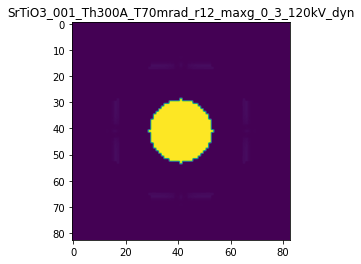

R-factor: 9.387652816300297e-06

>>> producing the 9. dataset...

The offset applied on thickness: 2.7433054071966502e-05

The offset applied on Ug: -0.6190844758524855

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.027433054072
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

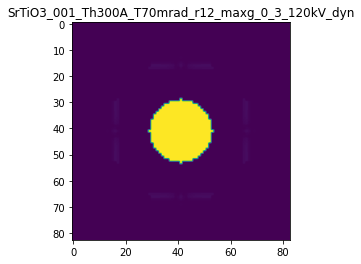

R-factor: 3.7773843327558854e-06

>>> producing the 10. dataset...

The offset applied on thickness: 0.0009071989573789859

The offset applied on Ug: 2.473045404376393

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.907198957379
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

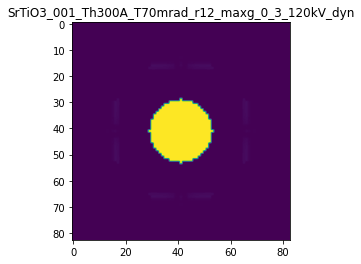

R-factor: 1.5137063420706726e-05

>>> producing the 11. dataset...

The offset applied on thickness: 7.116910801516107e-05

The offset applied on Ug: -1.5355713612368675

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0711691080151
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

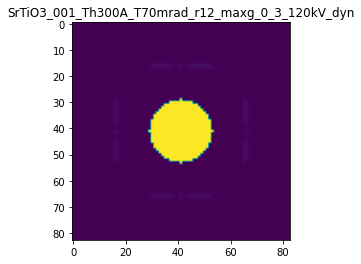

R-factor: 9.200332882695773e-06

>>> producing the 12. dataset...

The offset applied on thickness: -5.608268994454502e-05

The offset applied on Ug: -1.799070586120035

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.94391731005544
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

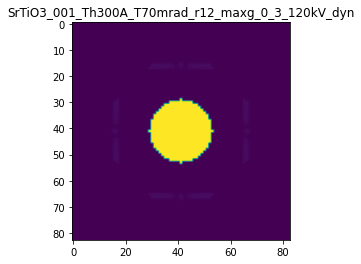

R-factor: 1.066617602427926e-05

>>> producing the 13. dataset...

The offset applied on thickness: 0.00031556202926634236

The offset applied on Ug: -1.2734553713489505

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.31556202926635
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

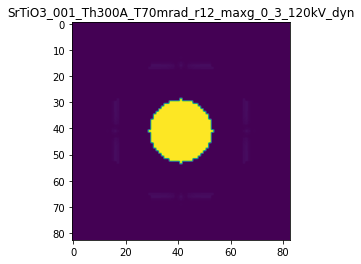

R-factor: 7.822774153522282e-06

>>> producing the 14. dataset...

The offset applied on thickness: 0.0007665663792360892

The offset applied on Ug: -1.897985205188565

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7665663792361
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

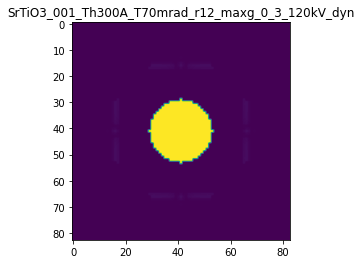

R-factor: 1.1689122610943963e-05

>>> producing the 15. dataset...

The offset applied on thickness: -0.00041679922008597584

The offset applied on Ug: -0.9425638919921738

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.583200779914
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

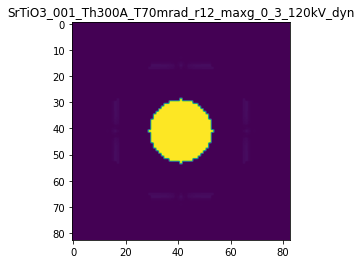

R-factor: 5.562678068463956e-06

>>> producing the 16. dataset...

The offset applied on thickness: -0.0008139978982134046

The offset applied on Ug: 1.8799944677560882

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1860021017866
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

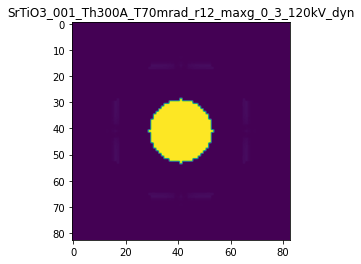

R-factor: 1.2183925198237896e-05

>>> producing the 17. dataset...

The offset applied on thickness: -0.0008460889563263575

The offset applied on Ug: -1.6361473670903235

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1539110436736
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

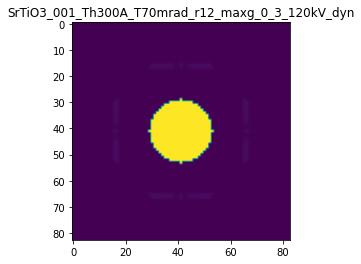

R-factor: 9.55999088103193e-06

>>> producing the 18. dataset...

The offset applied on thickness: 0.0007077703923389236

The offset applied on Ug: 1.409462042880711

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.70777039233894
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

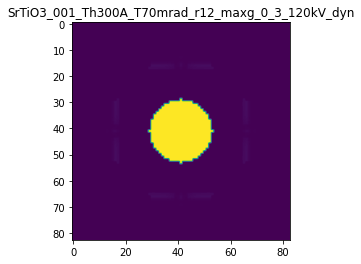

R-factor: 8.467789035301093e-06

>>> producing the 19. dataset...

The offset applied on thickness: -0.00033107971652904825

The offset applied on Ug: -1.8358681705158808

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6689202834709
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

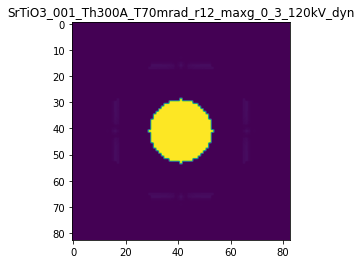

R-factor: 1.0798929716841414e-05

>>> producing the 20. dataset...

The offset applied on thickness: 0.0008817533835490996

The offset applied on Ug: 2.271876590556691

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8817533835491
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

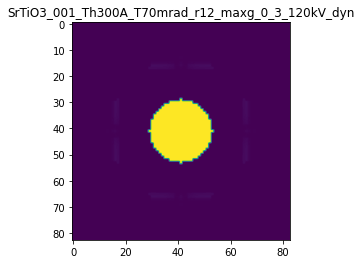

R-factor: 1.3866614725234741e-05

>>> producing the 21. dataset...

The offset applied on thickness: -0.0005108610602802122

The offset applied on Ug: -1.5633472829064148

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4891389397198
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

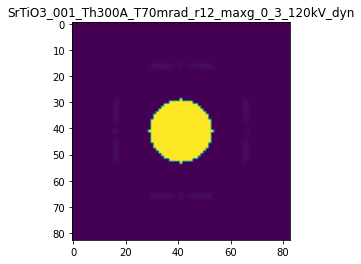

R-factor: 9.183876384681363e-06

>>> producing the 22. dataset...

The offset applied on thickness: -0.00045457083640592066

The offset applied on Ug: 2.495338013340919

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.54542916359406
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

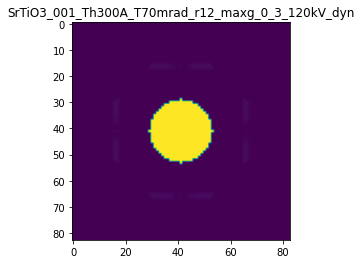

R-factor: 1.588383740523926e-05

>>> producing the 23. dataset...

The offset applied on thickness: -0.00015818875361858664

The offset applied on Ug: -0.005212160762906137

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.84181124638144
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

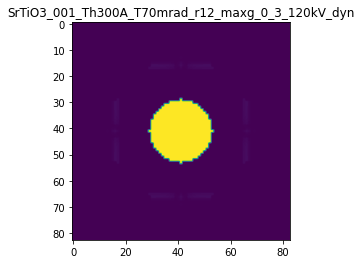

R-factor: 2.054685939528192e-07

>>> producing the 24. dataset...

The offset applied on thickness: 0.0002468442640313218

The offset applied on Ug: 1.2860126752053487

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2468442640313
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

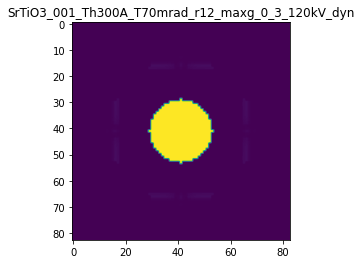

R-factor: 7.899150117998454e-06

>>> producing the 25. dataset...

The offset applied on thickness: 0.0002698341729161629

The offset applied on Ug: 2.464236758322674

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.26983417291615
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

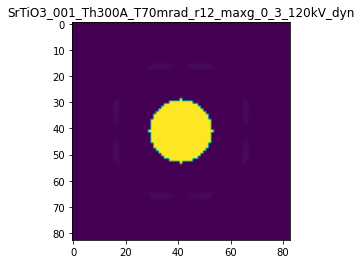

R-factor: 1.5355668879628976e-05

>>> producing the 26. dataset...

The offset applied on thickness: -0.0006620704684856342

The offset applied on Ug: 0.38307837050859633

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.33792953151436
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

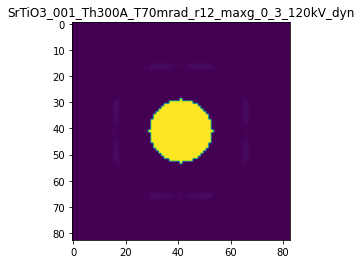

R-factor: 2.8001862940559096e-06

>>> producing the 27. dataset...

The offset applied on thickness: 0.0006019226092242415

The offset applied on Ug: 0.056243427752792174

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.60192260922423
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

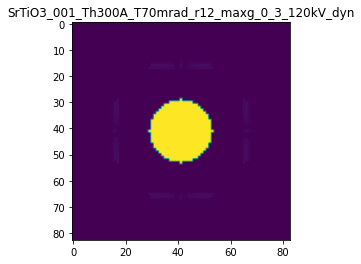

R-factor: 8.421929667831699e-07

>>> producing the 28. dataset...

The offset applied on thickness: -5.0961515045457207e-05

The offset applied on Ug: -1.468609910019102

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.94903848495454
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

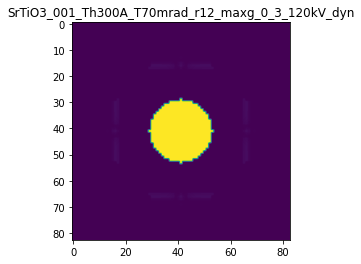

R-factor: 8.758219591877347e-06

>>> producing the 29. dataset...

The offset applied on thickness: 0.00023935260398113246

The offset applied on Ug: 0.5368811818697822

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2393526039811
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

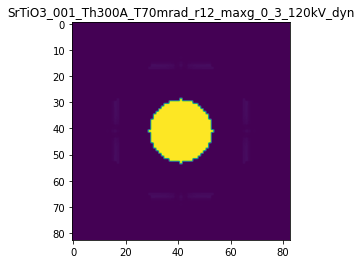

R-factor: 3.2114020522983632e-06

>>> producing the 30. dataset...

The offset applied on thickness: -0.00035889495724524245

The offset applied on Ug: 0.7551349886668363

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.64110504275476
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

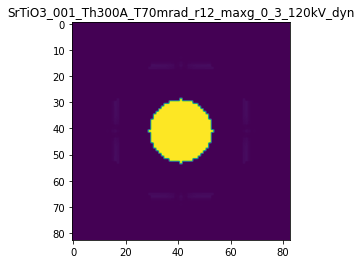

R-factor: 4.880475082263331e-06

>>> producing the 31. dataset...

The offset applied on thickness: 0.0009346345791958011

The offset applied on Ug: -2.247796376918347

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9346345791958
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

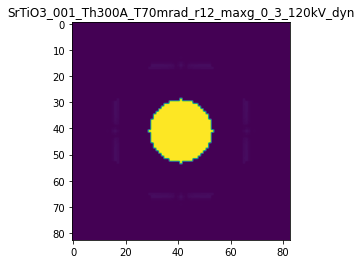

R-factor: 1.3736862176881008e-05

>>> producing the 32. dataset...

The offset applied on thickness: 0.000610566950872244

The offset applied on Ug: 0.36508910517972537

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6105669508722
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

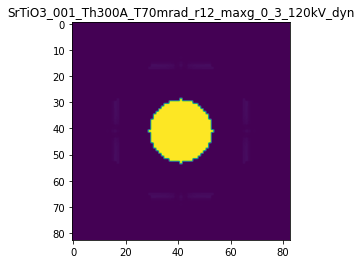

R-factor: 2.211291526748305e-06

>>> producing the 33. dataset...

The offset applied on thickness: 0.0006607837959037359

The offset applied on Ug: 0.26043477871100834

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.66078379590374
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

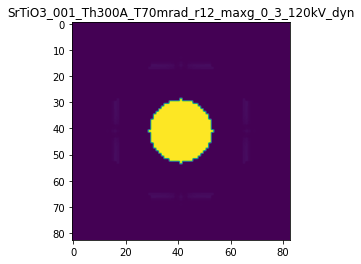

R-factor: 1.6901746668908315e-06

>>> producing the 34. dataset...

The offset applied on thickness: 0.0008712096618130397

The offset applied on Ug: -0.7576478159108593

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.871209661813
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

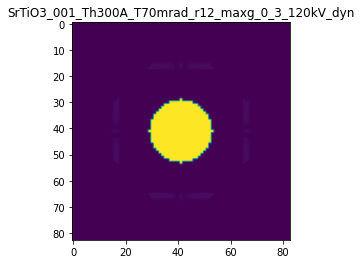

R-factor: 5.168838456074851e-06

>>> producing the 35. dataset...

The offset applied on thickness: -3.126447073210192e-05

The offset applied on Ug: -0.20161349537256285

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9687355292679
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

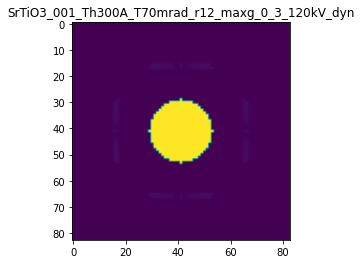

R-factor: 1.2176833958817183e-06

>>> producing the 36. dataset...

The offset applied on thickness: 0.00017052516024407673

The offset applied on Ug: 1.1922174696167116

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.17052516024404
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

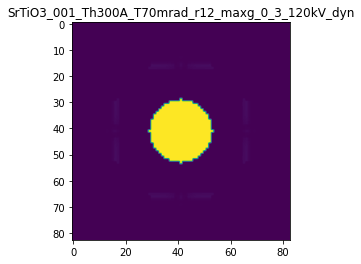

R-factor: 7.343686157819409e-06

>>> producing the 37. dataset...

The offset applied on thickness: -0.0009658002957181822

The offset applied on Ug: -0.7282505100596967

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0341997042818
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

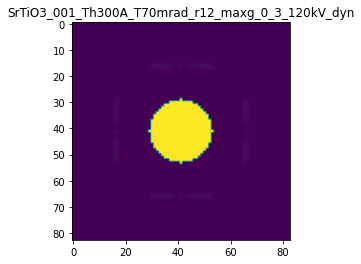

R-factor: 4.345534987183455e-06

>>> producing the 38. dataset...

The offset applied on thickness: -0.0008168433884821895

The offset applied on Ug: -0.2504275872271586

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1831566115178
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

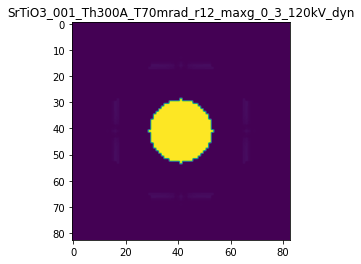

R-factor: 1.7454126891887497e-06

>>> producing the 39. dataset...

The offset applied on thickness: -0.0008784250663684337

The offset applied on Ug: -1.8285880452684706

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.12157493363156
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

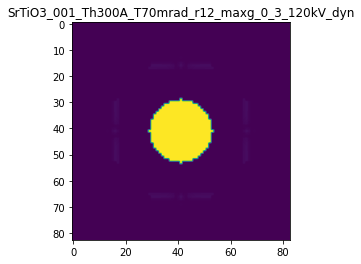

R-factor: 1.066239854769584e-05

>>> producing the 40. dataset...

The offset applied on thickness: -0.0008824317300126325

The offset applied on Ug: -2.2106822069353114

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1175682699874
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

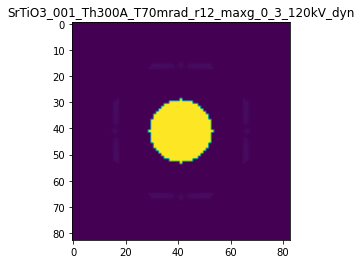

R-factor: 1.2835564357623784e-05

>>> producing the 41. dataset...

The offset applied on thickness: 3.514909291407253e-05

The offset applied on Ug: 2.4936821478822435

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0351490929141
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

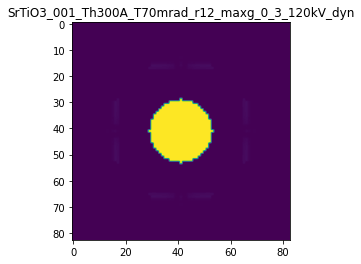

R-factor: 1.5647017476730425e-05

>>> producing the 42. dataset...

The offset applied on thickness: -0.0005304567516231494

The offset applied on Ug: -1.0766480762468877

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.46954324837685
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

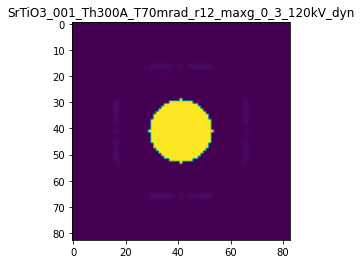

R-factor: 6.338346447152543e-06

>>> producing the 43. dataset...

The offset applied on thickness: 0.0004660706337386942

The offset applied on Ug: 0.08223630510862848

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4660706337387
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

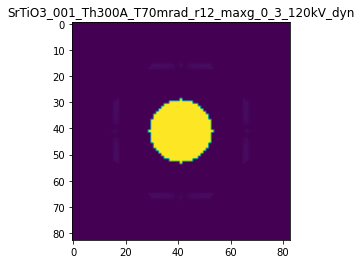

R-factor: 7.367589275675414e-07

>>> producing the 44. dataset...

The offset applied on thickness: -0.00046584893868257084

The offset applied on Ug: 1.1021854440863694

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5341510613174
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

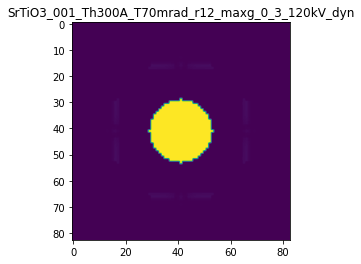

R-factor: 7.1070111650090095e-06

>>> producing the 45. dataset...

The offset applied on thickness: -0.0009326793770162094

The offset applied on Ug: -0.8846367546127982

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0673206229838
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

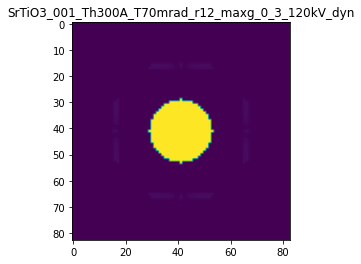

R-factor: 5.214129724352333e-06

>>> producing the 46. dataset...

The offset applied on thickness: -0.0008249355593987808

The offset applied on Ug: 2.082698548776761

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1750644406012
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

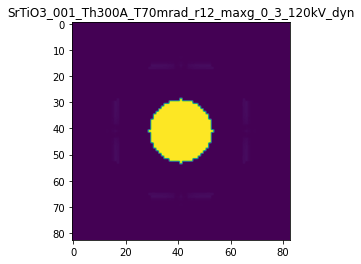

R-factor: 1.3463837891859551e-05

>>> producing the 47. dataset...

The offset applied on thickness: 0.0004277825545643506

The offset applied on Ug: 1.3696137283849976

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4277825545643
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

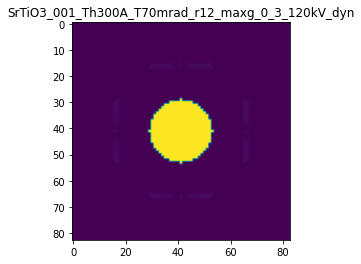

R-factor: 8.342027646675355e-06

>>> producing the 48. dataset...

The offset applied on thickness: 0.0009270918462069136

The offset applied on Ug: -2.5316799501293485

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9270918462069
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

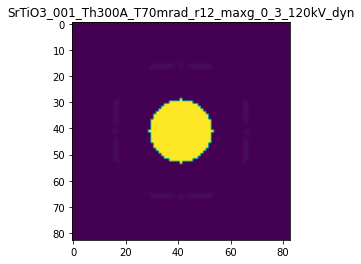

R-factor: 1.525724064214523e-05

>>> producing the 49. dataset...

The offset applied on thickness: -3.091635172141194e-05

The offset applied on Ug: -1.3945793571532068

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.96908364827857
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

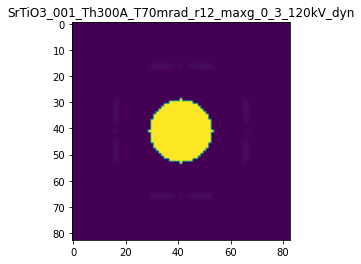

R-factor: 8.336056210289249e-06

>>> producing the 50. dataset...

The offset applied on thickness: 0.0006605992630941129

The offset applied on Ug: -2.187183183404415

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.66059926309407
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

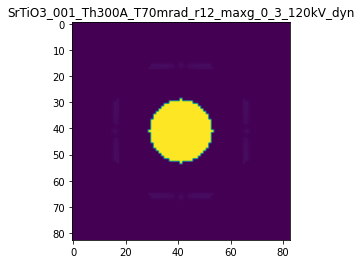

R-factor: 1.3213705771242478e-05

>>> producing the 51. dataset...

The offset applied on thickness: -0.0009418634920779545

The offset applied on Ug: -1.8502951638905967

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.05813650792203
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

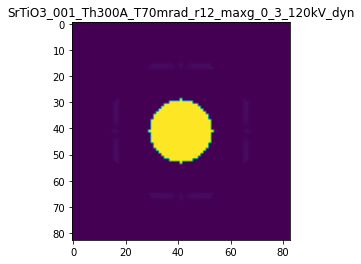

R-factor: 1.0780405435112727e-05

>>> producing the 52. dataset...

The offset applied on thickness: -7.511003443008813e-05

The offset applied on Ug: 1.2434850576225664

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9248899655699
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

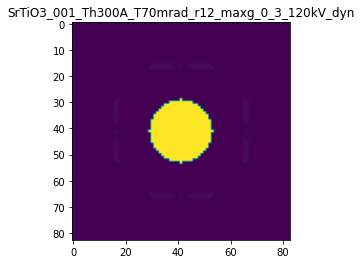

R-factor: 7.78669672589189e-06

>>> producing the 53. dataset...

The offset applied on thickness: -0.0007514731921857931

The offset applied on Ug: -1.3431318037551836

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.24852680781424
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

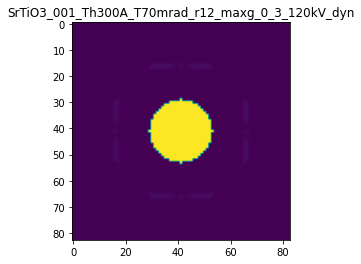

R-factor: 7.87233056255555e-06

>>> producing the 54. dataset...

The offset applied on thickness: 0.0006130747457921601

The offset applied on Ug: -0.6409644331230396

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6130747457921
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

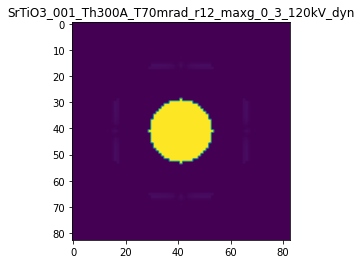

R-factor: 4.289719120546889e-06

>>> producing the 55. dataset...

The offset applied on thickness: 0.0009657820243253228

The offset applied on Ug: -2.50748442447313

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.96578202432534
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

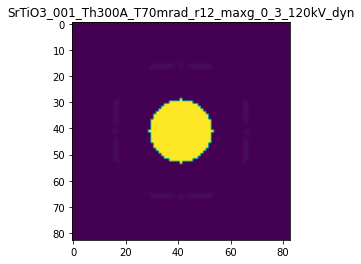

R-factor: 1.5155053581255074e-05

>>> producing the 56. dataset...

The offset applied on thickness: -0.0006843408749662057

The offset applied on Ug: -2.224782546213587

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3156591250338
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

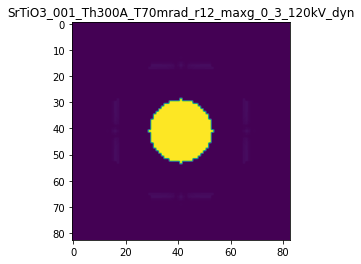

R-factor: 1.2944295512590674e-05

>>> producing the 57. dataset...

The offset applied on thickness: 0.0008183468911037735

The offset applied on Ug: 0.6781291477820486

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8183468911038
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

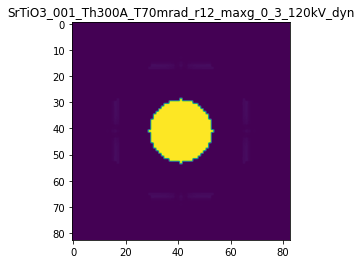

R-factor: 4.014380382432598e-06

>>> producing the 58. dataset...

The offset applied on thickness: 0.0005262531117451257

The offset applied on Ug: -0.4869923387689272

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5262531117451
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

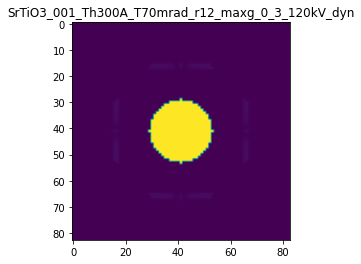

R-factor: 3.307856501173154e-06

>>> producing the 59. dataset...

The offset applied on thickness: -0.0006912834139223439

The offset applied on Ug: -1.405341768358909

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.30871658607765
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

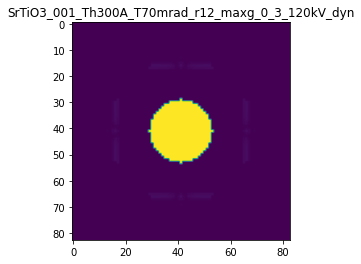

R-factor: 8.242061559405438e-06

>>> producing the 60. dataset...

The offset applied on thickness: -0.00025836984265337117

The offset applied on Ug: 0.03855214822018979

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7416301573466
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

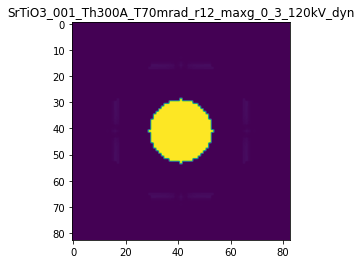

R-factor: 4.579323738884378e-07

>>> producing the 61. dataset...

The offset applied on thickness: 0.0005738802722316361

The offset applied on Ug: -0.042510603729987224

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.57388027223163
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

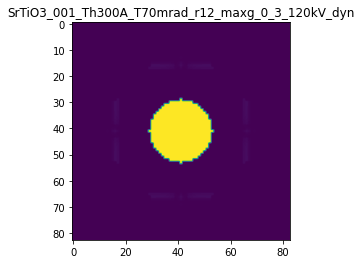

R-factor: 8.232296356394336e-07

>>> producing the 62. dataset...

The offset applied on thickness: -0.0002535943172800592

The offset applied on Ug: 0.6932996661149935

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7464056827199
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

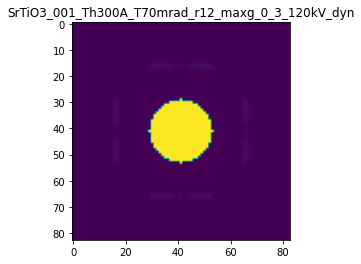

R-factor: 4.433611291125734e-06

>>> producing the 63. dataset...

The offset applied on thickness: 0.0009273904971784682

The offset applied on Ug: 2.3637365738781257

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.92739049717846
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

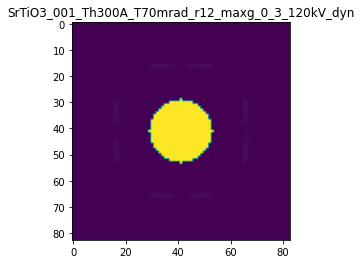

R-factor: 1.4432317365483574e-05

>>> producing the 64. dataset...

The offset applied on thickness: 0.0009553767174653738

The offset applied on Ug: 1.8481872150529768

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.95537671746536
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

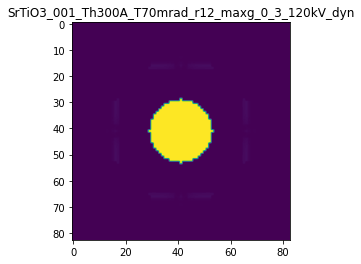

R-factor: 1.1136442445346055e-05

>>> producing the 65. dataset...

The offset applied on thickness: 0.0006548016025805052

The offset applied on Ug: 0.05812821811206163

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6548016025805
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

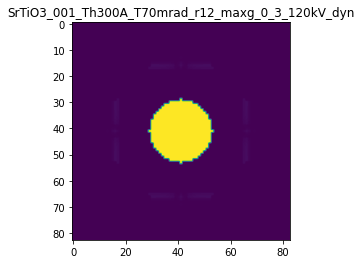

R-factor: 9.108925320372375e-07

>>> producing the 66. dataset...

The offset applied on thickness: -0.00045719416754090705

The offset applied on Ug: 1.1609214765133709

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.54280583245907
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

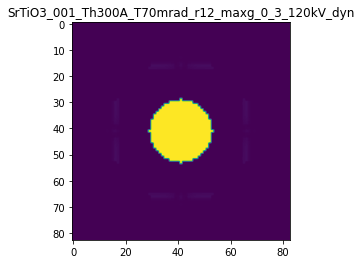

R-factor: 7.469902740818948e-06

>>> producing the 67. dataset...

The offset applied on thickness: 0.00023791213407630196

The offset applied on Ug: -2.0249381365247734

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2379121340763
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

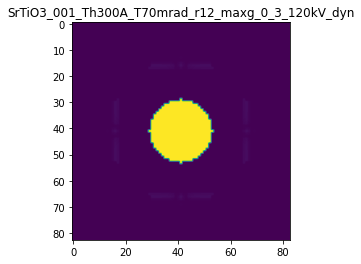

R-factor: 1.2074245519743867e-05

>>> producing the 68. dataset...

The offset applied on thickness: 0.000719253750271818

The offset applied on Ug: 2.238215541878659

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.71925375027183
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

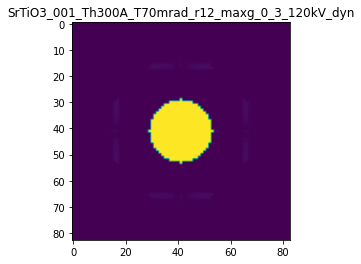

R-factor: 1.3722234272677988e-05

>>> producing the 69. dataset...

The offset applied on thickness: -0.0007728224342543277

The offset applied on Ug: 0.6504024189102767

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2271775657457
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

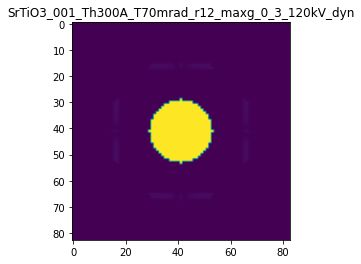

R-factor: 4.502416791268676e-06

>>> producing the 70. dataset...

The offset applied on thickness: -0.000680432800154585

The offset applied on Ug: 0.6164999564654636

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.31956719984544
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

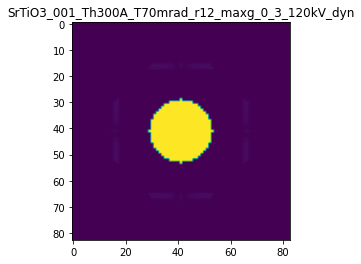

R-factor: 4.231529073461273e-06

>>> producing the 71. dataset...

The offset applied on thickness: 0.0008263254498343935

The offset applied on Ug: 1.8725298794477414

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.82632544983437
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

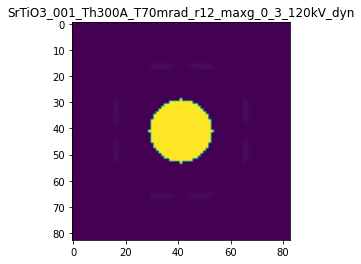

R-factor: 1.1348083583319913e-05

>>> producing the 72. dataset...

The offset applied on thickness: 0.00037969980692237825

The offset applied on Ug: -0.49153129810812346

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.37969980692236
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

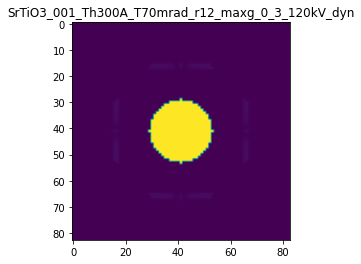

R-factor: 3.2328950588592045e-06

>>> producing the 73. dataset...

The offset applied on thickness: 0.0008667438886749135

The offset applied on Ug: 1.8055273487129295

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8667438886749
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

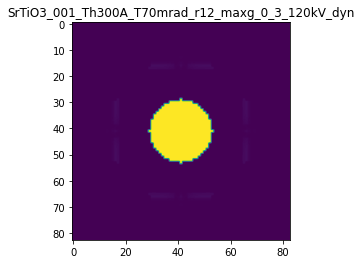

R-factor: 1.0904820284318839e-05

>>> producing the 74. dataset...

The offset applied on thickness: 2.360933245915575e-06

The offset applied on Ug: 2.065978624228031

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0023609332459
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

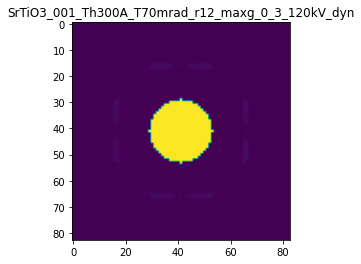

R-factor: 1.2947544374996581e-05

>>> producing the 75. dataset...

The offset applied on thickness: -0.0005217470647472183

The offset applied on Ug: 0.5931642301995055

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4782529352528
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

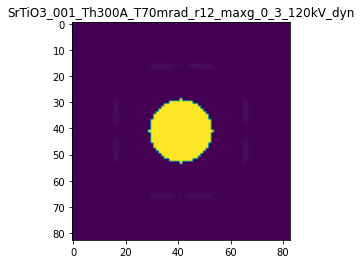

R-factor: 3.981546548193859e-06

>>> producing the 76. dataset...

The offset applied on thickness: 0.0007463655878828608

The offset applied on Ug: 1.9130168190624324

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.74636558788285
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

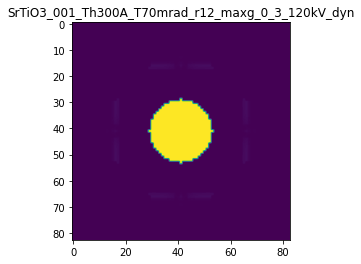

R-factor: 1.164034507864329e-05

>>> producing the 77. dataset...

The offset applied on thickness: 0.0003312563520544907

The offset applied on Ug: -1.2525844460240405

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3312563520545
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

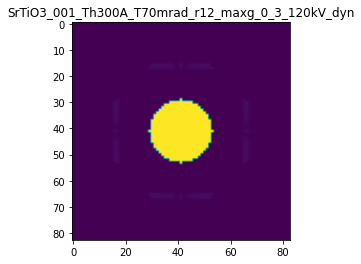

R-factor: 7.71124012397056e-06

>>> producing the 78. dataset...

The offset applied on thickness: 0.00015449938499216388

The offset applied on Ug: 0.9162073587096825

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.15449938499216
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

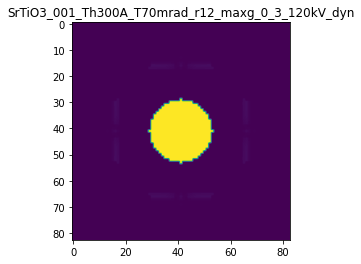

R-factor: 5.614574612269225e-06

>>> producing the 79. dataset...

The offset applied on thickness: -0.0005960418065282846

The offset applied on Ug: -1.256500285381457

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4039581934717
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

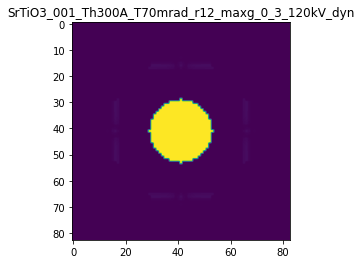

R-factor: 7.385140754602974e-06

>>> producing the 80. dataset...

The offset applied on thickness: -6.611255963718698e-05

The offset applied on Ug: 0.501103452243342

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9338874403628
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

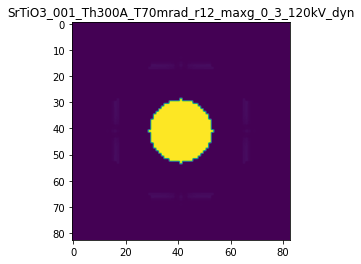

R-factor: 3.133423496651514e-06

>>> producing the 81. dataset...

The offset applied on thickness: 0.00031834983579634435

The offset applied on Ug: -0.6723207414062188

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3183498357963
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

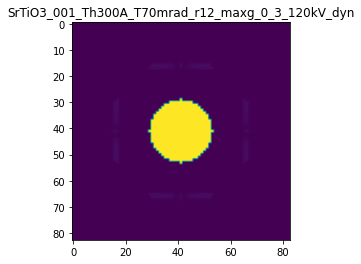

R-factor: 4.275595515375443e-06

>>> producing the 82. dataset...

The offset applied on thickness: 0.0004655694856535144

The offset applied on Ug: 2.2392669549591186

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.46556948565353
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

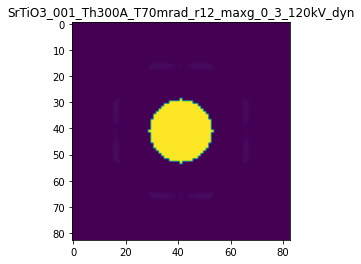

R-factor: 1.3839539003073776e-05

>>> producing the 83. dataset...

The offset applied on thickness: -0.0007905118667999709

The offset applied on Ug: -0.0775566527890129

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2094881332
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

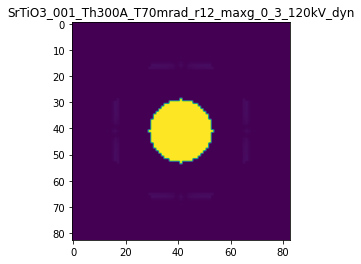

R-factor: 1.1113725922062347e-06

>>> producing the 84. dataset...

The offset applied on thickness: -0.0007823103560553873

The offset applied on Ug: 1.5694169750203844

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.21768964394465
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

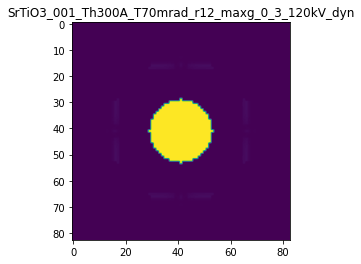

R-factor: 1.0216660527728296e-05

>>> producing the 85. dataset...

The offset applied on thickness: -0.00018263993635273822

The offset applied on Ug: 2.010669299267389

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.81736006364724
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

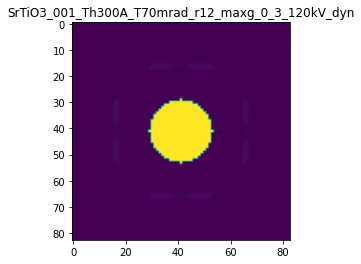

R-factor: 1.268471804917693e-05

>>> producing the 86. dataset...

The offset applied on thickness: 6.468219418252819e-05

The offset applied on Ug: 2.549586049181686

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0646821941825
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

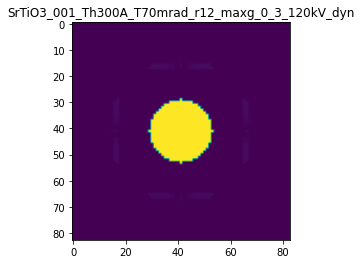

R-factor: 1.598836599933962e-05

>>> producing the 87. dataset...

The offset applied on thickness: 0.000786967112296017

The offset applied on Ug: -0.6549329028056218

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.786967112296
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

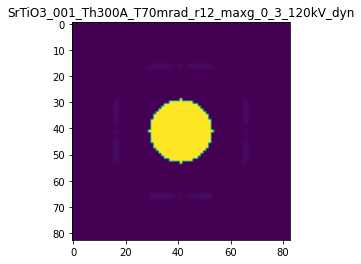

R-factor: 4.498065370371814e-06

>>> producing the 88. dataset...

The offset applied on thickness: 0.0008724846310441765

The offset applied on Ug: 1.7629117546752753

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.87248463104413
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

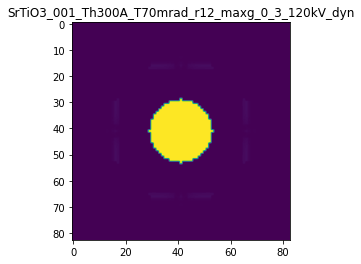

R-factor: 1.063172099730979e-05

>>> producing the 89. dataset...

The offset applied on thickness: -0.00022719122670467894

The offset applied on Ug: -0.5298750184474637

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7728087732953
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

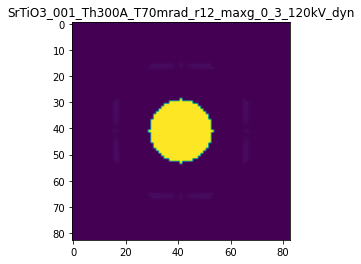

R-factor: 3.1426133196783175e-06

>>> producing the 90. dataset...

The offset applied on thickness: -0.0004896009957276779

The offset applied on Ug: -0.6644026766635159

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5103990042723
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

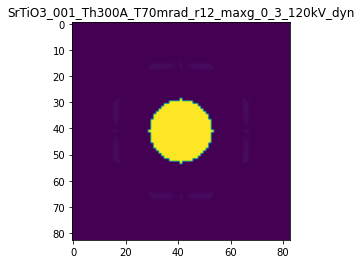

R-factor: 3.9115112398011055e-06

>>> producing the 91. dataset...

The offset applied on thickness: -0.00024377248799917206

The offset applied on Ug: -2.43971157105622

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7562275120008
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

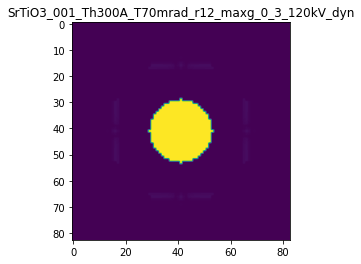

R-factor: 1.423940242692376e-05

>>> producing the 92. dataset...

The offset applied on thickness: -0.0006848851712825446

The offset applied on Ug: 2.2394069495560287

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3151148287174
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

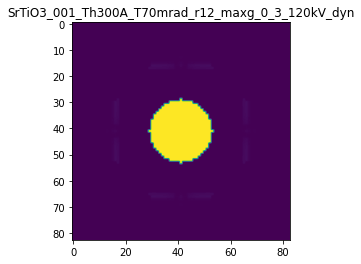

R-factor: 1.4378983246226212e-05

>>> producing the 93. dataset...

The offset applied on thickness: 0.0006896752922935623

The offset applied on Ug: -0.16369964076793678

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.68967529229354
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

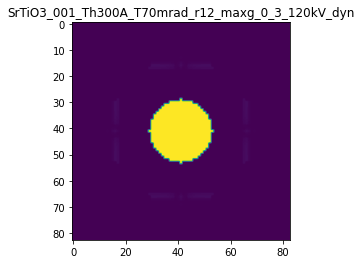

R-factor: 1.5502483998737476e-06

>>> producing the 94. dataset...

The offset applied on thickness: 0.0002394115298658368

The offset applied on Ug: 0.3171574354249566

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.23941152986583
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

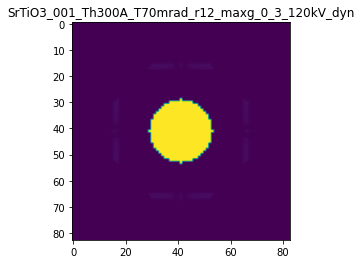

R-factor: 1.8776270048048278e-06

>>> producing the 95. dataset...

The offset applied on thickness: -0.0009391880890455225

The offset applied on Ug: 2.3378981425420142

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.06081191095444
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

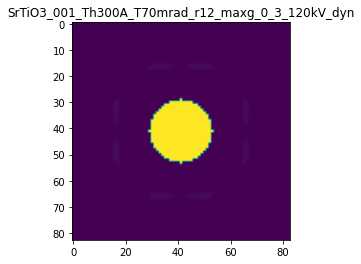

R-factor: 1.5132175735587827e-05

>>> producing the 96. dataset...

The offset applied on thickness: -0.0005643039120414393

The offset applied on Ug: -2.117225764515623

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.43569608795855
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

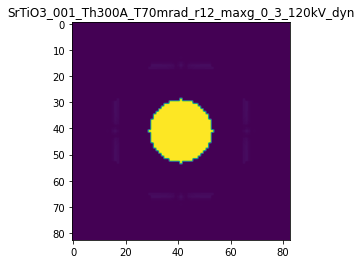

R-factor: 1.2354047727937722e-05

>>> producing the 97. dataset...

The offset applied on thickness: -0.0004631760457170493

The offset applied on Ug: -0.47477546393832826

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.53682395428297
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

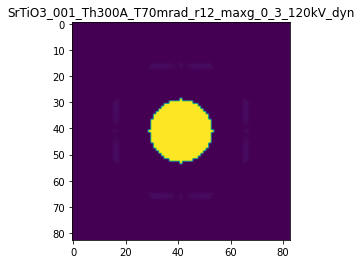

R-factor: 2.7955589891184166e-06

>>> producing the 98. dataset...

The offset applied on thickness: -0.0007443829186689277

The offset applied on Ug: 0.5198775429173196

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2556170813311
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

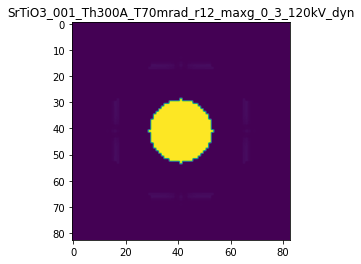

R-factor: 3.686695193998036e-06

>>> producing the 99. dataset...

The offset applied on thickness: 0.0002989411103103732

The offset applied on Ug: -1.4772798522863355

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.29894111031035
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

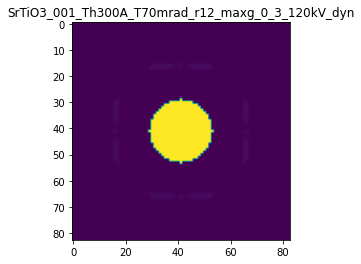

R-factor: 8.991065666243265e-06

>>> producing the 100. dataset...

The offset applied on thickness: 6.256981765213765e-05

The offset applied on Ug: -0.682020491904434

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0625698176521
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

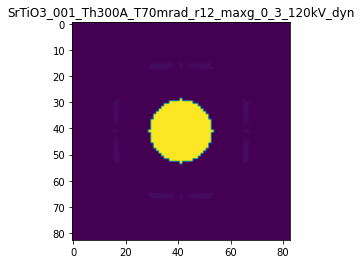

R-factor: 4.175153627343898e-06

>>> producing the 101. dataset...

The offset applied on thickness: -0.0001782338164371091

The offset applied on Ug: 1.818362019619056

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8217661835629
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

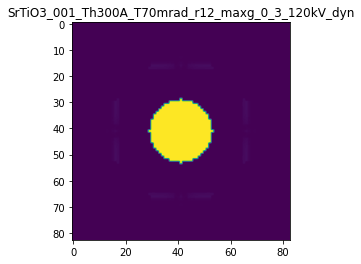

R-factor: 1.1467140119418103e-05

>>> producing the 102. dataset...

The offset applied on thickness: 0.0007930559046979473

The offset applied on Ug: 2.2685005850486823

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.79305590469795
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

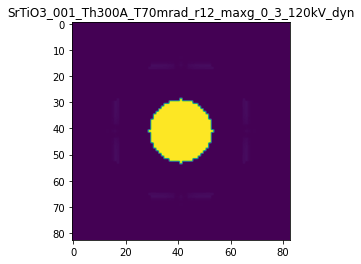

R-factor: 1.3883183562319803e-05

>>> producing the 103. dataset...

The offset applied on thickness: 0.0002978296952070609

The offset applied on Ug: -0.526810535112615

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2978296952071
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

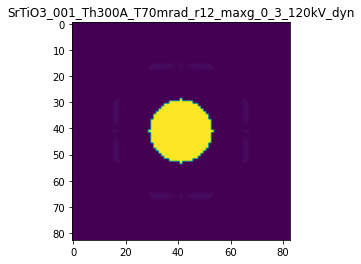

R-factor: 3.389769557353832e-06

>>> producing the 104. dataset...

The offset applied on thickness: 0.0008262389354176379

The offset applied on Ug: -1.184957367539589

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8262389354176
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

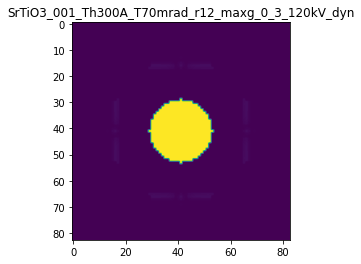

R-factor: 7.653396369379826e-06

>>> producing the 105. dataset...

The offset applied on thickness: -3.0516112322094504e-05

The offset applied on Ug: -0.7146387929263989

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.96948388767794
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

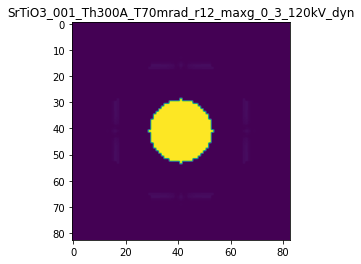

R-factor: 4.318071028769625e-06

>>> producing the 106. dataset...

The offset applied on thickness: 0.0006726238078953783

The offset applied on Ug: 0.8331643551349993

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6726238078954
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

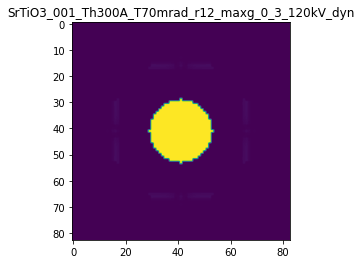

R-factor: 4.93622987880269e-06

>>> producing the 107. dataset...

The offset applied on thickness: 0.000914909944040458

The offset applied on Ug: 2.473875450414584

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.91490994404046
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

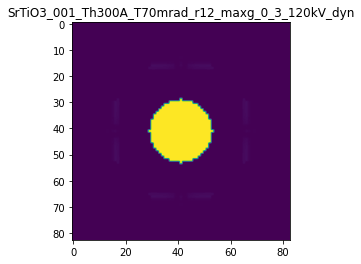

R-factor: 1.5139080142481701e-05

>>> producing the 108. dataset...

The offset applied on thickness: 0.00014683420726148988

The offset applied on Ug: -1.3845542520251388

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.14683420726146
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

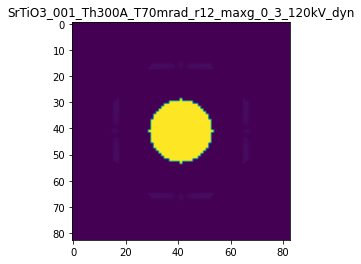

R-factor: 8.363713559406816e-06

>>> producing the 109. dataset...

The offset applied on thickness: -0.0008461526535202211

The offset applied on Ug: 0.41575055122525273

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1538473464798
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

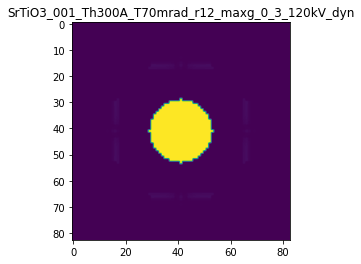

R-factor: 3.1404938371954463e-06

>>> producing the 110. dataset...

The offset applied on thickness: 0.00075921967752583

The offset applied on Ug: -1.1058593049277659

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.75921967752583
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

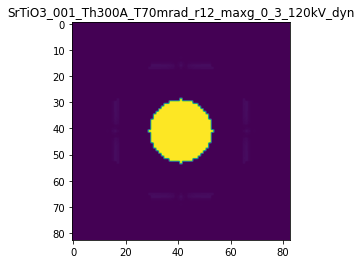

R-factor: 7.143840757051809e-06

>>> producing the 111. dataset...

The offset applied on thickness: 0.00028729129667209684

The offset applied on Ug: -0.8093286439741951

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2872912966721
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

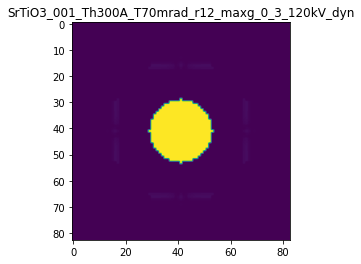

R-factor: 5.072508315632655e-06

>>> producing the 112. dataset...

The offset applied on thickness: -0.0002582099500115471

The offset applied on Ug: 0.9469034885161602

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7417900499885
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

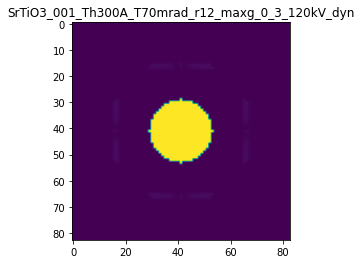

R-factor: 6.0180430907631335e-06

>>> producing the 113. dataset...

The offset applied on thickness: 0.0003590443525115574

The offset applied on Ug: 1.4016175150515948

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.35904435251155
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

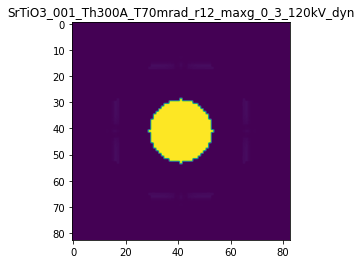

R-factor: 8.576668254454768e-06

>>> producing the 114. dataset...

The offset applied on thickness: -0.0003472169240668106

The offset applied on Ug: 1.2536859285937494

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6527830759332
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

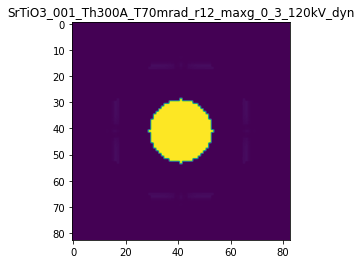

R-factor: 7.991323117628145e-06

>>> producing the 115. dataset...

The offset applied on thickness: 0.000421568173869999

The offset applied on Ug: -1.4158057101848585

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.42156817387
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

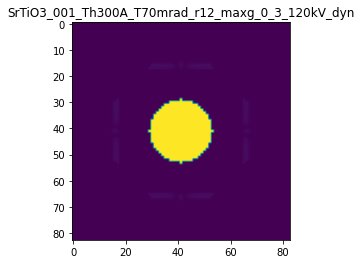

R-factor: 8.715643004506621e-06

>>> producing the 116. dataset...

The offset applied on thickness: -0.00011517101507747762

The offset applied on Ug: -2.2798652395216727

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.88482898492254
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

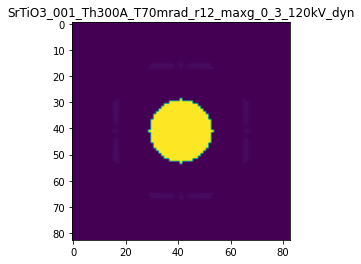

R-factor: 1.338189408159234e-05

>>> producing the 117. dataset...

The offset applied on thickness: -0.00016373727053303554

The offset applied on Ug: -2.1983121424562553

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.83626272946697
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

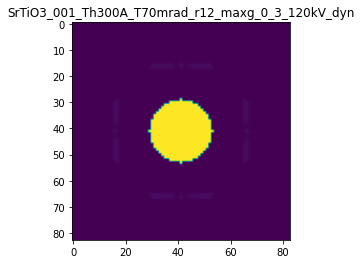

R-factor: 1.2908083676302499e-05

>>> producing the 118. dataset...

The offset applied on thickness: -0.0008906058853278025

The offset applied on Ug: -1.0418523432284565

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.10939411467217
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

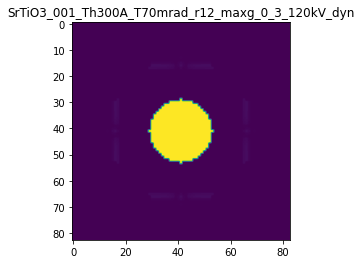

R-factor: 6.10880103473113e-06

>>> producing the 119. dataset...

The offset applied on thickness: -3.6519952689092695e-05

The offset applied on Ug: 1.402368291189652

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9634800473109
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

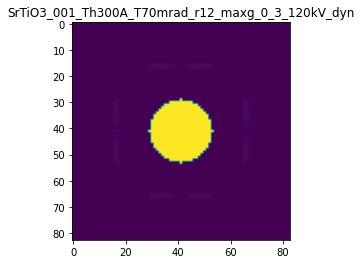

R-factor: 8.769521758161751e-06

>>> producing the 120. dataset...

The offset applied on thickness: -0.000775568493018549

The offset applied on Ug: 2.406971383776493

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.22443150698143
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

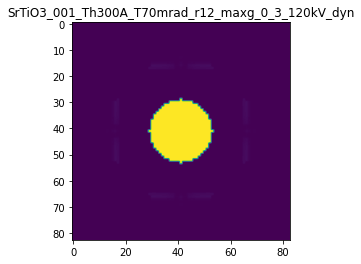

R-factor: 1.5483254120488948e-05

>>> producing the 121. dataset...

The offset applied on thickness: -0.000290440085754935

The offset applied on Ug: -0.8530247053887149

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.709559914245
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

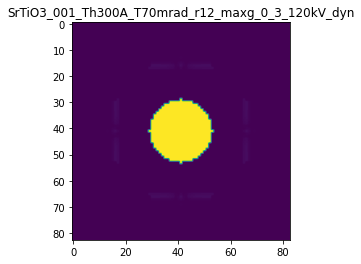

R-factor: 5.056884876147441e-06

>>> producing the 122. dataset...

The offset applied on thickness: -0.00028338845642307553

The offset applied on Ug: -1.843662548815472

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7166115435769
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

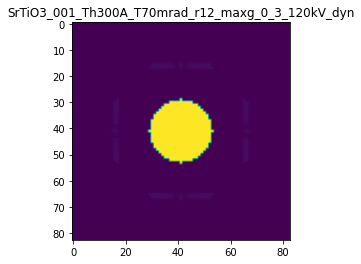

R-factor: 1.0855599863913987e-05

>>> producing the 123. dataset...

The offset applied on thickness: -0.0009276168080232159

The offset applied on Ug: -0.26762061695794787

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.07238319197677
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

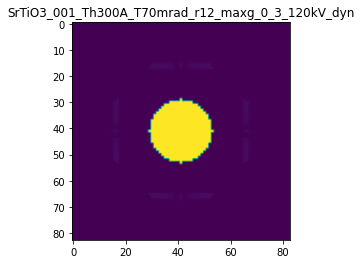

R-factor: 1.9012674958152654e-06

>>> producing the 124. dataset...

The offset applied on thickness: 0.0004983806849325527

The offset applied on Ug: 2.1948899886297797

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.49838068493256
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

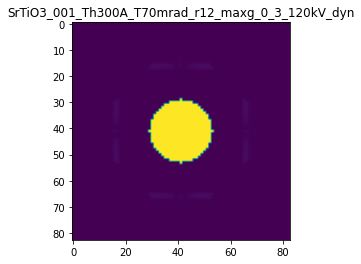

R-factor: 1.3542738869829118e-05

>>> producing the 125. dataset...

The offset applied on thickness: 0.0002543166732938762

The offset applied on Ug: -0.1954764340626349

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2543166732939
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

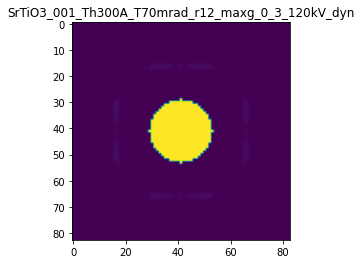

R-factor: 1.362384831001176e-06

>>> producing the 126. dataset...

The offset applied on thickness: -0.00017976836836771848

The offset applied on Ug: 1.6702459575534352

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8202316316323
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

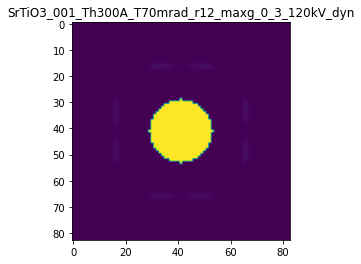

R-factor: 1.0532080925127792e-05

>>> producing the 127. dataset...

The offset applied on thickness: -0.0006085099998477555

The offset applied on Ug: -1.9892577065703831

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.39149000015226
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

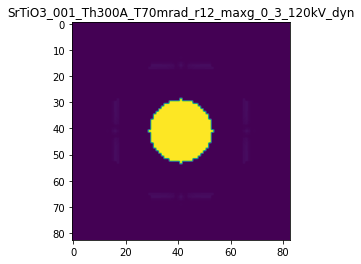

R-factor: 1.1619507003022251e-05

>>> producing the 128. dataset...

The offset applied on thickness: -0.0003290491179940394

The offset applied on Ug: 1.3607516369003485

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.67095088200597
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

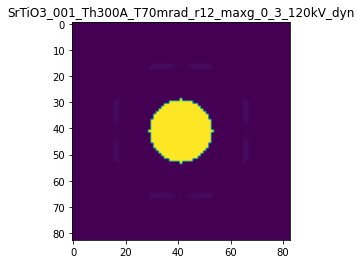

R-factor: 8.655179095409868e-06

>>> producing the 129. dataset...

The offset applied on thickness: -0.00034145035775968926

The offset applied on Ug: -1.8426403238765687

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6585496422403
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

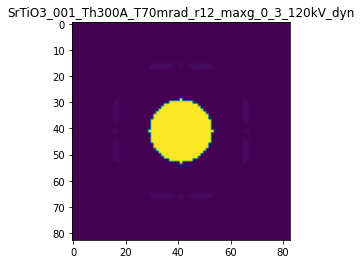

R-factor: 1.0835235174122679e-05

>>> producing the 130. dataset...

The offset applied on thickness: 0.0005411892183265987

The offset applied on Ug: -1.704212526831244

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.54118921832656
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

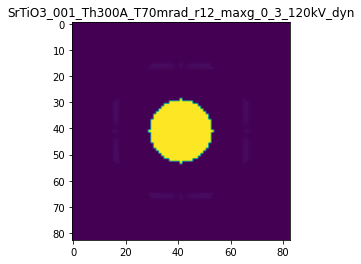

R-factor: 1.0444138476412573e-05

>>> producing the 131. dataset...

The offset applied on thickness: 0.00014494738610917814

The offset applied on Ug: -0.8838233444223329

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.14494738610915
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

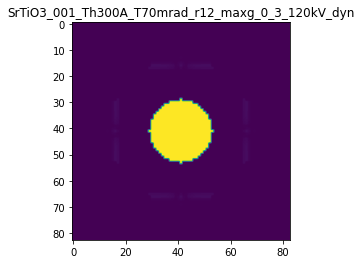

R-factor: 5.427085740470051e-06

>>> producing the 132. dataset...

The offset applied on thickness: -0.0009992944225325974

The offset applied on Ug: -1.5065081221024492

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0007055774674
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

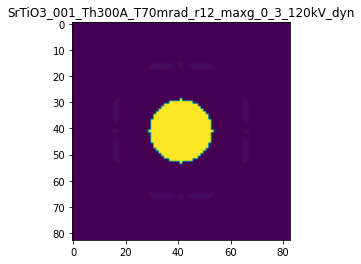

R-factor: 8.798159715369522e-06

>>> producing the 133. dataset...

The offset applied on thickness: 9.899849821271878e-05

The offset applied on Ug: -0.03958024705249443

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0989984982127
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

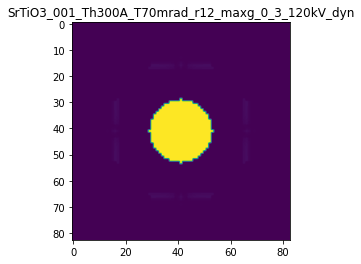

R-factor: 3.14296028310906e-07

>>> producing the 134. dataset...

The offset applied on thickness: 0.00043703542056567214

The offset applied on Ug: -1.227071294739966

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4370354205657
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

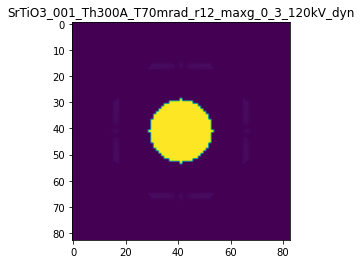

R-factor: 7.631532202181539e-06

>>> producing the 135. dataset...

The offset applied on thickness: 0.000613773820119984

The offset applied on Ug: 2.4650464214922305

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.61377382012
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrTi

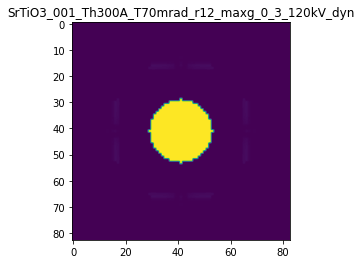

R-factor: 1.5211472311727835e-05

>>> producing the 136. dataset...

The offset applied on thickness: -0.0008431143623961885

The offset applied on Ug: -0.36712708146975387

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1568856376038
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

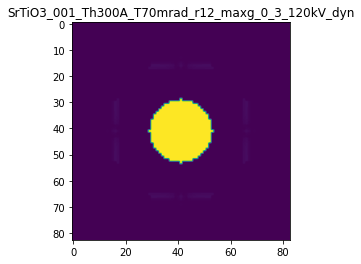

R-factor: 2.340944135457571e-06

>>> producing the 137. dataset...

The offset applied on thickness: -0.0007132733699581775

The offset applied on Ug: 1.433905170624164

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2867266300418
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

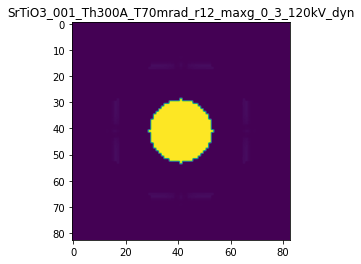

R-factor: 9.32745147948673e-06

>>> producing the 138. dataset...

The offset applied on thickness: 0.0009139772725277055

The offset applied on Ug: -1.7912482742839284

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.91397727252775
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

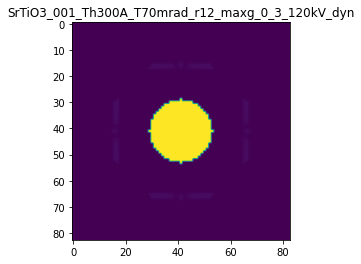

R-factor: 1.1195095741833626e-05

>>> producing the 139. dataset...

The offset applied on thickness: -0.0007732246843232442

The offset applied on Ug: 2.5540881461055687

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2267753156768
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

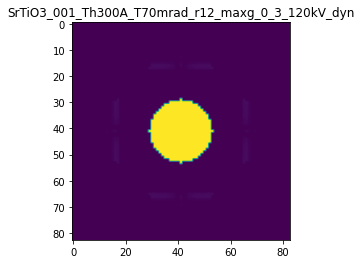

R-factor: 1.6410264626752898e-05

>>> producing the 140. dataset...

The offset applied on thickness: 0.0002428879367304051

The offset applied on Ug: 0.7924040048108401

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.24288793673037
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

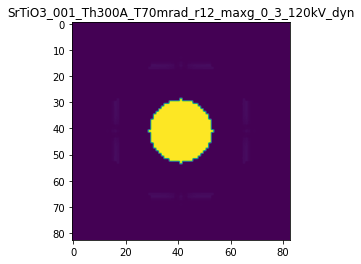

R-factor: 4.794845803420345e-06



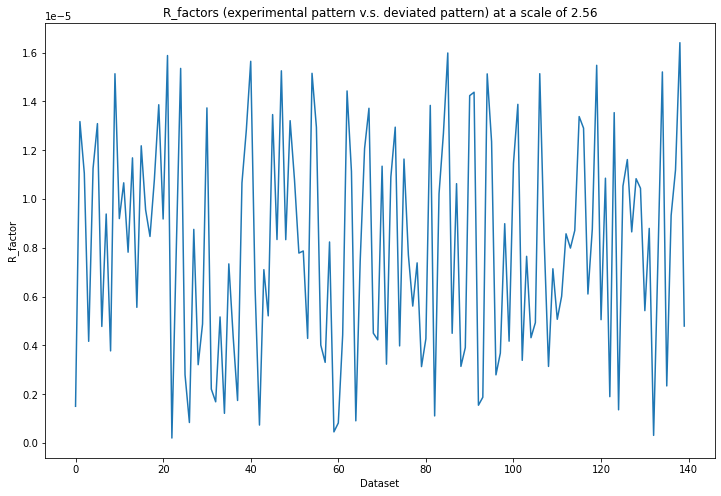

>>> start to train the ANN 

Epoch 1/30
5/5 [==============================] - 1s 127ms/step - loss: 0.3642 - acc: 0.8000 - val_loss: 0.3586 - val_acc: 1.0000
Epoch 2/30
5/5 [==============================] - 1s 106ms/step - loss: 0.3414 - acc: 1.0000 - val_loss: 0.3134 - val_acc: 1.0000
Epoch 3/30
5/5 [==============================] - 1s 108ms/step - loss: 0.2980 - acc: 1.0000 - val_loss: 0.2693 - val_acc: 1.0000
Epoch 4/30
5/5 [==============================] - 1s 108ms/step - loss: 0.2596 - acc: 1.0000 - val_loss: 0.2324 - val_acc: 1.0000
Epoch 5/30
5/5 [==============================] - 1s 106ms/step - loss: 0.2190 - acc: 1.0000 - val_loss: 0.1991 - val_acc: 1.0000
Epoch 6/30
5/5 [==============================] - 1s 105ms/step - loss: 0.1870 - acc: 1.0000 - val_loss: 0.1697 - val_acc: 1.0000
Epoch 7/30
5/5 [==============================] - 1s 107ms/step - loss: 0.1592 - acc: 1.0000 - val_loss: 0.1442 - val_acc: 1.0000
Epoch 8/30
5/5 [==============================] - 1s 106ms/st

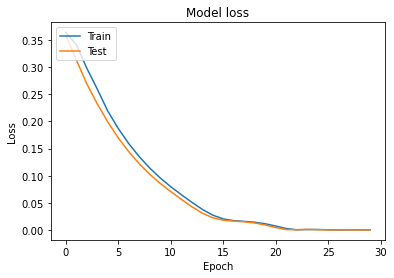

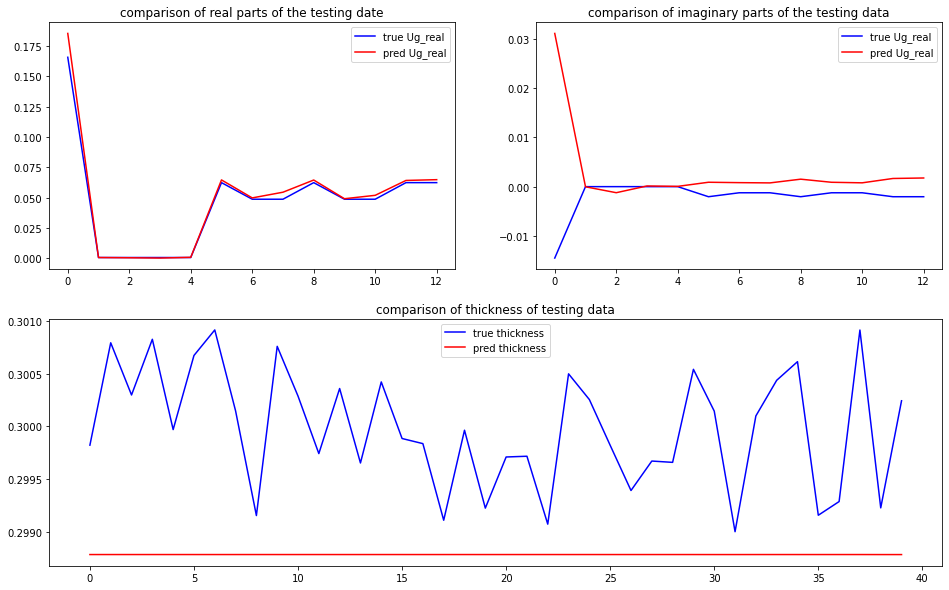

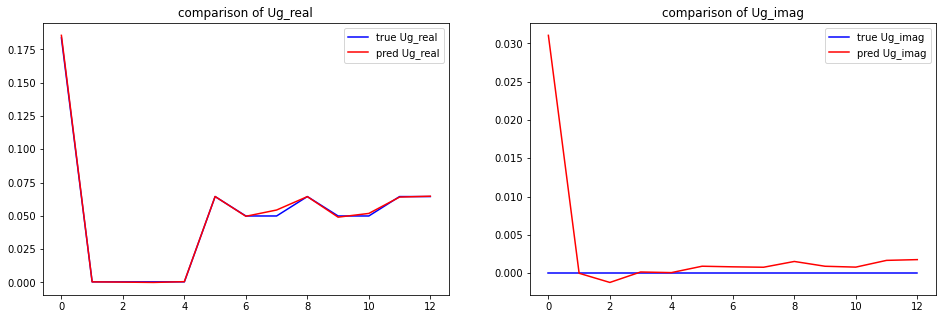

predicted thickness: 29.878395795822144 nm
mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=298.78395795822144
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 13 different beams

InputUg:
[0.18547048+0.00000000e+00j 0.

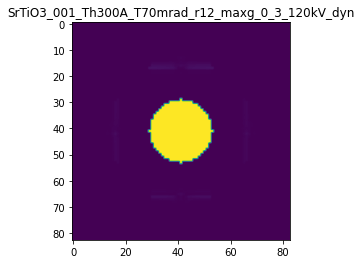

X_sim.max(): 0.9999973552246737
R-factor at a scale of 2.56 is 9.312434287690288e-05.

-----------------------------------------------------------------------------------------------------

>>> start to produce Dataset at a scale of 5.12

-----------------------------------------------------------------------------------------------------

>>> producing the 1. dataset...

The offset applied on thickness: -0.00020665510521568066

The offset applied on Ug: -2.624945265240757

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001


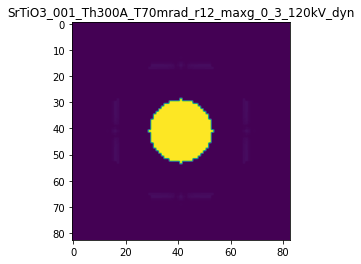

R-factor: 1.5283101424322065e-05

>>> producing the 2. dataset...

The offset applied on thickness: -0.00029151419642242015

The offset applied on Ug: -2.2627403377551265

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.70848580357756
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

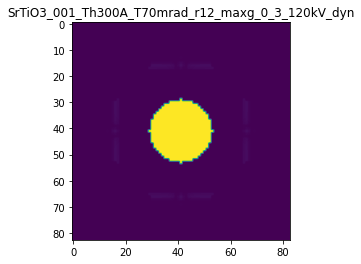

R-factor: 1.3234886084382436e-05

>>> producing the 3. dataset...

The offset applied on thickness: 1.21958616801916e-05

The offset applied on Ug: -2.4134450529662854

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.01219586168014
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

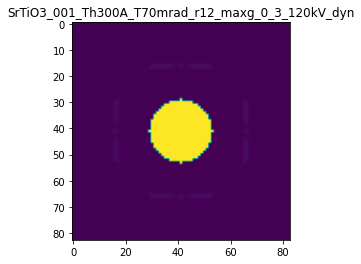

R-factor: 1.4169074783049898e-05

>>> producing the 4. dataset...

The offset applied on thickness: -0.0006472001958052537

The offset applied on Ug: -4.070844286908265

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3527998041947
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

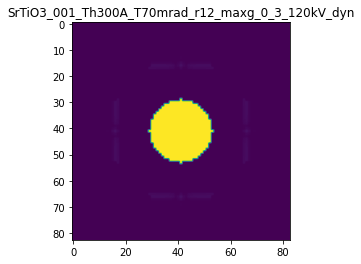

R-factor: 2.296318212058139e-05

>>> producing the 5. dataset...

The offset applied on thickness: 0.0001500535027596741

The offset applied on Ug: -4.040275441706037

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.15005350275965
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

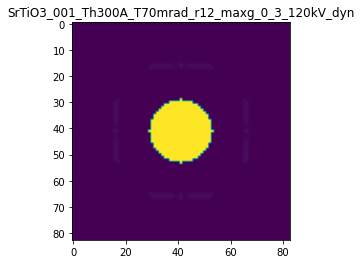

R-factor: 2.293485951650582e-05

>>> producing the 6. dataset...

The offset applied on thickness: 0.0009620970565193731

The offset applied on Ug: 4.3569199641980605

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9620970565194
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

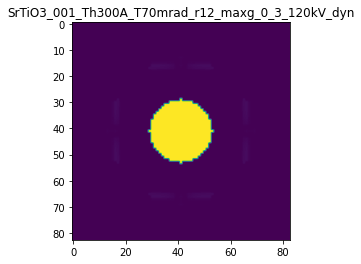

R-factor: 2.6983768991331484e-05

>>> producing the 7. dataset...

The offset applied on thickness: -0.0006953368086135292

The offset applied on Ug: 2.7442009423664673

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.30466319138645
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

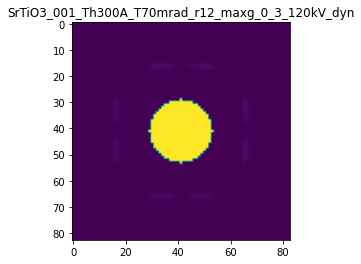

R-factor: 1.7570479391514196e-05

>>> producing the 8. dataset...

The offset applied on thickness: -0.0009554733039694428

The offset applied on Ug: 0.9720305934073316

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0445266960305
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

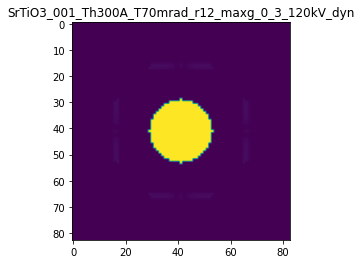

R-factor: 6.602083148659686e-06

>>> producing the 9. dataset...

The offset applied on thickness: -0.0008114034328021132

The offset applied on Ug: 0.566623641946344

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.18859656719786
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

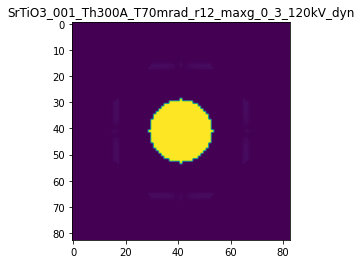

R-factor: 4.018858939192869e-06

>>> producing the 10. dataset...

The offset applied on thickness: 0.0001400685231841703

The offset applied on Ug: -1.8799864875946661

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.14006852318414
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

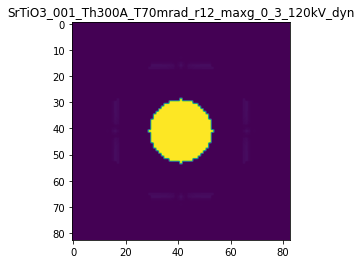

R-factor: 1.1207503432716382e-05

>>> producing the 11. dataset...

The offset applied on thickness: -0.0002294189533488449

The offset applied on Ug: -0.39296682897120494

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.77058104665116
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

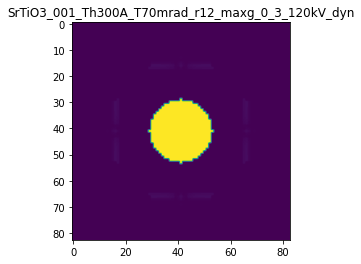

R-factor: 2.3233444455298513e-06

>>> producing the 12. dataset...

The offset applied on thickness: 0.0006552234885206723

The offset applied on Ug: -0.8340907386732499

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6552234885206
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

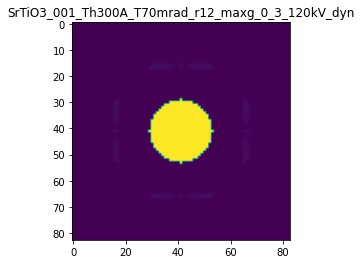

R-factor: 5.468646133504007e-06

>>> producing the 13. dataset...

The offset applied on thickness: -0.0009748585123926581

The offset applied on Ug: -4.967972611749469

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.02514148760736
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

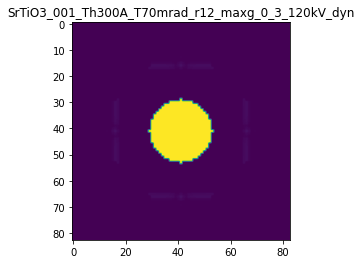

R-factor: 2.7465528532776646e-05

>>> producing the 14. dataset...

The offset applied on thickness: 0.00019249167542626823

The offset applied on Ug: 0.5948028635403034

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.19249167542625
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

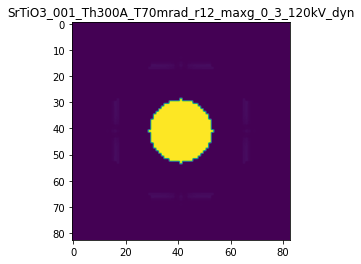

R-factor: 3.5857885120330113e-06

>>> producing the 15. dataset...

The offset applied on thickness: 0.0008707665764879324

The offset applied on Ug: 4.447373549090477

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.87076657648794
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

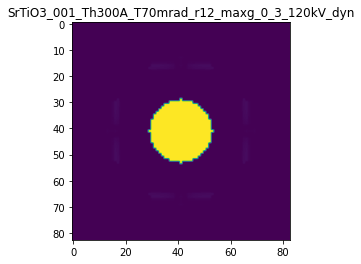

R-factor: 2.7579181521203767e-05

>>> producing the 16. dataset...

The offset applied on thickness: -0.0008505633998211455

The offset applied on Ug: 2.2111407161482726

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.14943660017883
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

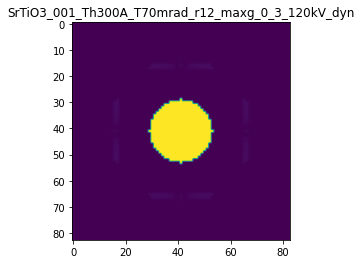

R-factor: 1.4286363637634388e-05

>>> producing the 17. dataset...

The offset applied on thickness: 0.0005866644162503502

The offset applied on Ug: 4.064634462164988

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5866644162503
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

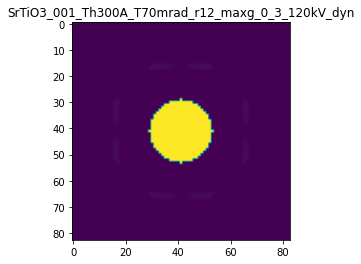

R-factor: 2.531357283595527e-05

>>> producing the 18. dataset...

The offset applied on thickness: -0.0008252242798841683

The offset applied on Ug: 1.3987097227004153

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1747757201158
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

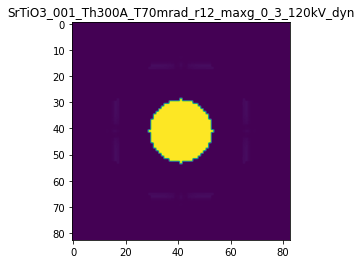

R-factor: 9.172078935927569e-06

>>> producing the 19. dataset...

The offset applied on thickness: 0.0006977110985473616

The offset applied on Ug: -1.2630513627093194

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.69771109854736
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

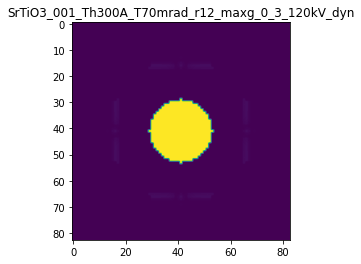

R-factor: 8.019111577610609e-06

>>> producing the 20. dataset...

The offset applied on thickness: 0.0003958482127543031

The offset applied on Ug: 1.7173990427542516

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3958482127543
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

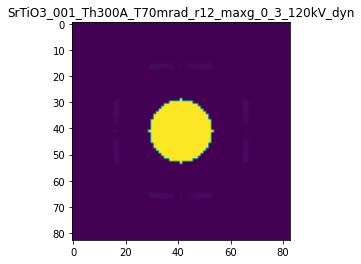

R-factor: 1.055845916071249e-05

>>> producing the 21. dataset...

The offset applied on thickness: -0.0005873103356141201

The offset applied on Ug: -1.7252137720693168

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4126896643859
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

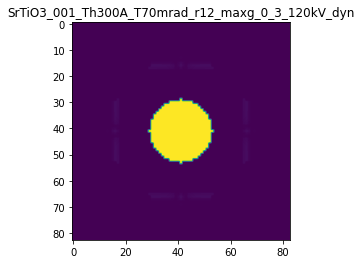

R-factor: 1.010865535626858e-05

>>> producing the 22. dataset...

The offset applied on thickness: 0.0006680224036043194

The offset applied on Ug: 4.114683743939646

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6680224036043
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

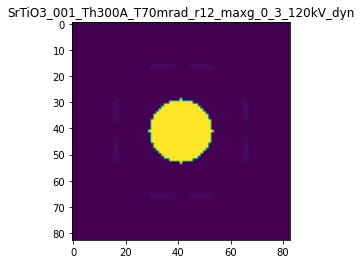

R-factor: 2.559348303821278e-05

>>> producing the 23. dataset...

The offset applied on thickness: 0.00027176535095918287

The offset applied on Ug: 1.6777982259917144

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2717653509592
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

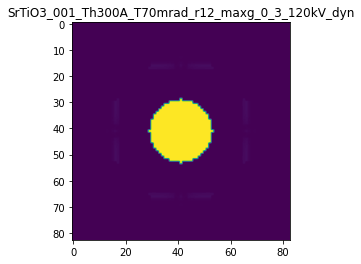

R-factor: 1.0364915898873521e-05

>>> producing the 24. dataset...

The offset applied on thickness: 0.0008740759872953115

The offset applied on Ug: -0.007110803710942264

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8740759872953
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

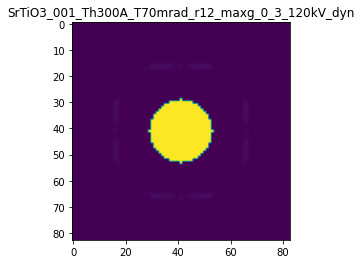

R-factor: 1.1044565309648597e-06

>>> producing the 25. dataset...

The offset applied on thickness: -0.00012001475001441198

The offset applied on Ug: -3.2701946222147296

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8799852499856
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

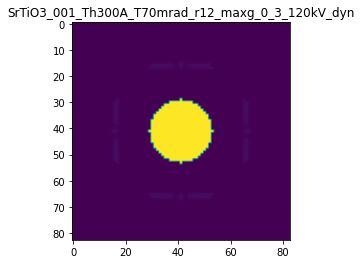

R-factor: 1.883925427797753e-05

>>> producing the 26. dataset...

The offset applied on thickness: -0.0006684981214183637

The offset applied on Ug: 3.9627929748657587

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.33150187858166
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

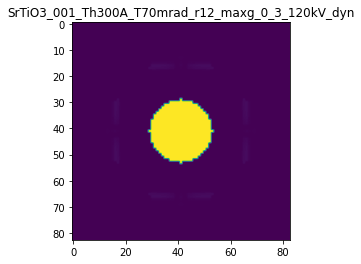

R-factor: 2.519219241107858e-05

>>> producing the 27. dataset...

The offset applied on thickness: 1.9120183221220446e-05

The offset applied on Ug: 4.308400254958525

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.01912018322116
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

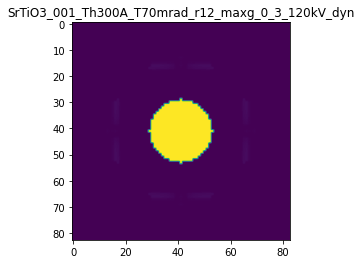

R-factor: 2.705305065453184e-05

>>> producing the 28. dataset...

The offset applied on thickness: -0.0008277821368727305

The offset applied on Ug: 4.837503396532253

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.17221786312723
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

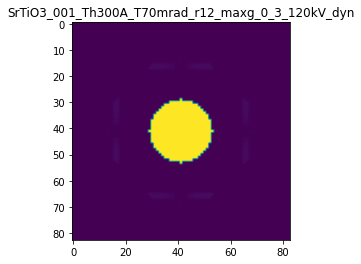

R-factor: 3.064228730247444e-05

>>> producing the 29. dataset...

The offset applied on thickness: -2.5329412785630724e-05

The offset applied on Ug: 1.2980992729337026

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.97467058721435
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

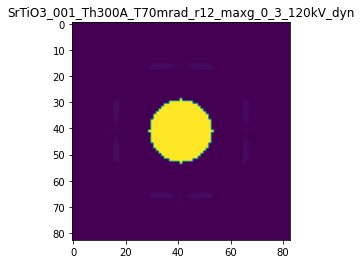

R-factor: 8.106176858021194e-06

>>> producing the 30. dataset...

The offset applied on thickness: -0.0001099578410977411

The offset applied on Ug: 3.1489907540410194

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.89004215890225
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

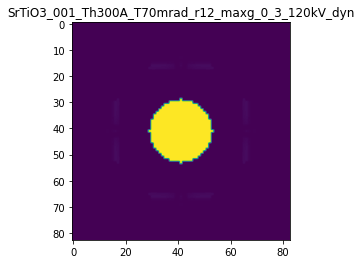

R-factor: 1.9855111886049507e-05

>>> producing the 31. dataset...

The offset applied on thickness: -0.0009578220187758102

The offset applied on Ug: -2.6694360075414454

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0421779812242
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

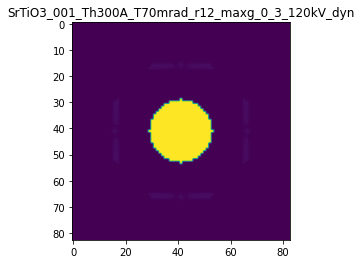

R-factor: 1.540032920458182e-05

>>> producing the 32. dataset...

The offset applied on thickness: 0.0006354111287703859

The offset applied on Ug: -2.068556451211858

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6354111287704
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

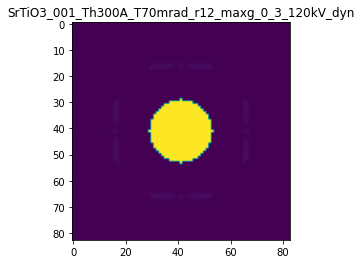

R-factor: 1.2545153991502835e-05

>>> producing the 33. dataset...

The offset applied on thickness: 0.0005763684021192808

The offset applied on Ug: -2.265256794394825

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5763684021193
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

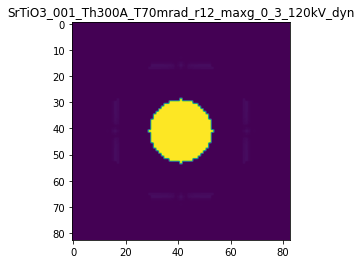

R-factor: 1.3588838752977348e-05

>>> producing the 34. dataset...

The offset applied on thickness: -0.00034034051757609896

The offset applied on Ug: -3.65810632696207

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6596594824239
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

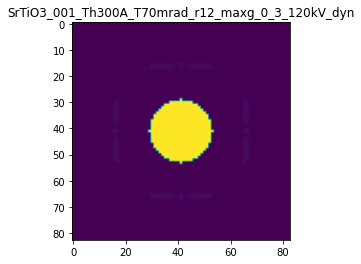

R-factor: 2.085208841379365e-05

>>> producing the 35. dataset...

The offset applied on thickness: 0.0005472769143880214

The offset applied on Ug: 1.9548466590611862

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.54727691438796
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

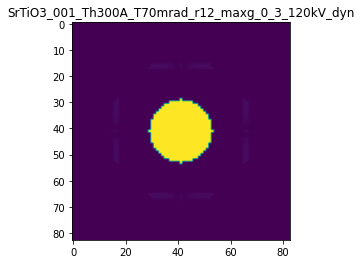

R-factor: 1.1994329478172776e-05

>>> producing the 36. dataset...

The offset applied on thickness: 0.0003062116413511562

The offset applied on Ug: -0.15627944396510998

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3062116413511
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

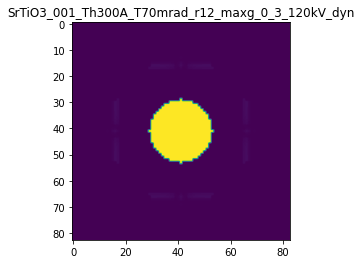

R-factor: 1.1693569907481478e-06

>>> producing the 37. dataset...

The offset applied on thickness: 2.7967545094720325e-06

The offset applied on Ug: 1.5203507867016732

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.00279675450946
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

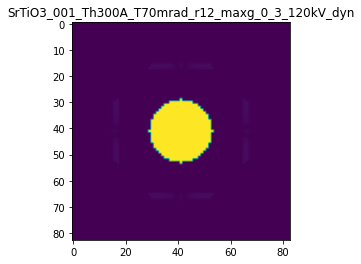

R-factor: 9.495447540078452e-06

>>> producing the 38. dataset...

The offset applied on thickness: 0.0007781749098822764

The offset applied on Ug: -0.9500688103330219

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7781749098823
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

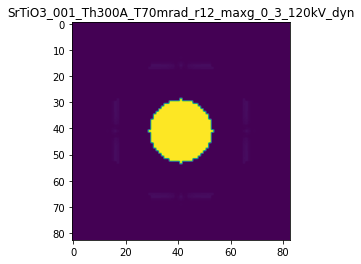

R-factor: 6.240829460213262e-06

>>> producing the 39. dataset...

The offset applied on thickness: 0.0008410553621431077

The offset applied on Ug: 4.448297465042753

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8410553621431
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

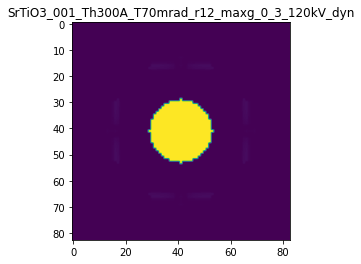

R-factor: 2.759641250534069e-05

>>> producing the 40. dataset...

The offset applied on thickness: -0.0006886415092412541

The offset applied on Ug: -0.16642093283785359

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3113584907587
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

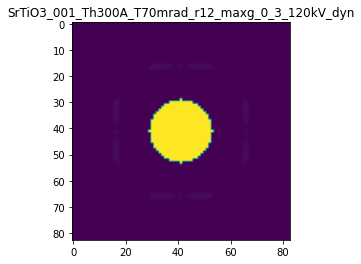

R-factor: 1.2591545465030215e-06

>>> producing the 41. dataset...

The offset applied on thickness: -0.00038587249944867577

The offset applied on Ug: 4.309621401452242

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6141275005513
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

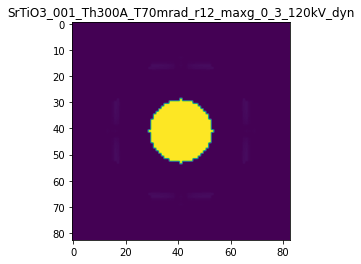

R-factor: 2.722361120196272e-05

>>> producing the 42. dataset...

The offset applied on thickness: -0.0009810867372800343

The offset applied on Ug: 1.059330776096606

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.01891326271993
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

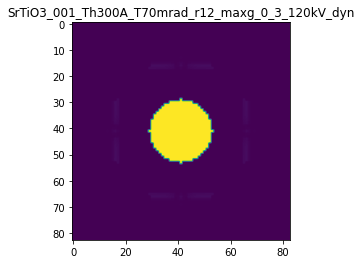

R-factor: 7.157381421742796e-06

>>> producing the 43. dataset...

The offset applied on thickness: 1.0325678171005937e-05

The offset applied on Ug: -4.9273063226023615

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.010325678171
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

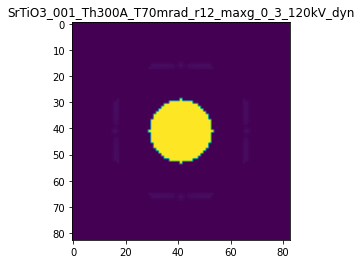

R-factor: 2.7314518164763914e-05

>>> producing the 44. dataset...

The offset applied on thickness: -0.000833830044118568

The offset applied on Ug: 1.0022124850074374

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1661699558814
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

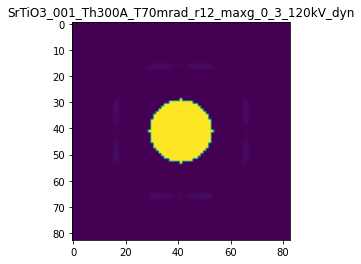

R-factor: 6.709009715536891e-06

>>> producing the 45. dataset...

The offset applied on thickness: 0.0001389821351375451

The offset applied on Ug: -0.38889204212501116

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1389821351375
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

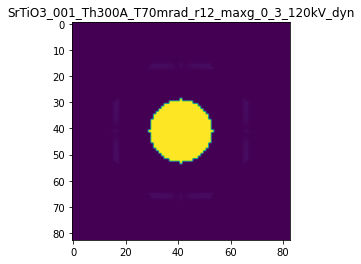

R-factor: 2.454425949217849e-06

>>> producing the 46. dataset...

The offset applied on thickness: -0.00025302382894494004

The offset applied on Ug: -1.5638091987482108

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.74697617105505
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

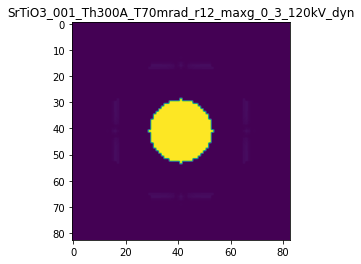

R-factor: 9.246491593060447e-06

>>> producing the 47. dataset...

The offset applied on thickness: 0.000999941937189454

The offset applied on Ug: -5.1107201255036365

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9999419371894
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

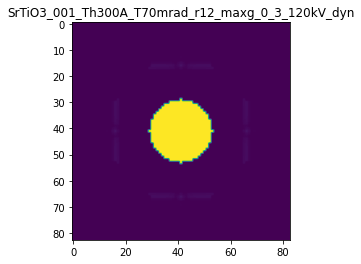

R-factor: 2.8348079658484836e-05

>>> producing the 48. dataset...

The offset applied on thickness: -0.0009599720516880724

The offset applied on Ug: 1.0038623799986441

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0400279483119
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

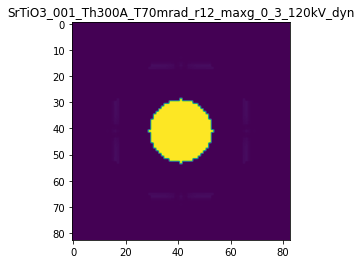

R-factor: 6.801306468930857e-06

>>> producing the 49. dataset...

The offset applied on thickness: -0.0005571364907413579

The offset applied on Ug: 0.10960325858480928

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.44286350925864
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

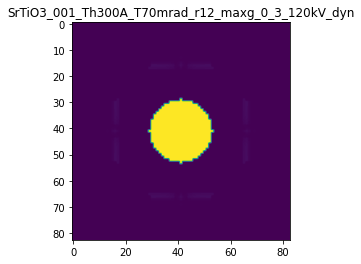

R-factor: 1.1270087469787471e-06

>>> producing the 50. dataset...

The offset applied on thickness: -0.0002952392688557979

The offset applied on Ug: -2.052092635204514

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.70476073114423
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

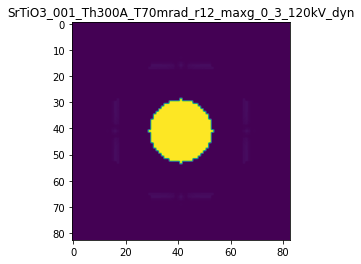

R-factor: 1.2043227101196792e-05

>>> producing the 51. dataset...

The offset applied on thickness: -0.0003573008260449846

The offset applied on Ug: -4.962315239016057

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.642699173955
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

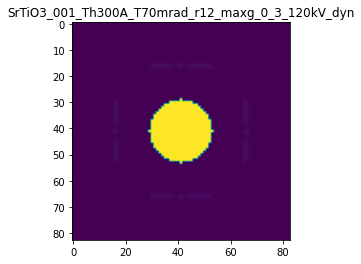

R-factor: 2.7451064070896577e-05

>>> producing the 52. dataset...

The offset applied on thickness: -0.0008029017309362278

The offset applied on Ug: -0.08977736883594957

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.19709826906376
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

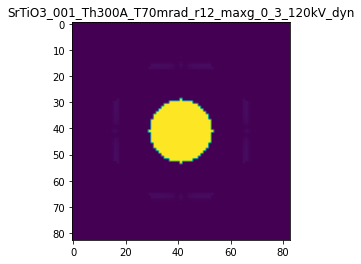

R-factor: 1.1498401467666139e-06

>>> producing the 53. dataset...

The offset applied on thickness: -0.00046353172631708817

The offset applied on Ug: 0.5374115499965524

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5364682736829
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

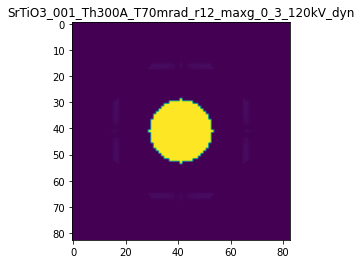

R-factor: 3.600116491009269e-06

>>> producing the 54. dataset...

The offset applied on thickness: -0.0002199252197512105

The offset applied on Ug: -3.9487893937883927

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.78007478024875
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

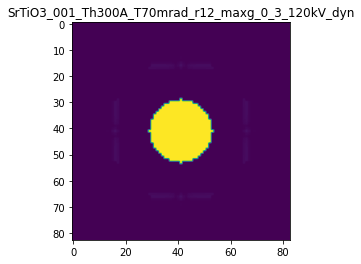

R-factor: 2.2384998495649096e-05

>>> producing the 55. dataset...

The offset applied on thickness: 0.0003593828718181744

The offset applied on Ug: 0.540669556084664

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3593828718182
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

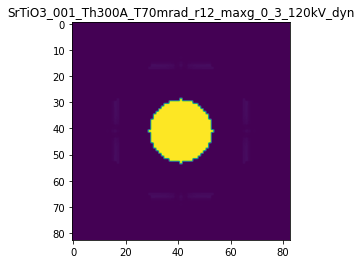

R-factor: 3.208705292776851e-06

>>> producing the 56. dataset...

The offset applied on thickness: -0.000673866176122857

The offset applied on Ug: 4.480534442860071

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3261338238771
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

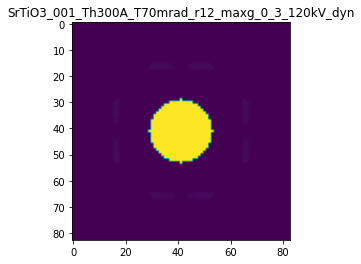

R-factor: 2.8395920856592153e-05

>>> producing the 57. dataset...

The offset applied on thickness: -0.00015012522485867351

The offset applied on Ug: -2.2933555600222006

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8498747751413
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

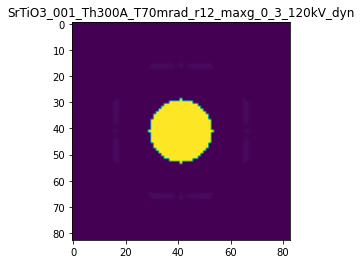

R-factor: 1.3447500608481406e-05

>>> producing the 58. dataset...

The offset applied on thickness: 0.0007395453436650608

The offset applied on Ug: -4.728226230398484

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.73954534366504
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

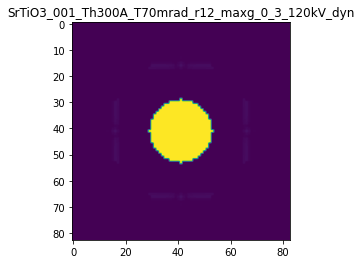

R-factor: 2.6479233352939546e-05

>>> producing the 59. dataset...

The offset applied on thickness: -0.0008089677553660275

The offset applied on Ug: -4.340595106840058

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.19103224463396
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

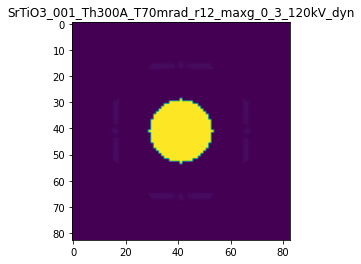

R-factor: 2.433794217352069e-05

>>> producing the 60. dataset...

The offset applied on thickness: 0.0003106381614634164

The offset applied on Ug: 4.86525796975651

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.31063816146343
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

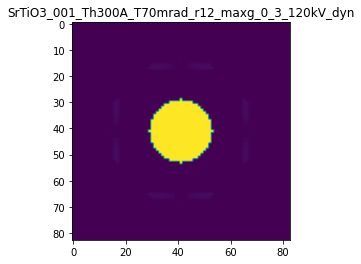

R-factor: 3.0361929297945266e-05

>>> producing the 61. dataset...

The offset applied on thickness: -0.0004830981565750685

The offset applied on Ug: 1.6451675119183893

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.51690184342493
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

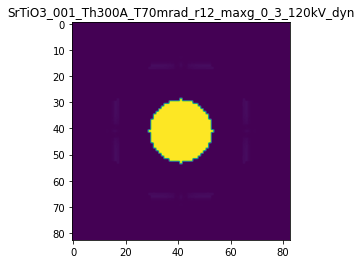

R-factor: 1.0527732287734927e-05

>>> producing the 62. dataset...

The offset applied on thickness: 0.0007316238275051017

The offset applied on Ug: 2.118490979537096

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7316238275051
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

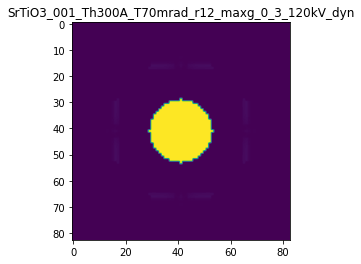

R-factor: 1.2954315540462814e-05

>>> producing the 63. dataset...

The offset applied on thickness: -0.0008903983351722871

The offset applied on Ug: 2.149290711927739

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1096016648277
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

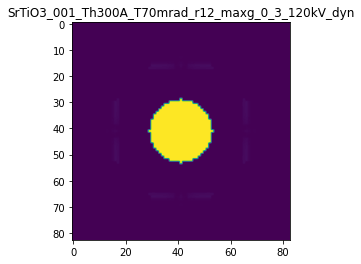

R-factor: 1.391771394475865e-05

>>> producing the 64. dataset...

The offset applied on thickness: 0.000728331415330453

The offset applied on Ug: -3.57147339957059

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.72833141533044
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

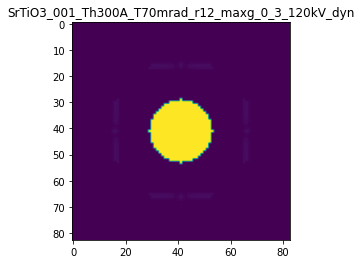

R-factor: 2.0695042842277263e-05

>>> producing the 65. dataset...

The offset applied on thickness: 0.0002967879783303711

The offset applied on Ug: 0.08164278650421693

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.29678797833037
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

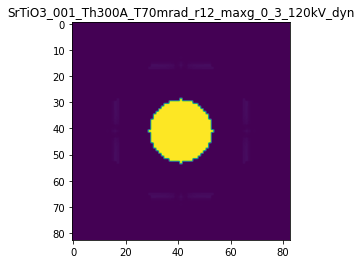

R-factor: 5.887986175794299e-07

>>> producing the 66. dataset...

The offset applied on thickness: 0.00015554753210849715

The offset applied on Ug: -1.814850364128455

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.15554753210847
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

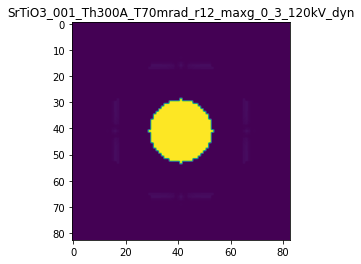

R-factor: 1.0844464533756452e-05

>>> producing the 67. dataset...

The offset applied on thickness: 0.00014265141071046373

The offset applied on Ug: -4.684265497589723

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.14265141071047
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

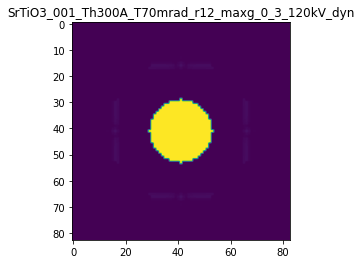

R-factor: 2.6142220500193613e-05

>>> producing the 68. dataset...

The offset applied on thickness: -0.0007241095430173643

The offset applied on Ug: 3.4289622127620634

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2758904569826
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

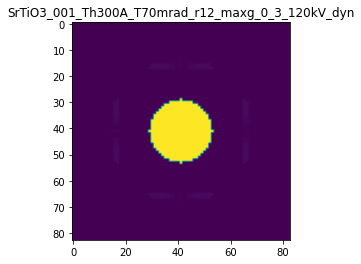

R-factor: 2.1888271520294778e-05

>>> producing the 69. dataset...

The offset applied on thickness: 0.0005586089057207862

The offset applied on Ug: -4.123165756301488

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5586089057208
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

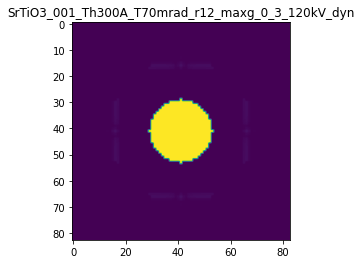

R-factor: 2.3460591379286062e-05

>>> producing the 70. dataset...

The offset applied on thickness: 4.78403421184066e-05

The offset applied on Ug: 4.156778420525415

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0478403421184
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

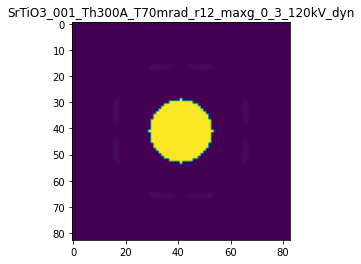

R-factor: 2.6101328573944497e-05

>>> producing the 71. dataset...

The offset applied on thickness: 0.0009021137238548307

The offset applied on Ug: 3.601532669741746

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9021137238548
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

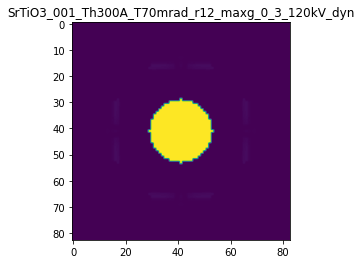

R-factor: 2.2285770829286825e-05

>>> producing the 72. dataset...

The offset applied on thickness: -0.0005776502036561462

The offset applied on Ug: 1.051268122061407

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.42234979634384
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

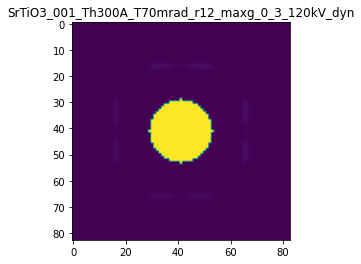

R-factor: 6.854321831361743e-06

>>> producing the 73. dataset...

The offset applied on thickness: -0.0001450647415302333

The offset applied on Ug: -2.106482210576372

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8549352584697
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

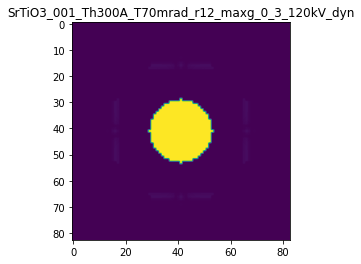

R-factor: 1.2393314989661614e-05

>>> producing the 74. dataset...

The offset applied on thickness: -0.00047947577358727213

The offset applied on Ug: 4.370870440725236

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5205242264127
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

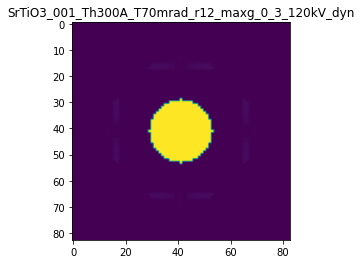

R-factor: 2.764010013914631e-05

>>> producing the 75. dataset...

The offset applied on thickness: 0.0009021141788026219

The offset applied on Ug: -4.480903126561186

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.90211417880266
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

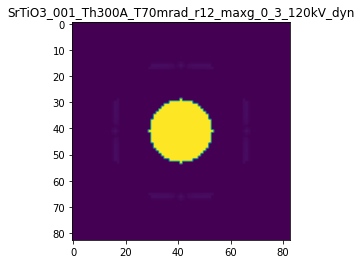

R-factor: 2.532890217821824e-05

>>> producing the 76. dataset...

The offset applied on thickness: -0.00042179477394155377

The offset applied on Ug: 2.459629347407355

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.57820522605846
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

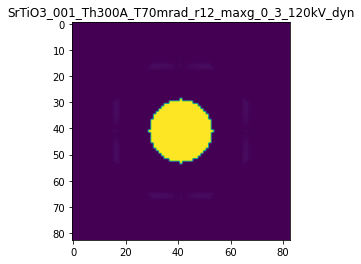

R-factor: 1.564234352390961e-05

>>> producing the 77. dataset...

The offset applied on thickness: 0.0007521450566638757

The offset applied on Ug: -0.9583106423911397

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7521450566639
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

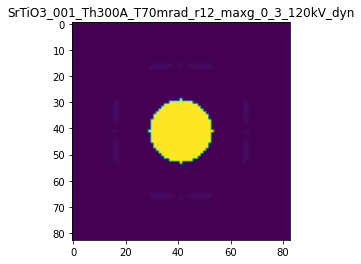

R-factor: 6.271190082054194e-06

>>> producing the 78. dataset...

The offset applied on thickness: 0.0002048873170967105

The offset applied on Ug: -0.7772237039093102

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.20488731709673
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

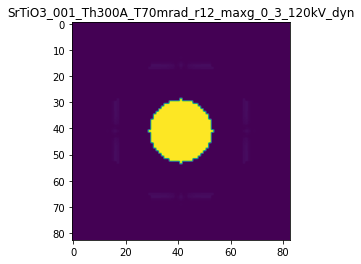

R-factor: 4.8290398229286874e-06

>>> producing the 79. dataset...

The offset applied on thickness: -0.0007200352283820006

The offset applied on Ug: -4.888412219136056

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.279964771618
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

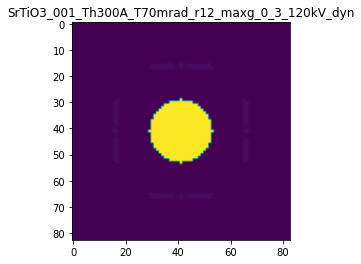

R-factor: 2.707403892957962e-05

>>> producing the 80. dataset...

The offset applied on thickness: 0.0007578644742799039

The offset applied on Ug: 1.121589585436051

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.75786447427987
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

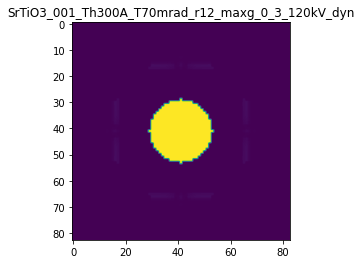

R-factor: 6.672619322484494e-06

>>> producing the 81. dataset...

The offset applied on thickness: 0.0006902852744766875

The offset applied on Ug: -4.339875063975085

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.69028527447665
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

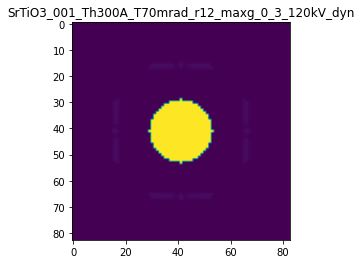

R-factor: 2.457633745141332e-05

>>> producing the 82. dataset...

The offset applied on thickness: -0.0005516484317994253

The offset applied on Ug: 3.2893308171517677

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.44835156820056
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

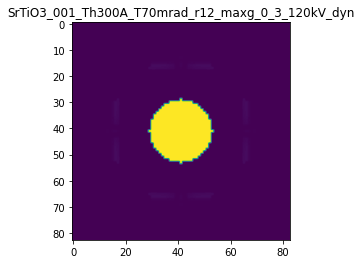

R-factor: 2.0934821210017644e-05

>>> producing the 83. dataset...

The offset applied on thickness: 0.00016390257803266018

The offset applied on Ug: 2.847860830792862

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.16390257803266
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

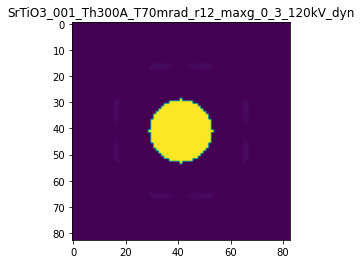

R-factor: 1.78342579395383e-05

>>> producing the 84. dataset...

The offset applied on thickness: -0.00027386758292440705

The offset applied on Ug: 1.26601057526197

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7261324170756
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

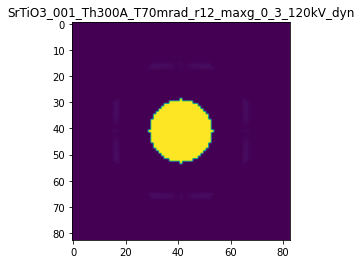

R-factor: 8.030177959198663e-06

>>> producing the 85. dataset...

The offset applied on thickness: 0.0002607597636532091

The offset applied on Ug: -0.9842526833055434

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2607597636532
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

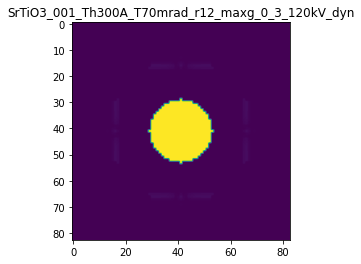

R-factor: 6.092661636536236e-06

>>> producing the 86. dataset...

The offset applied on thickness: -0.0002814406319122607

The offset applied on Ug: -0.988249271860467

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7185593680877
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

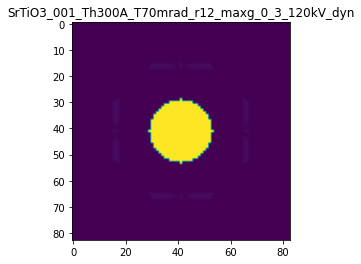

R-factor: 5.861133961904026e-06

>>> producing the 87. dataset...

The offset applied on thickness: -0.0006375301053853233

The offset applied on Ug: 0.8706939731785645

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.36246989461466
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

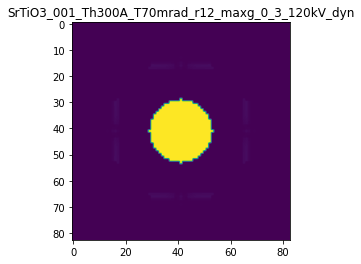

R-factor: 5.770029562166413e-06

>>> producing the 88. dataset...

The offset applied on thickness: -5.438009652336051e-05

The offset applied on Ug: -1.2743922240472683

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9456199034766
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

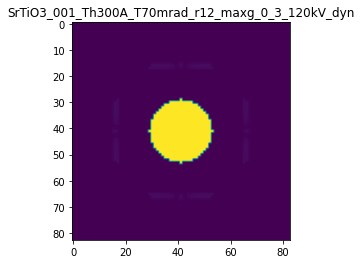

R-factor: 7.623787108903075e-06

>>> producing the 89. dataset...

The offset applied on thickness: 5.384385170472661e-05

The offset applied on Ug: -0.9025438588576947

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0538438517047
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

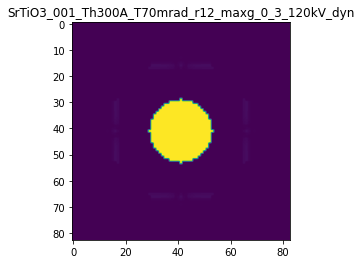

R-factor: 5.4843424199104765e-06

>>> producing the 90. dataset...

The offset applied on thickness: 1.8024460403085697e-05

The offset applied on Ug: 2.5042986260194846

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0180244604031
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

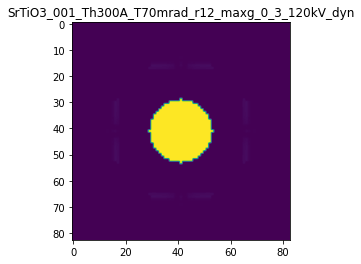

R-factor: 1.5722053944637294e-05

>>> producing the 91. dataset...

The offset applied on thickness: -0.0005366254360205308

The offset applied on Ug: 1.568457988965356

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.46337456397947
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

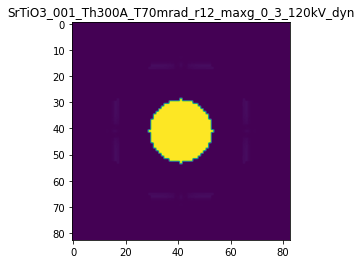

R-factor: 1.007327731212483e-05

>>> producing the 92. dataset...

The offset applied on thickness: -0.0007747299171343603

The offset applied on Ug: 4.201184200861952

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2252700828656
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

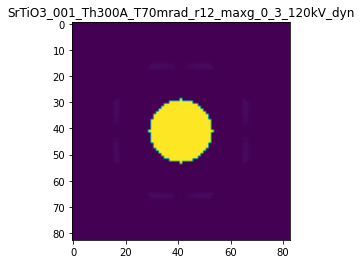

R-factor: 2.6715983440115697e-05

>>> producing the 93. dataset...

The offset applied on thickness: -0.0006070200099487124

The offset applied on Ug: -3.1371826837048005

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3929799900513
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

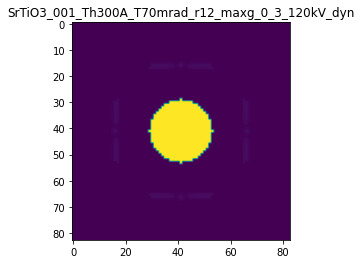

R-factor: 1.8020561119835136e-05

>>> producing the 94. dataset...

The offset applied on thickness: 0.0002020011483382025

The offset applied on Ug: -3.803266078344793

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2020011483382
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

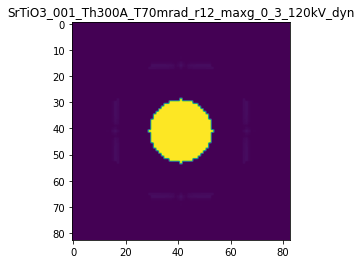

R-factor: 2.1731945873748594e-05

>>> producing the 95. dataset...

The offset applied on thickness: -0.0001960561038912867

The offset applied on Ug: 3.4647991836983887

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8039438961087
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

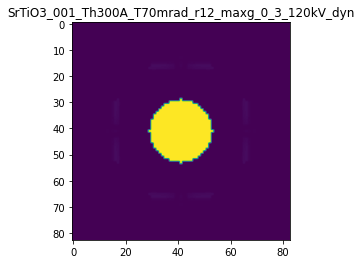

R-factor: 2.187756345174313e-05

>>> producing the 96. dataset...

The offset applied on thickness: -0.0007505715511485018

The offset applied on Ug: 1.3035207333495031

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2494284488515
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

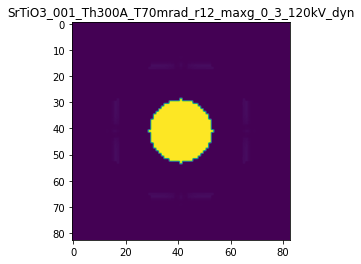

R-factor: 8.532731627595385e-06

>>> producing the 97. dataset...

The offset applied on thickness: -0.0005603097052302933

The offset applied on Ug: -4.8231583736954216

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.43969029476966
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

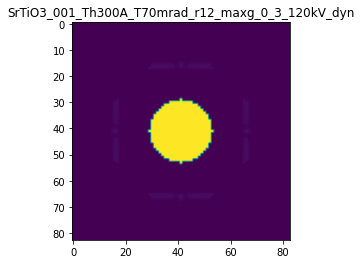

R-factor: 2.6761584211507245e-05

>>> producing the 98. dataset...

The offset applied on thickness: 0.0005449395663127077

The offset applied on Ug: -5.070119612366481

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5449395663127
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

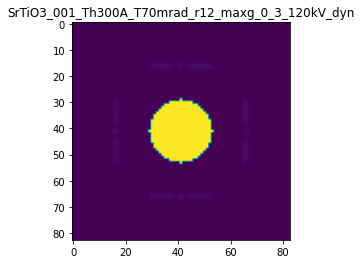

R-factor: 2.8065577874925947e-05

>>> producing the 99. dataset...

The offset applied on thickness: -0.0005272523887559395

The offset applied on Ug: -1.7225718716338794

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.472747611244
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

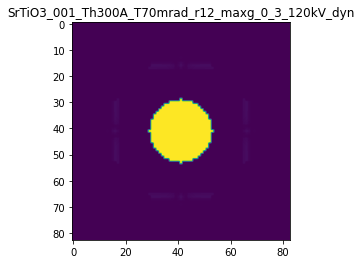

R-factor: 1.0101690841908828e-05

>>> producing the 100. dataset...

The offset applied on thickness: -0.0005268481414670321

The offset applied on Ug: 3.541931451268068

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.47315185853296
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

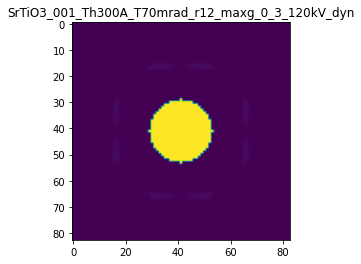

R-factor: 2.250618535727377e-05

>>> producing the 101. dataset...

The offset applied on thickness: -0.00043042107094054804

The offset applied on Ug: 4.573505552779554

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.56957892905945
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

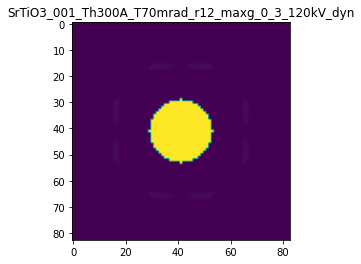

R-factor: 2.8867187662756947e-05

>>> producing the 102. dataset...

The offset applied on thickness: -3.923652594010019e-05

The offset applied on Ug: 2.8869491783939294

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9607634740599
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

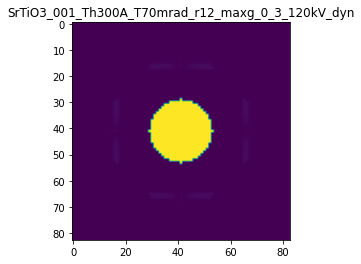

R-factor: 1.8170573561000432e-05

>>> producing the 103. dataset...

The offset applied on thickness: -0.0003465595363991496

The offset applied on Ug: -0.8901026891605136

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6534404636008
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

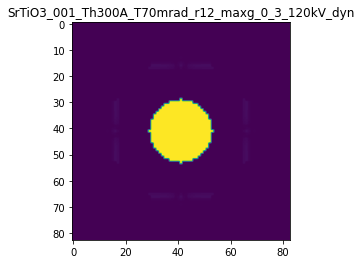

R-factor: 5.265828880909333e-06

>>> producing the 104. dataset...

The offset applied on thickness: 0.0009929534284448685

The offset applied on Ug: -0.8193692723833373

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9929534284448
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

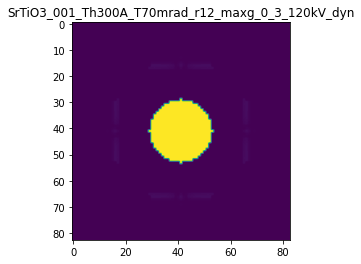

R-factor: 5.6234439554951514e-06

>>> producing the 105. dataset...

The offset applied on thickness: 0.0008178281403864671

The offset applied on Ug: 3.8642410889059646

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.81782814038644
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

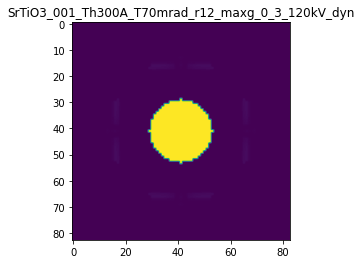

R-factor: 2.396921170441433e-05

>>> producing the 106. dataset...

The offset applied on thickness: 0.0007691486539132904

The offset applied on Ug: -4.86785835382446

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7691486539133
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

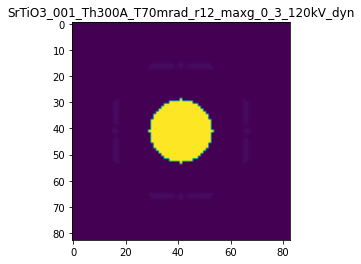

R-factor: 2.7154056252480255e-05

>>> producing the 107. dataset...

The offset applied on thickness: 0.0006712216947893768

The offset applied on Ug: -4.0564297682048585

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6712216947894
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

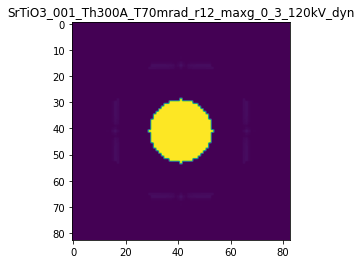

R-factor: 2.3156212116711775e-05

>>> producing the 108. dataset...

The offset applied on thickness: 6.161010073475759e-05

The offset applied on Ug: 2.270161805075355

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.06161010073475
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

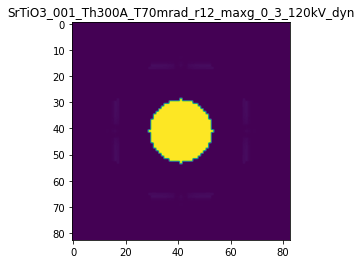

R-factor: 1.4216646995402895e-05

>>> producing the 109. dataset...

The offset applied on thickness: -0.0009088519666879642

The offset applied on Ug: 0.16295943157686793

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.09114803331204
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

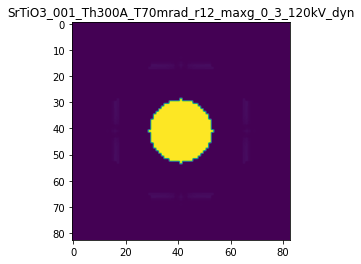

R-factor: 1.7525704672093193e-06

>>> producing the 110. dataset...

The offset applied on thickness: -0.0007056357372638311

The offset applied on Ug: 4.703256276908871

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.29436426273617
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

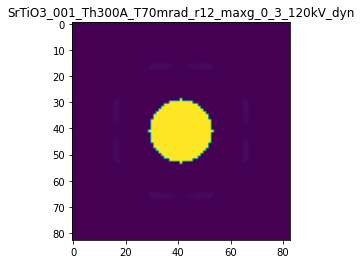

R-factor: 2.977372805022712e-05

>>> producing the 111. dataset...

The offset applied on thickness: -0.0004538941226618825

The offset applied on Ug: -0.3578087268477884

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5461058773381
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

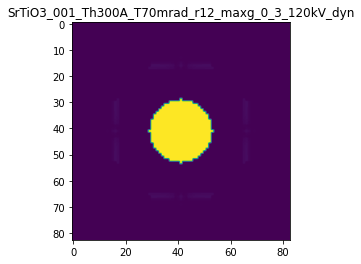

R-factor: 2.125454464208438e-06

>>> producing the 112. dataset...

The offset applied on thickness: -0.0008667599614435024

The offset applied on Ug: -2.246721280770562

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1332400385565
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

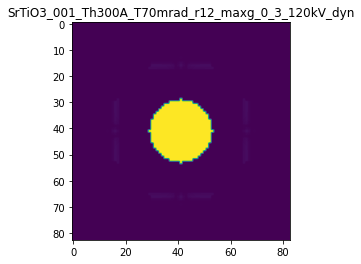

R-factor: 1.3040573346306865e-05

>>> producing the 113. dataset...

The offset applied on thickness: 0.00027961583459766825

The offset applied on Ug: -2.8661639911472867

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2796158345977
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

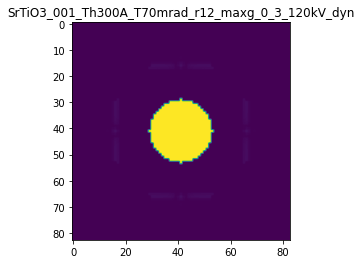

R-factor: 1.6766725113391018e-05

>>> producing the 114. dataset...

The offset applied on thickness: -0.0005769749418880936

The offset applied on Ug: -0.5782460154934006

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.42302505811193
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

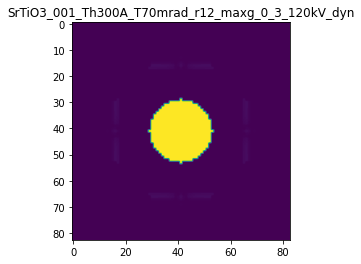

R-factor: 3.4049703536242094e-06

>>> producing the 115. dataset...

The offset applied on thickness: -0.0007842121474771318

The offset applied on Ug: 0.45867850836001256

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.21578785252285
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

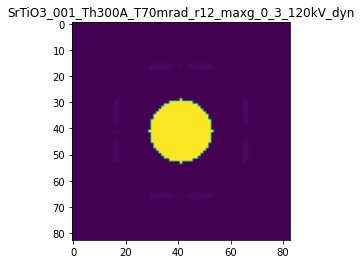

R-factor: 3.3469100067077364e-06

>>> producing the 116. dataset...

The offset applied on thickness: -0.00013344803248332006

The offset applied on Ug: -4.074143820499123

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.86655196751667
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

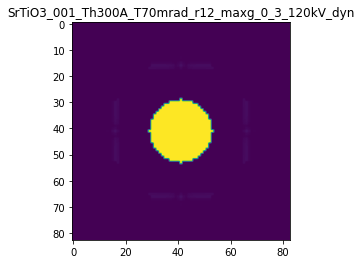

R-factor: 2.3045013796491548e-05

>>> producing the 117. dataset...

The offset applied on thickness: 0.0008320293716883056

The offset applied on Ug: 2.6547782428116933

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8320293716883
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

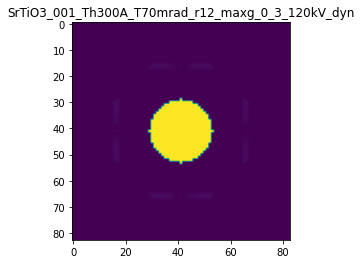

R-factor: 1.6325557217927555e-05

>>> producing the 118. dataset...

The offset applied on thickness: 0.00016146486267629157

The offset applied on Ug: -4.590838530898242

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.16146486267627
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

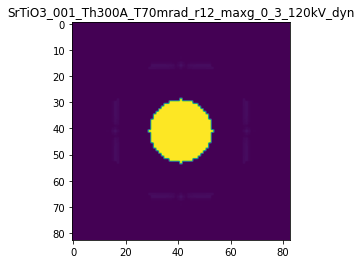

R-factor: 2.5687800866269416e-05

>>> producing the 119. dataset...

The offset applied on thickness: -0.00025536315706175427

The offset applied on Ug: -3.3778991461410444

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.74463684293823
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fi

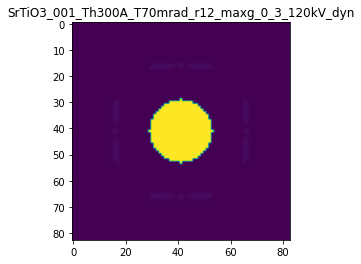

R-factor: 1.938442461067281e-05

>>> producing the 120. dataset...

The offset applied on thickness: 0.0007322025697257698

The offset applied on Ug: -3.984951778509864

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.73220256972576
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

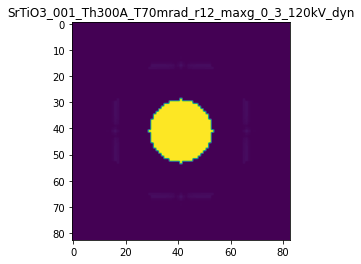

R-factor: 2.281090608481578e-05

>>> producing the 121. dataset...

The offset applied on thickness: -0.00027140280909499783

The offset applied on Ug: -3.054349470024822

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.728597190905
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

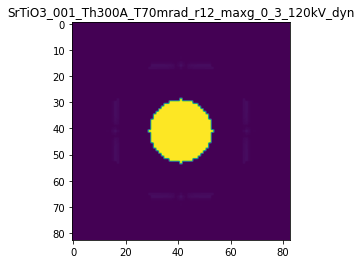

R-factor: 1.7635799304038813e-05

>>> producing the 122. dataset...

The offset applied on thickness: 0.00045942324686783833

The offset applied on Ug: 4.838617803733045

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4594232468678
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

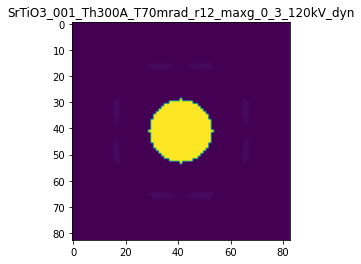

R-factor: 3.0142101621565154e-05

>>> producing the 123. dataset...

The offset applied on thickness: 0.0001717801375779462

The offset applied on Ug: 0.5649833775733464

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.17178013757797
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

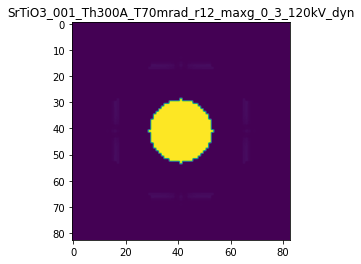

R-factor: 3.409747128958204e-06

>>> producing the 124. dataset...

The offset applied on thickness: 0.0008502981206653717

The offset applied on Ug: -2.061576536677819

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8502981206654
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

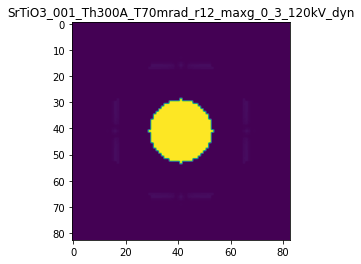

R-factor: 1.2656561755377223e-05

>>> producing the 125. dataset...

The offset applied on thickness: -0.0006419374449342974

The offset applied on Ug: 5.0841906540461945

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3580625550657
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

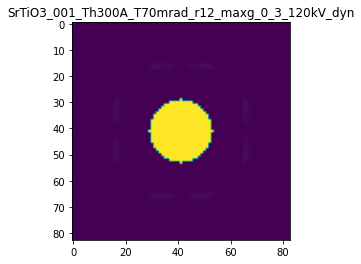

R-factor: 3.2065238231873484e-05

>>> producing the 126. dataset...

The offset applied on thickness: 0.0007880491837825449

The offset applied on Ug: 0.05100574203213114

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.78804918378256
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

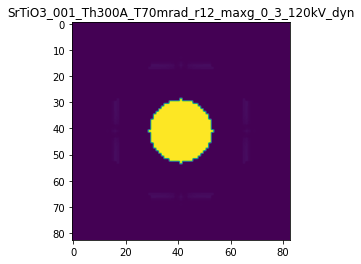

R-factor: 1.0635250676315237e-06

>>> producing the 127. dataset...

The offset applied on thickness: 0.0005181832528200956

The offset applied on Ug: -4.716097957582557

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5181832528201
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

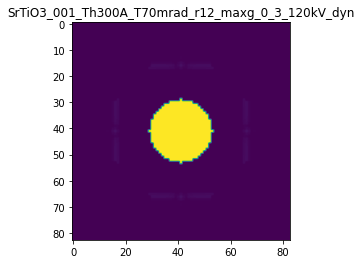

R-factor: 2.6370585489255287e-05

>>> producing the 128. dataset...

The offset applied on thickness: -0.0009264212013927671

The offset applied on Ug: 2.6134718757591817

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.07357879860723
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

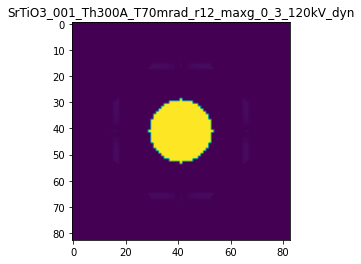

R-factor: 1.6861743896411477e-05

>>> producing the 129. dataset...

The offset applied on thickness: 0.0009389484076238885

The offset applied on Ug: -2.077207941157852

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.93894840762385
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

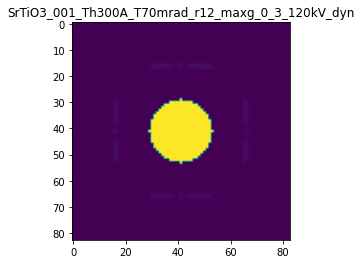

R-factor: 1.2806163439862232e-05

>>> producing the 130. dataset...

The offset applied on thickness: -0.0005900060518652781

The offset applied on Ug: 1.5857965058462082

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.40999394813474
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

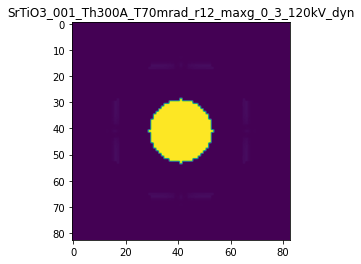

R-factor: 1.0211424998581252e-05

>>> producing the 131. dataset...

The offset applied on thickness: 0.0002732176490022156

The offset applied on Ug: 4.587607755280293

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2732176490022
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

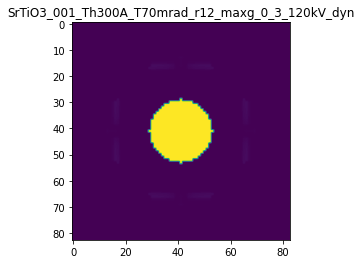

R-factor: 2.8675308312165483e-05

>>> producing the 132. dataset...

The offset applied on thickness: 0.00025787129993887795

The offset applied on Ug: 2.6756995714547918

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.25787129993887
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

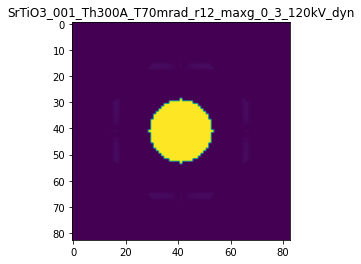

R-factor: 1.6702728179776548e-05

>>> producing the 133. dataset...

The offset applied on thickness: 0.0008664712572807931

The offset applied on Ug: -2.200967603399637

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.86647125728075
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

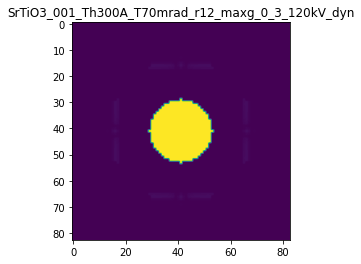

R-factor: 1.343288350752829e-05

>>> producing the 134. dataset...

The offset applied on thickness: -0.000258519918715558

The offset applied on Ug: 4.689634230707257

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7414800812844
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

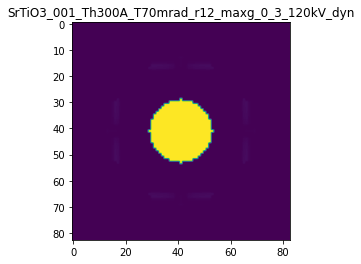

R-factor: 2.951076860315109e-05

>>> producing the 135. dataset...

The offset applied on thickness: 0.0007282831122793911

The offset applied on Ug: 2.842250880142558

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.72828311227937
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

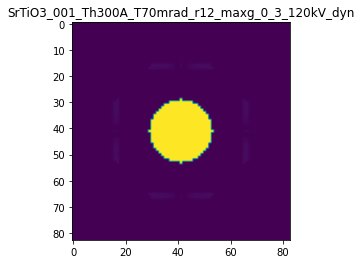

R-factor: 1.756016741542729e-05

>>> producing the 136. dataset...

The offset applied on thickness: -0.00014731047163536547

The offset applied on Ug: 0.6108577837360849

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.85268952836464
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

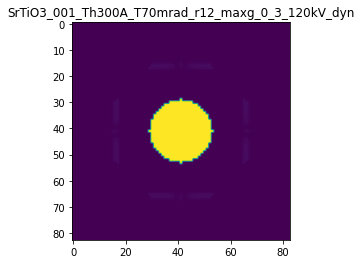

R-factor: 3.860198075659063e-06

>>> producing the 137. dataset...

The offset applied on thickness: 0.0007484906272918915

The offset applied on Ug: 4.814477894024747

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.74849062729186
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

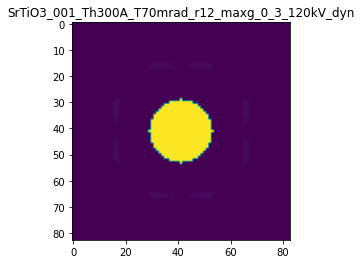

R-factor: 2.9884784796614827e-05

>>> producing the 138. dataset...

The offset applied on thickness: -0.0002915793269382081

The offset applied on Ug: -4.048375373194534

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7084206730618
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

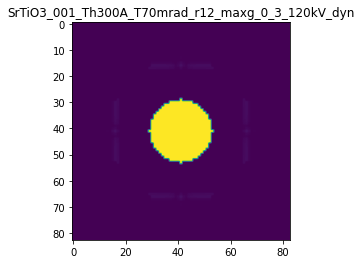

R-factor: 2.2887254348870602e-05

>>> producing the 139. dataset...

The offset applied on thickness: 0.0005029050674757638

The offset applied on Ug: -2.100902858060822

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.50290506747575
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

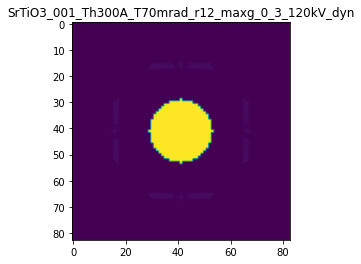

R-factor: 1.2638263859813234e-05

>>> producing the 140. dataset...

The offset applied on thickness: -0.0006459603029508896

The offset applied on Ug: -2.76970998842314

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3540396970491
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

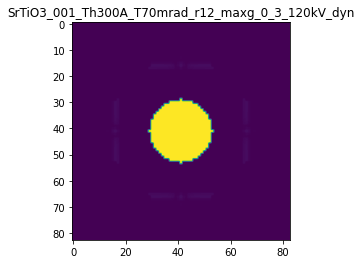

R-factor: 1.599947237242872e-05



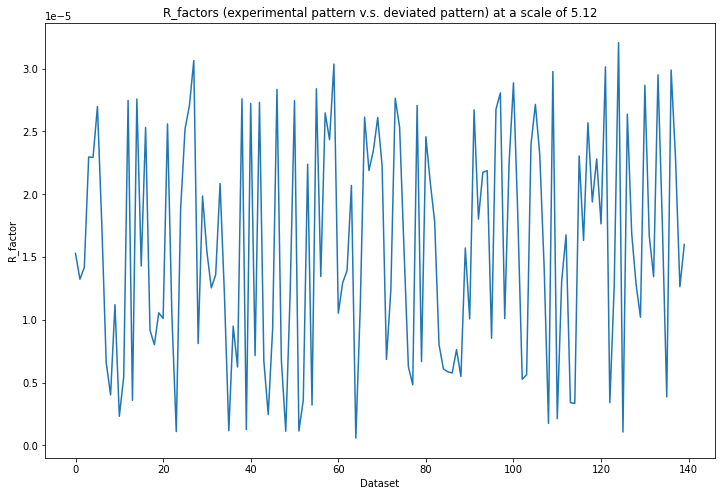

>>> start to train the ANN 

Epoch 1/30
5/5 [==============================] - 1s 126ms/step - loss: 0.3664 - acc: 0.6600 - val_loss: 0.3957 - val_acc: 0.8000
Epoch 2/30
5/5 [==============================] - 1s 106ms/step - loss: 0.3606 - acc: 0.8200 - val_loss: 0.3118 - val_acc: 0.0000e+00
Epoch 3/30
5/5 [==============================] - 1s 105ms/step - loss: 0.2944 - acc: 0.0000e+00 - val_loss: 0.2659 - val_acc: 0.0000e+00
Epoch 4/30
5/5 [==============================] - 1s 106ms/step - loss: 0.2477 - acc: 0.0000e+00 - val_loss: 0.2218 - val_acc: 0.0000e+00
Epoch 5/30
5/5 [==============================] - 1s 106ms/step - loss: 0.2048 - acc: 0.0000e+00 - val_loss: 0.1838 - val_acc: 0.0000e+00
Epoch 6/30
5/5 [==============================] - 1s 106ms/step - loss: 0.1698 - acc: 0.0000e+00 - val_loss: 0.1531 - val_acc: 0.0000e+00
Epoch 7/30
5/5 [==============================] - 1s 106ms/step - loss: 0.1425 - acc: 0.0000e+00 - val_loss: 0.1301 - val_acc: 0.0000e+00
Epoch 8/30
5/5 [=

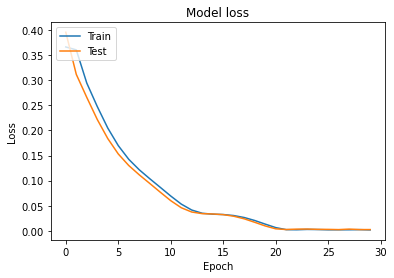

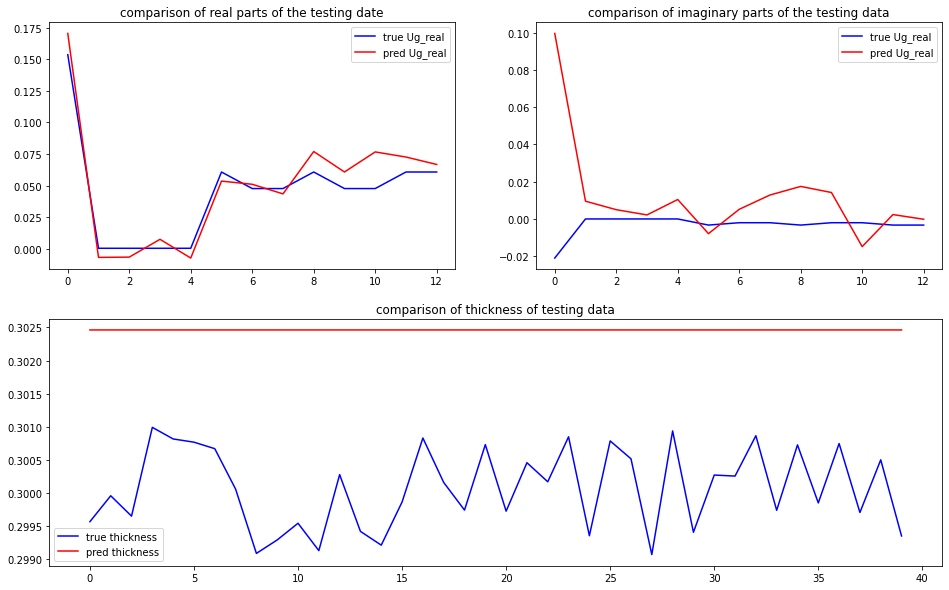

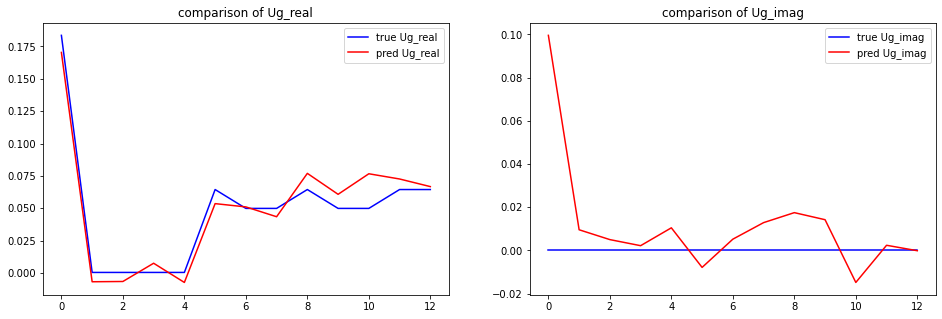

predicted thickness: 30.246251821517944 nm
mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=302.46251821517944
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 13 different beams

InputUg:
[ 1.70352280e-01+0.j         -

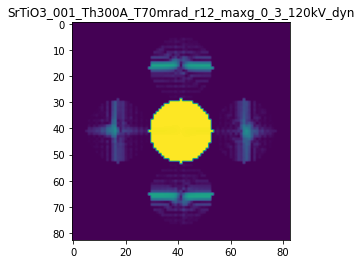

X_sim.max(): 0.9996246752063735
R-factor at a scale of 5.12 is 0.027378981117423595.

-----------------------------------------------------------------------------------------------------

>>> start to produce Dataset at a scale of 10.24

-----------------------------------------------------------------------------------------------------

>>> producing the 1. dataset...

The offset applied on thickness: 4.64639057243117e-05

The offset applied on Ug: 8.019700034399198

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
targ

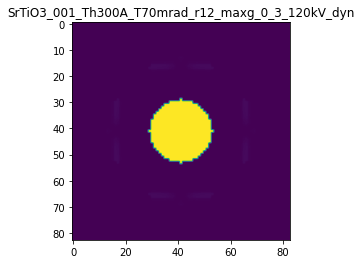

R-factor: 4.896840562411499e-05

>>> producing the 2. dataset...

The offset applied on thickness: -0.0008571812460040813

The offset applied on Ug: 3.8256160383110274

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1428187539959
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

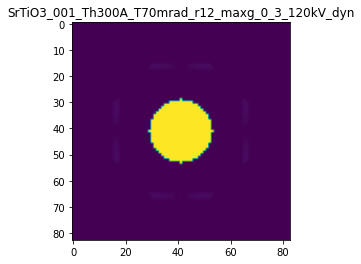

R-factor: 2.4423089738903936e-05

>>> producing the 3. dataset...

The offset applied on thickness: 0.0006615739840307448

The offset applied on Ug: 8.37756430940585

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6615739840308
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrTi

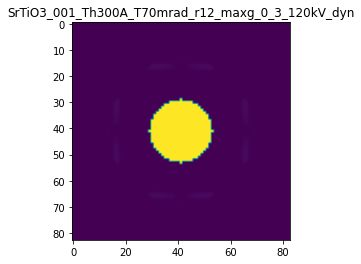

R-factor: 5.073272890089401e-05

>>> producing the 4. dataset...

The offset applied on thickness: 0.0008773335742789353

The offset applied on Ug: -7.938419331705522

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8773335742789
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

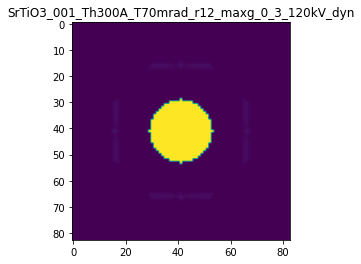

R-factor: 3.999324009424136e-05

>>> producing the 5. dataset...

The offset applied on thickness: -0.0002925548931571196

The offset applied on Ug: -0.5965196053782598

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7074451068429
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

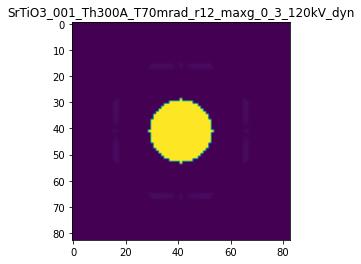

R-factor: 3.528720510307133e-06

>>> producing the 6. dataset...

The offset applied on thickness: -0.00011456831615086217

The offset applied on Ug: -5.358146971237488

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8854316838491
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

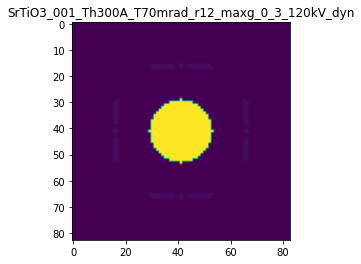

R-factor: 2.9349576387482366e-05

>>> producing the 7. dataset...

The offset applied on thickness: -0.00045523993930039454

The offset applied on Ug: 9.890876600563855

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.54476006069956
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

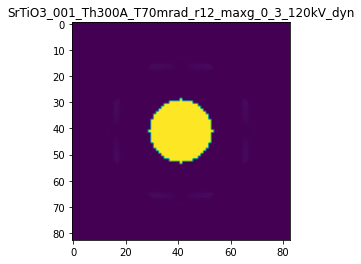

R-factor: 5.9008999978964984e-05

>>> producing the 8. dataset...

The offset applied on thickness: 0.00024836292975447026

The offset applied on Ug: -2.3914838605945286

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2483629297545
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

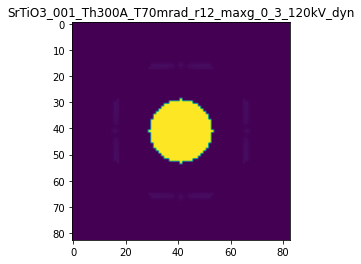

R-factor: 1.4130793578489862e-05

>>> producing the 9. dataset...

The offset applied on thickness: 0.0003606127964587964

The offset applied on Ug: -3.792894055975537

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3606127964588
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

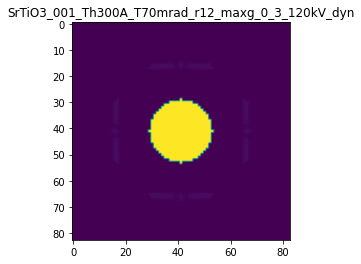

R-factor: 2.172034999301279e-05

>>> producing the 10. dataset...

The offset applied on thickness: -4.596898701683449e-05

The offset applied on Ug: -0.38387795040606765

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9540310129832
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

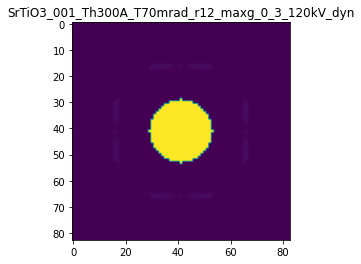

R-factor: 2.3181845443567317e-06

>>> producing the 11. dataset...

The offset applied on thickness: 0.00021183648151433453

The offset applied on Ug: -3.9426576005867355

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.21183648151435
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

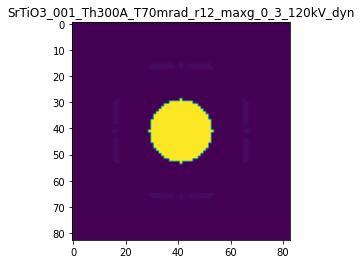

R-factor: 2.2450076816315658e-05

>>> producing the 12. dataset...

The offset applied on thickness: -0.0007652644977779482

The offset applied on Ug: 3.8912795851776263

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.234735502222
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

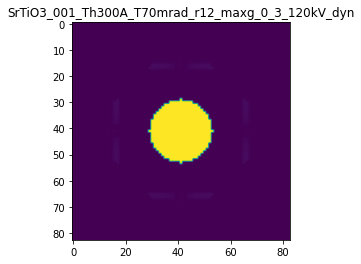

R-factor: 2.4790533383258244e-05

>>> producing the 13. dataset...

The offset applied on thickness: -0.0005130629852492072

The offset applied on Ug: 6.716936329427497

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.48693701475077
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

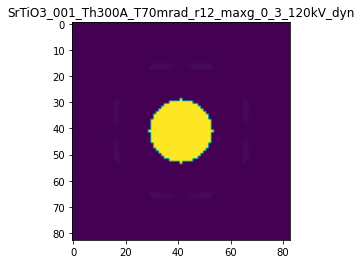

R-factor: 4.176027732440258e-05

>>> producing the 14. dataset...

The offset applied on thickness: -0.0003609360975613338

The offset applied on Ug: -4.3688767840692435

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.63906390243864
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

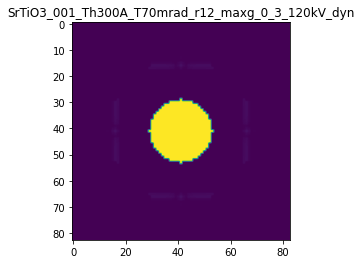

R-factor: 2.4512775271184607e-05

>>> producing the 15. dataset...

The offset applied on thickness: 0.0009154878721334274

The offset applied on Ug: 1.7427904766464166

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9154878721334
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

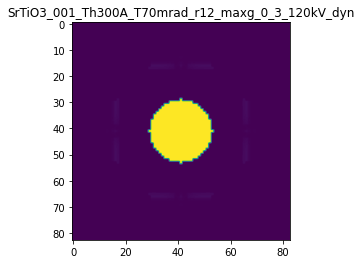

R-factor: 1.0485049814758047e-05

>>> producing the 16. dataset...

The offset applied on thickness: 0.00011518143049761842

The offset applied on Ug: -2.7179163547725738

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1151814304976
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

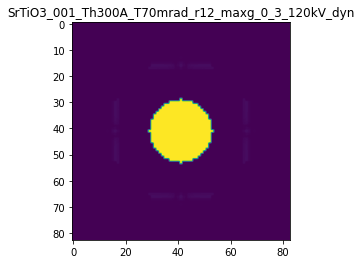

R-factor: 1.5897393369403014e-05

>>> producing the 17. dataset...

The offset applied on thickness: 0.0006682788171441385

The offset applied on Ug: 3.462761375784355

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.66827881714414
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

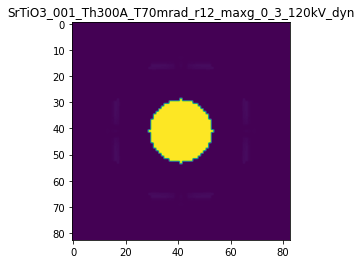

R-factor: 2.1507662129396348e-05

>>> producing the 18. dataset...

The offset applied on thickness: 2.798257916854996e-05

The offset applied on Ug: 0.44408862924335835

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0279825791685
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

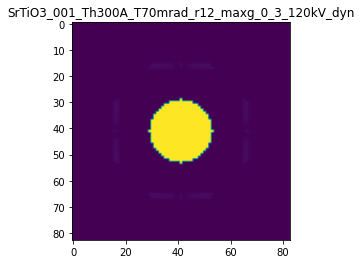

R-factor: 2.7293555977286053e-06

>>> producing the 19. dataset...

The offset applied on thickness: -0.0007581897807083515

The offset applied on Ug: 8.223110659168434

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.24181021929166
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

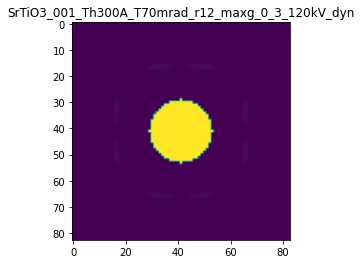

R-factor: 5.034419416693799e-05

>>> producing the 20. dataset...

The offset applied on thickness: 0.0006894525378954701

The offset applied on Ug: 2.005369112700421

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6894525378955
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

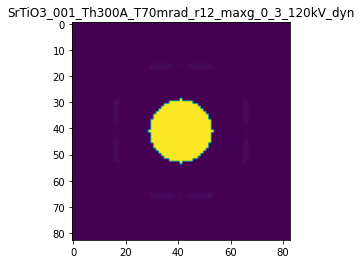

R-factor: 1.2252395381618342e-05

>>> producing the 21. dataset...

The offset applied on thickness: -0.0003745860491329063

The offset applied on Ug: 3.719105258071968

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6254139508671
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

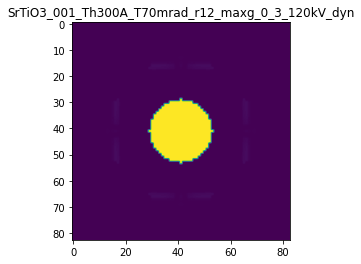

R-factor: 2.354579319793185e-05

>>> producing the 22. dataset...

The offset applied on thickness: -0.0005274544812692091

The offset applied on Ug: -6.747119274943552

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4725455187308
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

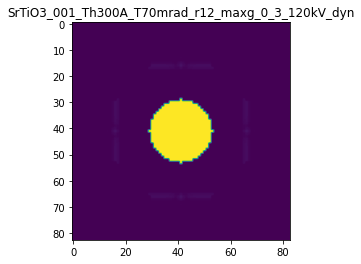

R-factor: 3.551210393709039e-05

>>> producing the 23. dataset...

The offset applied on thickness: -0.0007790429772101757

The offset applied on Ug: 9.39100976991795

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.22095702278983
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

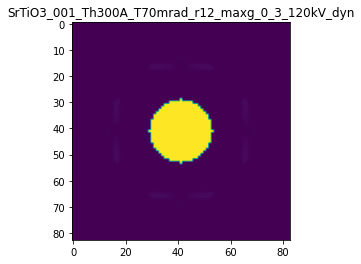

R-factor: 5.6559265035944456e-05

>>> producing the 24. dataset...

The offset applied on thickness: 0.00040200061798795986

The offset applied on Ug: -2.7917542623141096

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.40200061798794
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

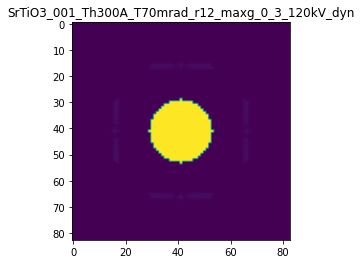

R-factor: 1.6402506338788514e-05

>>> producing the 25. dataset...

The offset applied on thickness: 0.0005243377446246611

The offset applied on Ug: 0.008096082427528017

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5243377446247
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

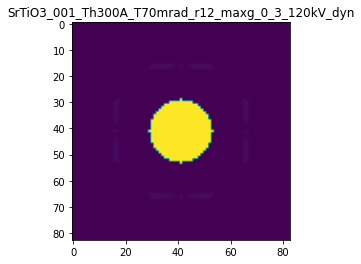

R-factor: 6.694534023356717e-07

>>> producing the 26. dataset...

The offset applied on thickness: -0.0008137954230280931

The offset applied on Ug: 5.743457361229953

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1862045769719
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

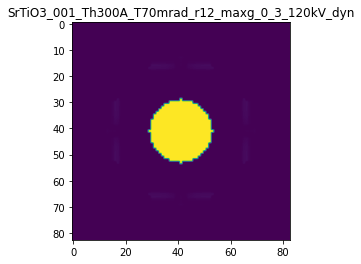

R-factor: 3.610105183003629e-05

>>> producing the 27. dataset...

The offset applied on thickness: 0.0007688460149344259

The offset applied on Ug: -5.400747014076785

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7688460149344
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

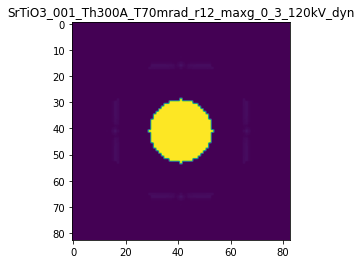

R-factor: 2.9646787255047163e-05

>>> producing the 28. dataset...

The offset applied on thickness: -0.00015986476837191166

The offset applied on Ug: 0.5256545424691104

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.84013523162804
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

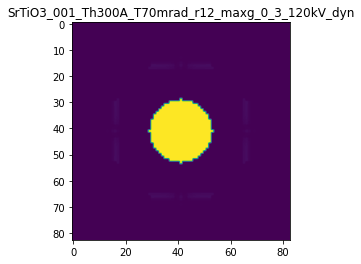

R-factor: 3.3377061682718397e-06

>>> producing the 29. dataset...

The offset applied on thickness: 0.000864972764934673

The offset applied on Ug: -1.177756120133722

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.8649727649347
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

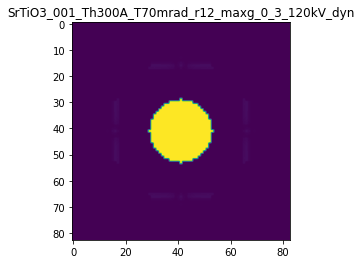

R-factor: 7.63859813314404e-06

>>> producing the 30. dataset...

The offset applied on thickness: -0.00030919714657695385

The offset applied on Ug: -1.8830444932537693

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.690802853423
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

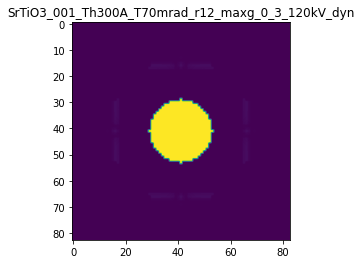

R-factor: 1.1074993279701696e-05

>>> producing the 31. dataset...

The offset applied on thickness: 0.00015074194791849904

The offset applied on Ug: -0.19195890361955437

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.15074194791845
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

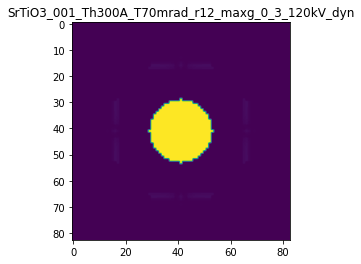

R-factor: 1.2685135784960317e-06

>>> producing the 32. dataset...

The offset applied on thickness: -0.0003252809344049854

The offset applied on Ug: -4.461074212597557

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.674719065595
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

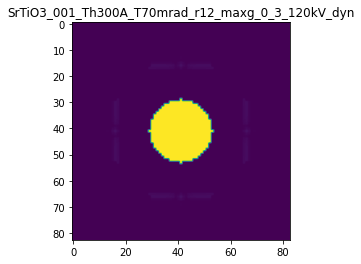

R-factor: 2.498210710958947e-05

>>> producing the 33. dataset...

The offset applied on thickness: -0.0006328926815746509

The offset applied on Ug: -5.915815559189591

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3671073184254
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

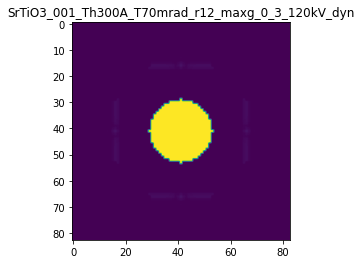

R-factor: 3.1929107475639166e-05

>>> producing the 34. dataset...

The offset applied on thickness: -0.0005120268379268058

The offset applied on Ug: -8.893807482559998

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4879731620732
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

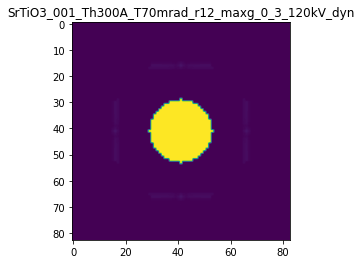

R-factor: 4.308041722189447e-05

>>> producing the 35. dataset...

The offset applied on thickness: 0.0005276053190999423

The offset applied on Ug: -4.847254903173876

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.52760531909996
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

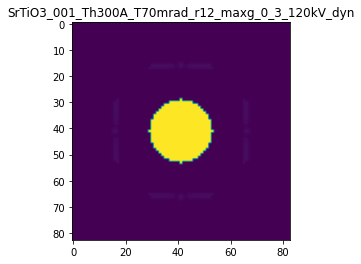

R-factor: 2.7001917060105644e-05

>>> producing the 36. dataset...

The offset applied on thickness: 0.0002494113883121445

The offset applied on Ug: 5.497407141757629

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.2494113883121
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

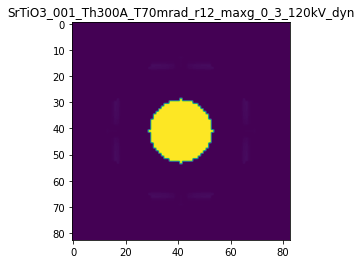

R-factor: 3.4236060969657805e-05

>>> producing the 37. dataset...

The offset applied on thickness: 0.000761197802281669

The offset applied on Ug: -7.200927316404964

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7611978022817
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

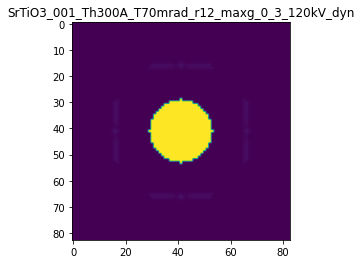

R-factor: 3.731683732372936e-05

>>> producing the 38. dataset...

The offset applied on thickness: 0.0009525493092760369

The offset applied on Ug: -7.6299266349289745

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.952549309276
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

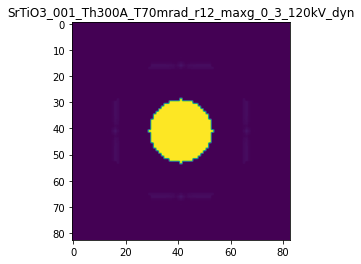

R-factor: 3.891044669117641e-05

>>> producing the 39. dataset...

The offset applied on thickness: -0.0001793798124678967

The offset applied on Ug: 9.68059008476924

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8206201875321
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

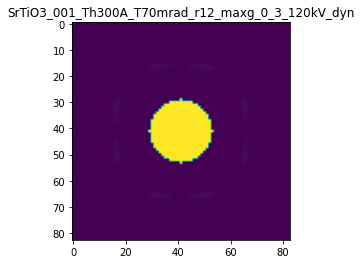

R-factor: 5.78570360758825e-05

>>> producing the 40. dataset...

The offset applied on thickness: -5.382310909382593e-05

The offset applied on Ug: 6.474151015180735

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.94617689090614
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

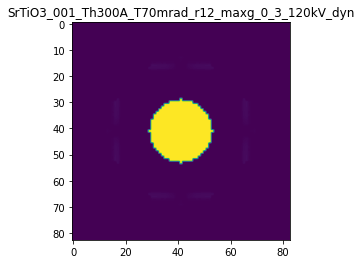

R-factor: 4.018559700067009e-05

>>> producing the 41. dataset...

The offset applied on thickness: -0.000743048870910944

The offset applied on Ug: -1.9132086405675637

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2569511290891
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

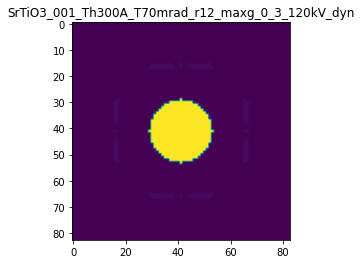

R-factor: 1.1165647360449377e-05

>>> producing the 42. dataset...

The offset applied on thickness: 0.0004023947338616518

The offset applied on Ug: -10.225599000553762

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.4023947338617
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

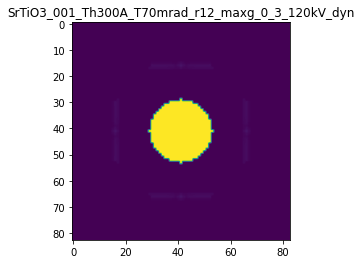

R-factor: 4.721064964740411e-05

>>> producing the 43. dataset...

The offset applied on thickness: 0.00039165193334166504

The offset applied on Ug: 5.3929383147851535

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3916519333417
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

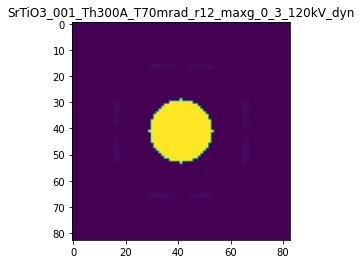

R-factor: 3.355177984817101e-05

>>> producing the 44. dataset...

The offset applied on thickness: 3.511995235991416e-05

The offset applied on Ug: -3.4892935812291923

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.03511995235993
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

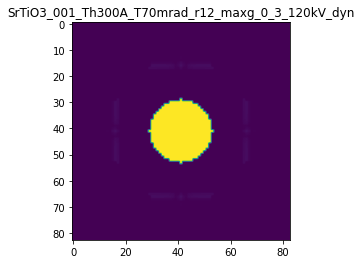

R-factor: 2.0046224358076718e-05

>>> producing the 45. dataset...

The offset applied on thickness: -0.000783054655797183

The offset applied on Ug: 2.2603484122691815

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.21694534420277
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

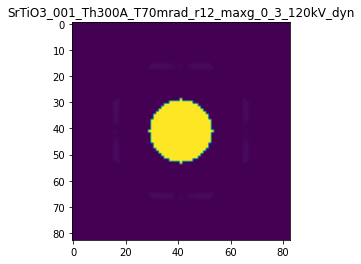

R-factor: 1.4561570545753578e-05

>>> producing the 46. dataset...

The offset applied on thickness: -0.00028655016954468526

The offset applied on Ug: -3.4805219455175327

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.71344983045526
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

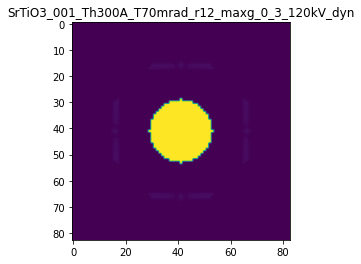

R-factor: 1.9923981938759964e-05

>>> producing the 47. dataset...

The offset applied on thickness: -0.0005962639228404429

The offset applied on Ug: 2.1769581314233233

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4037360771595
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

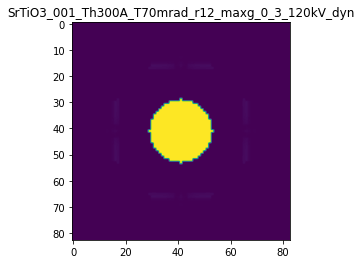

R-factor: 1.3939192154130096e-05

>>> producing the 48. dataset...

The offset applied on thickness: -0.0009443654522860843

The offset applied on Ug: -7.120206008700002

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.0556345477139
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

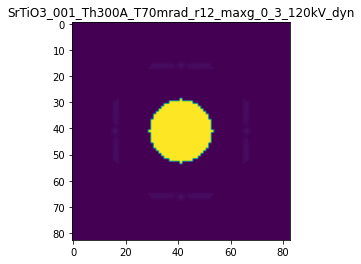

R-factor: 3.7023953815975435e-05

>>> producing the 49. dataset...

The offset applied on thickness: -4.366447474029367e-05

The offset applied on Ug: 0.2079793765048771

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9563355252597
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

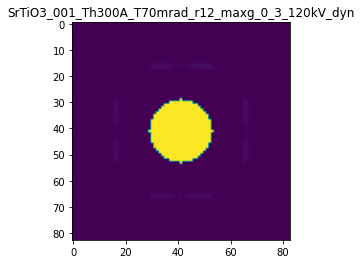

R-factor: 1.3048993252375684e-06

>>> producing the 50. dataset...

The offset applied on thickness: 0.000385169972744843

The offset applied on Ug: -6.2090790200600035

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.38516997274485
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

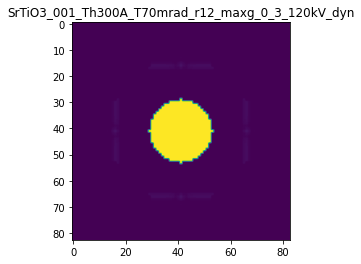

R-factor: 3.321246676999004e-05

>>> producing the 51. dataset...

The offset applied on thickness: -7.398393484252885e-05

The offset applied on Ug: -8.371064993654183

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.92601606515746
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

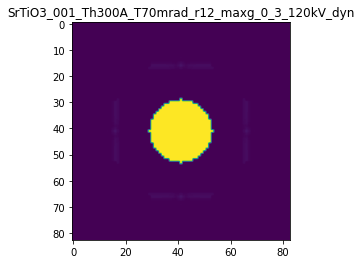

R-factor: 4.1453631158603054e-05

>>> producing the 52. dataset...

The offset applied on thickness: -0.0006432927803181656

The offset applied on Ug: 1.7132102822237654

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3567072196818
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

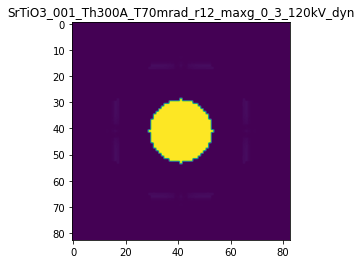

R-factor: 1.1041883348662743e-05

>>> producing the 53. dataset...

The offset applied on thickness: 0.0006596985571267986

The offset applied on Ug: 2.941032222148381

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6596985571268
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

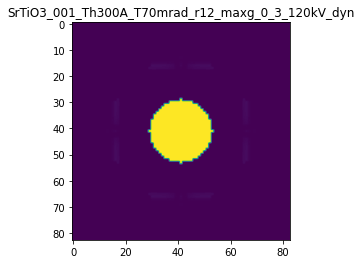

R-factor: 1.8215267547398374e-05

>>> producing the 54. dataset...

The offset applied on thickness: 0.0006791962106749503

The offset applied on Ug: -4.970793683815243

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.67919621067495
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

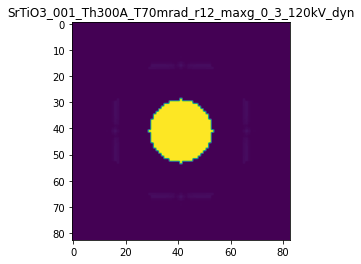

R-factor: 2.7620351992131944e-05

>>> producing the 55. dataset...

The offset applied on thickness: -0.00013543615051717507

The offset applied on Ug: 5.605726423957511

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8645638494828
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

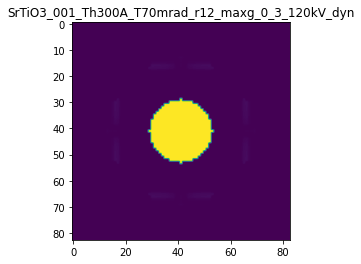

R-factor: 3.502883882078998e-05

>>> producing the 56. dataset...

The offset applied on thickness: -0.0007605605102203479

The offset applied on Ug: -0.3301957207069859

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.23943948977967
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

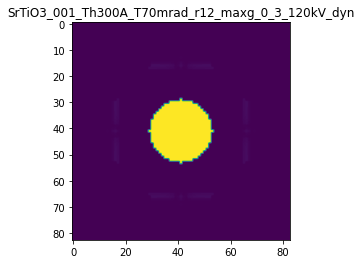

R-factor: 2.1063090490972052e-06

>>> producing the 57. dataset...

The offset applied on thickness: -0.0006892330222809306

The offset applied on Ug: -8.710416556187388

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3107669777191
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

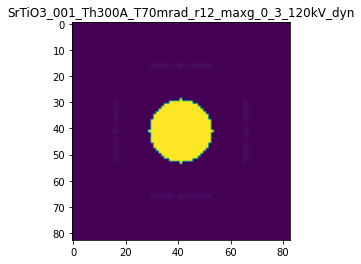

R-factor: 4.2538484208021353e-05

>>> producing the 58. dataset...

The offset applied on thickness: 0.0001906109766404358

The offset applied on Ug: 2.229522691811451

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1906109766404
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

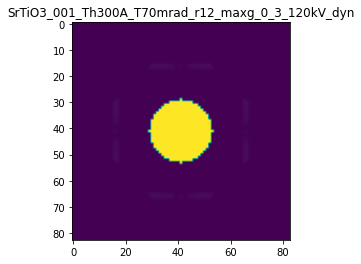

R-factor: 1.3900272779135042e-05

>>> producing the 59. dataset...

The offset applied on thickness: -0.00022123767777871263

The offset applied on Ug: -3.560282661541685

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.77876232222127
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

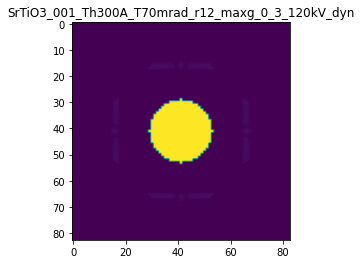

R-factor: 2.0360041205867584e-05

>>> producing the 60. dataset...

The offset applied on thickness: 0.0009856699897361015

The offset applied on Ug: 6.42656695443749

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9856699897361
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

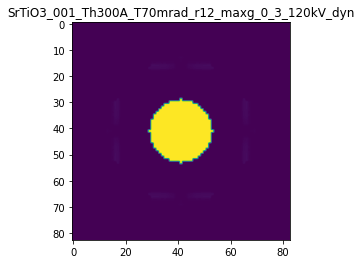

R-factor: 3.955867959358982e-05

>>> producing the 61. dataset...

The offset applied on thickness: 0.0009595843454322877

The offset applied on Ug: 2.370703406363575

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9595843454323
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrT

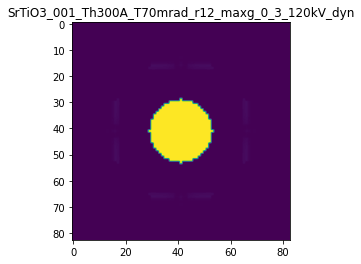

R-factor: 1.446299029158479e-05

>>> producing the 62. dataset...

The offset applied on thickness: 0.00011142480218189798

The offset applied on Ug: 0.27587374952549226

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1114248021819
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

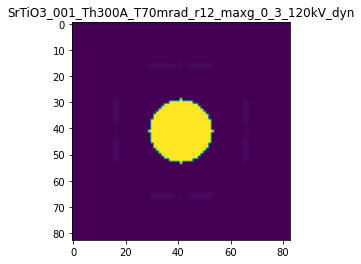

R-factor: 1.6499794083540087e-06

>>> producing the 63. dataset...

The offset applied on thickness: 0.0006840922669392517

The offset applied on Ug: 5.530359270265089

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6840922669393
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

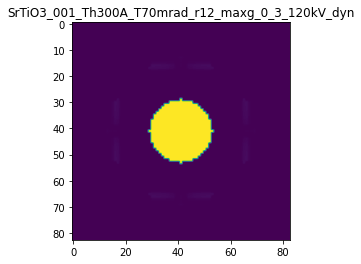

R-factor: 3.4286462356814025e-05

>>> producing the 64. dataset...

The offset applied on thickness: -0.0002725394254304534

The offset applied on Ug: -2.768534410778891

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.72746057456953
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

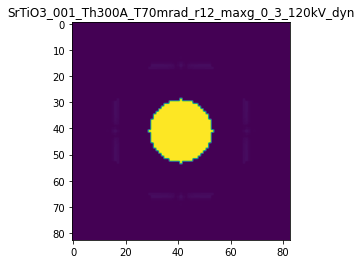

R-factor: 1.6062968221196475e-05

>>> producing the 65. dataset...

The offset applied on thickness: 6.552202052846302e-05

The offset applied on Ug: 5.455385455200354

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0655220205284
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

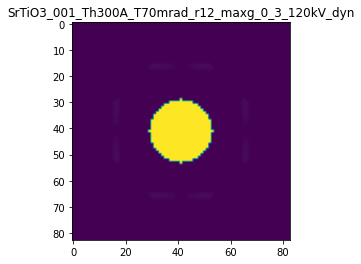

R-factor: 3.404660575488931e-05

>>> producing the 66. dataset...

The offset applied on thickness: -0.0008470034078789553

The offset applied on Ug: 7.050228369657555

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.15299659212104
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

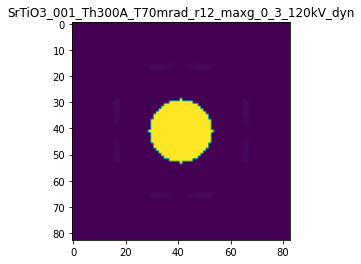

R-factor: 4.3799435142837594e-05

>>> producing the 67. dataset...

The offset applied on thickness: -0.0006752153274280594

The offset applied on Ug: -9.300875797634786

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.324784672572
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

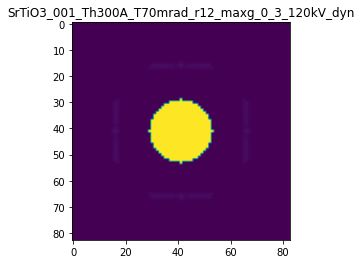

R-factor: 4.440907175013071e-05

>>> producing the 68. dataset...

The offset applied on thickness: -0.0005849899603936892

The offset applied on Ug: 0.6552824768196206

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4150100396063
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

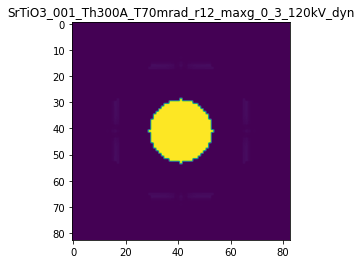

R-factor: 4.405627146392295e-06

>>> producing the 69. dataset...

The offset applied on thickness: -0.00010497716846007289

The offset applied on Ug: -9.239635325684139

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8950228315399
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

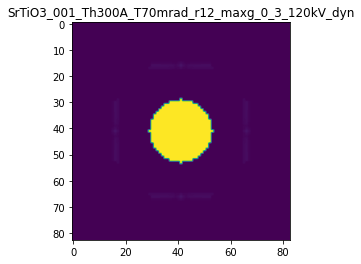

R-factor: 4.413163463099819e-05

>>> producing the 70. dataset...

The offset applied on thickness: -0.0002233955864093984

The offset applied on Ug: -9.994411268007307

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.77660441359063
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

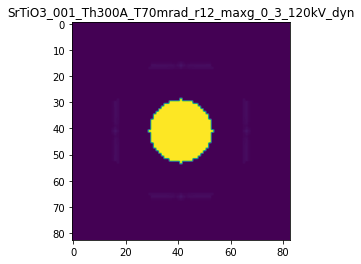

R-factor: 4.6602560446821315e-05

>>> producing the 71. dataset...

The offset applied on thickness: 0.0007653795572629479

The offset applied on Ug: 0.06432592331700335

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.765379557263
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

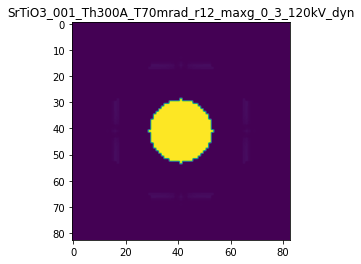

R-factor: 1.0585493550818157e-06

>>> producing the 72. dataset...

The offset applied on thickness: 0.0005552632393070873

The offset applied on Ug: 4.278967180078566

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.55526323930707
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

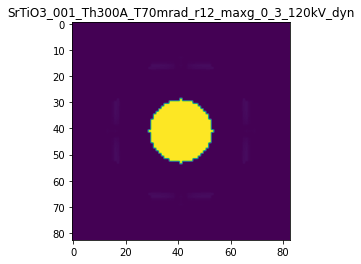

R-factor: 2.665894521109659e-05

>>> producing the 73. dataset...

The offset applied on thickness: 0.0003911264986869969

The offset applied on Ug: 6.488587967957044

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.391126498687
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrTi

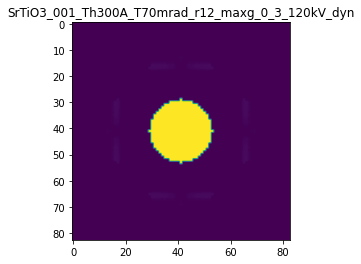

R-factor: 4.012047362673139e-05

>>> producing the 74. dataset...

The offset applied on thickness: 0.0003623347970243622

The offset applied on Ug: 7.455002478170038

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.36233479702435
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

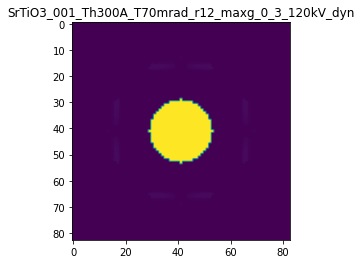

R-factor: 4.5707355586334176e-05

>>> producing the 75. dataset...

The offset applied on thickness: -0.0009342530270292035

The offset applied on Ug: 6.894821823825951

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.06574697297077
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

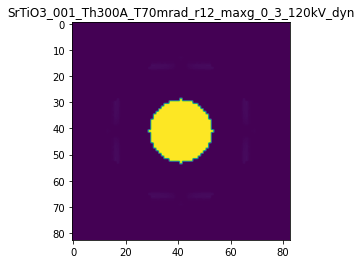

R-factor: 4.293472297340872e-05

>>> producing the 76. dataset...

The offset applied on thickness: 0.00026110390598547896

The offset applied on Ug: 1.86163454074936

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.26110390598546
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

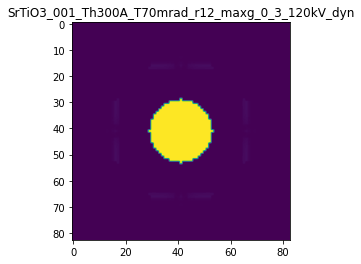

R-factor: 1.1533928362596919e-05

>>> producing the 77. dataset...

The offset applied on thickness: -0.00021967442001544858

The offset applied on Ug: -1.8700579300832738

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7803255799845
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

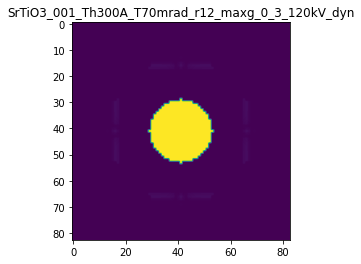

R-factor: 1.1023402750409436e-05

>>> producing the 78. dataset...

The offset applied on thickness: -0.0005683165666869236

The offset applied on Ug: 3.477388309897315

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4316834333131
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

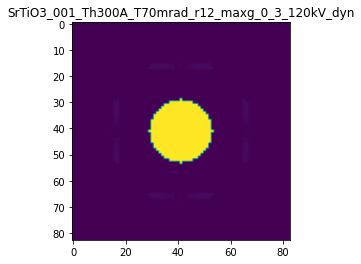

R-factor: 2.2120959153022267e-05

>>> producing the 79. dataset...

The offset applied on thickness: -0.0006205280913348794

The offset applied on Ug: 2.0379869619313853

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.3794719086651
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

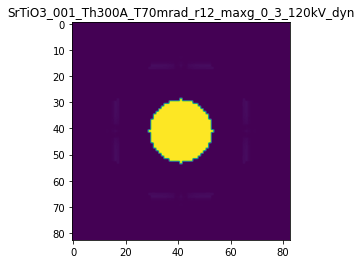

R-factor: 1.30747286171032e-05

>>> producing the 80. dataset...

The offset applied on thickness: 0.0009643657552682321

The offset applied on Ug: 2.2406016387231533

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.96436575526826
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

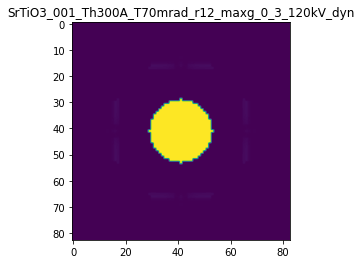

R-factor: 1.3631904415103205e-05

>>> producing the 81. dataset...

The offset applied on thickness: -0.00040687543975958065

The offset applied on Ug: 5.312708513433429

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.5931245602404
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

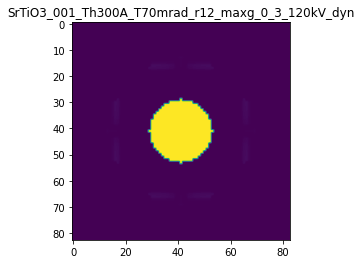

R-factor: 3.33578969582998e-05

>>> producing the 82. dataset...

The offset applied on thickness: -3.6805536344692635e-05

The offset applied on Ug: 7.162287761859163

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.96319446365527
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

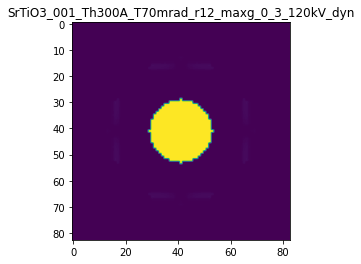

R-factor: 4.4170661602222537e-05

>>> producing the 83. dataset...

The offset applied on thickness: 5.481711611470974e-05

The offset applied on Ug: 1.5795179011308869

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0548171161147
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

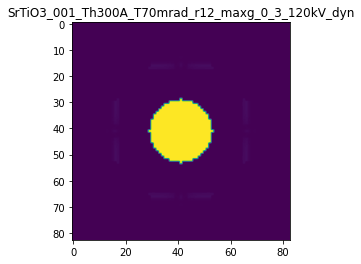

R-factor: 9.844546357096491e-06

>>> producing the 84. dataset...

The offset applied on thickness: -0.0006206629212090371

The offset applied on Ug: -3.4267361044055633

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.37933707879097
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

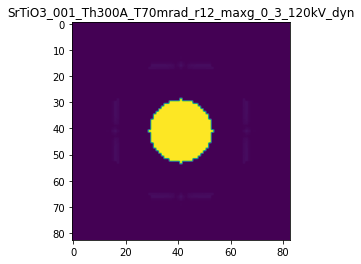

R-factor: 1.95764671031245e-05

>>> producing the 85. dataset...

The offset applied on thickness: -0.0005123305253069388

The offset applied on Ug: 3.247255572600959

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.48766947469306
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

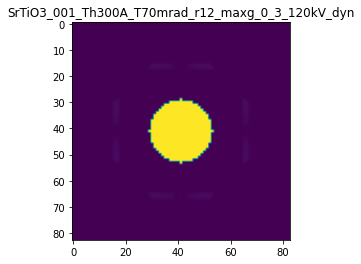

R-factor: 2.0652880172594353e-05

>>> producing the 86. dataset...

The offset applied on thickness: -0.0007622575387398482

The offset applied on Ug: -7.756438874055057

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.2377424612601
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

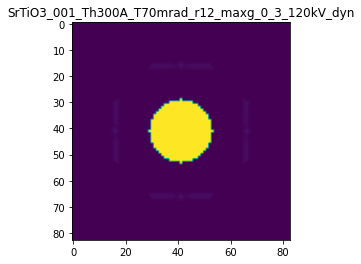

R-factor: 3.9394530150255567e-05

>>> producing the 87. dataset...

The offset applied on thickness: -0.0001577145446810293

The offset applied on Ug: -4.389520395022819

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8422854553189
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

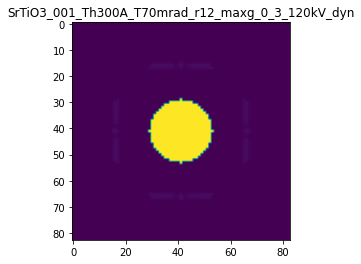

R-factor: 2.4636411339999107e-05

>>> producing the 88. dataset...

The offset applied on thickness: 0.00037897124801775675

The offset applied on Ug: 9.259686081800421

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.37897124801776
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

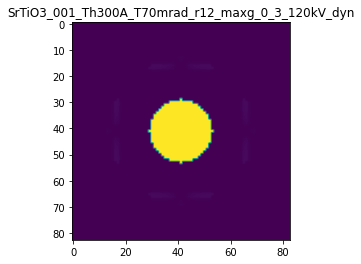

R-factor: 5.5513434056146544e-05

>>> producing the 89. dataset...

The offset applied on thickness: 0.0009708197055239494

The offset applied on Ug: -4.4351652036034555

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9708197055239
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

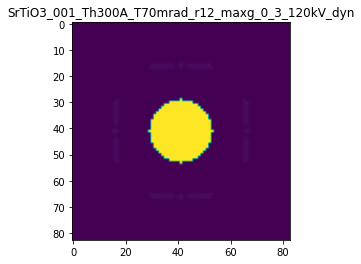

R-factor: 2.5127595738833348e-05

>>> producing the 90. dataset...

The offset applied on thickness: -0.0005680111563819559

The offset applied on Ug: 1.1618569025004217

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.43198884361806
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

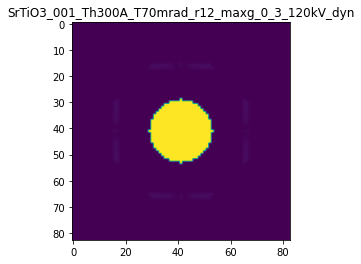

R-factor: 7.539703387198101e-06

>>> producing the 91. dataset...

The offset applied on thickness: 0.0006661353709229063

The offset applied on Ug: -0.13431272528580848

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.6661353709229
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

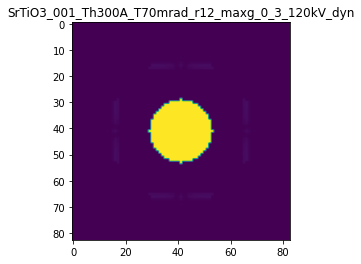

R-factor: 1.3674044600688506e-06

>>> producing the 92. dataset...

The offset applied on thickness: -0.00017190668654289287

The offset applied on Ug: -2.1981472955394814

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8280933134571
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

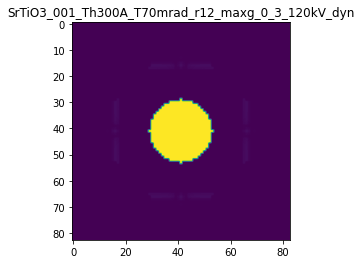

R-factor: 1.2904808404894531e-05

>>> producing the 93. dataset...

The offset applied on thickness: -0.000995785208642119

The offset applied on Ug: -1.624935121604699

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.00421479135787
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

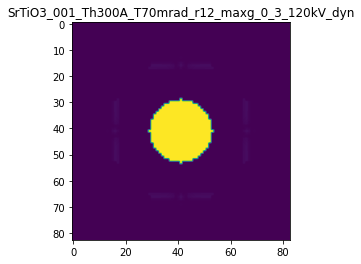

R-factor: 9.48172385583527e-06

>>> producing the 94. dataset...

The offset applied on thickness: -0.0005682421206617423

The offset applied on Ug: 0.9397584433499219

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.43175787933825
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

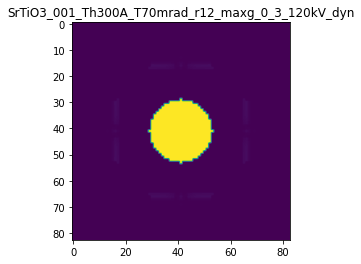

R-factor: 6.155257787955008e-06

>>> producing the 95. dataset...

The offset applied on thickness: -0.00029860595961218905

The offset applied on Ug: -7.864464254159666

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.7013940403878
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

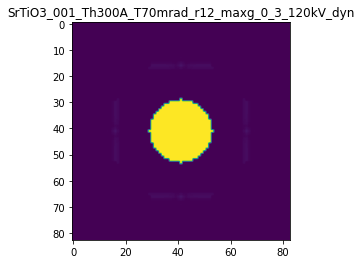

R-factor: 3.9756823558375674e-05

>>> producing the 96. dataset...

The offset applied on thickness: -0.0005342195685167353

The offset applied on Ug: 2.1413505617268993

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.46578043148327
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

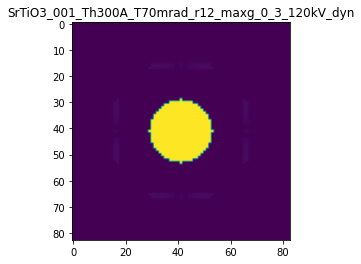

R-factor: 1.3682733565307833e-05

>>> producing the 97. dataset...

The offset applied on thickness: 0.0003172657978291773

The offset applied on Ug: 10.029041429950388

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3172657978292
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

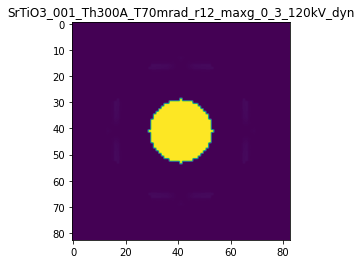

R-factor: 5.945938514377648e-05

>>> producing the 98. dataset...

The offset applied on thickness: 0.00037751433456473005

The offset applied on Ug: -9.404975682428171

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3775143345647
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

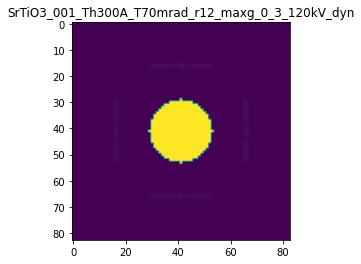

R-factor: 4.460165262198669e-05

>>> producing the 99. dataset...

The offset applied on thickness: 0.00011424077880409755

The offset applied on Ug: -6.939506460933078

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1142407788041
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

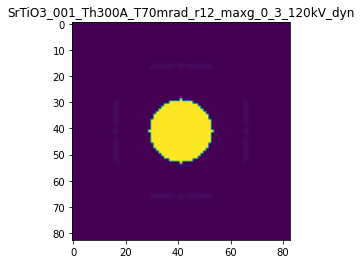

R-factor: 3.6282263854420195e-05

>>> producing the 100. dataset...

The offset applied on thickness: 0.0005724858878771308

The offset applied on Ug: -0.8937807362196349

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5724858878771
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

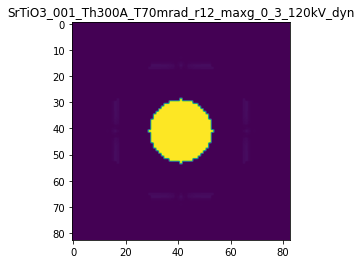

R-factor: 5.765329762930864e-06

>>> producing the 101. dataset...

The offset applied on thickness: -3.9749352851381484e-05

The offset applied on Ug: 7.033845869197921

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9602506471486
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

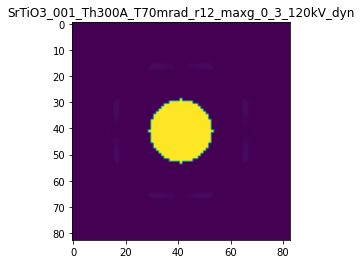

R-factor: 4.3435234933939246e-05

>>> producing the 102. dataset...

The offset applied on thickness: -0.00012662499067636214

The offset applied on Ug: -4.779736106434898

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.87337500932364
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

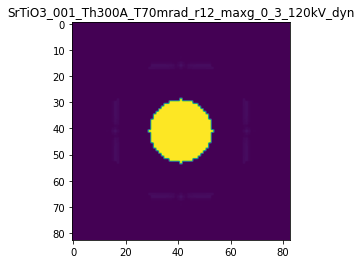

R-factor: 2.658286744570348e-05

>>> producing the 103. dataset...

The offset applied on thickness: 0.0005507873792997229

The offset applied on Ug: 2.8412541097994084

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.55078737929966
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

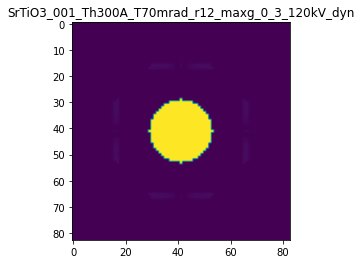

R-factor: 1.7628138360979572e-05

>>> producing the 104. dataset...

The offset applied on thickness: 0.0008730571501593667

The offset applied on Ug: -9.26312898442298

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.87305715015935
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

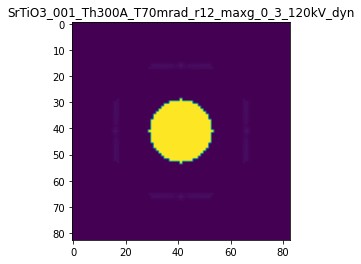

R-factor: 4.4114957387015414e-05

>>> producing the 105. dataset...

The offset applied on thickness: 0.0009178865889538539

The offset applied on Ug: 5.203735238976417

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.9178865889539
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

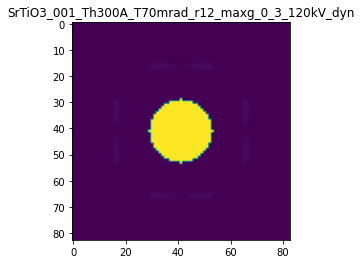

R-factor: 3.221269345694099e-05

>>> producing the 106. dataset...

The offset applied on thickness: -0.0003236327209662762

The offset applied on Ug: 1.7903130708666048

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.67636727903374
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

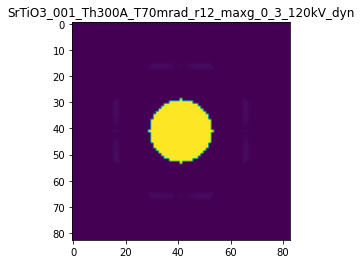

R-factor: 1.136179288056844e-05

>>> producing the 107. dataset...

The offset applied on thickness: -0.000904773584281402

The offset applied on Ug: -1.748909714480153

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.09522641571857
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

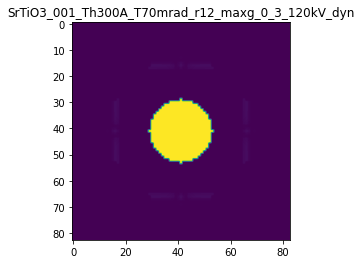

R-factor: 1.0202971567053868e-05

>>> producing the 108. dataset...

The offset applied on thickness: 2.626377883634712e-05

The offset applied on Ug: -2.0927447292381838

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.0262637788363
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

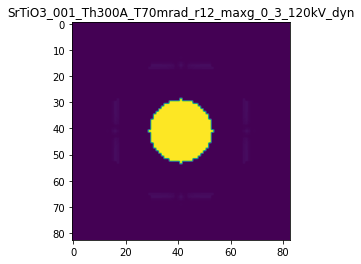

R-factor: 1.2370756931724883e-05

>>> producing the 109. dataset...

The offset applied on thickness: 0.0007321661337821564

The offset applied on Ug: 0.015134320470151579

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.73216613378213
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

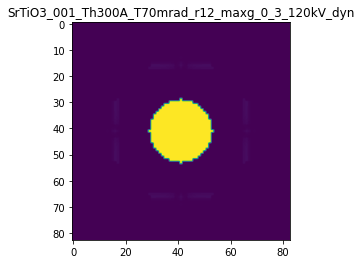

R-factor: 9.404221269201471e-07

>>> producing the 110. dataset...

The offset applied on thickness: 0.0003201563697958152

The offset applied on Ug: 3.8292582400573245

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3201563697958
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

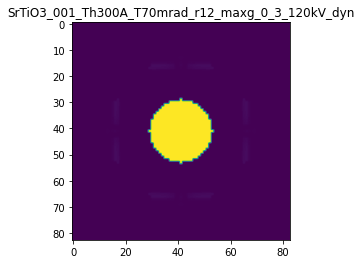

R-factor: 2.3948907304331053e-05

>>> producing the 111. dataset...

The offset applied on thickness: 0.00054538867287883

The offset applied on Ug: 4.8570423055848115

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.54538867287886
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

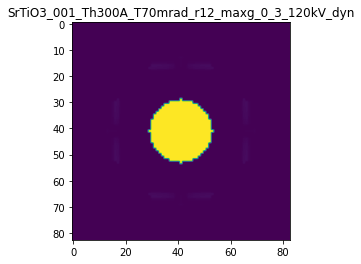

R-factor: 3.0222481011135307e-05

>>> producing the 112. dataset...

The offset applied on thickness: -0.0007480730874679284

The offset applied on Ug: -8.577033890438084

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.25192691253204
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

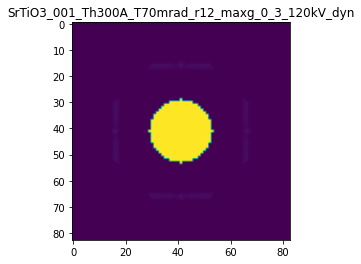

R-factor: 4.2139326602721794e-05

>>> producing the 113. dataset...

The offset applied on thickness: -0.0008097491536198812

The offset applied on Ug: -4.319842410791241

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.19025084638014
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

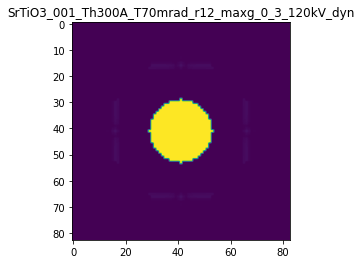

R-factor: 2.4232599300598762e-05

>>> producing the 114. dataset...

The offset applied on thickness: -0.0001377415123665451

The offset applied on Ug: -5.7278761001933685

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8622584876334
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

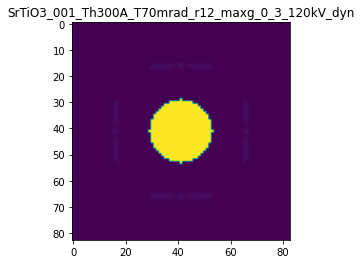

R-factor: 3.1052415416871814e-05

>>> producing the 115. dataset...

The offset applied on thickness: -0.00014976063329803923

The offset applied on Ug: -8.389393047161272

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.85023936670194
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

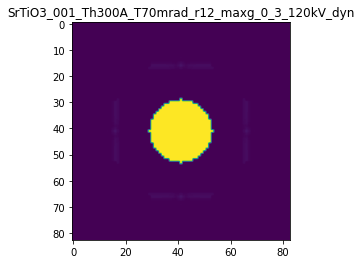

R-factor: 4.151711162446716e-05

>>> producing the 116. dataset...

The offset applied on thickness: -0.0005521118837964112

The offset applied on Ug: 1.0742756424696926

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4478881162036
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

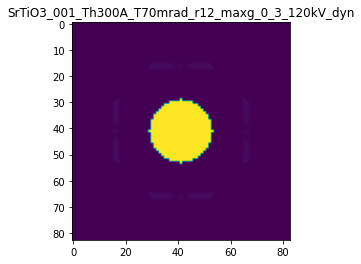

R-factor: 6.982936882891231e-06

>>> producing the 117. dataset...

The offset applied on thickness: -0.000874385398852247

The offset applied on Ug: 7.02440115840514

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.12561460114773
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

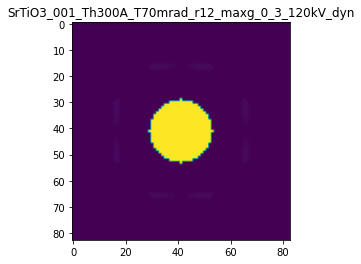

R-factor: 4.366036044028743e-05

>>> producing the 118. dataset...

The offset applied on thickness: -0.0009841694772281264

The offset applied on Ug: 6.710901205538337

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.01583052277186
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

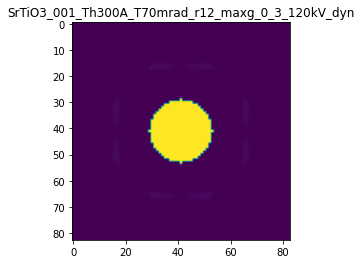

R-factor: 4.188626503756249e-05

>>> producing the 119. dataset...

The offset applied on thickness: -0.00015015382823165658

The offset applied on Ug: 3.8444877646841884

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.8498461717684
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

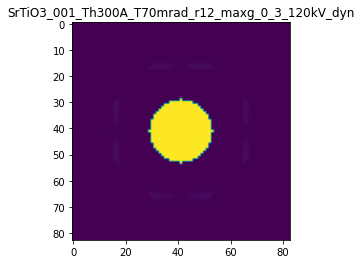

R-factor: 2.4235756199302935e-05

>>> producing the 120. dataset...

The offset applied on thickness: -9.425975483806858e-06

The offset applied on Ug: 1.2072792934286714

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.99057402451615
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

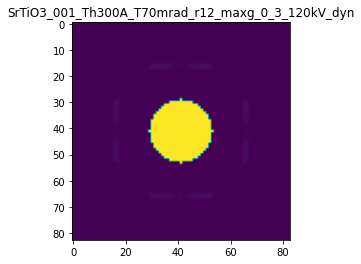

R-factor: 7.525845956759333e-06

>>> producing the 121. dataset...

The offset applied on thickness: -0.0006624954789099416

The offset applied on Ug: 10.180072741978043

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.33750452109
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

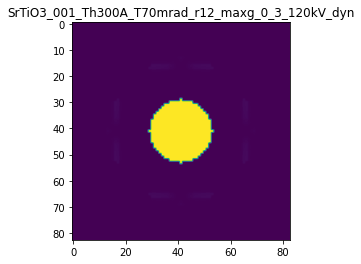

R-factor: 6.052026702026285e-05

>>> producing the 122. dataset...

The offset applied on thickness: -0.0006285119101868198

The offset applied on Ug: 0.826958577465698

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.37148808981317
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

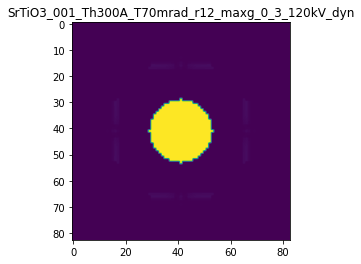

R-factor: 5.4936216628138905e-06

>>> producing the 123. dataset...

The offset applied on thickness: -9.903475300925213e-05

The offset applied on Ug: 4.563874929717908

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9009652469907
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

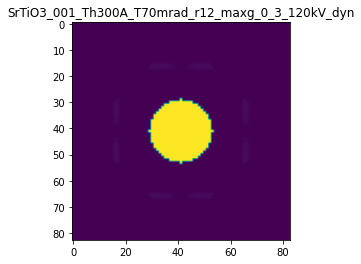

R-factor: 2.8675843511077588e-05

>>> producing the 124. dataset...

The offset applied on thickness: 0.00017172792063545228

The offset applied on Ug: -9.73614223921703

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1717279206355
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

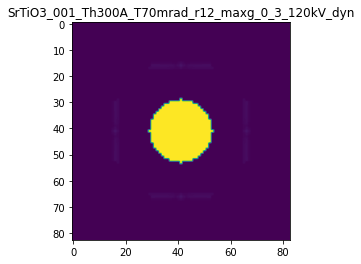

R-factor: 4.5671626216844124e-05

>>> producing the 125. dataset...

The offset applied on thickness: 0.0006597954753183617

The offset applied on Ug: 0.02757716635539282

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.65979547531833
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

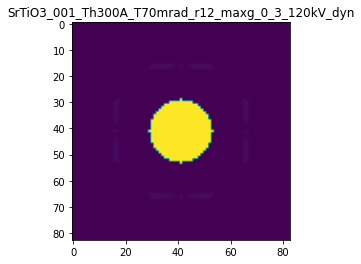

R-factor: 8.667435739589449e-07

>>> producing the 126. dataset...

The offset applied on thickness: -0.0003808789196551774

The offset applied on Ug: -7.721463114097694

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.6191210803448
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

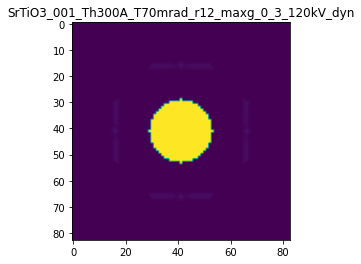

R-factor: 3.9254420276636884e-05

>>> producing the 127. dataset...

The offset applied on thickness: 0.00013694733783643366

The offset applied on Ug: 3.9179227956990053

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.13694733783643
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

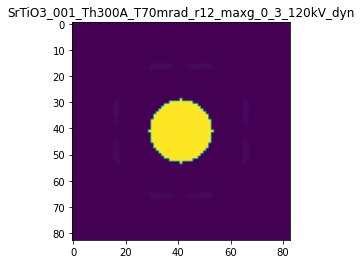

R-factor: 2.4577390865919914e-05

>>> producing the 128. dataset...

The offset applied on thickness: 7.732531702493351e-05

The offset applied on Ug: 6.444382021367492

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.07732531702493
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

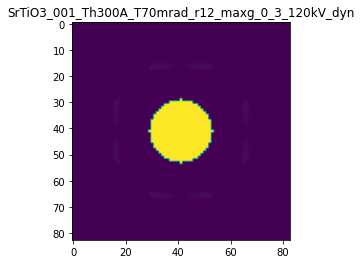

R-factor: 3.996625313420431e-05

>>> producing the 129. dataset...

The offset applied on thickness: -0.0008804355952283949

The offset applied on Ug: -0.006201059632860506

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1195644047716
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_fil

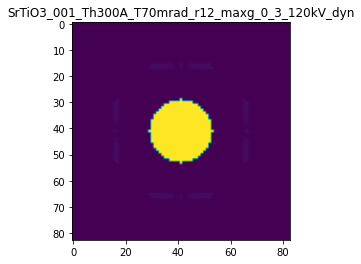

R-factor: 1.1124459980295089e-06

>>> producing the 130. dataset...

The offset applied on thickness: -0.0005822691447707582

The offset applied on Ug: -7.2810316601044045

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.4177308552292
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

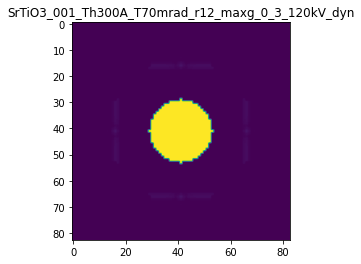

R-factor: 3.762880338677892e-05

>>> producing the 131. dataset...

The offset applied on thickness: -0.0004556325599328928

The offset applied on Ug: -2.808435294468866

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.54436744006705
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

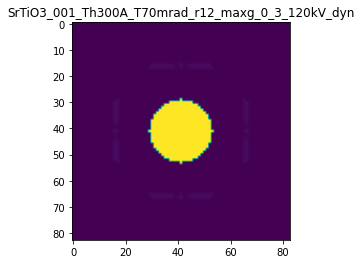

R-factor: 1.6248376284603927e-05

>>> producing the 132. dataset...

The offset applied on thickness: 0.00038770330775877505

The offset applied on Ug: 3.7045952218815117

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.3877033077588
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files

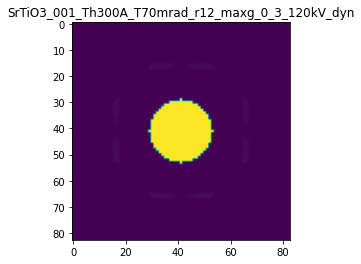

R-factor: 2.3140045859370624e-05

>>> producing the 133. dataset...

The offset applied on thickness: -0.0008446950788444061

The offset applied on Ug: 5.548052705556201

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.1553049211556
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

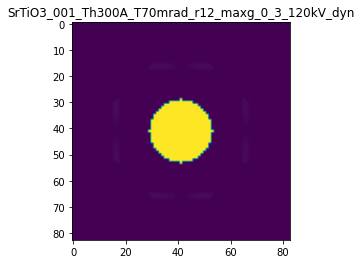

R-factor: 3.494010913598751e-05

>>> producing the 134. dataset...

The offset applied on thickness: 0.00038569174651094244

The offset applied on Ug: -0.8745847616069341

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.38569174651093
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

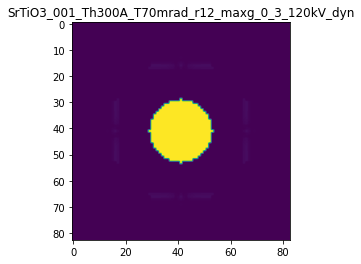

R-factor: 5.52471382501855e-06

>>> producing the 135. dataset...

The offset applied on thickness: 0.00017249651613088245

The offset applied on Ug: 5.853652170115356

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.1724965161309
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

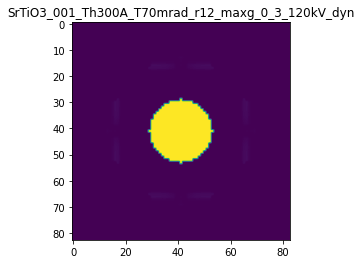

R-factor: 3.6418858126266534e-05

>>> producing the 136. dataset...

The offset applied on thickness: 0.0007355714788488049

The offset applied on Ug: 5.936316887562998

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.7355714788488
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/S

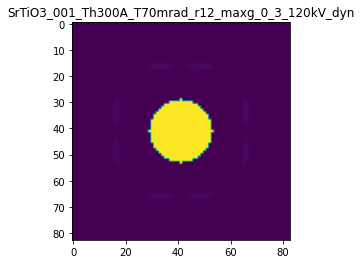

R-factor: 3.672377584875627e-05

>>> producing the 137. dataset...

The offset applied on thickness: -6.51556785118046e-05

The offset applied on Ug: -10.052404280991516

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.9348443214882
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/

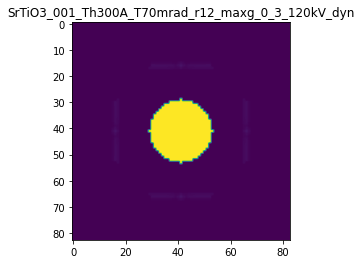

R-factor: 4.675651865249096e-05

>>> producing the 138. dataset...

The offset applied on thickness: -0.0002535228509023739

The offset applied on Ug: -3.9507915731800973

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=299.74647714909764
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

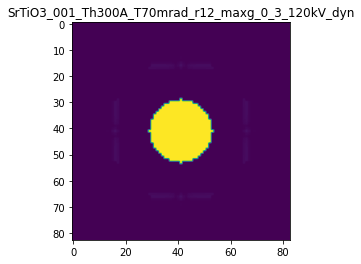

R-factor: 2.2390161167550603e-05

>>> producing the 139. dataset...

The offset applied on thickness: 0.00028930884756804234

The offset applied on Ug: -6.241136971934672

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.28930884756807
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_file

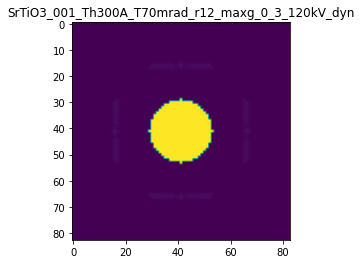

R-factor: 3.3350634781804815e-05

>>> producing the 140. dataset...

The offset applied on thickness: 0.000542889561093608

The offset applied on Ug: 9.141497607088686

mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=300.5428895610936
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/Sr

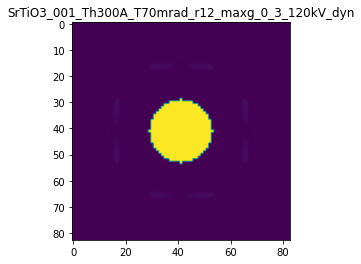

R-factor: 5.4845260167338174e-05



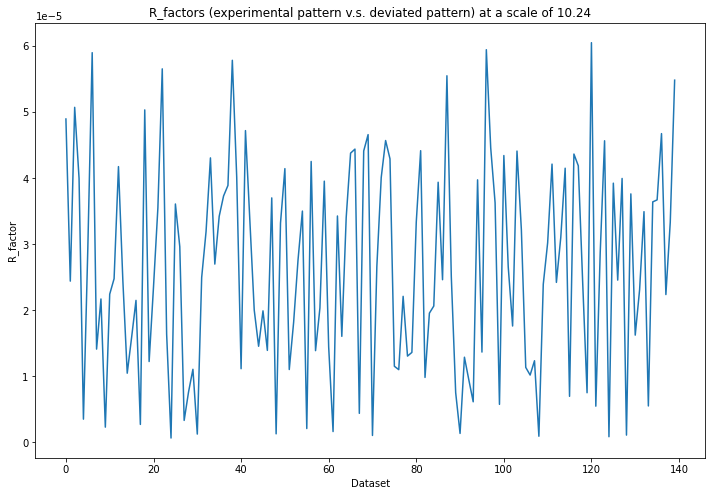

>>> start to train the ANN 

Epoch 1/30
5/5 [==============================] - 1s 130ms/step - loss: 0.3972 - acc: 0.5800 - val_loss: 0.4110 - val_acc: 0.4000
Epoch 2/30
5/5 [==============================] - 1s 106ms/step - loss: 0.3810 - acc: 0.2900 - val_loss: 0.3470 - val_acc: 0.4000
Epoch 3/30
5/5 [==============================] - 1s 106ms/step - loss: 0.3165 - acc: 0.2900 - val_loss: 0.2758 - val_acc: 0.4000
Epoch 4/30
5/5 [==============================] - 1s 106ms/step - loss: 0.2596 - acc: 0.2900 - val_loss: 0.2292 - val_acc: 0.4000
Epoch 5/30
5/5 [==============================] - 1s 105ms/step - loss: 0.2095 - acc: 0.2900 - val_loss: 0.1878 - val_acc: 0.4000
Epoch 6/30
5/5 [==============================] - 1s 106ms/step - loss: 0.1759 - acc: 0.2900 - val_loss: 0.1587 - val_acc: 0.4000
Epoch 7/30
5/5 [==============================] - 1s 110ms/step - loss: 0.1514 - acc: 0.2900 - val_loss: 0.1376 - val_acc: 0.4000
Epoch 8/30
5/5 [==============================] - 1s 106ms/st

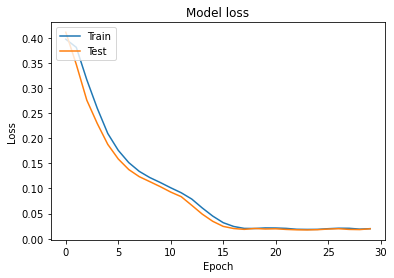

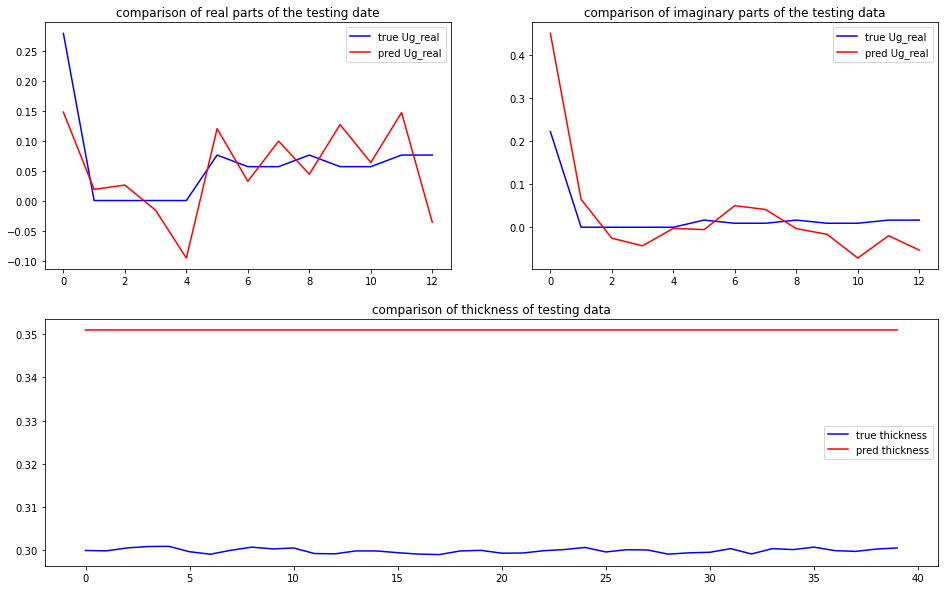

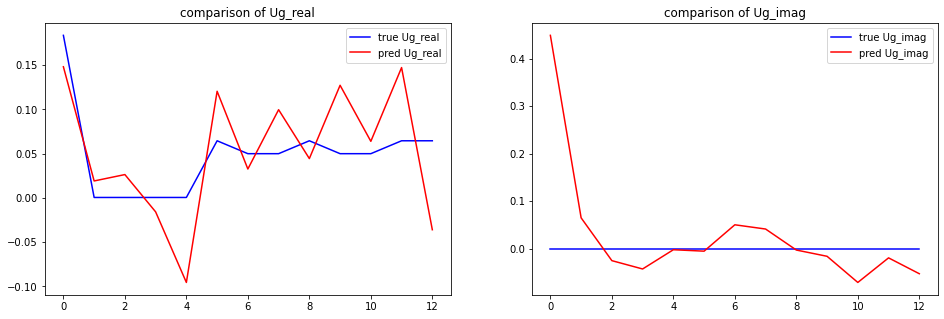

predicted thickness: 35.09543836116791 nm
mode = 		LARBED_SIM
cfg file = 		/Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg
created output folder = 		/pyQEDA_simulations/
file exists
output file = 		/Users/chenjie/pyQEDA/pyQEDA_simulations//SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn/SrTiO3_001_Th300A_T70mrad_r12_maxg_0_3_120kV_dyn.img
zone axis= 		[0.0, 0.0, 1.0]
gx vector= 		[1.0, 0.0, 0.0]
surface normal = 		[0.0, 0.0, 1.0]
tilt offset (mrad) = 		[0.0, 0.0]
approximation = 		0
term threshold = 		0.0001
target Ug = 		0.07
high tension = 		120.0
max g vector = 		0.3
max sg = 		0.2
thickness = 		300.0
scan compensation = 		0.939
tilt range (mrads) = 		70.0
disc radius (pixels) = 		12
detector size x = 		83
thickness=350.9543836116791
InputUg = (13,)

* QEDA: Simulation of /Users/chenjie/pyQEDA/crystal_files/SrTiO3.cfg, zone = [0.0, 0.0, 1.0]



All patterns together contain 13 different beams

InputUg:
[ 0.14806093+0.j          0.0227

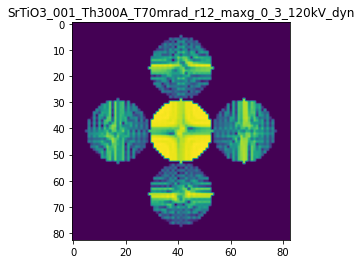

X_sim.max(): 0.981513396196105
R-factor at a scale of 10.24 is 0.6568524532600545.
Time:  3077.133554729


In [12]:
start = timeit.default_timer()

# define training set size & testing set size
trainsize = 100
testsize = 40
data_size = trainsize+testsize

# initial scale used to diverse Ug and t
scale_Ug, scale_t = 0.01, 0.001

# maximum acceptable R-factor value
R_limit = 0.5
# current R-factor value, begin with 0
R_curr = 0

scale_Ug_list=[]
R_factor_list=[]

while R_curr < R_limit:
    print('\n-----------------------------------------------------------------------------------------------------\n')
    print('>>> start to produce Dataset at a scale of {}\n'.format(scale_Ug))
    print('-----------------------------------------------------------------------------------------------------\n')
    
    # load and compile the model
    model = load_model(name+"_ANN.h5")
    
    # generate Datasets
    X, y, R_factors = generate_diversed_data(Ug_t, scale_Ug=scale_Ug, scale_t=scale_t, data_size=data_size)
    X = X.reshape(-1, I.shape[1])

    X_train = X[:trainsize,]
    X_test = X[trainsize:trainsize+testsize,]
    y_train = y[:trainsize,]
    y_test = y[trainsize:trainsize+testsize,]
    
    

    print('>>> start to train the ANN \n')
    # train the model
    model.fit(X_train, y_train, validation_data=(X_test, y_test), batch_size=20, epochs=30)

    # plot the model loss
    plt.plot(model.history.history['loss'])
    plt.plot(model.history.history['val_loss'])
    plt.title('Model loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Test'], loc='upper left')
    plt.show()
    plt.close()

    
    
    # Prediction of the testing set
    y_test_pred = model.predict(X_test)    
    Ug_test_pred_complex = y_test_pred[:,:-1].reshape(-1,numUg,2)
    Ug_test_complex = y_test[:,:-1].reshape(-1,numUg,2)    
    t_test_pred = y_test_pred[:,-1]
    t_test = y_test[:,2*numUg]
    
    # plot the comparison of imaginary parts, real parts and thickness
    gs = gridspec.GridSpec(2, 2)
    fig = plt.figure(figsize=(16,10))
    
    ax1 = fig.add_subplot(gs[0, 0]) 
    ax1.plot(Ug_test_complex[2,:,0],'b', label='true Ug_real')
    ax1.plot(Ug_test_pred_complex[2,:,0],'r', label='pred Ug_real')
    ax1.legend()
    ax1.set_title('comparison of real parts of the testing date')
    
    ax2 = fig.add_subplot(gs[0, 1]) 
    ax2.plot(Ug_test_complex[2,:,1],'b', label='true Ug_real')
    ax2.plot(Ug_test_pred_complex[2,:,1],'r', label='pred Ug_real')
    ax2.legend()
    ax2.set_title('comparison of imaginary parts of the testing data')
    
    ax3 = fig.add_subplot(gs[1, :])
    ax3.plot(t_test[:],'b', label='true thickness')
    ax3.plot(t_test_pred[:],'r', label='pred thickness')
    ax3.legend()
    ax3.set_title('comparison of thickness of testing data') 
    plt.show()
    plt.close()
    
    
    
    # Prediction of the experimental Pattern
    y_exp_pred = model.predict(I)
    Ug_t_exp_pred = y_exp_pred[0,:]
        
    # plot the results
    gs = gridspec.GridSpec(1, 2)
    fig = plt.figure(figsize=(16,5))
    
    ax1 = fig.add_subplot(gs[0, 0]) 
    ax1.plot(Ug[::2],'b', label='true Ug_real')
    ax1.plot(Ug_t_exp_pred[:-1:2], 'r', label='pred Ug_real')
    ax1.legend()
    ax1.set_title("comparison of Ug_real")
    
    ax2 = fig.add_subplot(gs[0, 1]) 
    ax2.plot(Ug[1::2],'b', label='true Ug_imag')
    ax2.plot(Ug_t_exp_pred[1:-1:2],'r', label='pred Ug_imag')
    ax2.legend()
    ax2.set_title("comparison of Ug_imag")
    plt.show()
    plt.close()
    
    print("predicted thickness: {} nm".format(Ug_t_exp_pred[-1]*100))
    

    # normalization
    Ug_pred = np.array(range( np.int((Ug_t_exp_pred.size - 1)/2) ), dtype=complex)
    Ug_pred.real = Ug_t_exp_pred[0:-1:2]
    Ug_pred.imag = Ug_t_exp_pred[1:-1:2]
    Ug_pred_normalized = nf.normalization(file=File, origin_Ug=Ug_pred)
    Ug_pred_normalized = np.asarray(Ug_pred_normalized)

    # reshape
    Ug_pred_normalized_2real = np.concatenate((np.array(Ug_pred_normalized.real,ndmin=2).T, np.array(Ug_pred_normalized.imag,ndmin=2).T),axis=1)  
    Ug_pred_normalized_2real = np.asarray(Ug_pred_normalized_2real)
    Ug_t_pred_normalized_2real = np.append(Ug_pred_normalized_2real.reshape(numUg*2), Ug_t_exp_pred[-1])
    
    # Compute the LARBED pattern: X_sim, from the predicted Ug_t
    file = File+".qed"
    X_sim = pf.pyQEDA(filename=file, UseInputUgMasterList=True, InputUg= Ug_t_pred_normalized_2real, InputUgdoFlip=False)
    X_sim = X_sim.reshape(Nx,Nx,1)
    nlogf_X_sim = nlogf(X_sim)    
    print("X_sim.max():",X_sim.max())
    
    # compute R-factor
    R_curr = calculate_R(I_exp, X_sim.reshape(-1))
    print('R-factor at a scale of {} is {}.'.format(scale_Ug, R_curr))
        
    scale_Ug_list = np.append(scale_Ug_list, scale_Ug)
    R_factor_list = np.append(R_factor_list, R_curr)
    
    scale_Ug *= 2
    
                       
stop = timeit.default_timer()
print('Time: ', stop - start)

/opt/anaconda3/envs/pyQEDA37/lib/python3.7/site-packages/ipykernel_launcher.py:4: MatplotlibDeprecationWarning: The 'basex' parameter of __init__() has been renamed 'base' since Matplotlib 3.3; support for the old name will be dropped two minor releases later.
  after removing the cwd from sys.path.


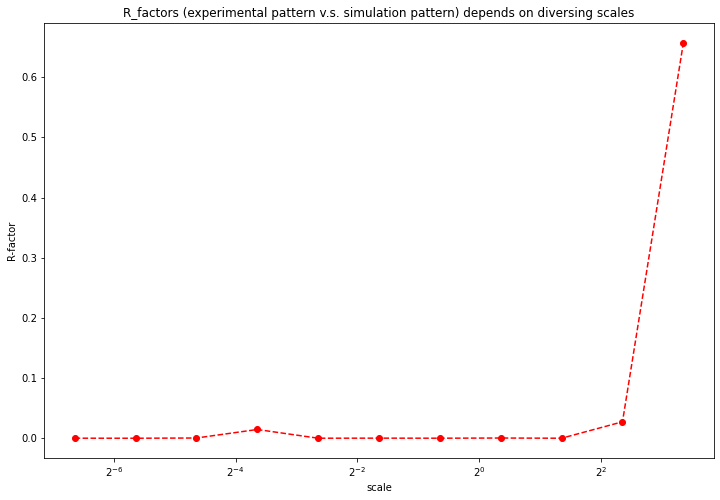

Time:  3077.513517507


In [13]:
plt.figure(figsize=(12,8))
plt.plot(scale_Ug_list[:], R_factor_list[:], "ro--")
plt.title("R_factors (experimental pattern v.s. simulation pattern) depends on diversing scales")
plt.xscale("log", basex=2)
plt.xlabel("scale")
plt.ylabel("R-factor")
plt.savefig("/Users/chenjie/Desktop/master_thesis_data/"+save_name+"/ANN_R_scale.jpg")
plt.show()
plt.close()
                       
stop = timeit.default_timer()
print('Time: ', stop - start)

In [14]:
print(scale_Ug_list)

[1.000e-02 2.000e-02 4.000e-02 8.000e-02 1.600e-01 3.200e-01 6.400e-01
 1.280e+00 2.560e+00 5.120e+00 1.024e+01]


In [15]:
print(R_factor_list)

[1.47823287e-04 8.16416836e-05 4.56960978e-04 1.45907286e-02
 1.20254897e-04 2.33502653e-04 1.26419635e-04 4.27565510e-04
 9.31243429e-05 2.73789811e-02 6.56852453e-01]
